**<h1>System oceny ofensywności drużyn piłkarskich w sezonie</h1>**

**<h1>Football Team Offensiveness Analyzer</h1>**

---



<h3>Link do zbioru danych</h3>

https://www.kaggle.com/datasets/varpit94/football-teams-rankings-stats

<h3>Zastosowane biblioteki</h3>

- **numpy** - do obliczeń numerycznych i manipulowania danymi w postaci tablic
- **pandas** - do analizy danych w formie tabelarycznej
- **matplotlib.pyplot** - do tworzenia prostych wykresów
- **seaborn** - do tworzenia zaawansowanych wykresów
- **files** (google.colab) - do pracy z plikami w środowisku Google Colab

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab import files

Instalacja biblioteki **scikit-fuzzy**, która jest wykorzystywana do analizy i tworzenia systemów rozmytych

In [ ]:
!pip install -U scikit-fuzzy

Importowanie bibliotek i modułów **skfuzzy**
- **skfuzzy** - umożliwia korzystanie z funkcji do operacji na zbiorach rozmytych
- **control** (skfuzzy) - pozwala na tworzenie i sterowanie systemami rozmytymi

In [ ]:
import skfuzzy as fuzz
from skfuzzy import control as ctrl

<h3>Import pliku .csv</h3>

In [ ]:
uploadedFile = files.upload()

Saving Football teams.csv to Football teams.csv


In [ ]:
data = pd.read_csv('Football teams.csv')

<h3>Wyświetlenie danych</h3>

In [ ]:
data

,Team,Tournament,Goals,Shots pg,yellow_cards,red_cards,Possession%,Pass%,AerialsWon,Rating
0,Manchester City,Premier League,83,15.8,46,2,60.8,89.4,12.8,7.01
1,Bayern Munich,Bundesliga,99,17.1,44,3,58.1,85.5,12.9,6.95
2,Paris Saint-Germain,Ligue 1,86,15.0,73,7,60.1,89.5,9.5,6.88
3,Barcelona,LaLiga,85,15.3,68,2,62.4,89.7,10.6,6.87
4,Real Madrid,LaLiga,67,14.4,57,2,57.7,87.7,11.8,6.86
...,...,...,...,...,...,...,...,...,...,...
93,Sheffield United,Premier League,20,8.5,73,3,43.0,76.9,19.1,6.46
94,Crotone,Serie A,45,9.5,85,4,47.2,80.4,12.7,6.43
95,Benevento,Serie A,40,11.0,90,5,44.2,77.7,13.4,6.43
96,Dijon,Ligue 1,25,9.2,75,5,46.9,80.0,14.3,6.42


Wyświetlenie liczby wczytanych wierszy oraz kolumn

In [ ]:
print(f'Liczba wierszy: {data.shape[0]}')
print(f'Liczba kolumn: {data.shape[1]}')

Liczba wierszy: 98
Liczba kolumn: 10


Wyświetlenie nazw kolumn (zmiennych)

In [ ]:
print(f'Kolumny: {data.columns}')

Kolumny: Index(['Team', 'Tournament', 'Goals', 'Shots pg', 'yellow_cards', 'red_cards',
       'Possession%', 'Pass%', 'AerialsWon', 'Rating'],
      dtype='object')


Opis zmiennych:
- **Team** - nazwa drużyny piłkarskiej biorącej udział w rozgrywkach
- **Tournament** - nazwa rozgrywek piłkarskich
- **Goals** - liczba bramek zdobytych przez drużynę w rozgrywkach
- **Shots pg** - średnia liczba strzałów oddanych przez drużynę na mecz
- **yellow_cards** - liczba żółtych kartek otrzymanych przez drużynę w rozgrywkach
- **red_cards** - liczba czerwonych kartek otrzymanych przez drużynę w rozgrywkach
- **Possession%** - średni procentowy udział drużyny w posiadaniu piłki w rozgrywkach
- **Pass%** - średni procentowy wskaźnik celnych podań drużyny w rozgrywkach
- **AerialsWon** - średnia liczba wygranych pojedynków na mecz
- **Rating** - ogólny ocena drużyny na podstawie pewnej strony internetowej

Zmienne jakościowe: **Team, Tournament**

Zmienne ilościowe: **Goals, Shots pg, yellow_card, red_cards, Possesion%, Pass%, AerialsWon, Rating**

<h3>Obróbka danych</h3>

Wyświetlenie ogólnych informacji o zbiorze danych

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 98 entries, 0 to 97
Data columns (total 10 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Team          98 non-null     object 
 1   Tournament    98 non-null     object 
 2   Goals         98 non-null     int64  
 3   Shots pg      98 non-null     float64
 4   yellow_cards  98 non-null     int64  
 5   red_cards     98 non-null     int64  
 6   Possession%   98 non-null     float64
 7   Pass%         98 non-null     float64
 8   AerialsWon    98 non-null     float64
 9   Rating        98 non-null     float64
dtypes: float64(5), int64(3), object(2)
memory usage: 7.8+ KB


Oliczenie liczby brakujących (null) wartości w każdej kolumnie w DataFrame **data**

In [ ]:
data.isnull().sum()

,0
Team,0
Tournament,0
Goals,0
Shots pg,0
yellow_cards,0
red_cards,0
Possession%,0
Pass%,0
AerialsWon,0
Rating,0


Usuwanie wszystkich wierszy, zawierających brakujące wartości z danych

In [ ]:
data = data.dropna()

Usuwanie zbędnych do analizy zmiennych o nazwach: **yellow_cards**, **red_cards**, **Rating**, **Pass%**, **AerialsWon**

In [ ]:
columns_to_drop = ['yellow_cards', 'red_cards', 'Rating', 'Pass%', 'AerialsWon']
data = data.drop(columns=columns_to_drop)

Zdecydowano się usunąć zmienne: **yellow_cards**, **red_cards**, **Rating**, **Pass%**, **AerialsWon**, ponieważ nie są one bezpośrednio związane z analizą ofensywności drużyny piłkarskiej. Ich obecność mogłaby wprowadzać niepotrzebne zmienności, które mogą zniekształcić model analityczny.

Dlatego do celów analitycznych wykorzystano zmienne o nazwach: **Team**, **Tournament**, **Goals**, **Shots pg**, **Possesion%**. Zmienne jakościowe pozostawiono w celu identyfikacji konkretnego rekordu w pliku .csv.

Zmiana nazw zmiennych na małe litery oraz usunięcie z nich znaku '%'

In [ ]:
data.columns = data.columns.str.replace('%', '')
data.columns = data.columns.str.lower()
data.rename(columns={'shots pg': 'shots_per_game'}, inplace=True)

Ponowne załadowanie nazw kolumn (zmiennych)

In [ ]:
print(f'Kolumny: {data.columns}')

Kolumny: Index(['team', 'tournament', 'goals', 'shots_per_game', 'possession'], dtype='object')


Wyświetlenie minimalnych i maksymalnych wartości zmiennych ilościowych

In [ ]:
columns_to_consider = ['goals', 'shots_per_game', 'possession']
min_max_values = pd.DataFrame({
    'Min': data[columns_to_consider].min(),
    'Max': data[columns_to_consider].max()
})

print(min_max_values)

                 Min   Max
goals           20.0  99.0
shots_per_game   7.1  17.1
possession      38.5  62.4


Odrzucenie wartości odstających (outlinerów) - eliminacja nietypowych lub nieprawidłowych danych, które mogą zakłócać analizę. W kontekście kodu usunięto outlinery dla zmiennych, które nie mieszczą się w zakresie:
- goals: <0, 120>
- shots_per_game: <0, 30>
- possession: <0, 100>

In [ ]:
data = data[
    (data['goals'] >= 0) & (data['goals'] <= 120) &
    (data['shots_per_game'] >= 0) & (data['shots_per_game'] <= 30) &
    (data['possession'] >= 0) & (data['possession'] <= 100)
]

Podstawowe statystyki zbioru danych:

- **count** - liczba niepustych wartości w każdej kolumnie

- **mean** - średnia wartość dla każdej kolumny

- **std** - odchylenie standardowe, czyli miara rozproszenia danych od średniej

- **min** - najmniejsza wartość w każdej kolumnie

- **25%** - dolny kwartyl, czyli wartość, poniżej której znajduje się 25% obserwacji

- **50%** - mediana, czyli wartość środkowa, pomiędzy najmniejszą a największą wartością

- **75%** - górny kwartyl, czyli wartość, poniżej której znajduje się 75% obserwacji

- **max** - największa wartość w każdej kolumnie

In [ ]:
data.describe()

,goals,shots_per_game,possession
count,98.000000,98.000000,98.000000
mean,52.183673,11.851020,49.995918
std,16.445691,2.149718,4.890068
min,20.000000,7.100000,38.500000
25%,40.250000,10.325000,46.225000
50%,50.000000,11.450000,49.750000
75%,61.750000,13.350000,52.850000
max,99.000000,17.100000,62.400000


<h3>Inżynieria cech</h3>

Histogram strzelonych bramek

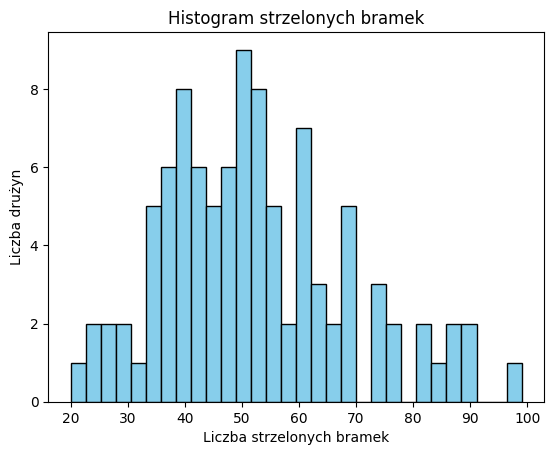

In [ ]:
plt.hist(data['goals'], bins=30, color='skyblue', edgecolor='black')
plt.xlabel('Liczba strzelonych bramek')
plt.ylabel('Liczba drużyn')
plt.title('Histogram strzelonych bramek')
plt.show()

Histogram liczby strzałów na mecz

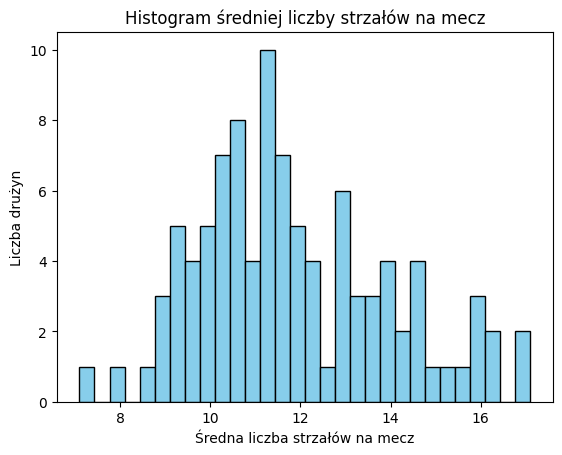

In [ ]:
plt.hist(data['shots_per_game'], bins=30, color='skyblue', edgecolor='black')
plt.xlabel('Średna liczba strzałów na mecz')
plt.ylabel('Liczba drużyn')
plt.title('Histogram średniej liczby strzałów na mecz')
plt.show()

Histogram średniego procentu posiadania piłki

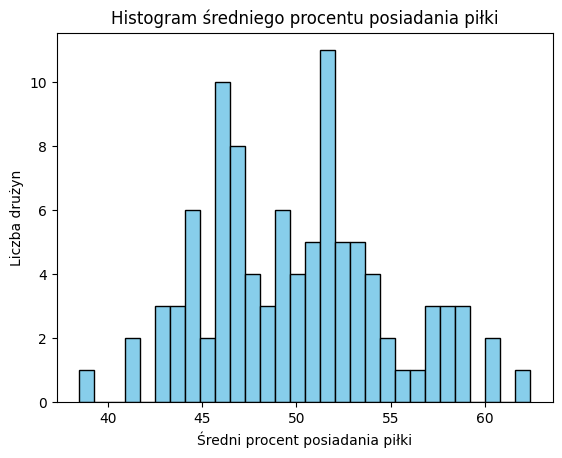

In [ ]:
plt.hist(data['possession'], bins=30, color='skyblue', edgecolor='black')
plt.xlabel('Średni procent posiadania piłki')
plt.ylabel('Liczba drużyn')
plt.title('Histogram średniego procentu posiadania piłki')
plt.show()

Macierz korelacji dla zmiennych ilościowych

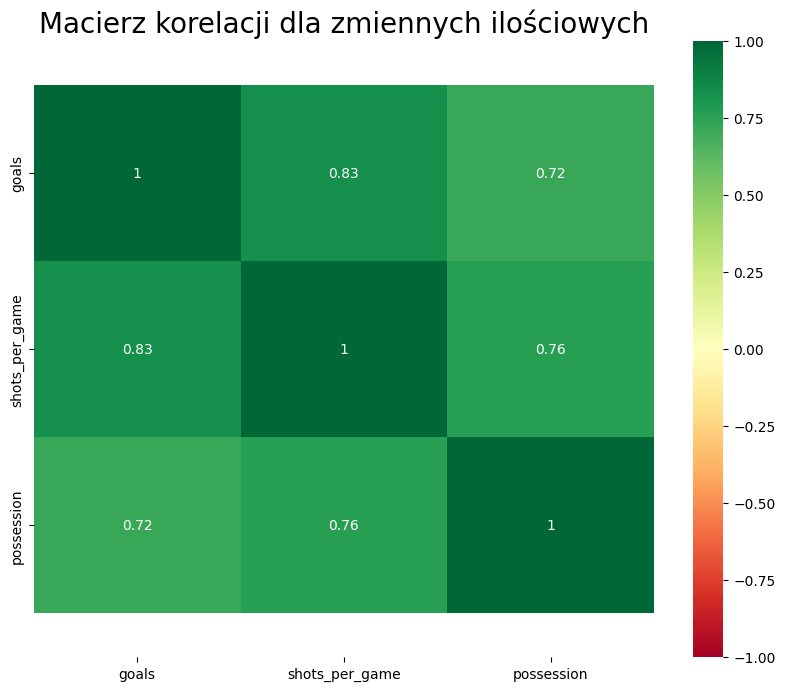

In [ ]:
plt.figure(figsize=(10, 8))
numerical_data = data.select_dtypes(include=[np.number])

ax = sns.heatmap(numerical_data.corr(),
                 xticklabels=numerical_data.corr().columns,
                 yticklabels=numerical_data.corr().columns,
                 cmap='RdYlGn',
                 vmin=-1, vmax=1,
                 annot=True, center=0)

plt.title('Macierz korelacji dla zmiennych ilościowych', fontsize=20)
bottom, top = ax.get_ylim()
ax.set_ylim(bottom + 0.25, top - 0.25)

plt.xticks(fontsize=10)
plt.yticks(fontsize=10)

plt.show()

<h3>Logika rozmyta</h3>

Model rozmytego wnioskowania - **METODA MAMDANI**

Model Mamdaniego to jakościowy sposób modelowania oparty na wiedzy eksperckiej, wykorzystujący reguły rozmyte w formie "JEŚLI (x jest A1), TO (y jest B1)", gdzie x i y są zmiennymi, a A1 i B1 to zbiory rozmyte. Reguły opisują lokalne związki między zmiennymi x i y, odwołując się do zbiorów rozmytych w przesłankach i konkluzjach.

Tworzenie zmiennych lingwistycznych


Zmienne lingwistyczne wejścia:
- **Liczba bramek** *(goals)*: [bez jednostki], zakres od 0 do 120
- **Średnia liczba strzałów na mecz** *(shots_per_game)*: [bez jednostki], zakres od 0 do 30
- **Średni procent posiadania piłki** *(possesion)*: [%], zakres od 0 do 100

Zmienne lingwistyczne wyjścia:
- **Ofensywność drużyny** *(offensiveness)*: [%], zakres od 0 do 100

In [ ]:
goals = ctrl.Antecedent(np.arange(0, 121, 1), 'Liczba bramek')
shots_per_game = ctrl.Antecedent(np.arange(0, 30.1, 0.1), 'Średnia liczba strzałów na mecz')
possession = ctrl.Antecedent(np.arange(0, 100.1, 0.1), 'Średni procent posiadania piłki')

offensiveness = ctrl.Consequent(np.arange(0, 101, 1), 'Ofensywność drużyny', defuzzify_method='centroid')

Definicja zbiorów rozmytych i funkcji przynależności

- Liczba bramek
  - mała – reprezentuje małą liczbę bramek i jest opisana funkcją trapezową, która ma przynależność równą 1 w zakresie od 0 do 20, a przynależność malejącą od 20 do 45, poza tym zakresem wynosi 0.
  - średnia – reprezentuje średnią liczbę bramek i jest opisana funkcją trójkątną, której przynależność jest maksymalna przy 60 i maleje w kierunkach 40 oraz 80.
  - duża – reprezentuje dużą liczbę bramek i jest opisana funkcją trapezową, która ma przynależność rosnącą od 75 do 90, maksymalną od 90 do 120, a poza tym zakresem wynosi 0.

In [ ]:
goals['mala'] = fuzz.trapmf(goals.universe, [0, 0, 20, 45])
goals['srednia'] = fuzz.trimf(goals.universe, [40, 60, 80])
goals['duza'] = fuzz.trapmf(goals.universe, [75, 90, 120, 120])

- Średnia liczba strzałów na mecz
  - mała – reprezentuje małą liczbę strzałów na mecz i jest opisana funkcją trapezową, która ma przynależność równą 1 w zakresie od 0 do 6, a następnie maleje do 0 w przedziale od 6 do 10, poza tym zakresem wynosi 0.
  - średnia – reprezentuje średnią liczbę strzałów na mecz i jest opisana funkcją trójkątną, której przynależność osiąga maksimum przy 14, a maleje w kierunkach 9 oraz 20.
  - duża – reprezentuje dużą liczbę strzałów na mecz i jest opisana funkcją trapezową, która zaczyna rosnąć od 14, osiąga maksimum między 20 a 30 i pozostaje równa 1 aż do końca zakresu 30.

In [ ]:
shots_per_game['mala'] = fuzz.trapmf(shots_per_game.universe, [0.0, 0.0, 6.0, 10.0])
shots_per_game['srednia'] = fuzz.trimf(shots_per_game.universe, [9.0, 14.0, 20.0])
shots_per_game['duza'] = fuzz.trapmf(shots_per_game.universe, [14.0, 20.0, 30.0, 30.0])

- Średni procent posiadania piłki
  - niski – reprezentuje niski procent posiadania piłki, opisany funkcją trapezową, która osiąga przynależność równą 1 dla wartości od 0 do 30, a następnie maleje do 0 w przedziale od 37 do 46, poza tym zakresem wynosi 0.
  - sredni – reprezentuje średni procent posiadania piłki, opisany funkcją trójkątną, której przynależność osiąga maksimum przy 50, a maleje w kierunkach 43 oraz 57.
  - wysoki – reprezentuje wysoki procent posiadania piłki, opisany funkcją trapezową, która zaczyna rosnąć od 54, osiąga maksimum między 63 a 100 i pozostaje równa 1 aż do końca zakresu 100.

In [ ]:
possession['niski'] = fuzz.trapmf(possession.universe, [0.0, 0.0, 37.0, 46.0])
possession['sredni'] = fuzz.trimf(possession.universe, [43.0, 50.0, 57.0])
possession['wysoki'] = fuzz.trapmf(possession.universe, [54.0, 63.0, 100.0, 100.0])

- Ofensywność drużyny
  - niska – opisuje niski poziom ofensywności drużyny, zdefiniowany funkcją trapezową, która osiąga maksymalną przynależność równą 1 dla wartości od 0 do 20, a następnie maleje do 0 w przedziale od 20 do 40, poza tym zakresem wynosi 0.
  - średnia – reprezentuje średni poziom ofensywności drużyny, zdefiniowany funkcją trójkątną, której przynależność osiąga maksimum przy 50, a maleje w kierunkach 30 oraz 70.
  - wysoka – opisuje wysoki poziom ofensywności drużyny, zdefiniowany funkcją trapezową, która zaczyna rosnąć od 60, osiąga maksimum między 80 a 100 i pozostaje równa 1 aż do końca zakresu 100.

In [ ]:
offensiveness['niska'] = fuzz.trapmf(offensiveness.universe, [0, 0, 20, 40])
offensiveness['srednia'] = fuzz.trimf(offensiveness.universe, [30, 50, 70])
offensiveness['wysoka'] = fuzz.trapmf(offensiveness.universe, [60, 80, 100, 100])

Graficzna prezentacja zmiennych lingwistycznych wejścia oraz wyjścia

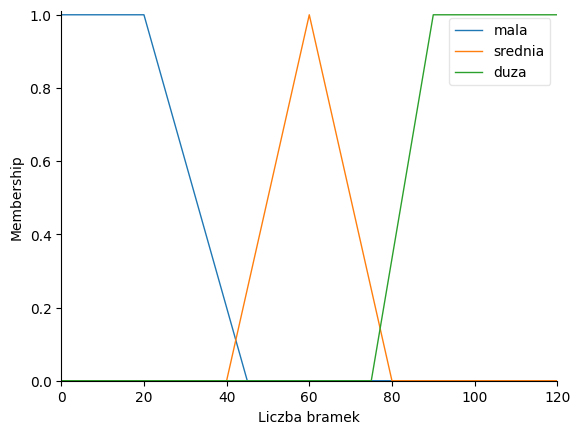

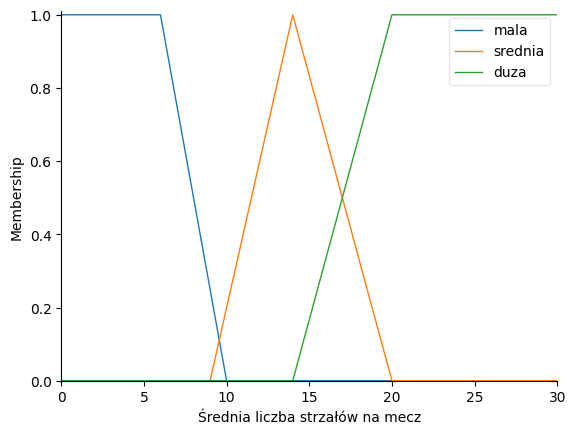

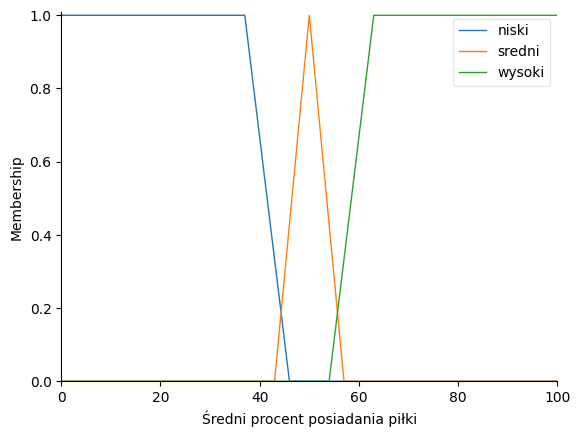

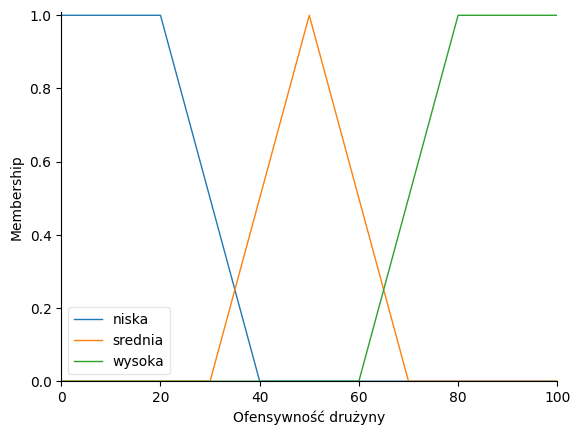

In [ ]:
goals.view()
shots_per_game.view()
possession.view()
offensiveness.view()

Definicja reguł rozmytych

In [ ]:
rules = []

# defensywna drużyna kontratakująca z minimalnym posiadaniem piłki i liczbą strzałów
rules.append(ctrl.Rule(goals['mala'] & shots_per_game['mala'] & possession['niski'], offensiveness['niska']))
# drużyna defensywna, dobrze kontrolująca piłkę, ale bez skuteczności strzeleckiej
rules.append(ctrl.Rule(goals['mala'] & shots_per_game['mala'] & possession['sredni'], offensiveness['niska']))
# defensywna drużyna dominująca w posiadaniu piłki, ale bez efektywnego ataku
rules.append(ctrl.Rule(goals['mala'] & shots_per_game['mala'] & possession['wysoki'], offensiveness['srednia']))

# średnio skuteczna drużyna kontratakująca, z umiarkowaną liczbą strzałów i niskim posiadaniem piłki
rules.append(ctrl.Rule(goals['mala'] & shots_per_game['srednia'] & possession['niski'], offensiveness['niska']))
# średnio skuteczna drużyna kontrolująca piłkę przy umiarkowanej liczbie strzałów
rules.append(ctrl.Rule(goals['mala'] & shots_per_game['srednia'] & possession['sredni'], offensiveness['srednia']))
# średnio skuteczna drużyna dominująca w posiadaniu piłki, ale z przeciętną liczbą strzałów
rules.append(ctrl.Rule(goals['mala'] & shots_per_game['srednia'] & possession['wysoki'], offensiveness['srednia']))

# drużyna oddająca dużo strzałów, ale nieskuteczna w bramkach, przy niskim posiadaniu piłki
rules.append(ctrl.Rule(goals['mala'] & shots_per_game['duza'] & possession['niski'], offensiveness['srednia']))
# drużyna z dużą liczbą strzałów i umiarkowanym posiadaniem piłki, ale bez skuteczności
rules.append(ctrl.Rule(goals['mala'] & shots_per_game['duza'] & possession['sredni'], offensiveness['srednia']))
# drużyna dominująca w posiadaniu piłki i strzałach, ale wciąż nieskuteczna w bramkach
rules.append(ctrl.Rule(goals['mala'] & shots_per_game['duza'] & possession['wysoki'], offensiveness['wysoka']))

# zrównoważona drużyna osiągająca średnie wyniki przy niskim poziomie strzałów i posiadania piłki
rules.append(ctrl.Rule(goals['srednia'] & shots_per_game['mala'] & possession['niski'], offensiveness['niska']))
# zrównoważona drużyna osiągająca średnie wyniki z umiarkowanym posiadaniem piłki
rules.append(ctrl.Rule(goals['srednia'] & shots_per_game['mala'] & possession['sredni'], offensiveness['srednia']))
# zrównoważona drużyna dominująca w posiadaniu piłki, ale z przeciętną liczbą bramek
rules.append(ctrl.Rule(goals['srednia'] & shots_per_game['mala'] & possession['wysoki'], offensiveness['srednia']))

# drużyna dobrze strzelająca i kontrolująca grę, z umiarkowaną liczbą strzałów i niskim posiadaniem
rules.append(ctrl.Rule(goals['srednia'] & shots_per_game['srednia'] & possession['niski'], offensiveness['srednia']))
# drużyna dobrze strzelająca i kontrolująca grę przy zrównoważonym posiadaniu piłki
rules.append(ctrl.Rule(goals['srednia'] & shots_per_game['srednia'] & possession['sredni'], offensiveness['srednia']))
# drużyna dominująca w posiadaniu piłki, dobrze strzelająca, z przewagą ofensywną
rules.append(ctrl.Rule(goals['srednia'] & shots_per_game['srednia'] & possession['wysoki'], offensiveness['wysoka']))

# drużyna o ofensywnym stylu gry, z dużą liczbą strzałów i niskim posiadaniem piłki
rules.append(ctrl.Rule(goals['srednia'] & shots_per_game['duza'] & possession['niski'], offensiveness['srednia']))
# drużyna ofensywna z dużą liczbą strzałów i umiarkowanym posiadaniem piłki
rules.append(ctrl.Rule(goals['srednia'] & shots_per_game['duza'] & possession['sredni'], offensiveness['wysoka']))
# drużyna ofensywna dominująca w posiadaniu piłki i strzałach
rules.append(ctrl.Rule(goals['srednia'] & shots_per_game['duza'] & possession['wysoki'], offensiveness['wysoka']))

# bardzo skuteczna drużyna, zdobywająca dużo bramek przy niskim posiadaniu piłki i liczbie strzałów
rules.append(ctrl.Rule(goals['duza'] & shots_per_game['mala'] & possession['niski'], offensiveness['srednia']))
# bardzo skuteczna drużyna z umiarkowanym posiadaniem piłki i małą liczbą strzałów
rules.append(ctrl.Rule(goals['duza'] & shots_per_game['mala'] & possession['sredni'], offensiveness['srednia']))
# Bardzo skuteczna drużyna dominująca w posiadaniu piłki przy minimalnej liczbie strzałów
rules.append(ctrl.Rule(goals['duza'] & shots_per_game['mala'] & possession['wysoki'], offensiveness['wysoka']))

# bardzo skuteczna drużyna z balansem w strzałach i posiadaniu piłki, osiągająca wysoką efektywność
rules.append(ctrl.Rule(goals['duza'] & shots_per_game['srednia'] & possession['niski'], offensiveness['srednia']))
# bardzo skuteczna drużyna, z dużą liczbą strzałów i umiarkowanym posiadaniem piłki
rules.append(ctrl.Rule(goals['duza'] & shots_per_game['srednia'] & possession['sredni'], offensiveness['wysoka']))
# bardzo skuteczna drużyna dominująca w każdej fazie gry: strzałach, bramkach i posiadaniu piłki
rules.append(ctrl.Rule(goals['duza'] & shots_per_game['srednia'] & possession['wysoki'], offensiveness['wysoka']))

# dominująca drużyna, z dużą liczbą strzałów na bramkę i goli, oraz nisim posiadaniem piłki
rules.append(ctrl.Rule(goals['duza'] & shots_per_game['duza'] & possession['niski'], offensiveness['wysoka']))
# dominująca drużyna, z dużą liczbą strzałów na bramkę i umiarkowanym posiadaniem piłki
rules.append(ctrl.Rule(goals['duza'] & shots_per_game['duza'] & possession['sredni'], offensiveness['wysoka']))
# dominująca drużyna w każdym aspekcie: bramkach, strzałach i posiadaniu piłki, osiągająca najwyższą skuteczność w każdej fazie gry
rules.append(ctrl.Rule(goals['duza'] & shots_per_game['duza'] & possession['wysoki'], offensiveness['wysoka']))

print(f'Liczba reguł: {len(rules)}')

Liczba reguł: 27


Tworzenie systemu sterowania

In [ ]:
offensiveness_ctrl = ctrl.ControlSystem(rules) # tworzenie systemu
offensiveness_ctrl_simulation = ctrl.ControlSystemSimulation(offensiveness_ctrl) # umożliwienie symulacji

<h3>Symulacja dla rekordów wczytanych z pliku</h3>

Wiersz 1: Manchester City (Premier League)
Ofensywność drużyny = 82.5299145299145 [%]
  Przynależność (Membership):
  Liczba bramek (83): mala=0.0, srednia=0.0, duza=0.5333333333333333
  Średnia liczba strzałów na mecz (15.8): mala=0.0, srednia=0.6999999999999998, duza=0.3000000000000001
  Średni procent posiadania piłki (60.8): niski=0.0, sredni=0.0, wysoki=0.7555555555555552



<Figure size 1000x600 with 0 Axes>

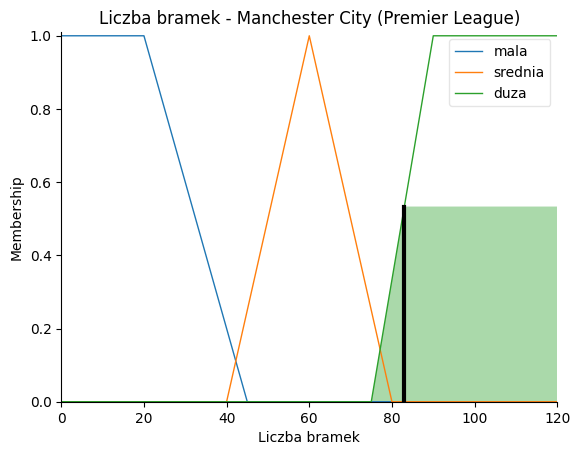

<Figure size 1000x600 with 0 Axes>

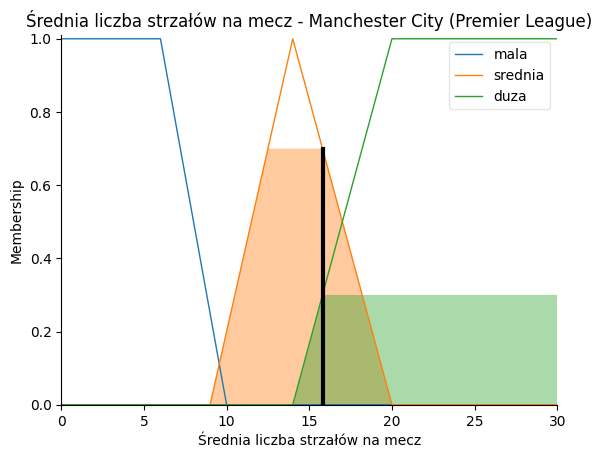

<Figure size 1000x600 with 0 Axes>

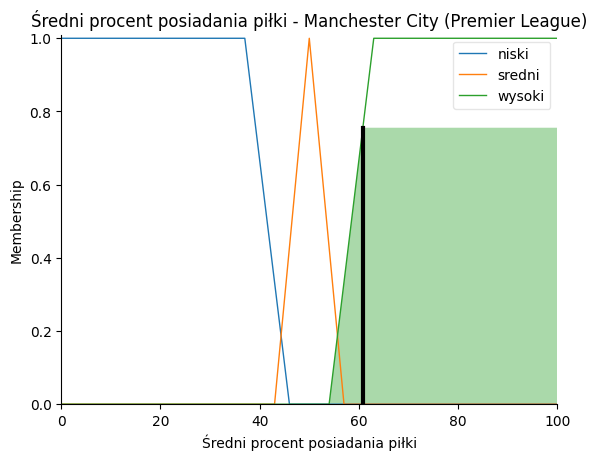

<Figure size 1000x600 with 0 Axes>

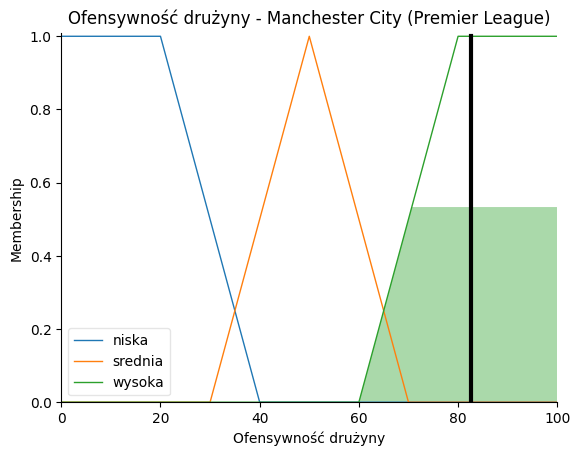

Wiersz 2: Bayern Munich (Bundesliga)
Ofensywność drużyny = 82.18019273191688 [%]
  Przynależność (Membership):
  Liczba bramek (99): mala=0.0, srednia=0.0, duza=1.0
  Średnia liczba strzałów na mecz (17.1): mala=0.0, srednia=0.4833333333333331, duza=0.5166666666666669
  Średni procent posiadania piłki (58.1): niski=0.0, sredni=0.0, wysoki=0.4555555555555557



<Figure size 1000x600 with 0 Axes>

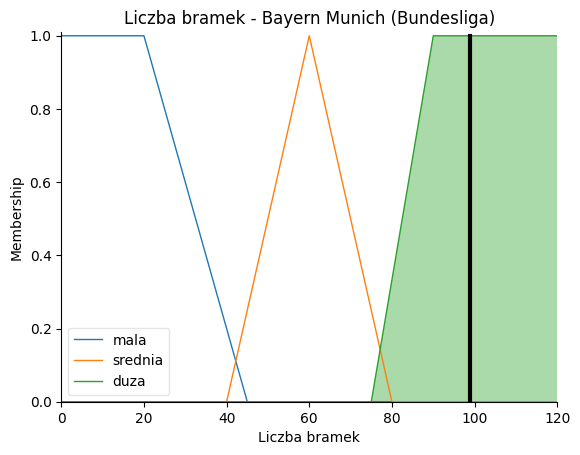

<Figure size 1000x600 with 0 Axes>

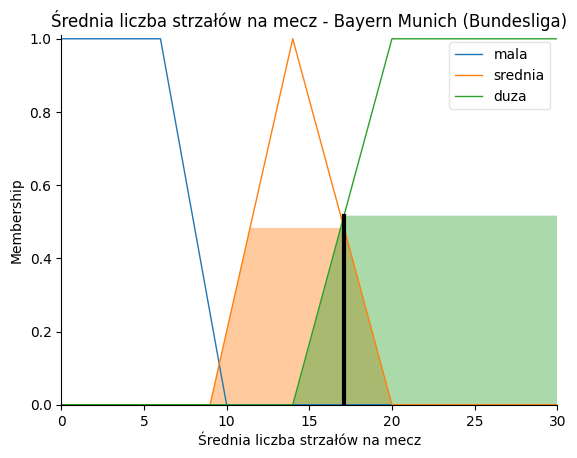

<Figure size 1000x600 with 0 Axes>

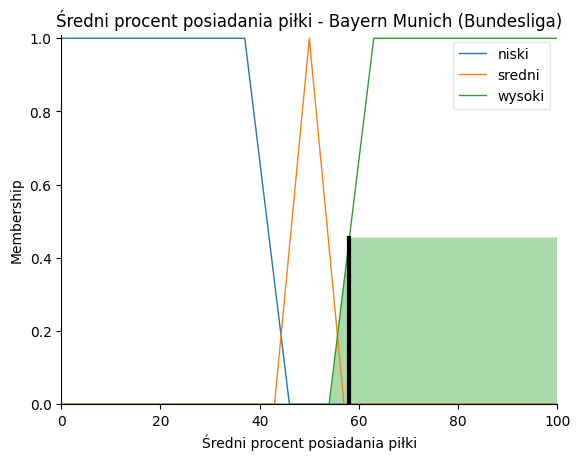

<Figure size 1000x600 with 0 Axes>

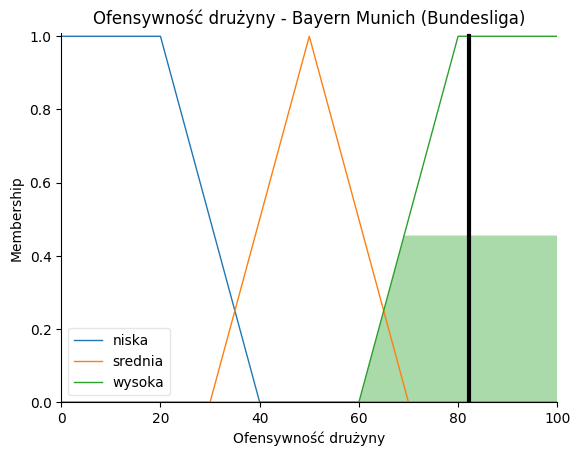

Wiersz 3: Paris Saint-Germain (Ligue 1)
Ofensywność drużyny = 83.15842933234242 [%]
  Przynależność (Membership):
  Liczba bramek (86): mala=0.0, srednia=0.0, duza=0.7333333333333333
  Średnia liczba strzałów na mecz (15.0): mala=0.0, srednia=0.8333333333333334, duza=0.16666666666666666
  Średni procent posiadania piłki (60.1): niski=0.0, sredni=0.0, wysoki=0.6777777777777779



<Figure size 1000x600 with 0 Axes>

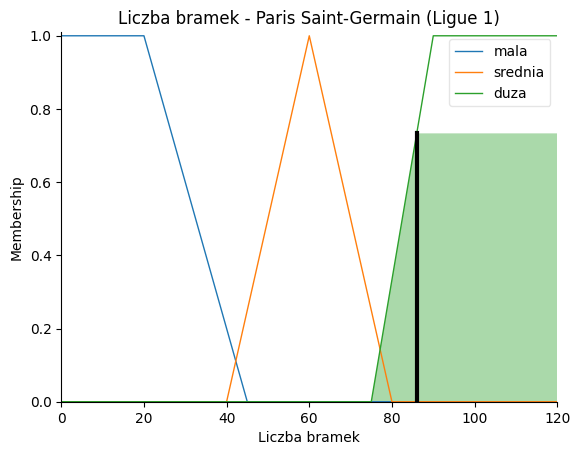

<Figure size 1000x600 with 0 Axes>

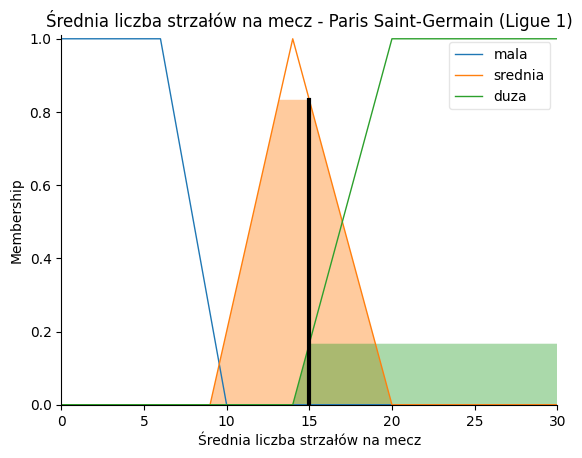

<Figure size 1000x600 with 0 Axes>

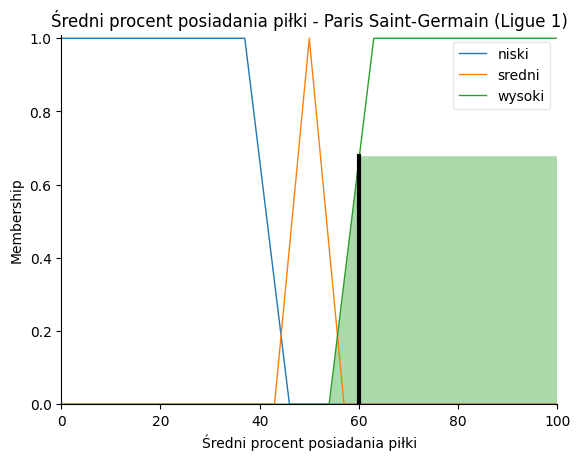

<Figure size 1000x600 with 0 Axes>

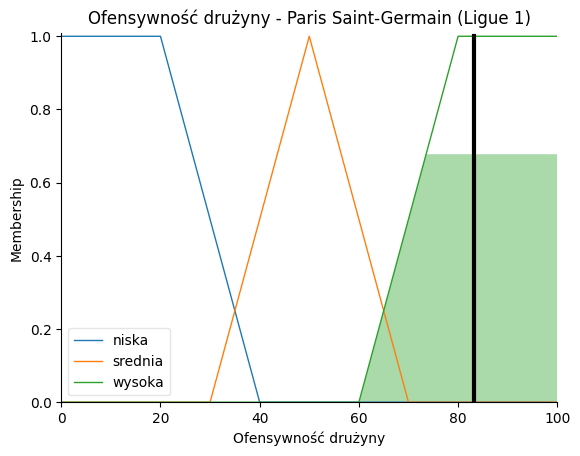

Wiersz 4: Barcelona (LaLiga)
Ofensywność drużyny = 83.11111111111109 [%]
  Przynależność (Membership):
  Liczba bramek (85): mala=0.0, srednia=0.0, duza=0.6666666666666666
  Średnia liczba strzałów na mecz (15.3): mala=0.0, srednia=0.7833333333333332, duza=0.21666666666666679
  Średni procent posiadania piłki (62.4): niski=0.0, sredni=0.0, wysoki=0.9333333333333332



<Figure size 1000x600 with 0 Axes>

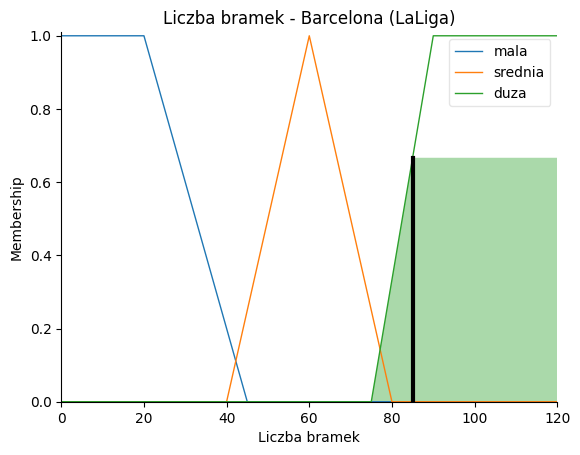

<Figure size 1000x600 with 0 Axes>

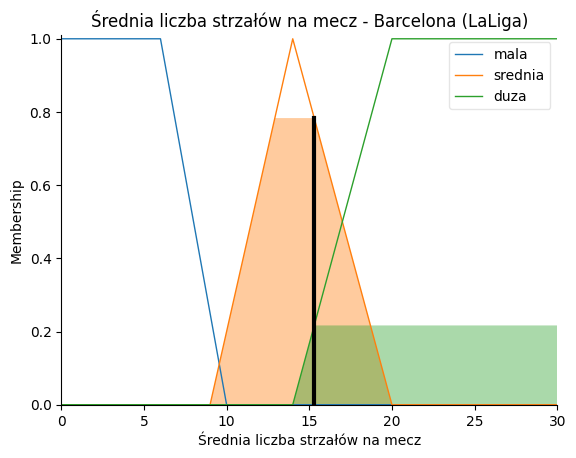

<Figure size 1000x600 with 0 Axes>

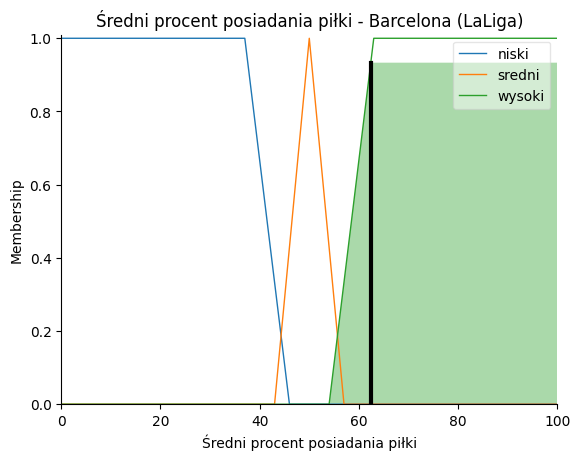

<Figure size 1000x600 with 0 Axes>

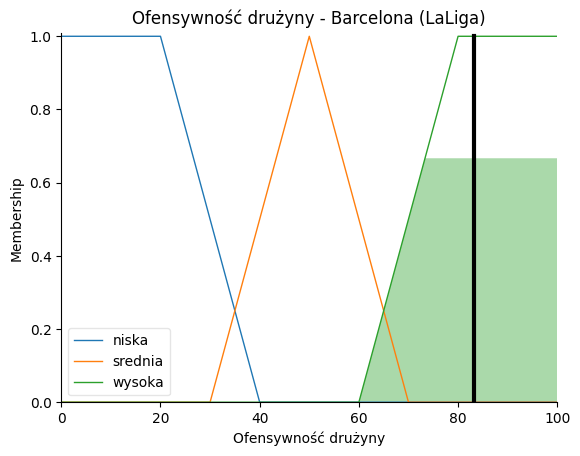

Wiersz 5: Real Madrid (LaLiga)
Ofensywność drużyny = 81.97706685013185 [%]
  Przynależność (Membership):
  Liczba bramek (67): mala=0.0, srednia=0.65, duza=0.0
  Średnia liczba strzałów na mecz (14.4): mala=0.0, srednia=0.9333333333333332, duza=0.06666666666666672
  Średni procent posiadania piłki (57.7): niski=0.0, sredni=0.0, wysoki=0.4111111111111114



<Figure size 1000x600 with 0 Axes>

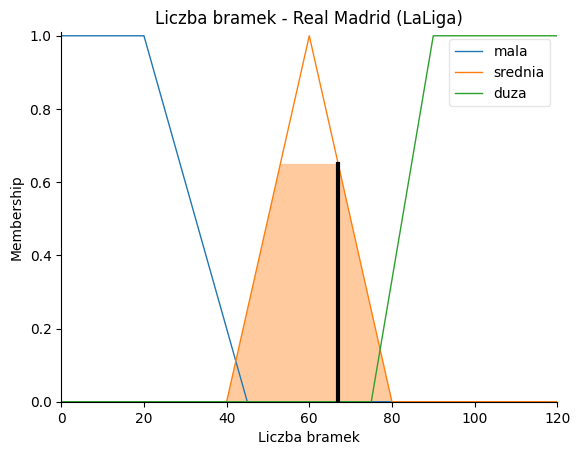

<Figure size 1000x600 with 0 Axes>

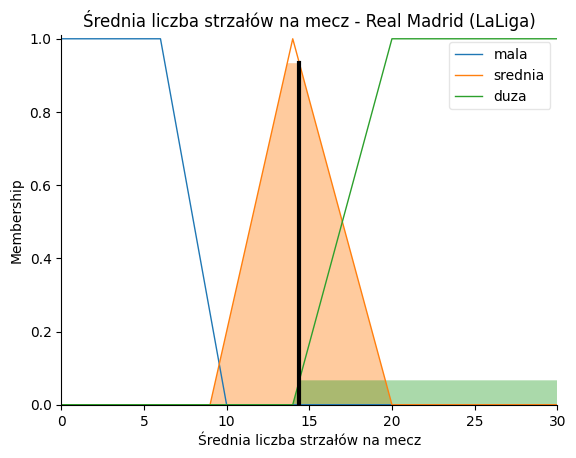

<Figure size 1000x600 with 0 Axes>

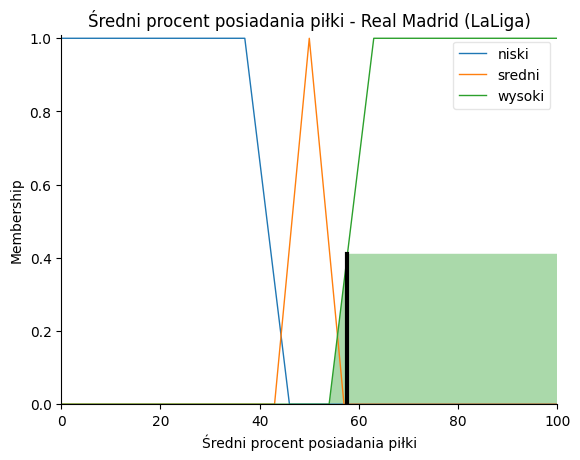

<Figure size 1000x600 with 0 Axes>

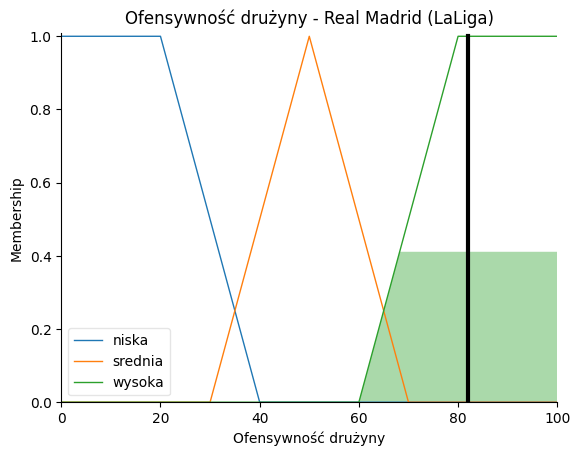

Wiersz 6: Manchester United (Premier League)
Ofensywność drużyny = 54.45171208944798 [%]
  Przynależność (Membership):
  Liczba bramek (73): mala=0.0, srednia=0.35, duza=0.0
  Średnia liczba strzałów na mecz (13.8): mala=0.0, srednia=0.9600000000000002, duza=0.0
  Średni procent posiadania piłki (54.5): niski=0.0, sredni=0.35714285714285715, wysoki=0.05555555555555555



<Figure size 1000x600 with 0 Axes>

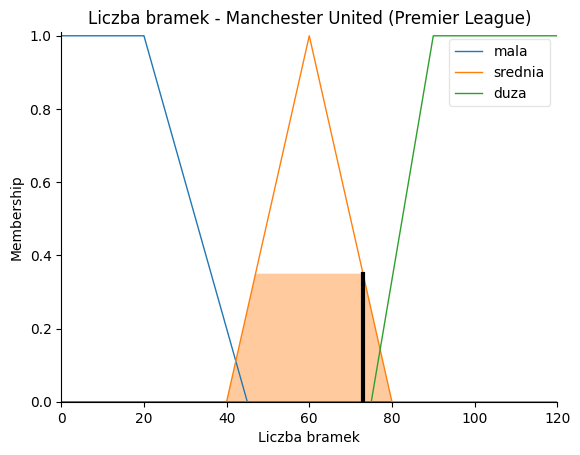

<Figure size 1000x600 with 0 Axes>

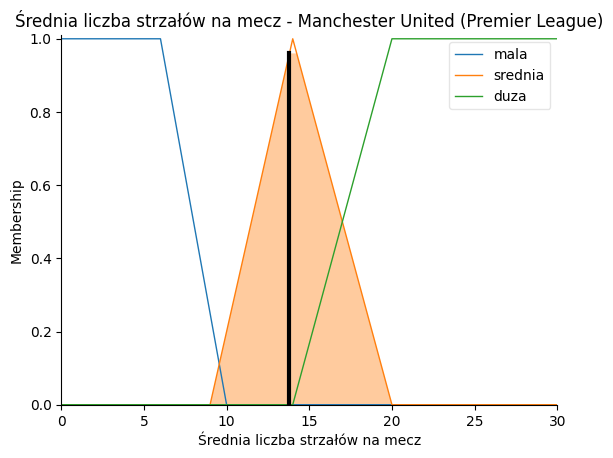

<Figure size 1000x600 with 0 Axes>

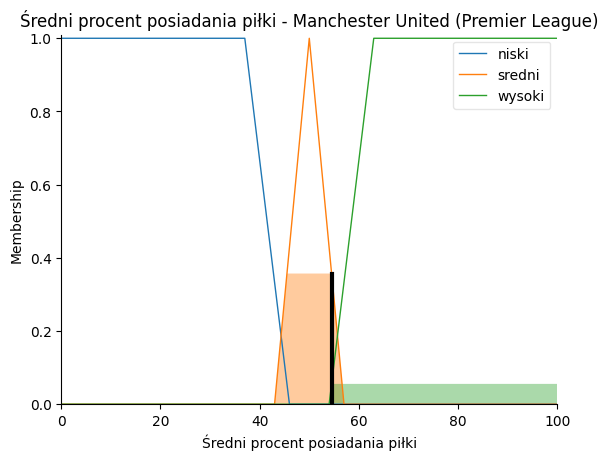

<Figure size 1000x600 with 0 Axes>

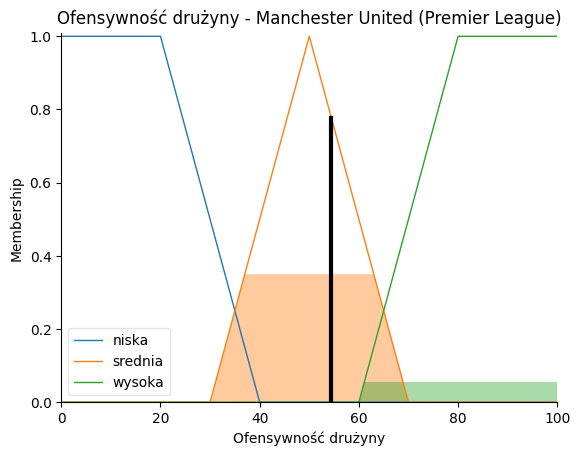

Wiersz 7: Juventus (Serie A)
Ofensywność drużyny = 65.74452554744518 [%]
  Przynależność (Membership):
  Liczba bramek (77): mala=0.0, srednia=0.15, duza=0.13333333333333333
  Średnia liczba strzałów na mecz (15.7): mala=0.0, srednia=0.7166666666666668, duza=0.2833333333333332
  Średni procent posiadania piłki (55.4): niski=0.0, sredni=0.2285714285714288, wysoki=0.15555555555555542



<Figure size 1000x600 with 0 Axes>

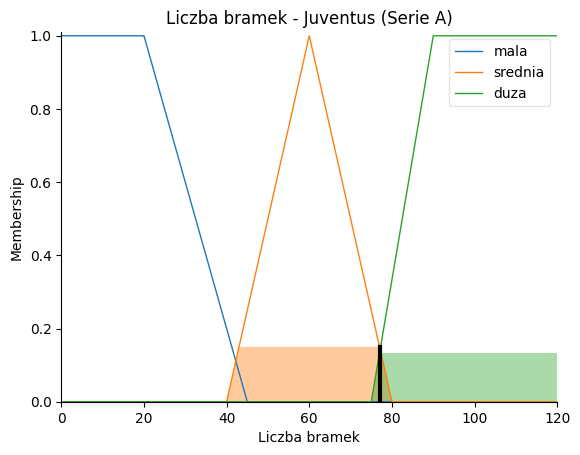

<Figure size 1000x600 with 0 Axes>

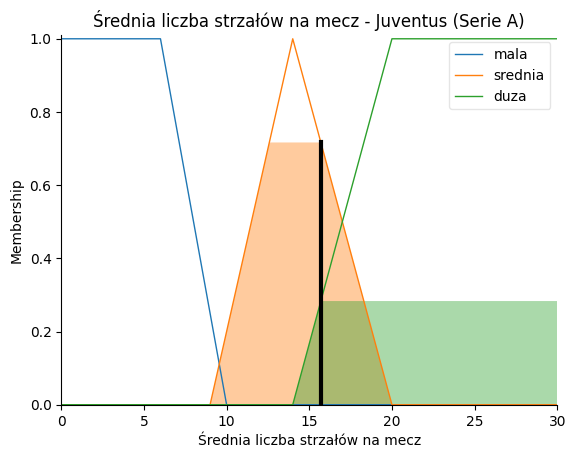

<Figure size 1000x600 with 0 Axes>

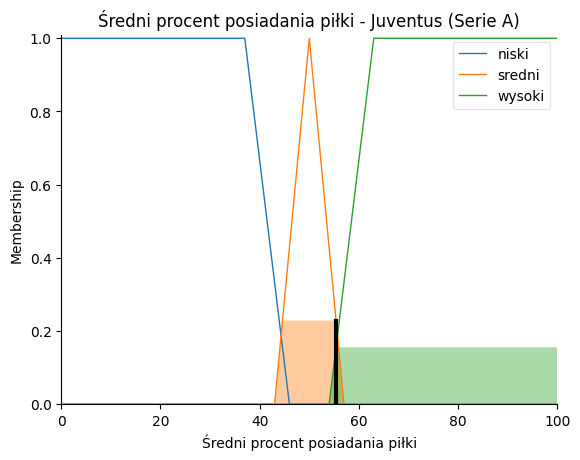

<Figure size 1000x600 with 0 Axes>

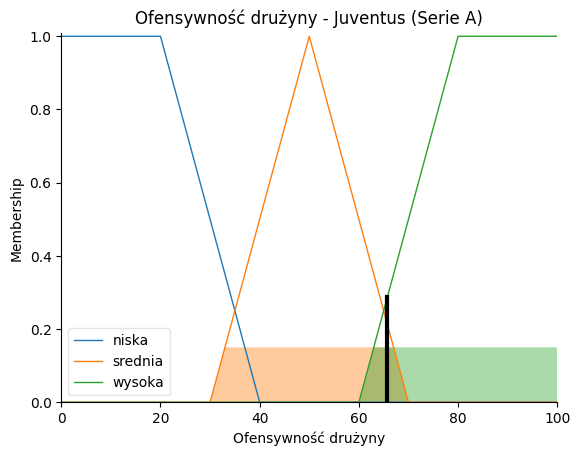

Wiersz 8: Aston Villa (Premier League)
Ofensywność drużyny = 49.99999999999999 [%]
  Przynależność (Membership):
  Liczba bramek (55): mala=0.0, srednia=0.75, duza=0.0
  Średnia liczba strzałów na mecz (13.7): mala=0.0, srednia=0.9399999999999998, duza=0.0
  Średni procent posiadania piłki (49.1): niski=0.0, sredni=0.8714285714285717, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

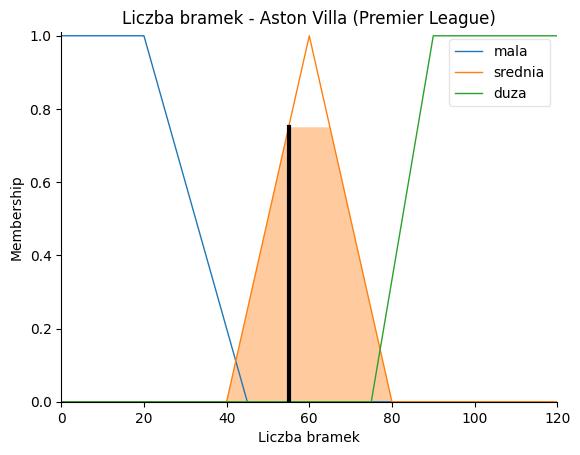

<Figure size 1000x600 with 0 Axes>

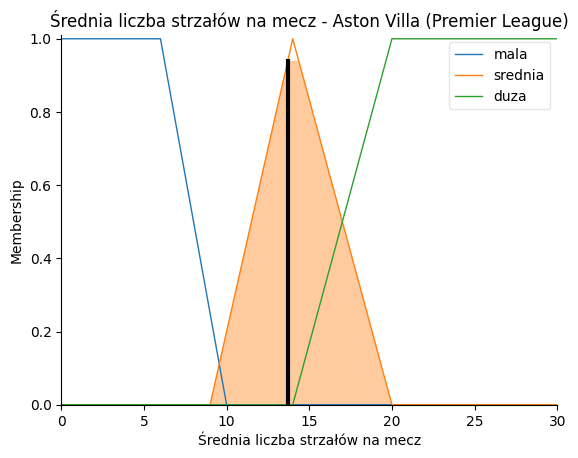

<Figure size 1000x600 with 0 Axes>

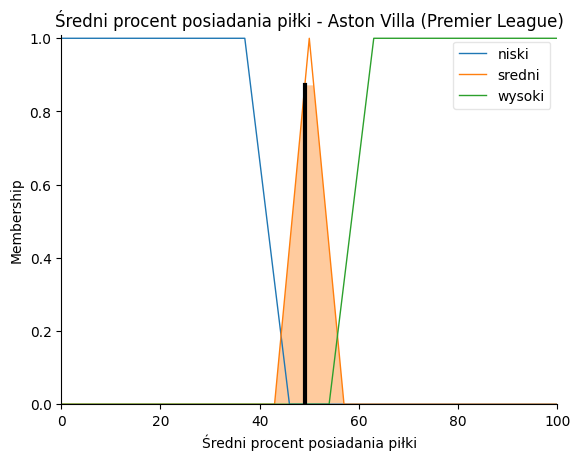

<Figure size 1000x600 with 0 Axes>

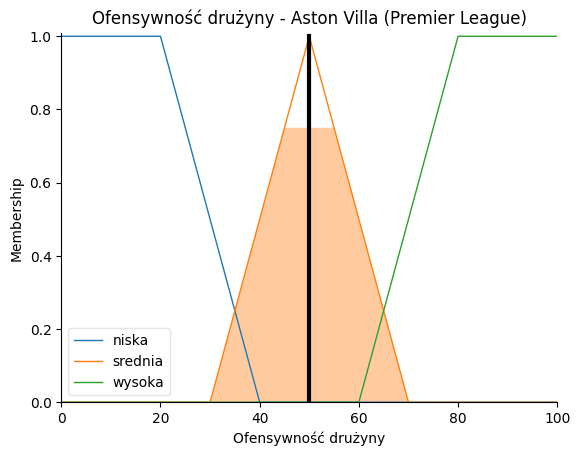

Wiersz 9: Borussia Dortmund (Bundesliga)
Ofensywność drużyny = 81.22222222222223 [%]
  Przynależność (Membership):
  Liczba bramek (75): mala=0.0, srednia=0.25, duza=0.0
  Średnia liczba strzałów na mecz (14.6): mala=0.0, srednia=0.9000000000000001, duza=0.09999999999999995
  Średni procent posiadania piłki (57.5): niski=0.0, sredni=0.0, wysoki=0.3888888888888889



<Figure size 1000x600 with 0 Axes>

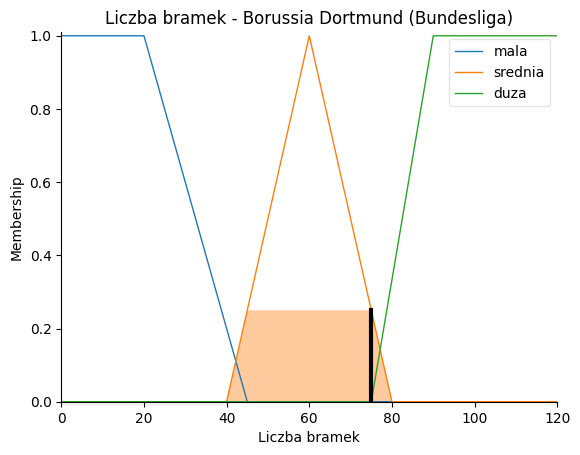

<Figure size 1000x600 with 0 Axes>

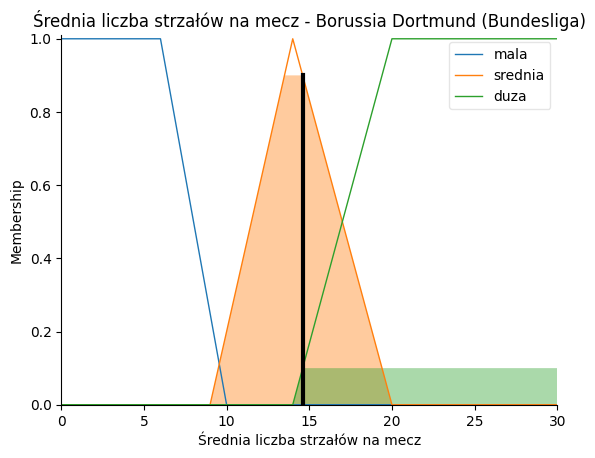

<Figure size 1000x600 with 0 Axes>

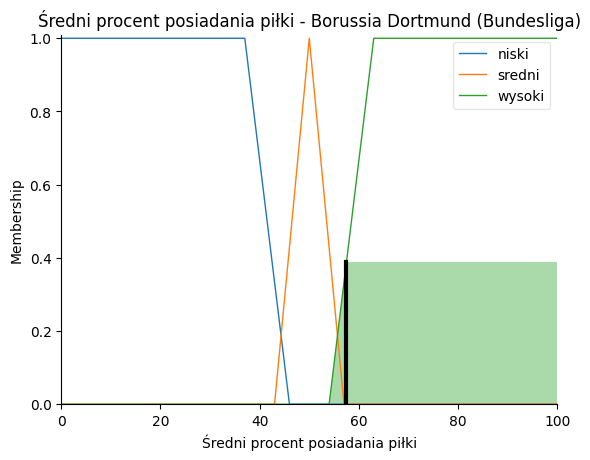

<Figure size 1000x600 with 0 Axes>

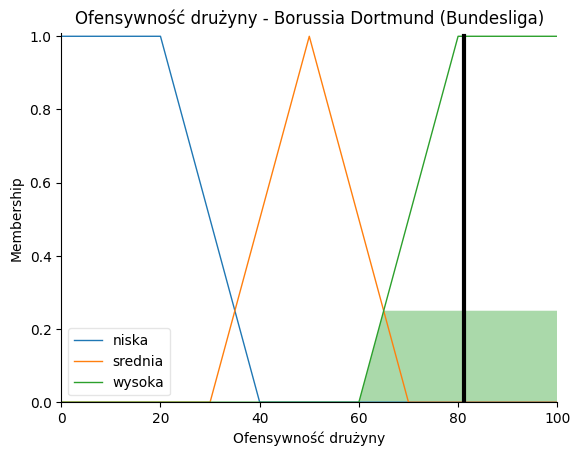

Wiersz 10: Atletico Madrid (LaLiga)
Ofensywność drużyny = 50.0 [%]
  Przynależność (Membership):
  Liczba bramek (67): mala=0.0, srednia=0.65, duza=0.0
  Średnia liczba strzałów na mecz (12.1): mala=0.0, srednia=0.62, duza=0.0
  Średni procent posiadania piłki (51.8): niski=0.0, sredni=0.7428571428571432, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

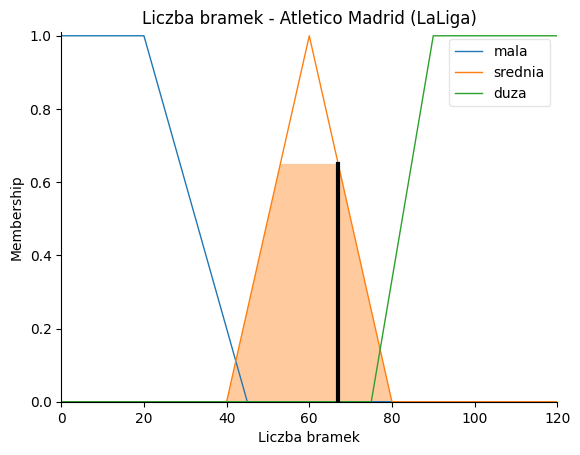

<Figure size 1000x600 with 0 Axes>

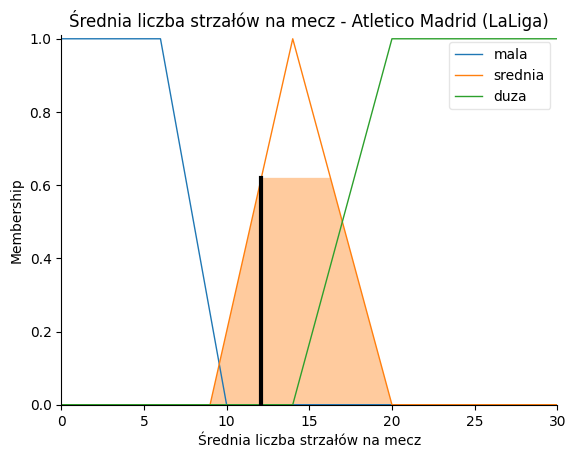

<Figure size 1000x600 with 0 Axes>

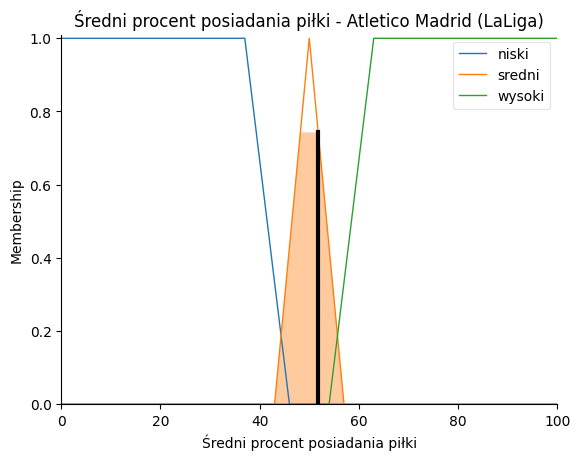

<Figure size 1000x600 with 0 Axes>

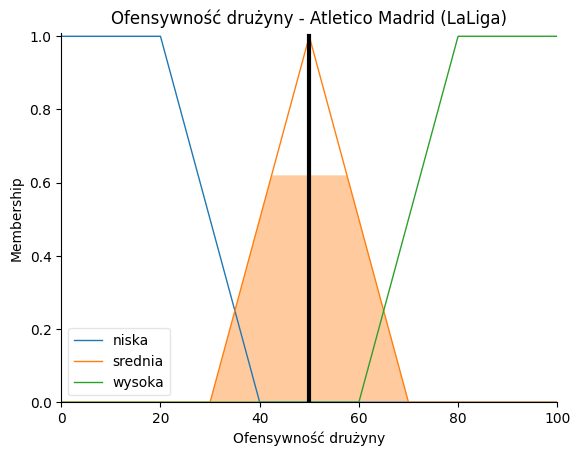

Wiersz 11: Atalanta (Serie A)
Ofensywność drużyny = 82.38095238095238 [%]
  Przynależność (Membership):
  Liczba bramek (90): mala=0.0, srednia=0.0, duza=1.0
  Średnia liczba strzałów na mecz (16.3): mala=0.0, srednia=0.6166666666666666, duza=0.38333333333333347
  Średni procent posiadania piłki (53.5): niski=0.0, sredni=0.5, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

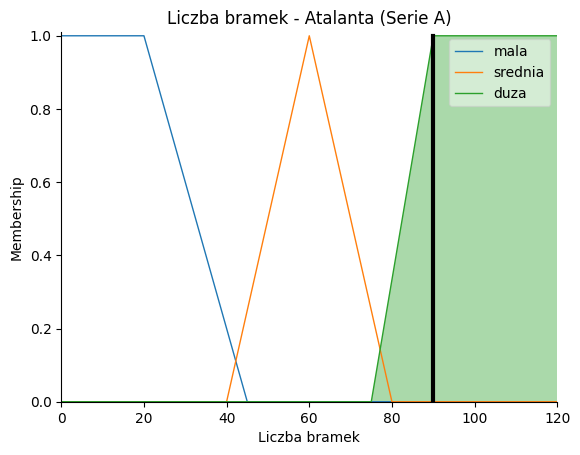

<Figure size 1000x600 with 0 Axes>

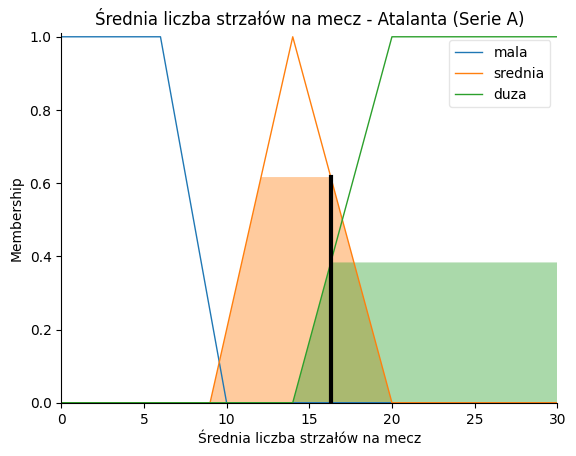

<Figure size 1000x600 with 0 Axes>

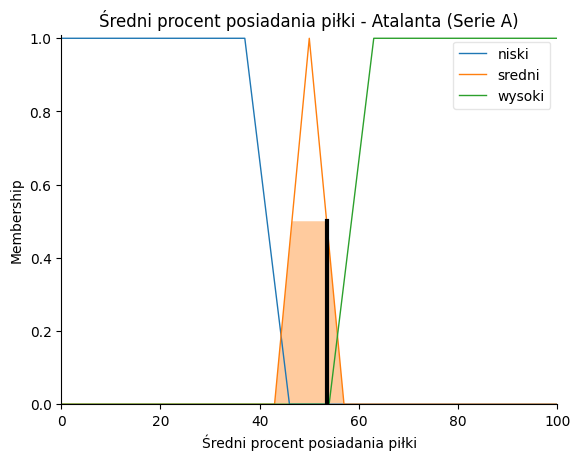

<Figure size 1000x600 with 0 Axes>

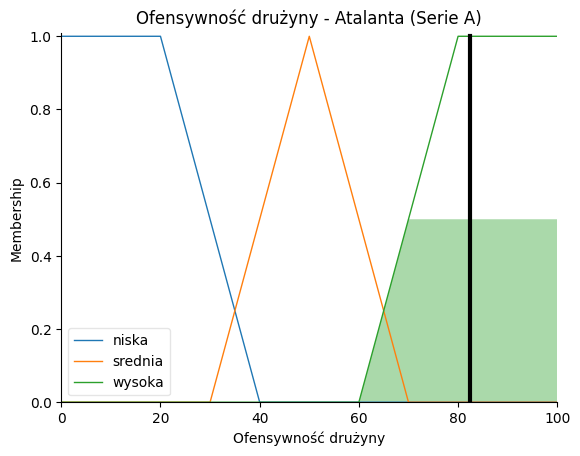

Wiersz 12: Chelsea (Premier League)
Ofensywność drużyny = 82.43076197216325 [%]
  Przynależność (Membership):
  Liczba bramek (58): mala=0.0, srednia=0.9, duza=0.0
  Średnia liczba strzałów na mecz (14.6): mala=0.0, srednia=0.9000000000000001, duza=0.09999999999999995
  Średni procent posiadania piłki (58.6): niski=0.0, sredni=0.0, wysoki=0.5111111111111113



<Figure size 1000x600 with 0 Axes>

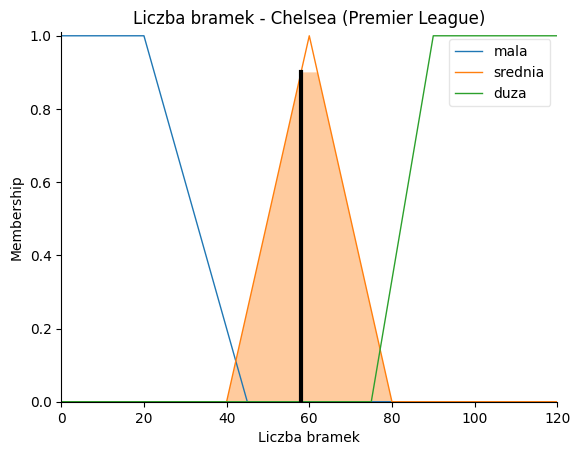

<Figure size 1000x600 with 0 Axes>

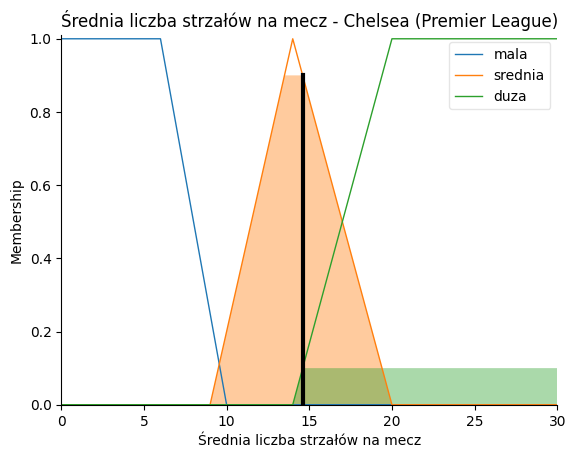

<Figure size 1000x600 with 0 Axes>

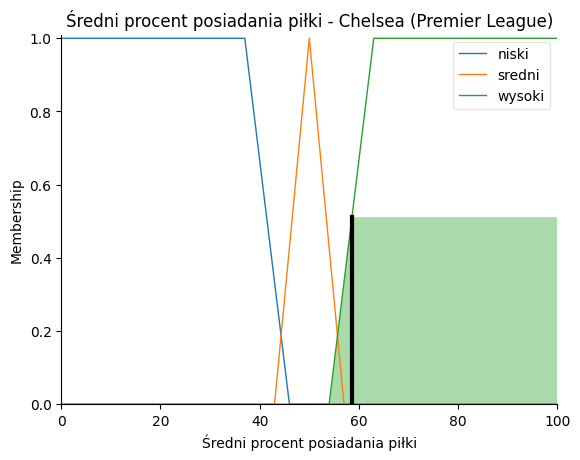

<Figure size 1000x600 with 0 Axes>

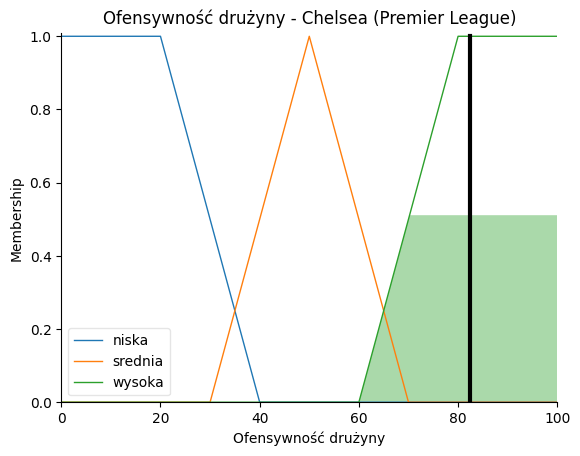

Wiersz 13: Liverpool (Premier League)
Ofensywność drużyny = 82.62843488649938 [%]
  Przynależność (Membership):
  Liczba bramek (68): mala=0.0, srednia=0.6, duza=0.0
  Średnia liczba strzałów na mecz (16.0): mala=0.0, srednia=0.6666666666666666, duza=0.3333333333333333
  Średni procent posiadania piłki (59.0): niski=0.0, sredni=0.0, wysoki=0.5555555555555556



<Figure size 1000x600 with 0 Axes>

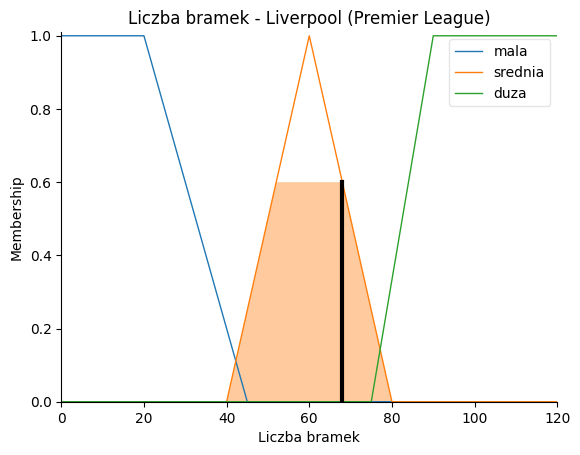

<Figure size 1000x600 with 0 Axes>

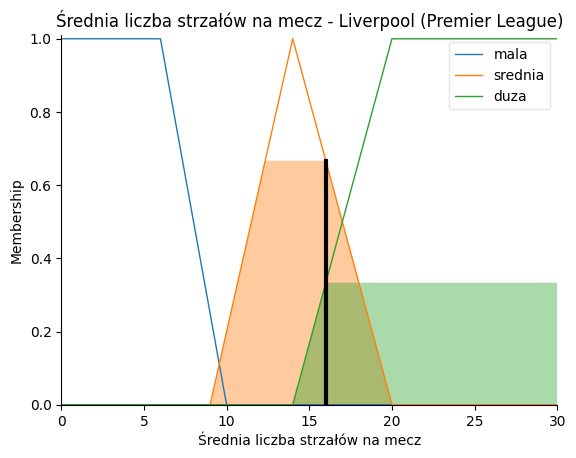

<Figure size 1000x600 with 0 Axes>

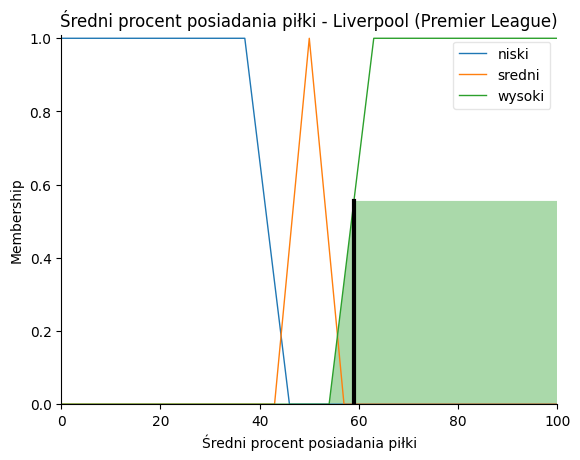

<Figure size 1000x600 with 0 Axes>

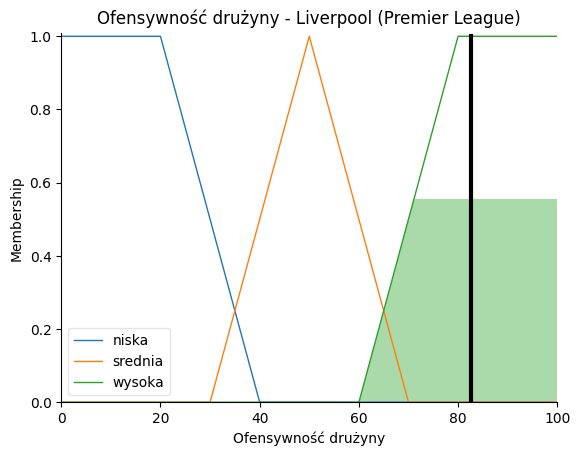

Wiersz 14: AC Milan (Serie A)
Ofensywność drużyny = 59.046156933574075 [%]
  Przynależność (Membership):
  Liczba bramek (74): mala=0.0, srednia=0.3, duza=0.0
  Średnia liczba strzałów na mecz (14.7): mala=0.0, srednia=0.8833333333333335, duza=0.11666666666666656
  Średni procent posiadania piłki (51.4): niski=0.0, sredni=0.8000000000000002, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

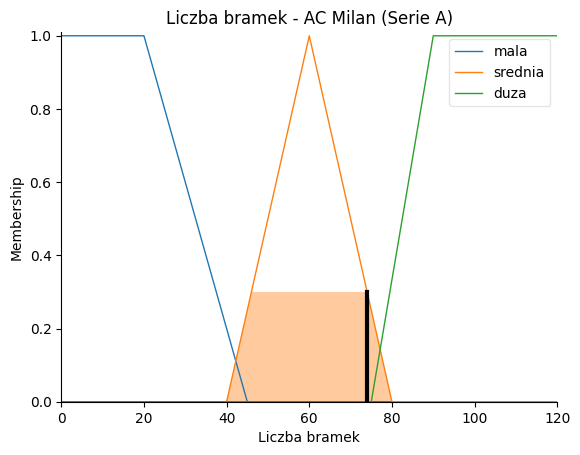

<Figure size 1000x600 with 0 Axes>

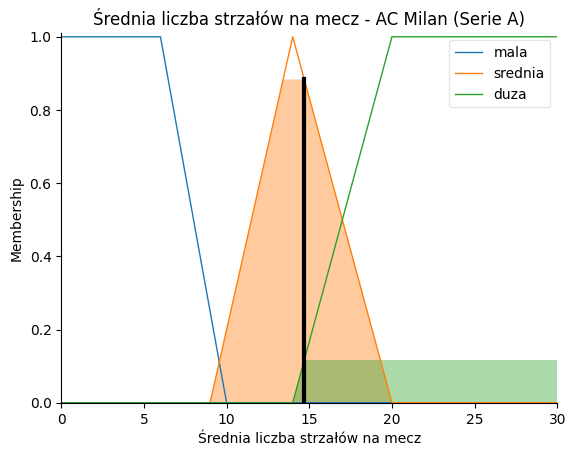

<Figure size 1000x600 with 0 Axes>

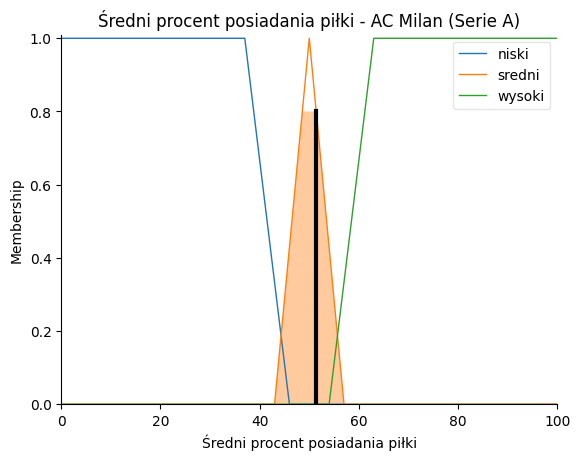

<Figure size 1000x600 with 0 Axes>

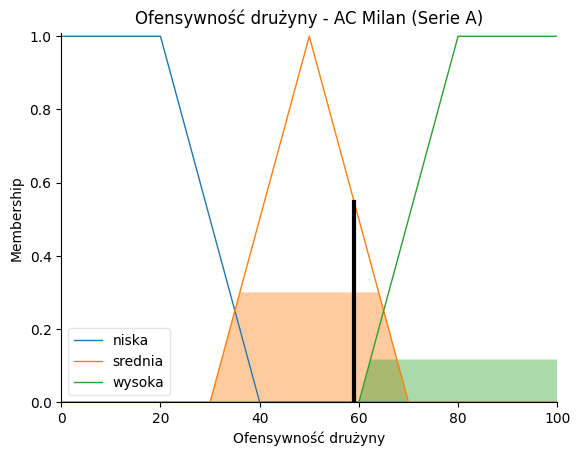

Wiersz 15: Lille (Ligue 1)
Ofensywność drużyny = 50.000000000000014 [%]
  Przynależność (Membership):
  Liczba bramek (64): mala=0.0, srednia=0.8, duza=0.0
  Średnia liczba strzałów na mecz (12.8): mala=0.0, srednia=0.7600000000000001, duza=0.0
  Średni procent posiadania piłki (52.6): niski=0.0, sredni=0.6285714285714283, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

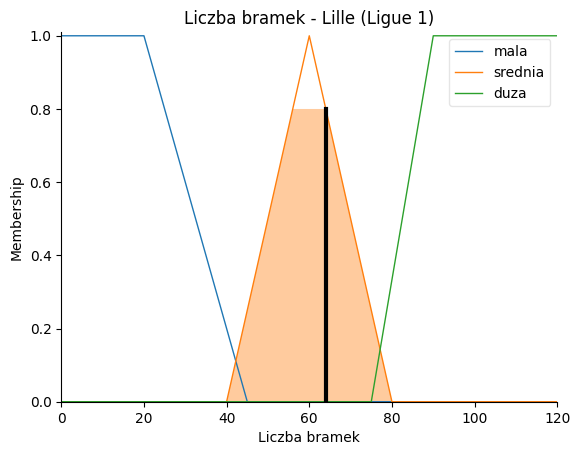

<Figure size 1000x600 with 0 Axes>

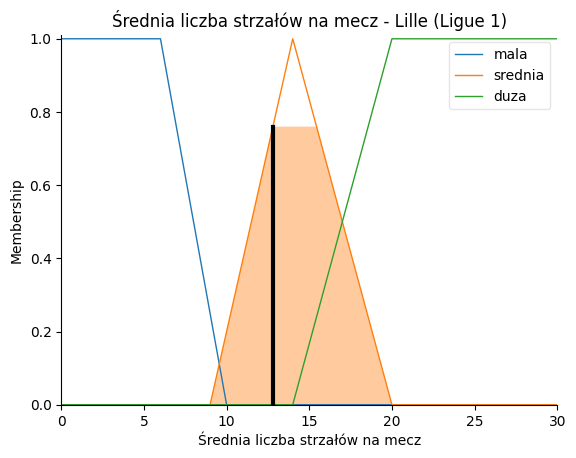

<Figure size 1000x600 with 0 Axes>

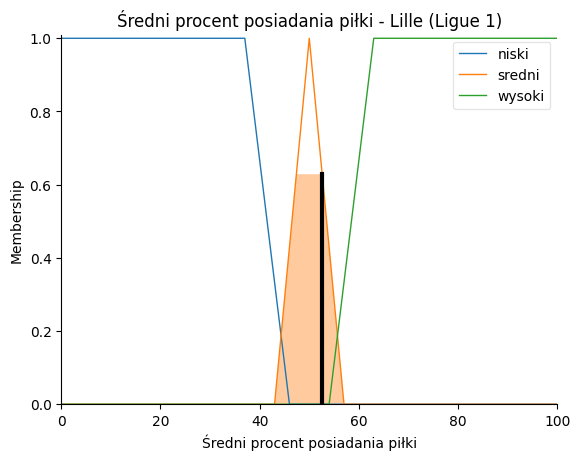

<Figure size 1000x600 with 0 Axes>

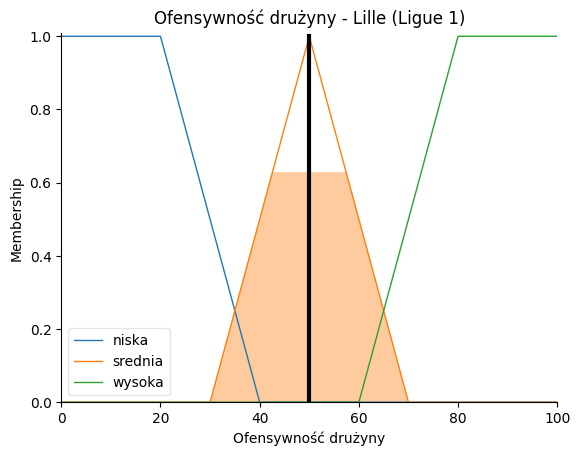

Wiersz 16: Tottenham (Premier League)
Ofensywność drużyny = 50.000000000000014 [%]
  Przynależność (Membership):
  Liczba bramek (68): mala=0.0, srednia=0.6, duza=0.0
  Średnia liczba strzałów na mecz (11.7): mala=0.0, srednia=0.5399999999999999, duza=0.0
  Średni procent posiadania piłki (51.3): niski=0.0, sredni=0.8142857142857147, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

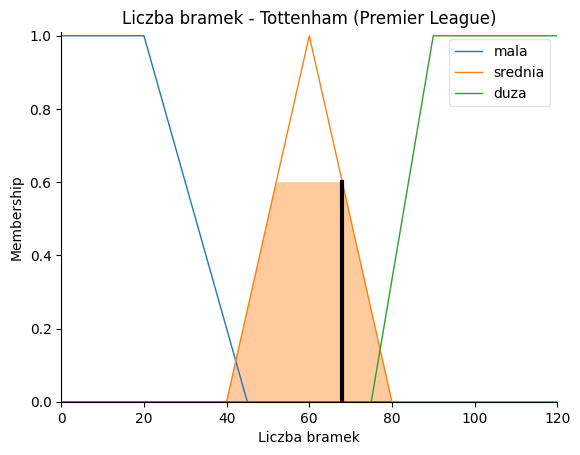

<Figure size 1000x600 with 0 Axes>

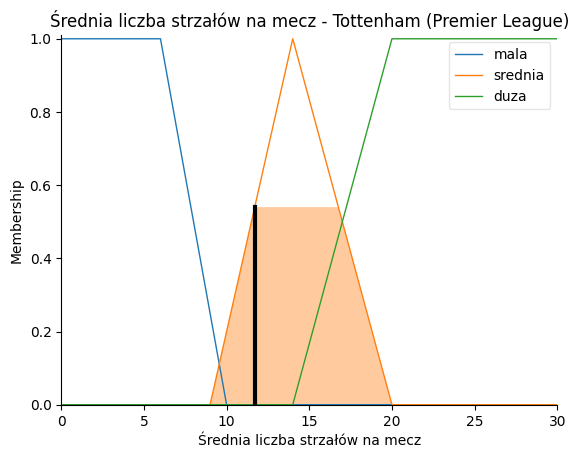

<Figure size 1000x600 with 0 Axes>

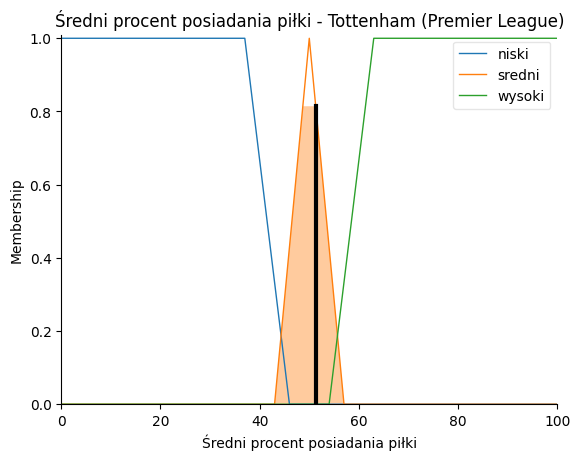

<Figure size 1000x600 with 0 Axes>

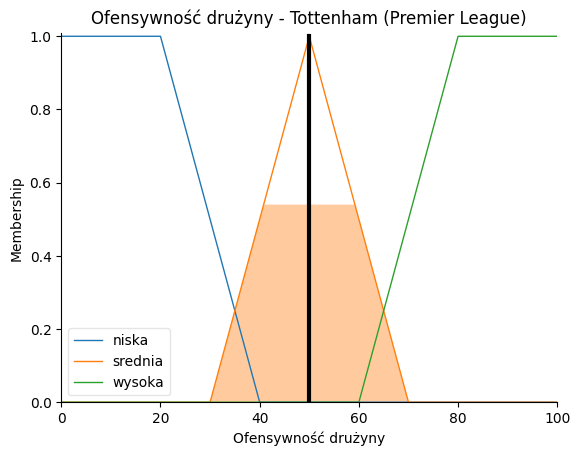

Wiersz 17: Napoli (Serie A)
Ofensywność drużyny = 81.99165243786757 [%]
  Przynależność (Membership):
  Liczba bramek (86): mala=0.0, srednia=0.0, duza=0.7333333333333333
  Średnia liczba strzałów na mecz (17.0): mala=0.0, srednia=0.5, duza=0.5
  Średni procent posiadania piłki (54.1): niski=0.0, sredni=0.4142857142857141, wysoki=0.01111111111111127



<Figure size 1000x600 with 0 Axes>

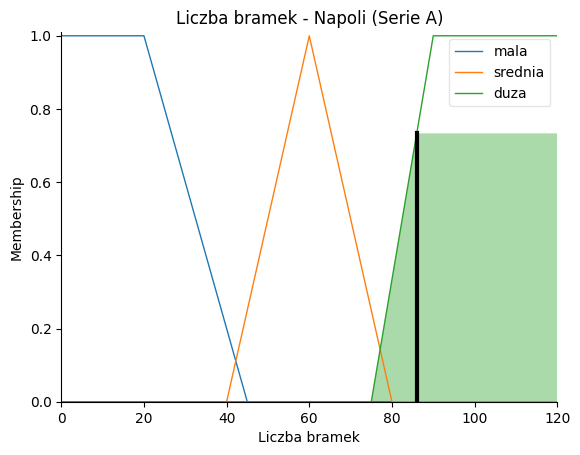

<Figure size 1000x600 with 0 Axes>

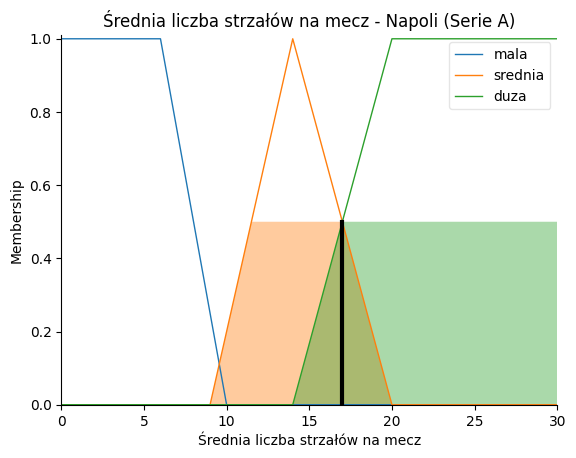

<Figure size 1000x600 with 0 Axes>

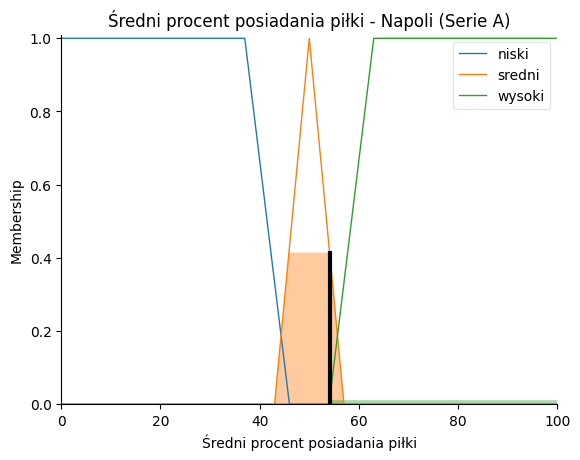

<Figure size 1000x600 with 0 Axes>

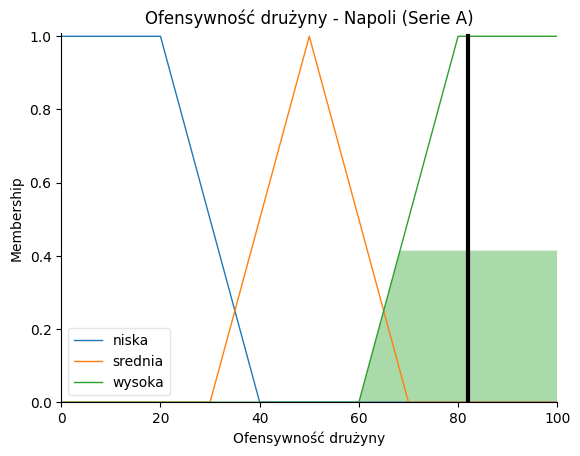

Wiersz 18: Leicester (Premier League)
Ofensywność drużyny = 50.0 [%]
  Przynależność (Membership):
  Liczba bramek (68): mala=0.0, srednia=0.6, duza=0.0
  Średnia liczba strzałów na mecz (12.8): mala=0.0, srednia=0.7600000000000001, duza=0.0
  Średni procent posiadania piłki (53.2): niski=0.0, sredni=0.5428571428571425, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

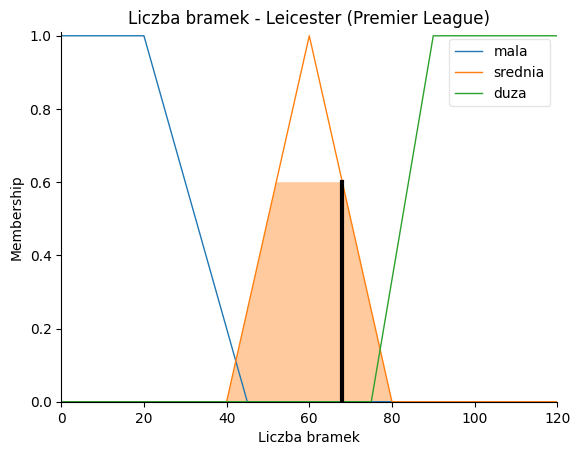

<Figure size 1000x600 with 0 Axes>

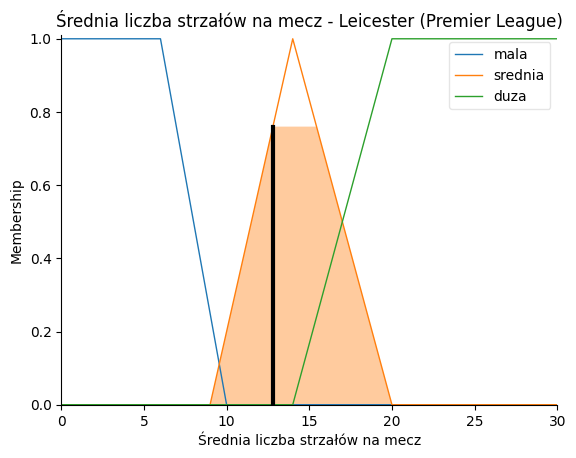

<Figure size 1000x600 with 0 Axes>

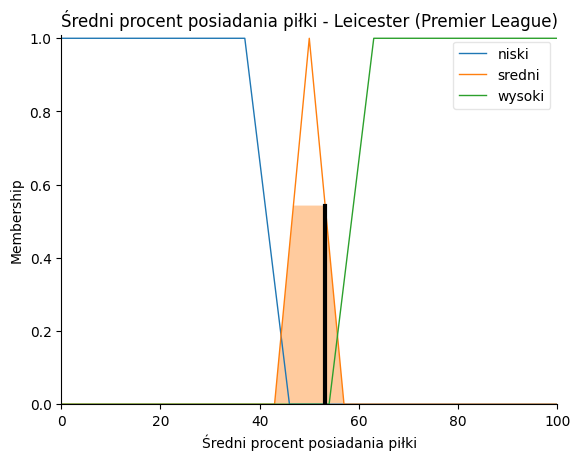

<Figure size 1000x600 with 0 Axes>

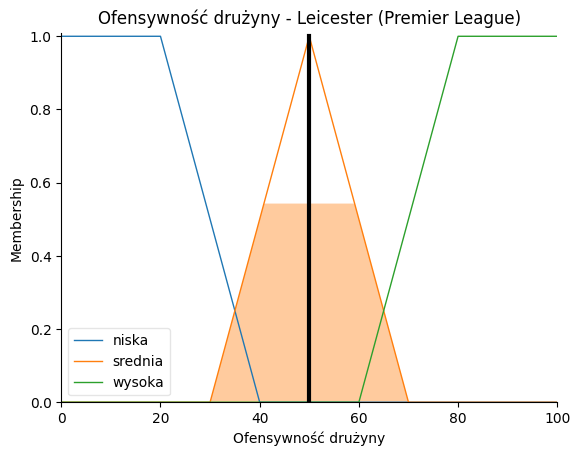

Wiersz 19: Wolfsburg (Bundesliga)
Ofensywność drużyny = 50.878793006681434 [%]
  Przynależność (Membership):
  Liczba bramek (61): mala=0.0, srednia=0.95, duza=0.0
  Średnia liczba strzałów na mecz (14.1): mala=0.0, srednia=0.9833333333333334, duza=0.016666666666666607
  Średni procent posiadania piłki (51.0): niski=0.0, sredni=0.8571428571428571, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

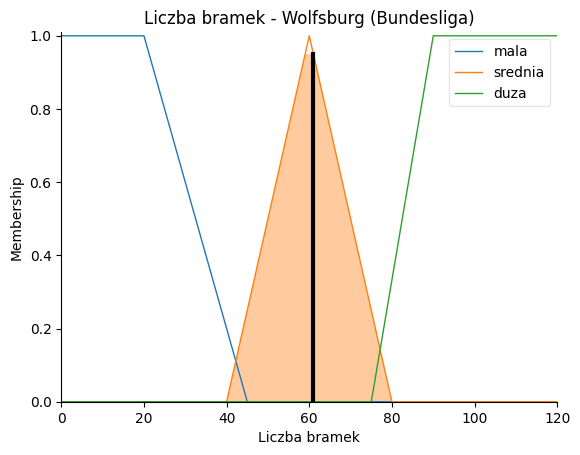

<Figure size 1000x600 with 0 Axes>

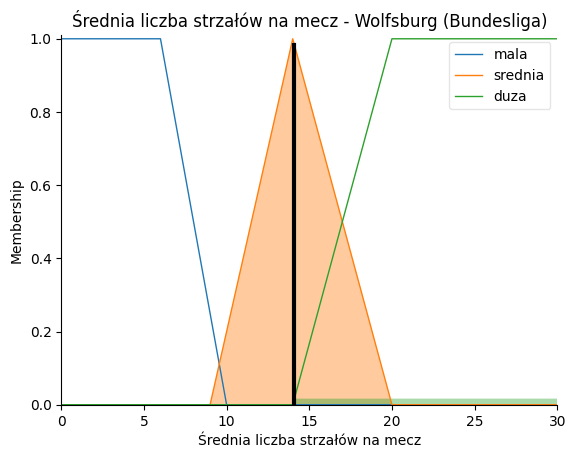

<Figure size 1000x600 with 0 Axes>

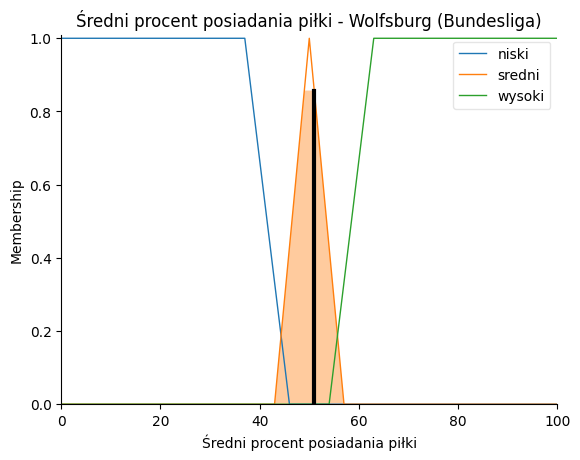

<Figure size 1000x600 with 0 Axes>

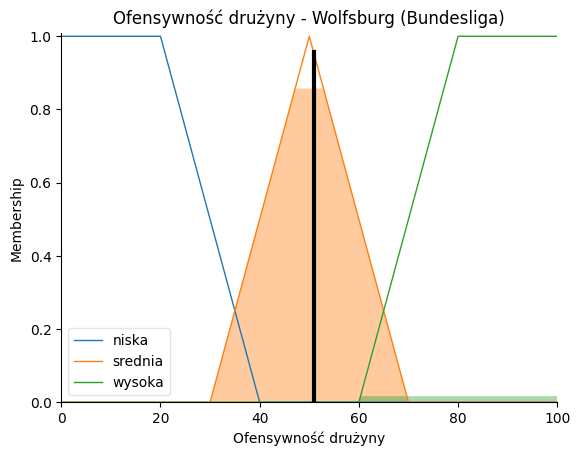

Wiersz 20: Inter (Serie A)
Ofensywność drużyny = 83.31262939958592 [%]
  Przynależność (Membership):
  Liczba bramek (89): mala=0.0, srednia=0.0, duza=0.9333333333333333
  Średnia liczba strzałów na mecz (14.5): mala=0.0, srednia=0.9166666666666666, duza=0.08333333333333333
  Średni procent posiadania piłki (52.0): niski=0.0, sredni=0.7142857142857143, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

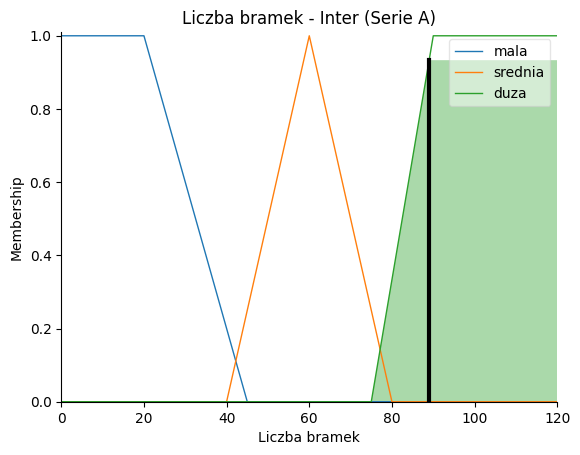

<Figure size 1000x600 with 0 Axes>

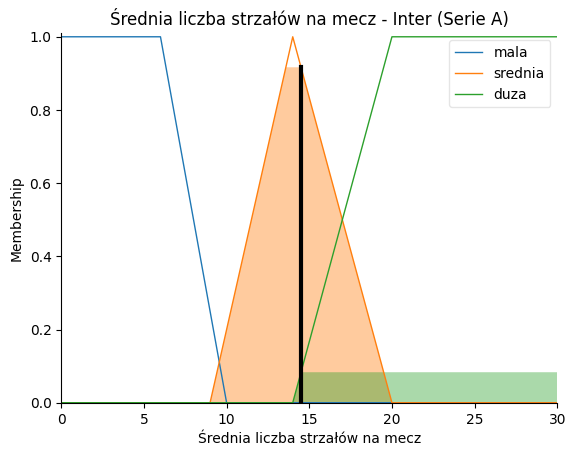

<Figure size 1000x600 with 0 Axes>

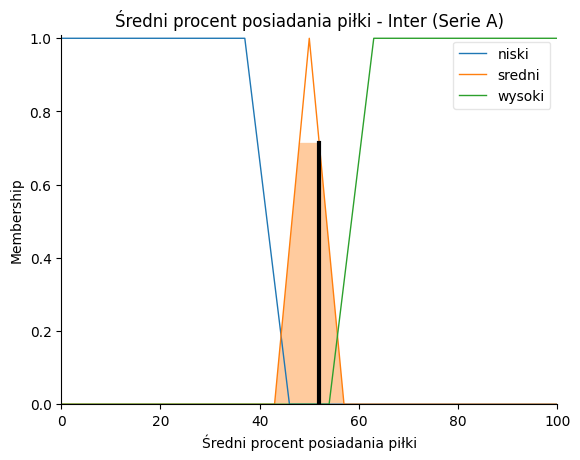

<Figure size 1000x600 with 0 Axes>

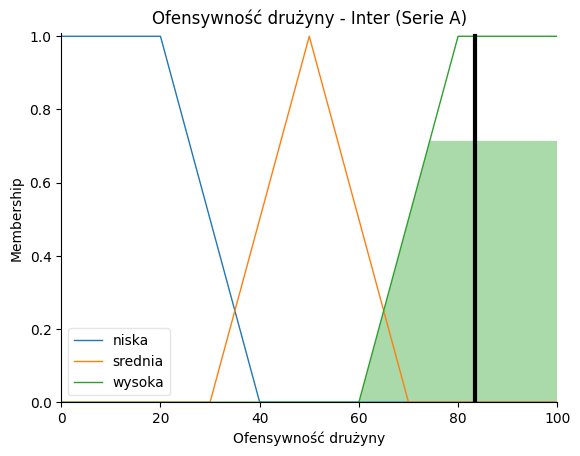

Wiersz 21: Lyon (Ligue 1)
Ofensywność drużyny = 81.92592592592588 [%]
  Przynależność (Membership):
  Liczba bramek (81): mala=0.0, srednia=0.0, duza=0.4
  Średnia liczba strzałów na mecz (16.1): mala=0.0, srednia=0.6499999999999998, duza=0.35000000000000026
  Średni procent posiadania piłki (53.6): niski=0.0, sredni=0.4857142857142855, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

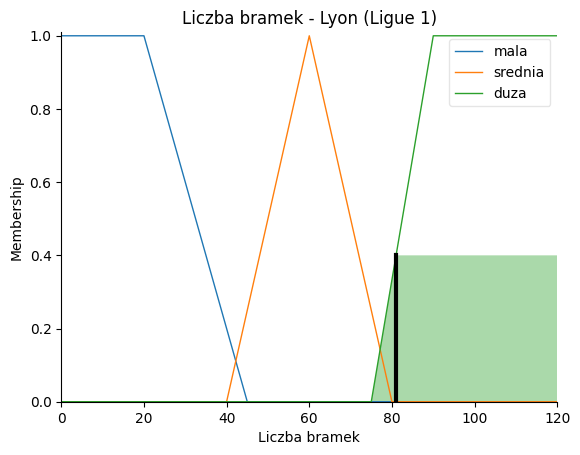

<Figure size 1000x600 with 0 Axes>

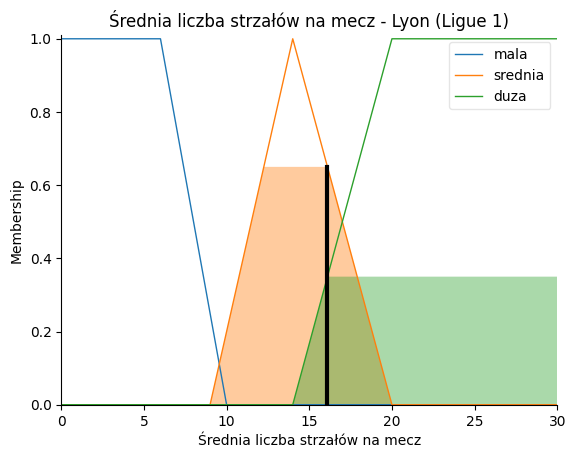

<Figure size 1000x600 with 0 Axes>

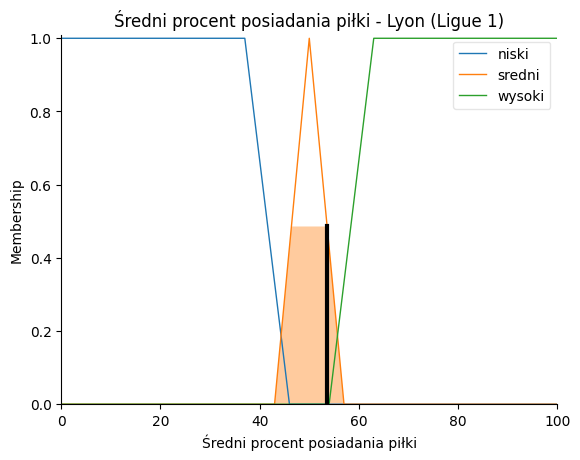

<Figure size 1000x600 with 0 Axes>

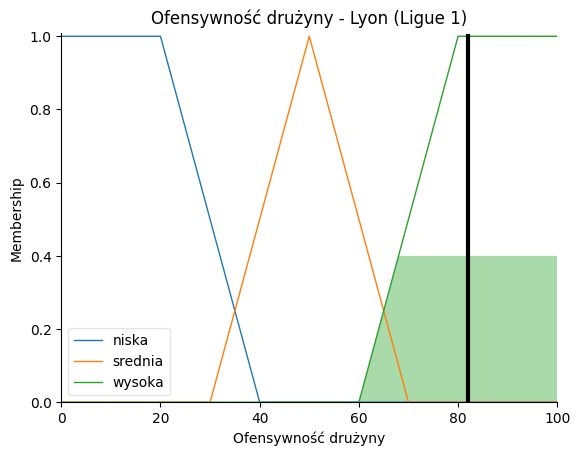

Wiersz 22: RB Leipzig (Bundesliga)
Ofensywność drużyny = 81.77166156982666 [%]
  Przynależność (Membership):
  Liczba bramek (60): mala=0.0, srednia=1.0, duza=0.0
  Średnia liczba strzałów na mecz (16.0): mala=0.0, srednia=0.6666666666666666, duza=0.3333333333333333
  Średni procent posiadania piłki (57.3): niski=0.0, sredni=0.0, wysoki=0.36666666666666636



<Figure size 1000x600 with 0 Axes>

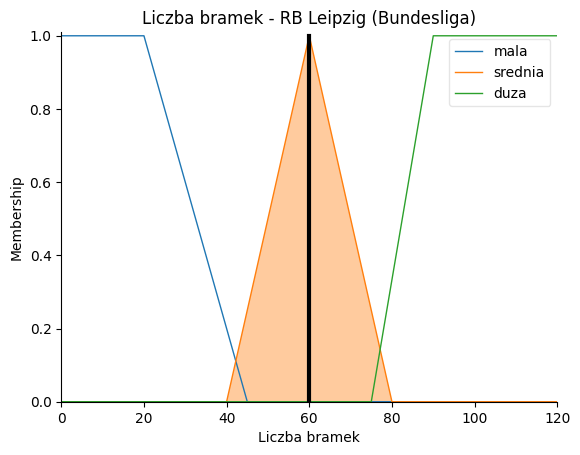

<Figure size 1000x600 with 0 Axes>

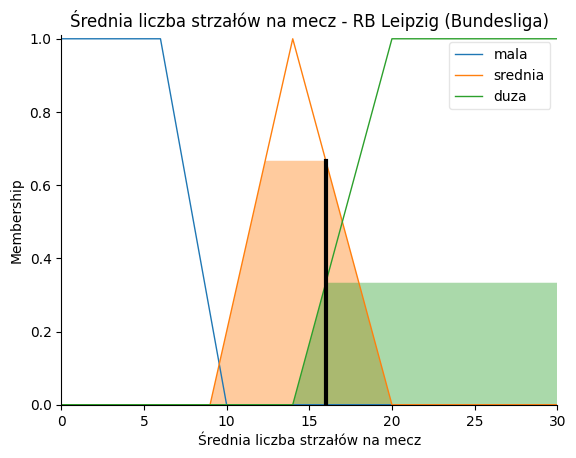

<Figure size 1000x600 with 0 Axes>

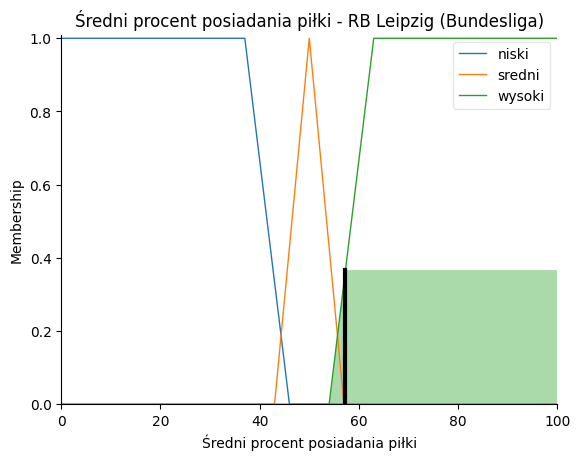

<Figure size 1000x600 with 0 Axes>

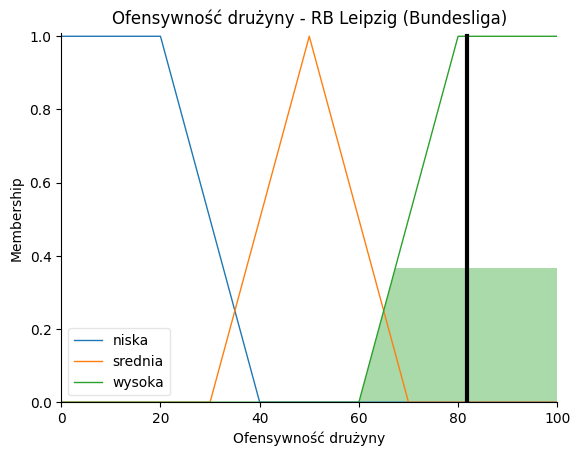

Wiersz 23: Leeds (Premier League)
Ofensywność drużyny = 59.943089849697316 [%]
  Przynależność (Membership):
  Liczba bramek (62): mala=0.0, srednia=0.9, duza=0.0
  Średnia liczba strzałów na mecz (13.7): mala=0.0, srednia=0.9399999999999998, duza=0.0
  Średni procent posiadania piłki (55.1): niski=0.0, sredni=0.27142857142857124, wysoki=0.12222222222222238



<Figure size 1000x600 with 0 Axes>

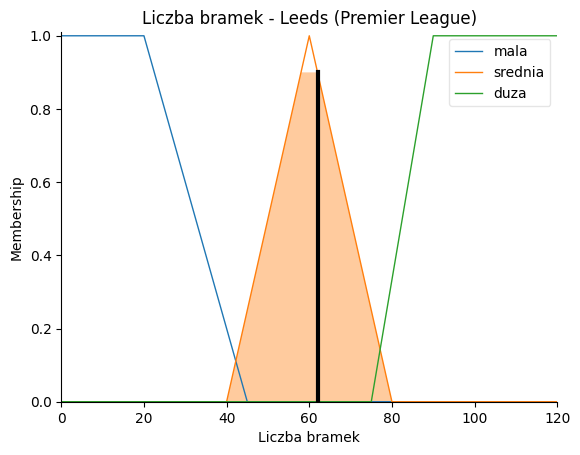

<Figure size 1000x600 with 0 Axes>

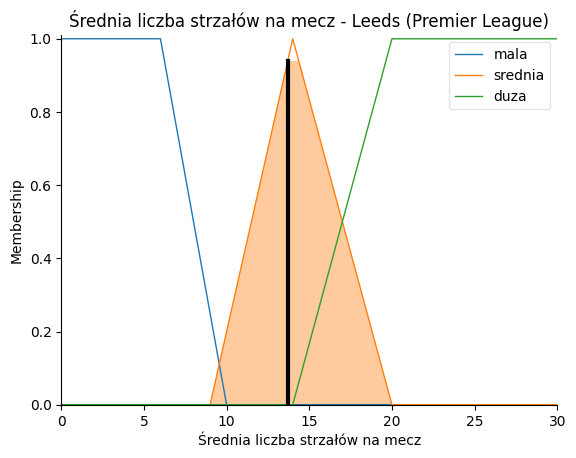

<Figure size 1000x600 with 0 Axes>

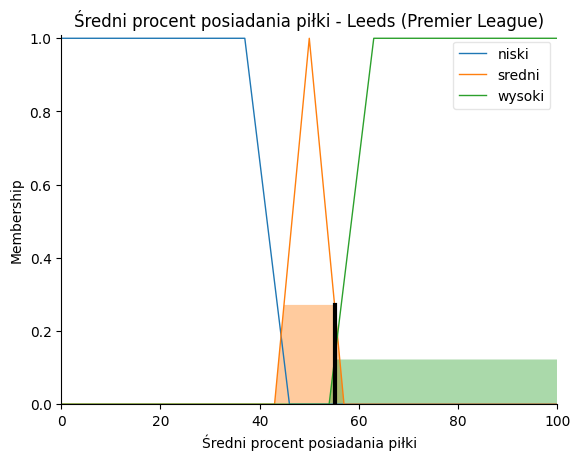

<Figure size 1000x600 with 0 Axes>

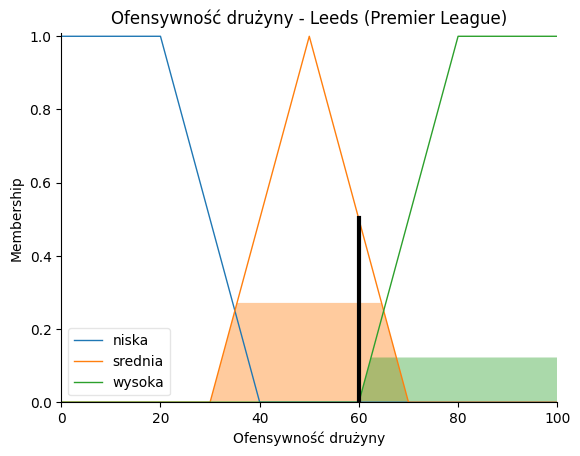

Wiersz 24: West Ham (Premier League)
Ofensywność drużyny = 49.999999999999986 [%]
  Przynależność (Membership):
  Liczba bramek (62): mala=0.0, srednia=0.9, duza=0.0
  Średnia liczba strzałów na mecz (12.3): mala=0.0, srednia=0.6600000000000001, duza=0.0
  Średni procent posiadania piłki (44.5): niski=0.16666666666666666, sredni=0.21428571428571427, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

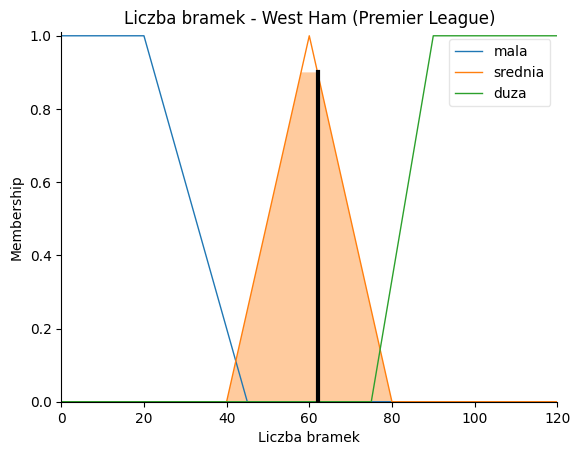

<Figure size 1000x600 with 0 Axes>

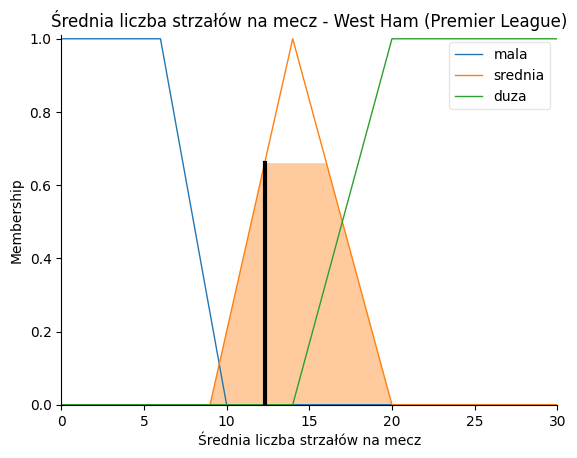

<Figure size 1000x600 with 0 Axes>

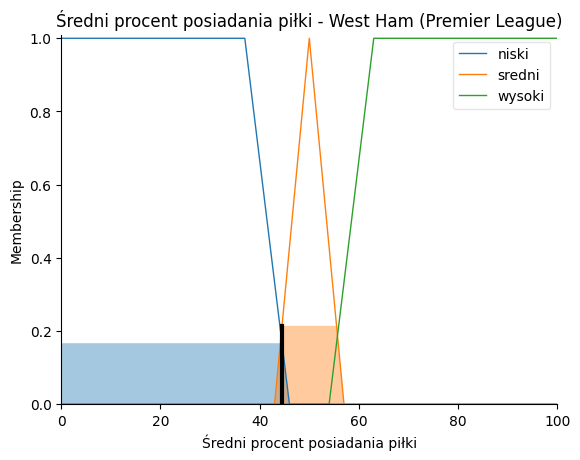

<Figure size 1000x600 with 0 Axes>

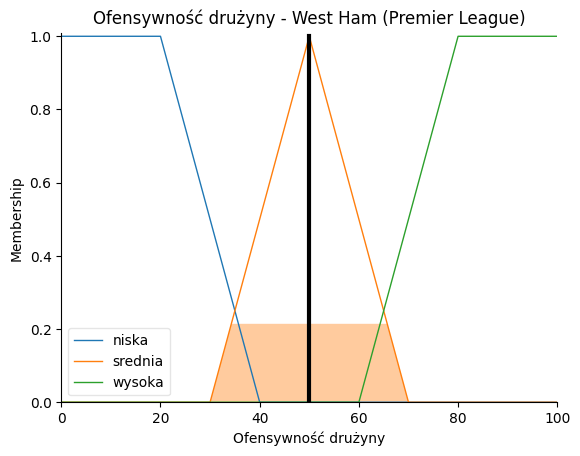

Wiersz 25: Everton (Premier League)
Ofensywność drużyny = 49.99999999999999 [%]
  Przynależność (Membership):
  Liczba bramek (47): mala=0.0, srednia=0.35, duza=0.0
  Średnia liczba strzałów na mecz (10.5): mala=0.0, srednia=0.3, duza=0.0
  Średni procent posiadania piłki (47.3): niski=0.0, sredni=0.6142857142857139, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

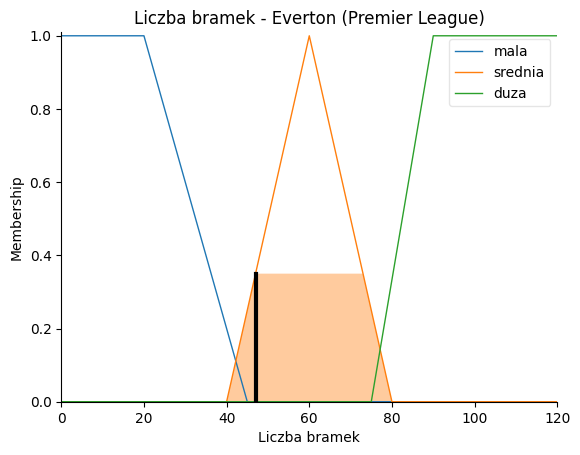

<Figure size 1000x600 with 0 Axes>

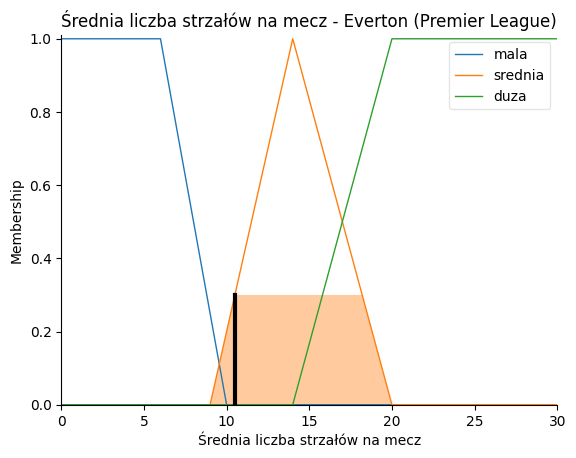

<Figure size 1000x600 with 0 Axes>

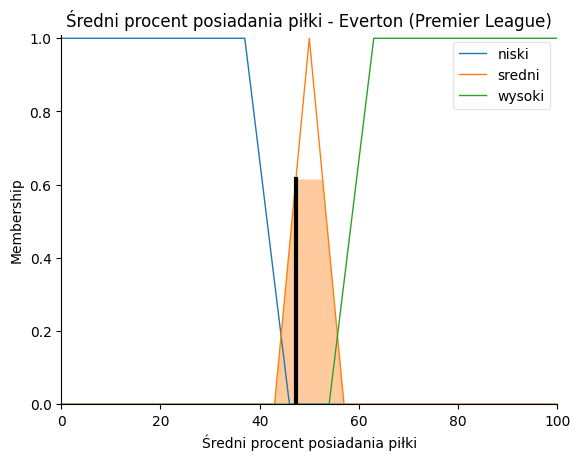

<Figure size 1000x600 with 0 Axes>

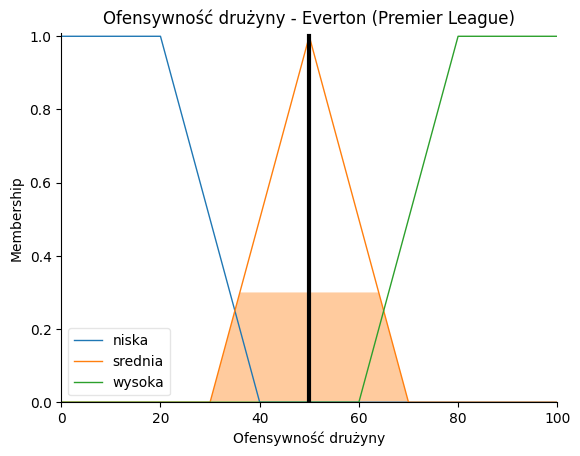

Wiersz 26: Bayer Leverkusen (Bundesliga)
Ofensywność drużyny = 81.77166156982666 [%]
  Przynależność (Membership):
  Liczba bramek (53): mala=0.0, srednia=0.65, duza=0.0
  Średnia liczba strzałów na mecz (13.0): mala=0.0, srednia=0.8, duza=0.0
  Średni procent posiadania piłki (57.3): niski=0.0, sredni=0.0, wysoki=0.36666666666666636



<Figure size 1000x600 with 0 Axes>

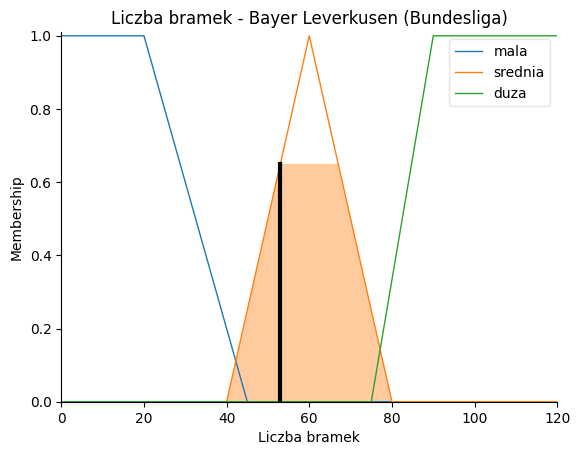

<Figure size 1000x600 with 0 Axes>

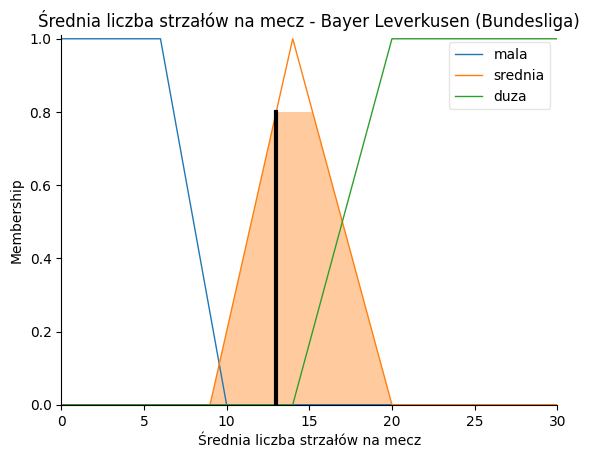

<Figure size 1000x600 with 0 Axes>

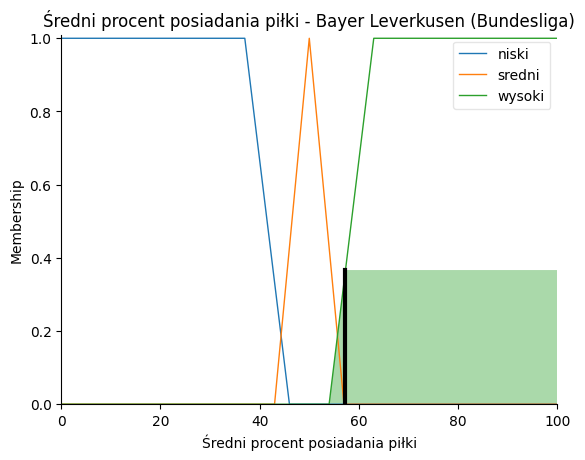

<Figure size 1000x600 with 0 Axes>

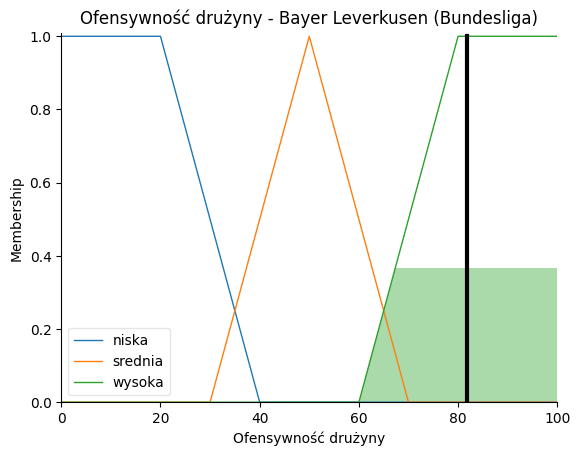

Wiersz 27: Eintracht Frankfurt (Bundesliga)
Ofensywność drużyny = 49.999999999999986 [%]
  Przynależność (Membership):
  Liczba bramek (69): mala=0.0, srednia=0.55, duza=0.0
  Średnia liczba strzałów na mecz (13.2): mala=0.0, srednia=0.8399999999999999, duza=0.0
  Średni procent posiadania piłki (52.4): niski=0.0, sredni=0.6571428571428574, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

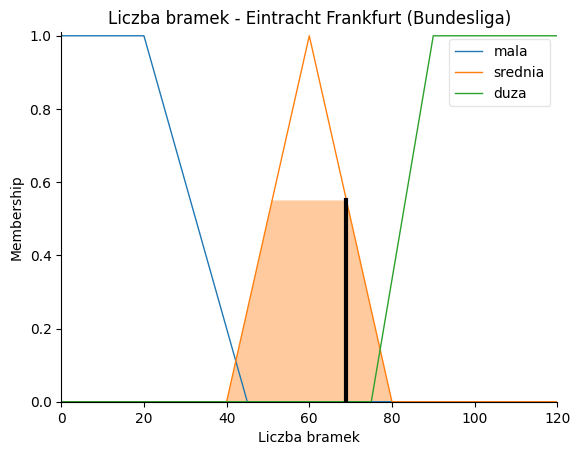

<Figure size 1000x600 with 0 Axes>

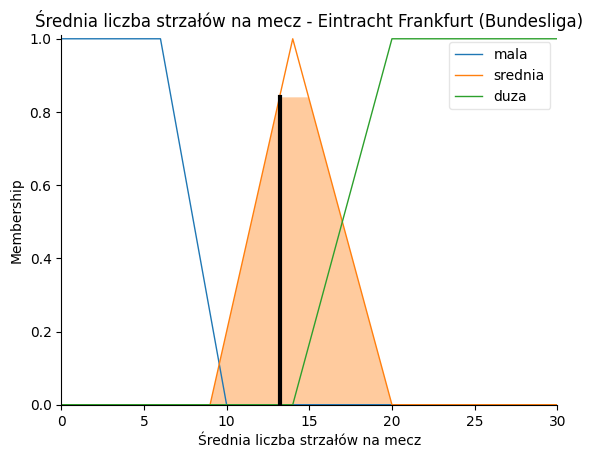

<Figure size 1000x600 with 0 Axes>

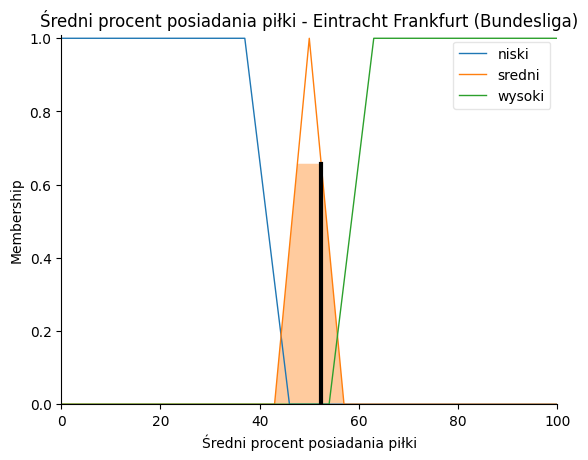

<Figure size 1000x600 with 0 Axes>

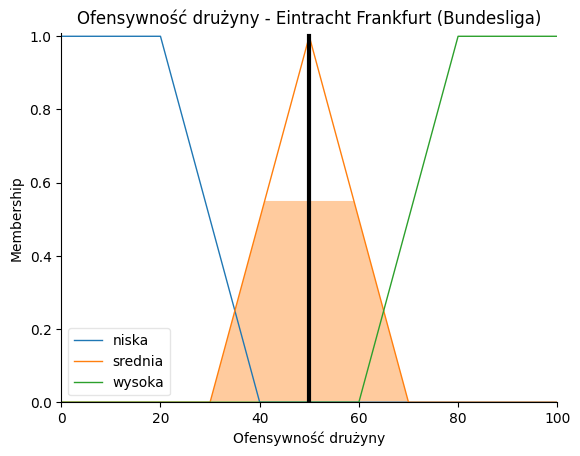

Wiersz 28: Monaco (Ligue 1)
Ofensywność drużyny = 57.67267267267269 [%]
  Przynależność (Membership):
  Liczba bramek (76): mala=0.0, srednia=0.2, duza=0.06666666666666667
  Średnia liczba strzałów na mecz (12.8): mala=0.0, srednia=0.7600000000000001, duza=0.0
  Średni procent posiadania piłki (54.2): niski=0.0, sredni=0.3999999999999996, wysoki=0.02222222222222254



<Figure size 1000x600 with 0 Axes>

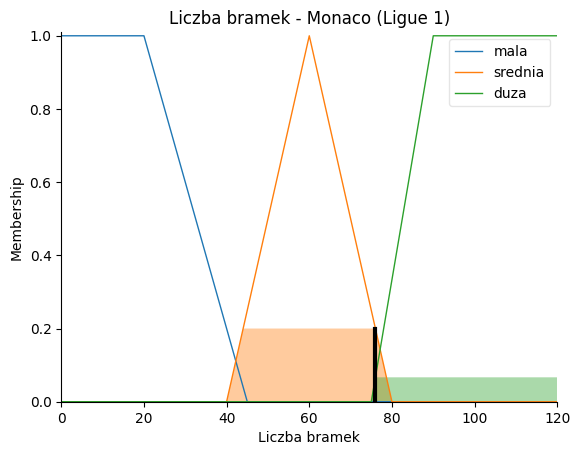

<Figure size 1000x600 with 0 Axes>

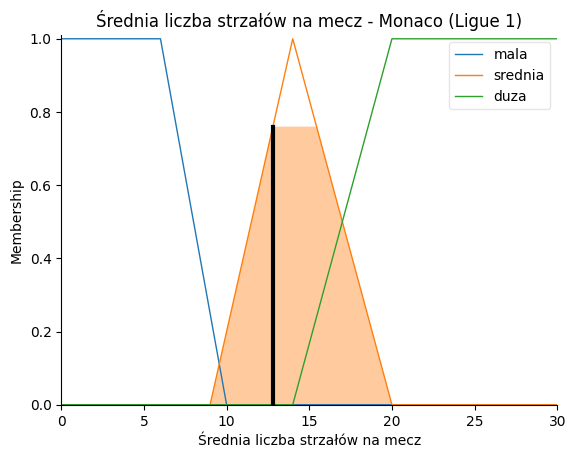

<Figure size 1000x600 with 0 Axes>

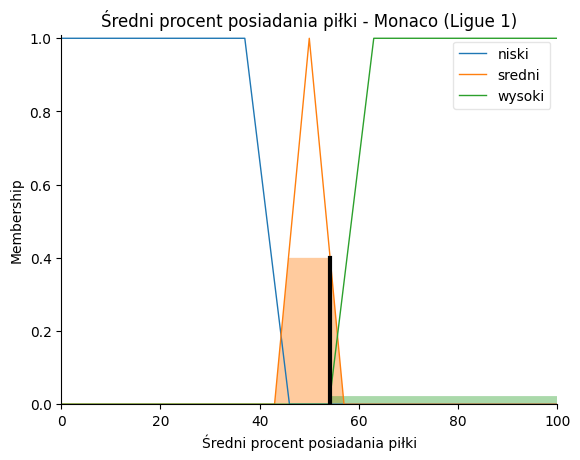

<Figure size 1000x600 with 0 Axes>

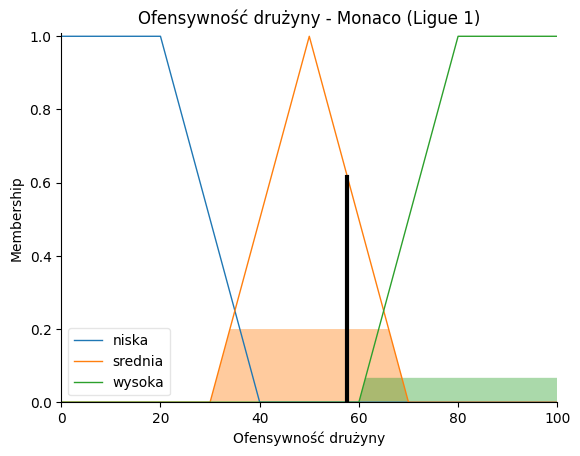

Wiersz 29: Roma (Serie A)
Ofensywność drużyny = 52.891768985902644 [%]
  Przynależność (Membership):
  Liczba bramek (68): mala=0.0, srednia=0.6, duza=0.0
  Średnia liczba strzałów na mecz (14.3): mala=0.0, srednia=0.9499999999999998, duza=0.05000000000000012
  Średni procent posiadania piłki (51.5): niski=0.0, sredni=0.7857142857142857, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

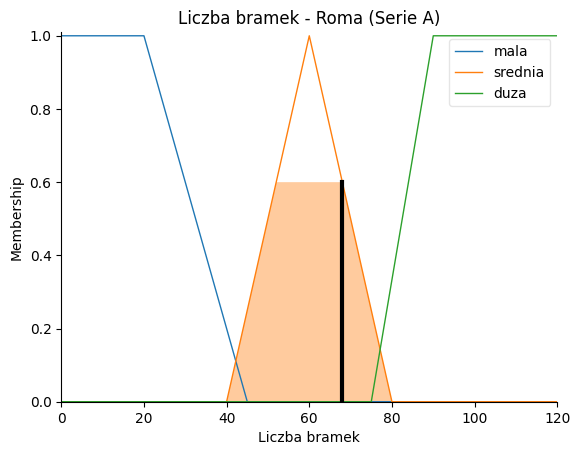

<Figure size 1000x600 with 0 Axes>

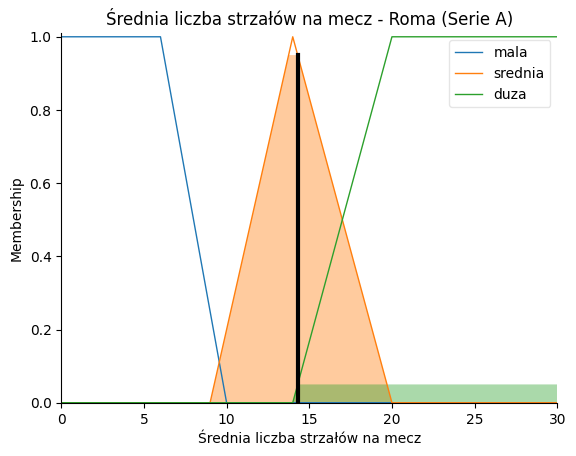

<Figure size 1000x600 with 0 Axes>

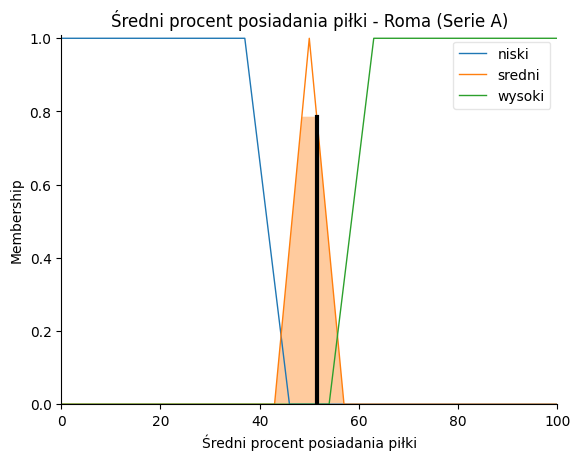

<Figure size 1000x600 with 0 Axes>

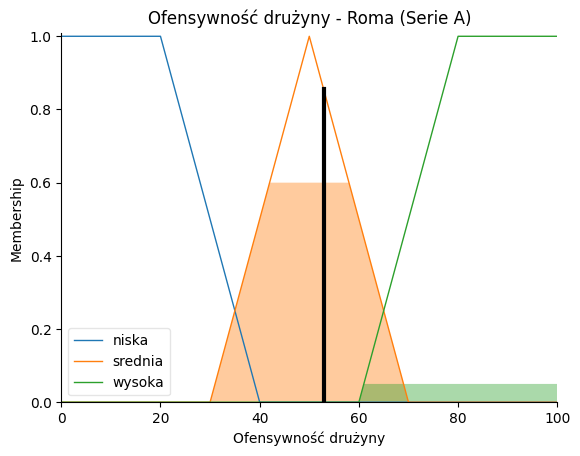

Wiersz 30: Sevilla (LaLiga)
Ofensywność drużyny = 82.48041651875523 [%]
  Przynależność (Membership):
  Liczba bramek (53): mala=0.0, srednia=0.65, duza=0.0
  Średnia liczba strzałów na mecz (12.1): mala=0.0, srednia=0.62, duza=0.0
  Średni procent posiadania piłki (58.7): niski=0.0, sredni=0.0, wysoki=0.5222222222222226



<Figure size 1000x600 with 0 Axes>

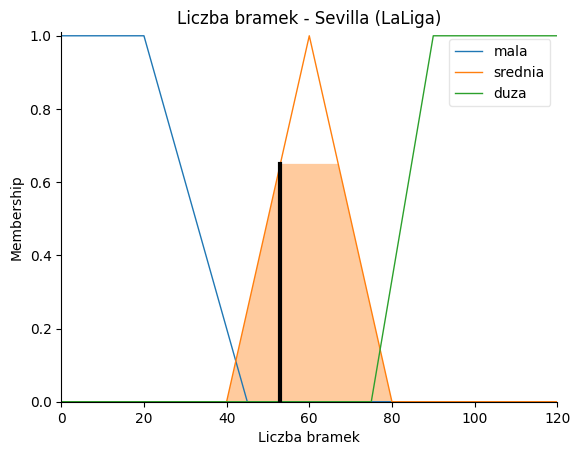

<Figure size 1000x600 with 0 Axes>

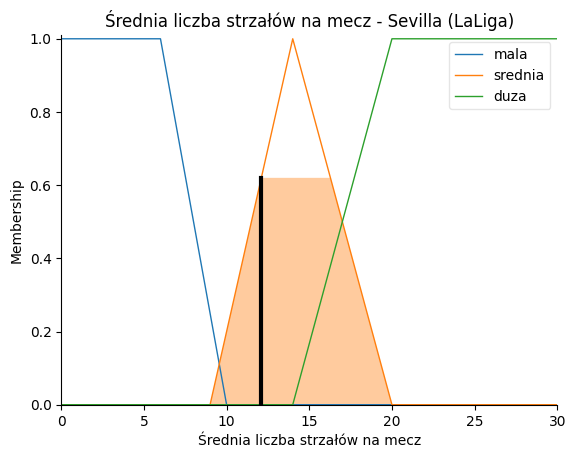

<Figure size 1000x600 with 0 Axes>

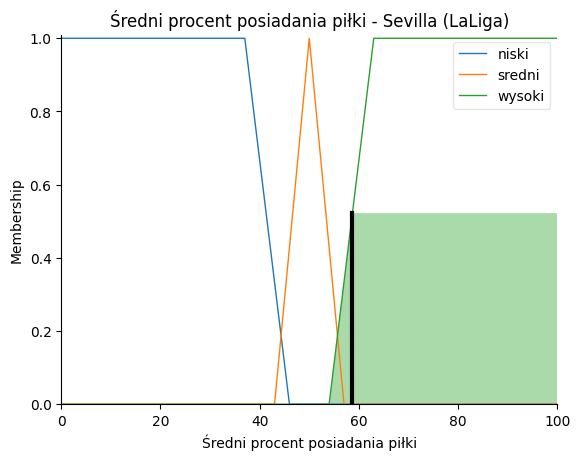

<Figure size 1000x600 with 0 Axes>

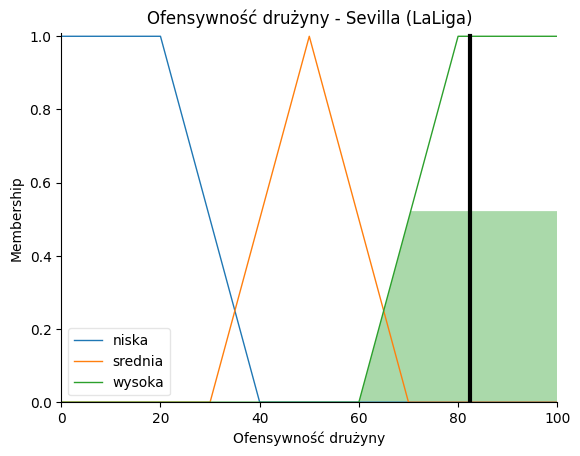

Wiersz 31: Borussia M.Gladbach (Bundesliga)
Ofensywność drużyny = 49.99999999999998 [%]
  Przynależność (Membership):
  Liczba bramek (64): mala=0.0, srednia=0.8, duza=0.0
  Średnia liczba strzałów na mecz (13.4): mala=0.0, srednia=0.8800000000000001, duza=0.0
  Średni procent posiadania piłki (51.5): niski=0.0, sredni=0.7857142857142857, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

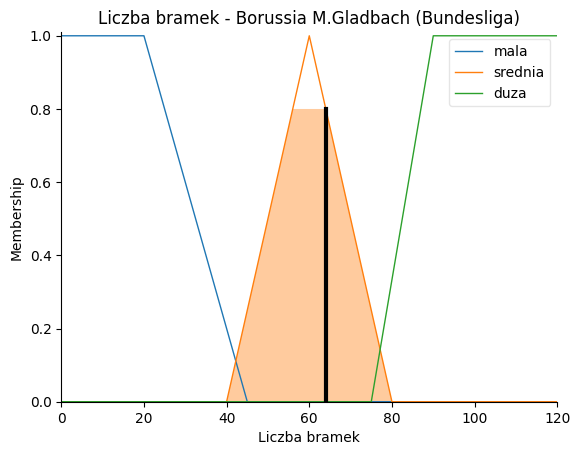

<Figure size 1000x600 with 0 Axes>

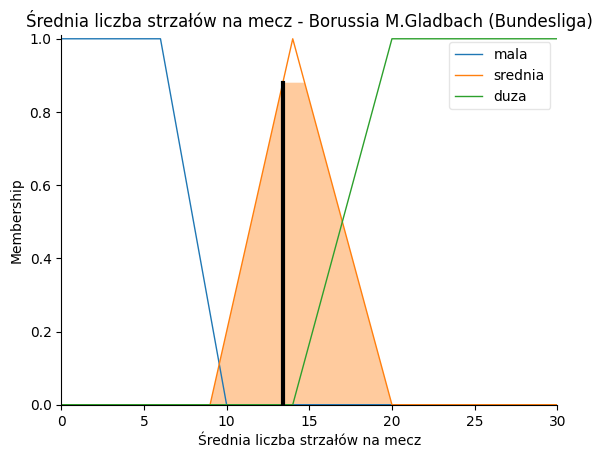

<Figure size 1000x600 with 0 Axes>

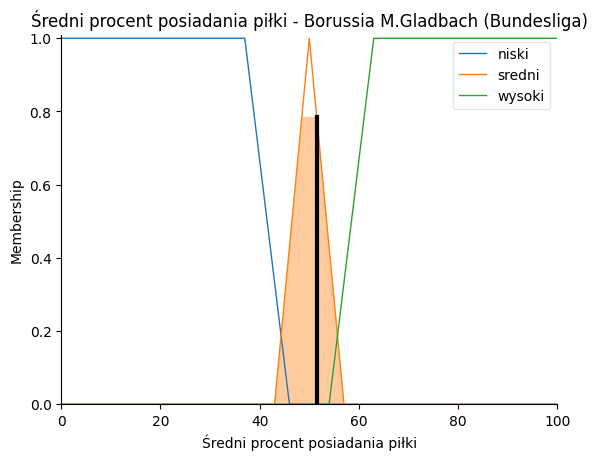

<Figure size 1000x600 with 0 Axes>

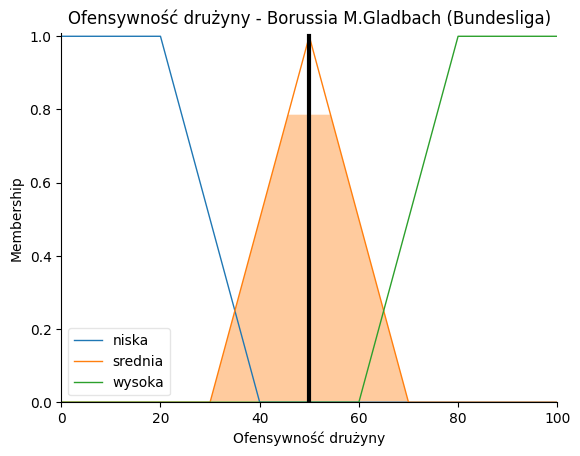

Wiersz 32: Arsenal (Premier League)
Ofensywność drużyny = 50.00000000000001 [%]
  Przynależność (Membership):
  Liczba bramek (55): mala=0.0, srednia=0.75, duza=0.0
  Średnia liczba strzałów na mecz (12.1): mala=0.0, srednia=0.62, duza=0.0
  Średni procent posiadania piłki (52.7): niski=0.0, sredni=0.6142857142857139, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

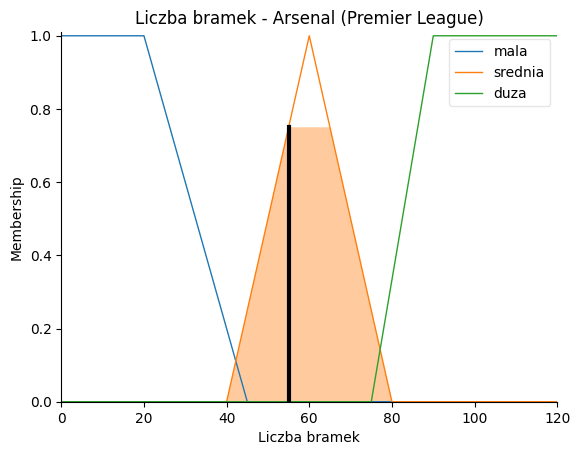

<Figure size 1000x600 with 0 Axes>

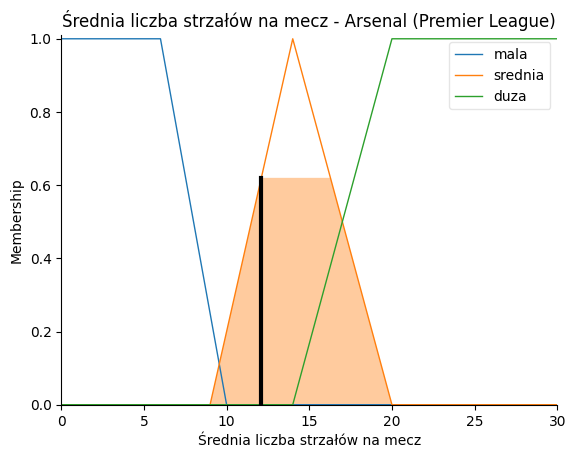

<Figure size 1000x600 with 0 Axes>

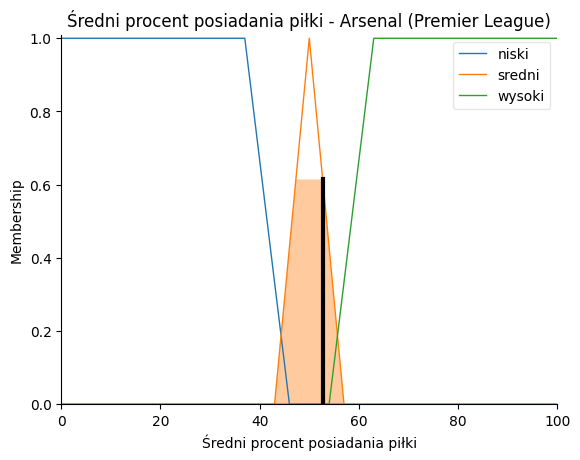

<Figure size 1000x600 with 0 Axes>

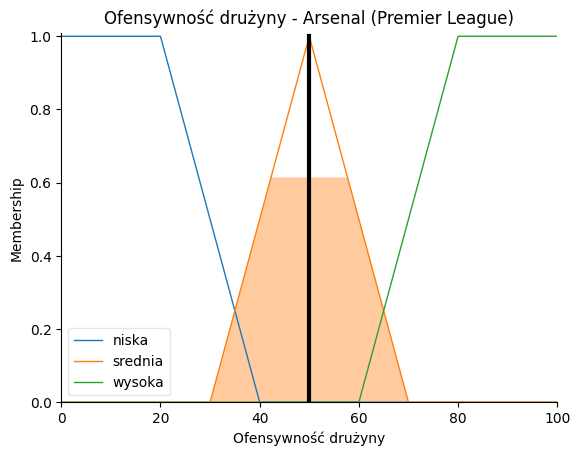

Wiersz 33: Rennes (Ligue 1)
Ofensywność drużyny = 78.98508812575093 [%]
  Przynależność (Membership):
  Liczba bramek (52): mala=0.0, srednia=0.6, duza=0.0
  Średnia liczba strzałów na mecz (13.5): mala=0.0, srednia=0.9, duza=0.0
  Średni procent posiadania piłki (56.8): niski=0.0, sredni=0.028571428571428976, wysoki=0.3111111111111108



<Figure size 1000x600 with 0 Axes>

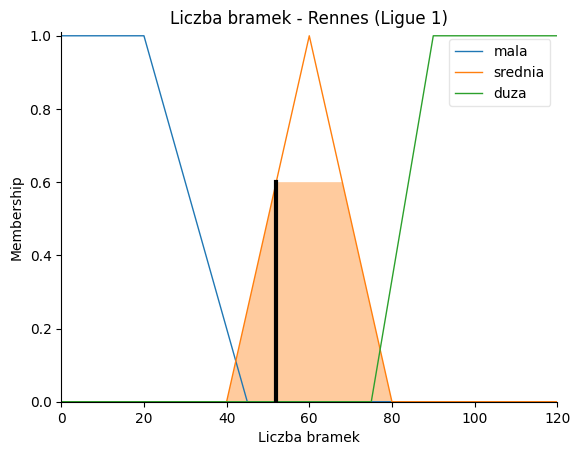

<Figure size 1000x600 with 0 Axes>

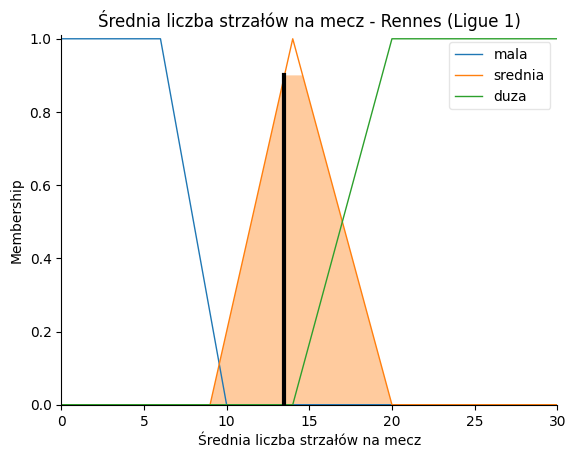

<Figure size 1000x600 with 0 Axes>

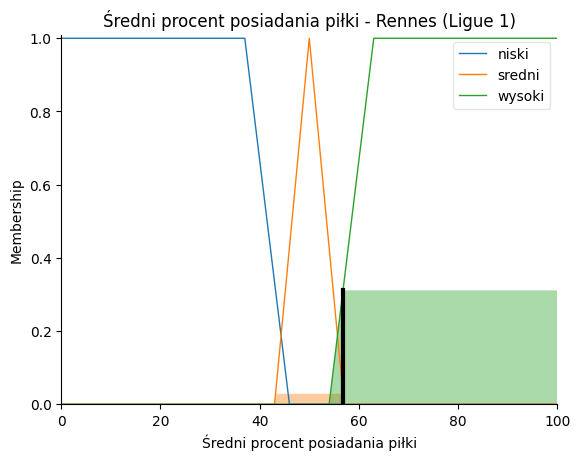

<Figure size 1000x600 with 0 Axes>

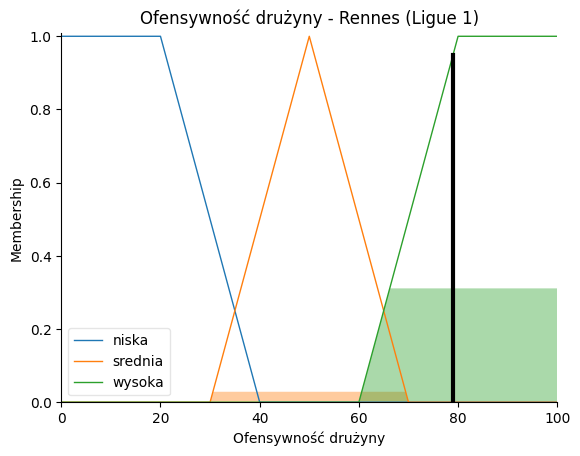

Wiersz 34: VfB Stuttgart (Bundesliga)
Ofensywność drużyny = 49.99999999999998 [%]
  Przynależność (Membership):
  Liczba bramek (56): mala=0.0, srednia=0.8, duza=0.0
  Średnia liczba strzałów na mecz (13.4): mala=0.0, srednia=0.8800000000000001, duza=0.0
  Średni procent posiadania piłki (51.5): niski=0.0, sredni=0.7857142857142857, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

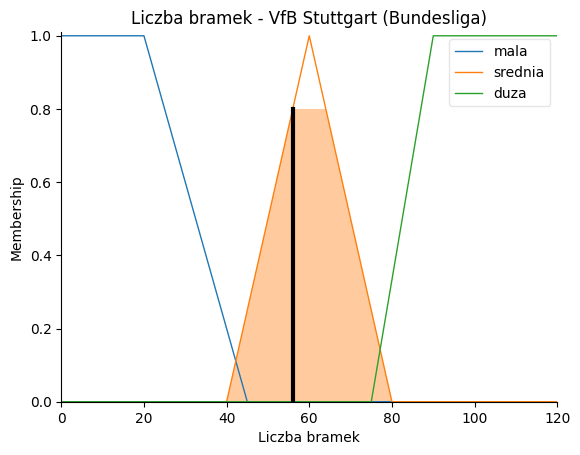

<Figure size 1000x600 with 0 Axes>

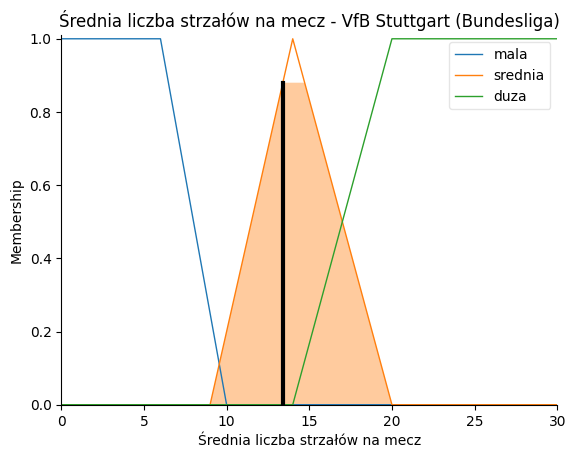

<Figure size 1000x600 with 0 Axes>

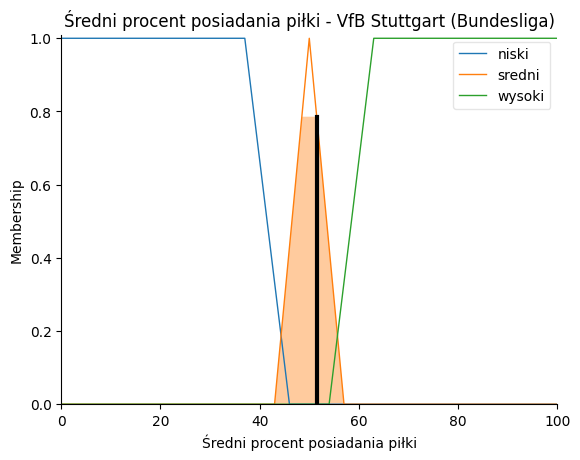

<Figure size 1000x600 with 0 Axes>

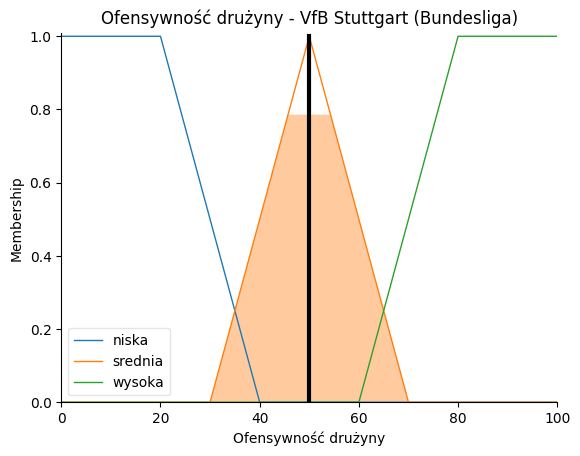

Wiersz 35: Wolverhampton Wanderers (Premier League)
Ofensywność drużyny = 50.00000000000001 [%]
  Przynależność (Membership):
  Liczba bramek (36): mala=0.36, srednia=0.0, duza=0.0
  Średnia liczba strzałów na mecz (12.2): mala=0.0, srednia=0.6399999999999999, duza=0.0
  Średni procent posiadania piłki (49.7): niski=0.0, sredni=0.9571428571428575, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

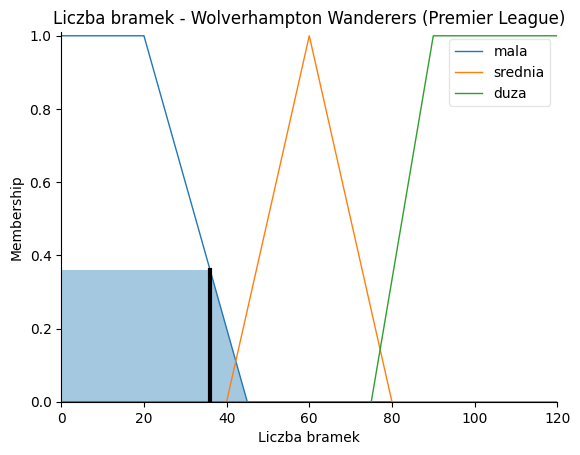

<Figure size 1000x600 with 0 Axes>

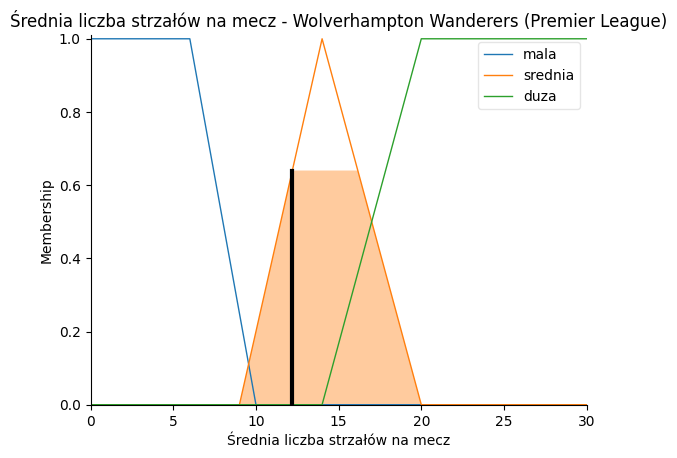

<Figure size 1000x600 with 0 Axes>

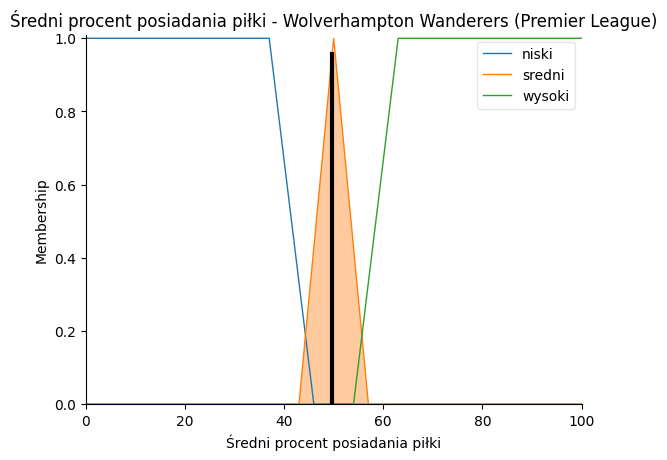

<Figure size 1000x600 with 0 Axes>

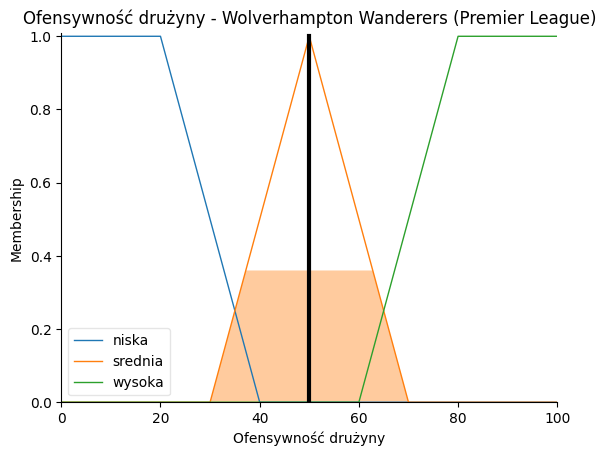

Wiersz 36: Sassuolo (Serie A)
Ofensywność drużyny = 82.23060796645704 [%]
  Przynależność (Membership):
  Liczba bramek (64): mala=0.0, srednia=0.8, duza=0.0
  Średnia liczba strzałów na mecz (13.9): mala=0.0, srednia=0.9800000000000001, duza=0.0
  Średni procent posiadania piłki (58.2): niski=0.0, sredni=0.0, wysoki=0.466666666666667



<Figure size 1000x600 with 0 Axes>

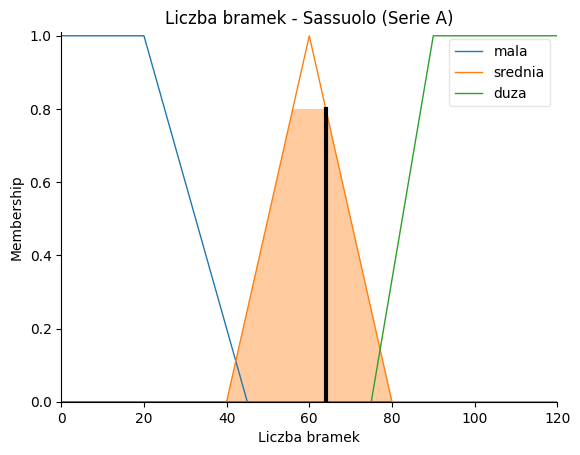

<Figure size 1000x600 with 0 Axes>

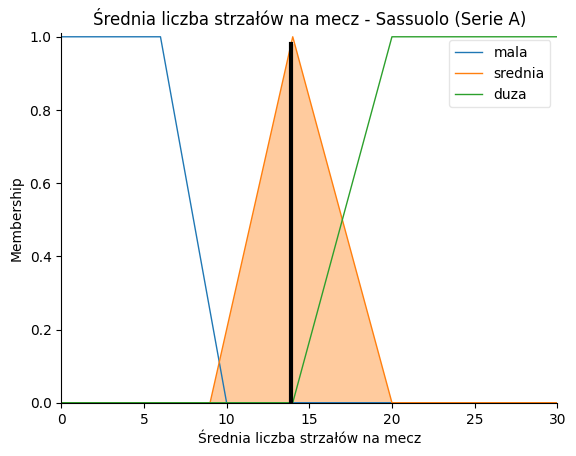

<Figure size 1000x600 with 0 Axes>

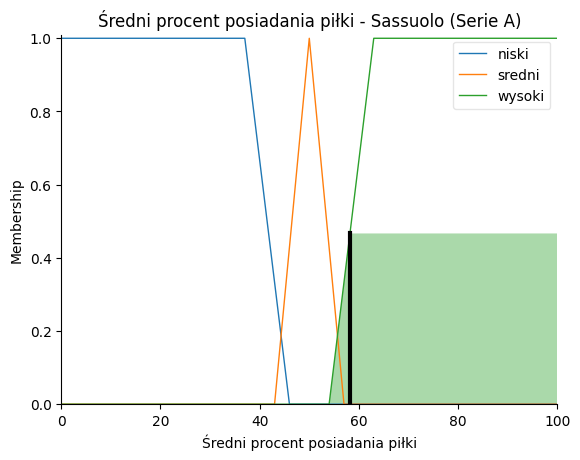

<Figure size 1000x600 with 0 Axes>

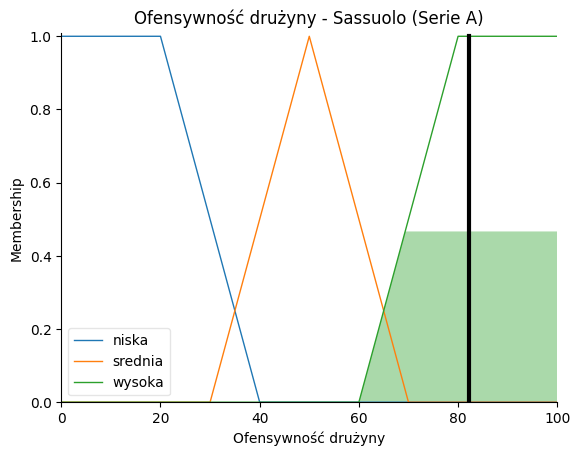

Wiersz 37: Metz (Ligue 1)
Ofensywność drużyny = 49.99999999999997 [%]
  Przynależność (Membership):
  Liczba bramek (44): mala=0.04, srednia=0.2, duza=0.0
  Średnia liczba strzałów na mecz (11.5): mala=0.0, srednia=0.5, duza=0.0
  Średni procent posiadania piłki (46.9): niski=0.0, sredni=0.5571428571428569, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

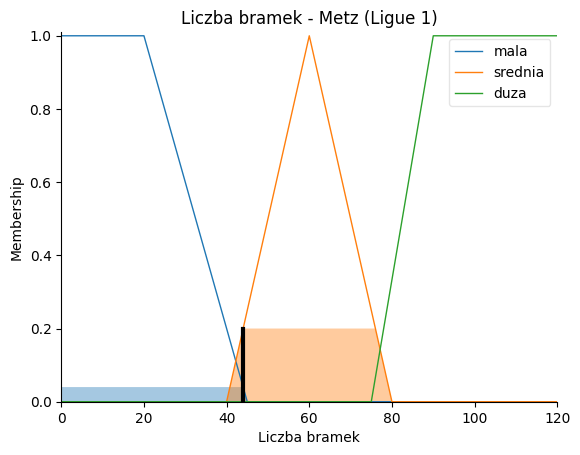

<Figure size 1000x600 with 0 Axes>

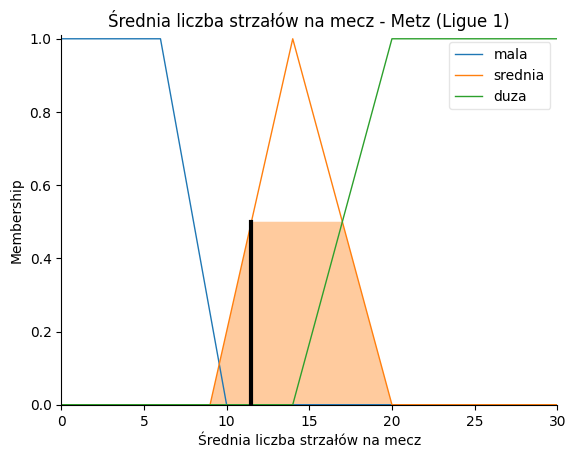

<Figure size 1000x600 with 0 Axes>

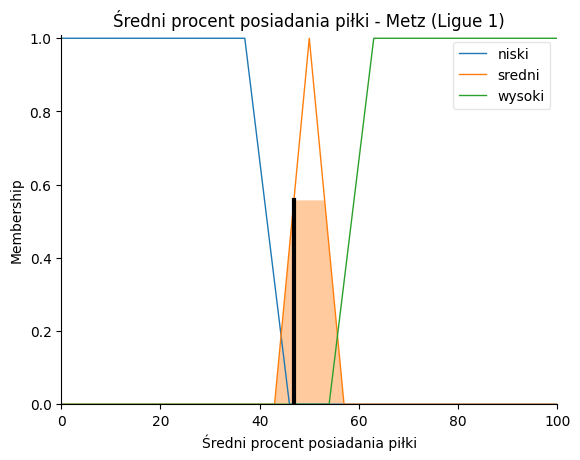

<Figure size 1000x600 with 0 Axes>

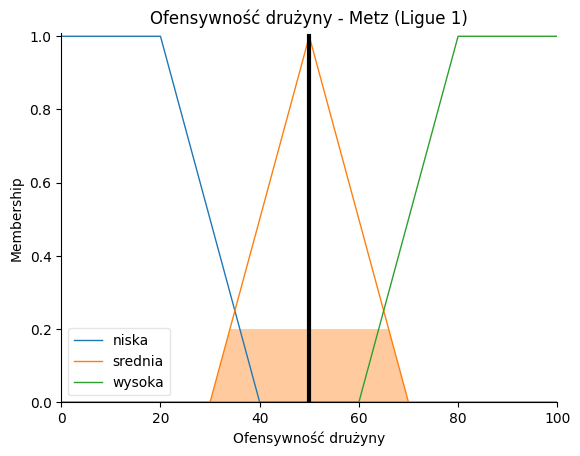

Wiersz 38: Villarreal (LaLiga)
Ofensywność drużyny = 52.87108775351712 [%]
  Przynależność (Membership):
  Liczba bramek (60): mala=0.0, srednia=1.0, duza=0.0
  Średnia liczba strzałów na mecz (10.7): mala=0.0, srednia=0.33999999999999986, duza=0.0
  Średni procent posiadania piłki (54.3): niski=0.0, sredni=0.3857142857142861, wysoki=0.033333333333333014



<Figure size 1000x600 with 0 Axes>

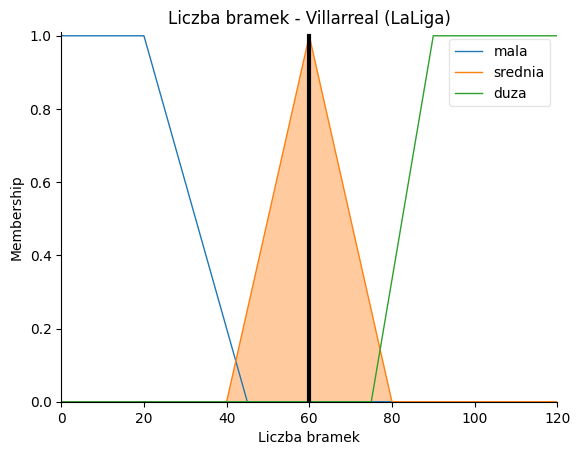

<Figure size 1000x600 with 0 Axes>

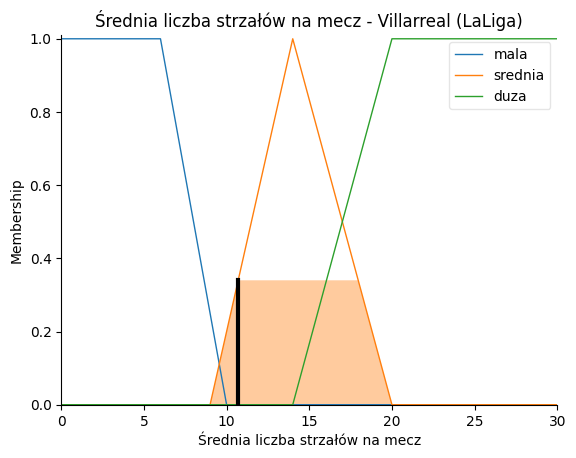

<Figure size 1000x600 with 0 Axes>

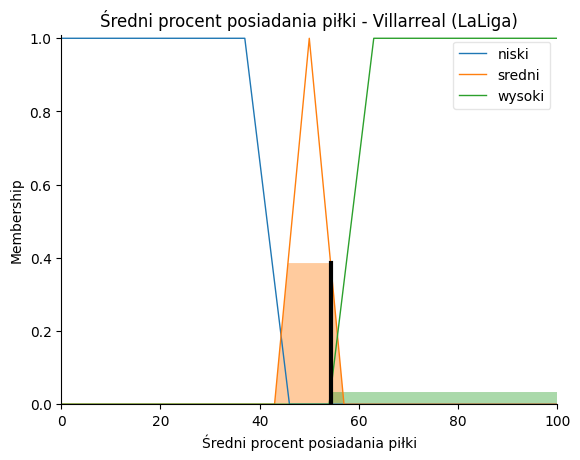

<Figure size 1000x600 with 0 Axes>

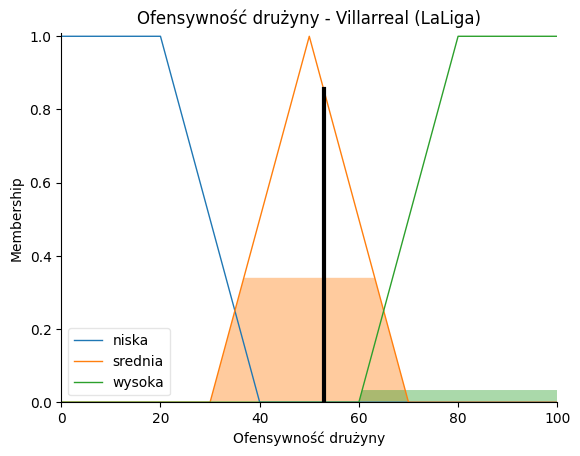

Wiersz 39: Real Sociedad (LaLiga)
Ofensywność drużyny = 49.99999999999998 [%]
  Przynależność (Membership):
  Liczba bramek (59): mala=0.0, srednia=0.95, duza=0.0
  Średnia liczba strzałów na mecz (11.3): mala=0.0, srednia=0.46000000000000013, duza=0.0
  Średni procent posiadania piłki (53.7): niski=0.0, sredni=0.47142857142857103, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

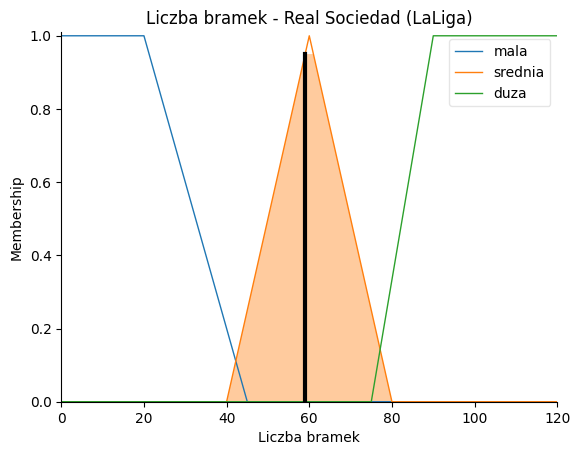

<Figure size 1000x600 with 0 Axes>

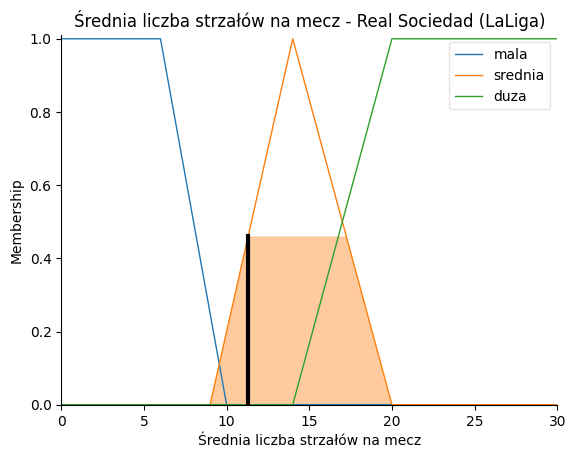

<Figure size 1000x600 with 0 Axes>

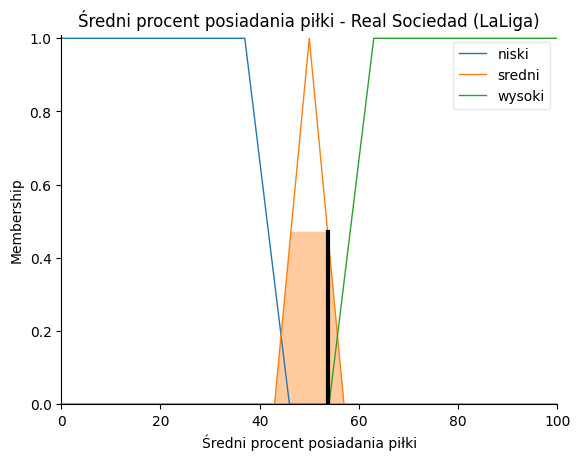

<Figure size 1000x600 with 0 Axes>

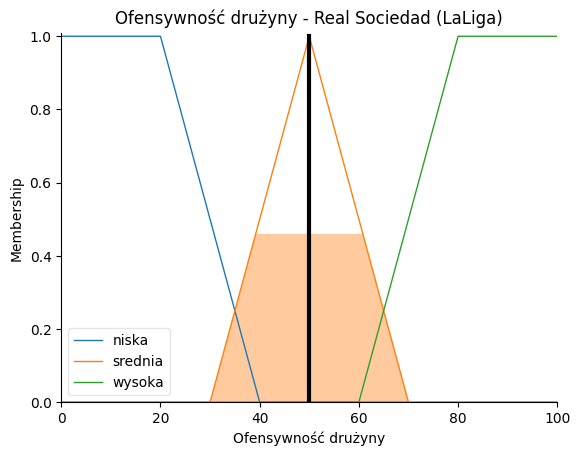

Wiersz 40: Brighton (Premier League)
Ofensywność drużyny = 49.99999999999997 [%]
  Przynależność (Membership):
  Liczba bramek (40): mala=0.2, srednia=0.0, duza=0.0
  Średnia liczba strzałów na mecz (12.8): mala=0.0, srednia=0.7600000000000001, duza=0.0
  Średni procent posiadania piłki (50.7): niski=0.0, sredni=0.8999999999999996, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

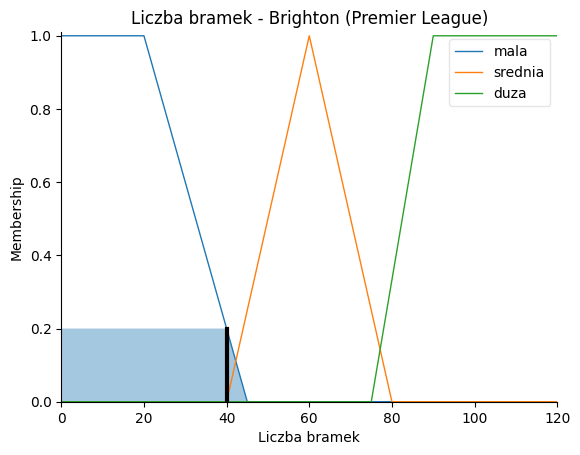

<Figure size 1000x600 with 0 Axes>

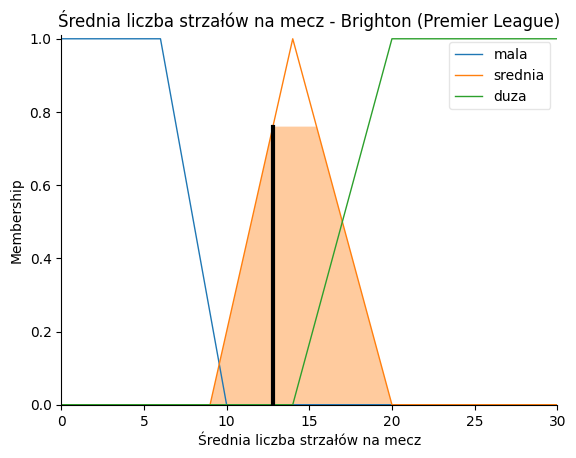

<Figure size 1000x600 with 0 Axes>

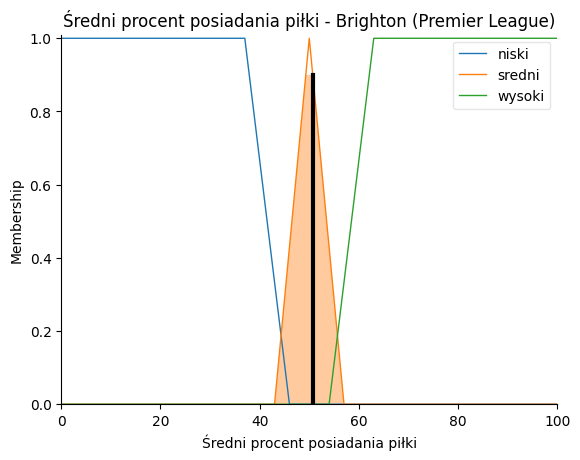

<Figure size 1000x600 with 0 Axes>

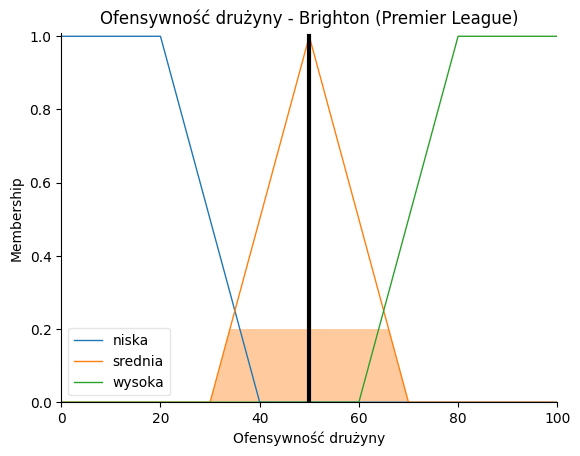

Wiersz 41: Real Betis (LaLiga)
Ofensywność drużyny = 50.0 [%]
  Przynależność (Membership):
  Liczba bramek (50): mala=0.0, srednia=0.5, duza=0.0
  Średnia liczba strzałów na mecz (11.7): mala=0.0, srednia=0.5399999999999999, duza=0.0
  Średni procent posiadania piłki (52.9): niski=0.0, sredni=0.5857142857142859, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

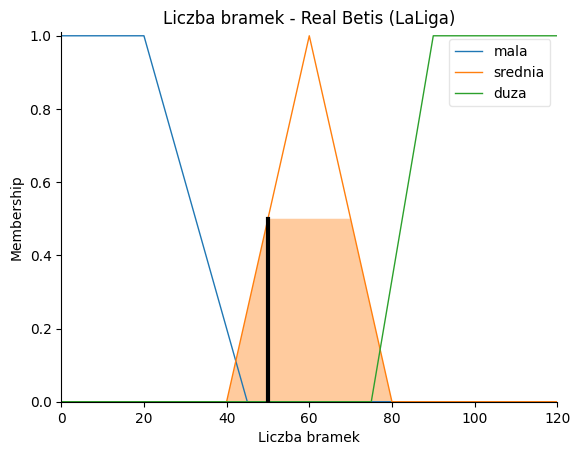

<Figure size 1000x600 with 0 Axes>

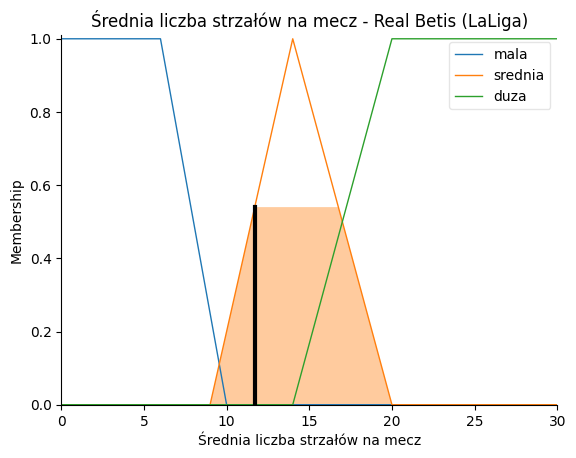

<Figure size 1000x600 with 0 Axes>

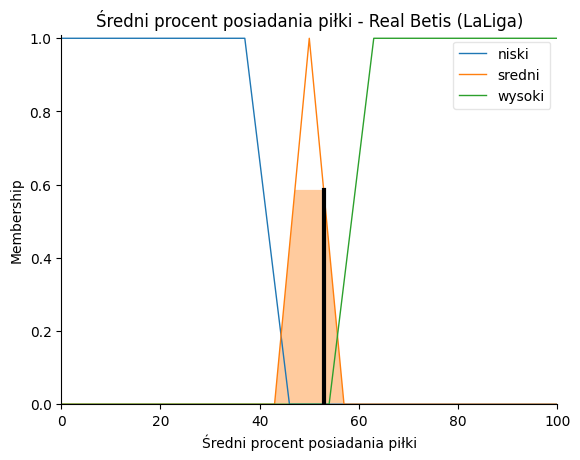

<Figure size 1000x600 with 0 Axes>

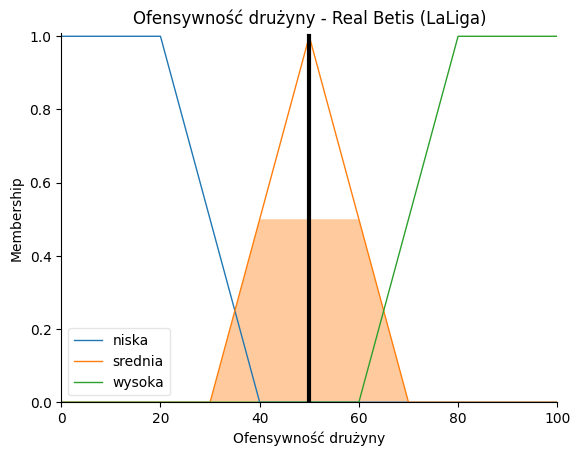

Wiersz 42: Burnley (Premier League)
Ofensywność drużyny = 26.17417979017252 [%]
  Przynależność (Membership):
  Liczba bramek (33): mala=0.48, srednia=0.0, duza=0.0
  Średnia liczba strzałów na mecz (10.1): mala=0.0, srednia=0.21999999999999992, duza=0.0
  Średni procent posiadania piłki (43.5): niski=0.2777777777777778, sredni=0.07142857142857142, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

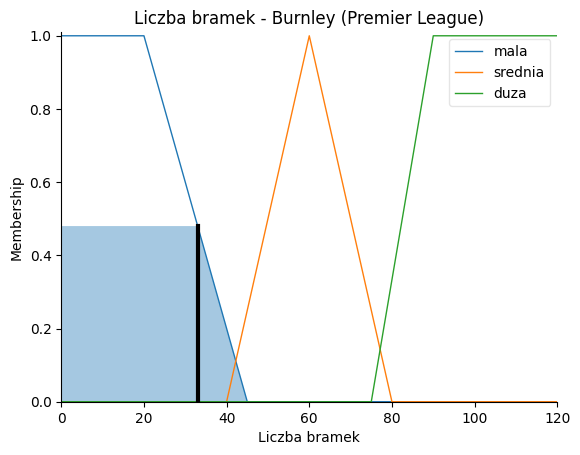

<Figure size 1000x600 with 0 Axes>

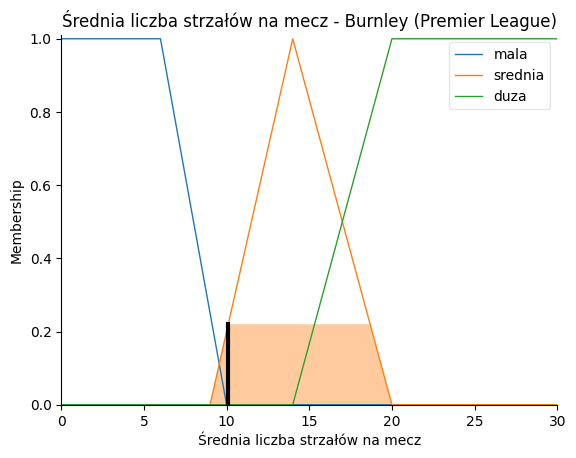

<Figure size 1000x600 with 0 Axes>

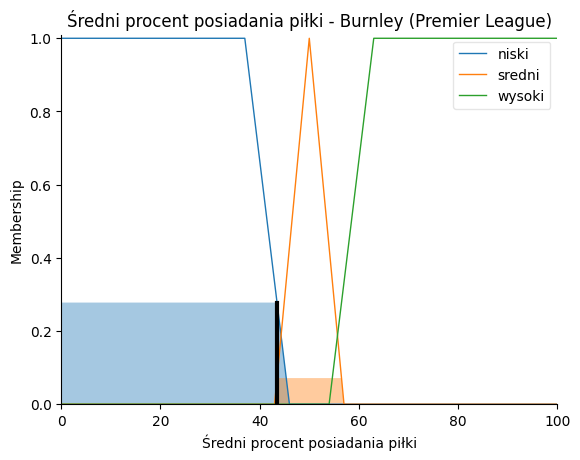

<Figure size 1000x600 with 0 Axes>

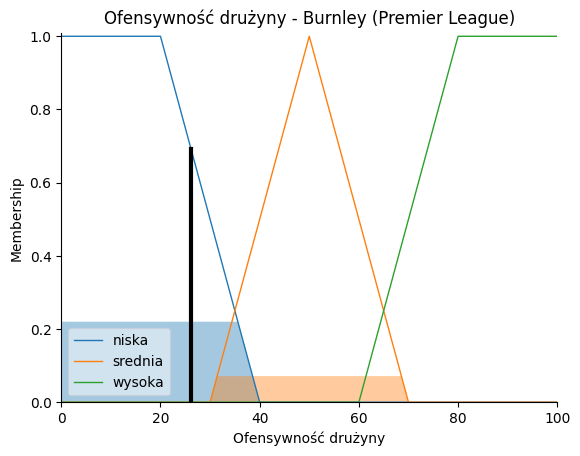

Wiersz 43: Lens (Ligue 1)
Ofensywność drużyny = 50.000000000000014 [%]
  Przynależność (Membership):
  Liczba bramek (55): mala=0.0, srednia=0.75, duza=0.0
  Średnia liczba strzałów na mecz (11.7): mala=0.0, srednia=0.5399999999999999, duza=0.0
  Średni procent posiadania piłki (51.1): niski=0.0, sredni=0.8428571428571426, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

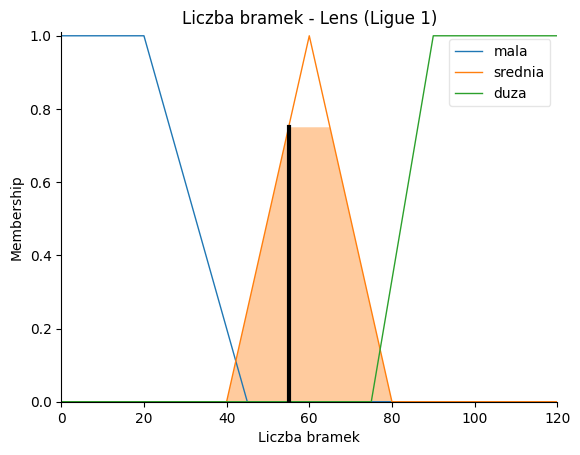

<Figure size 1000x600 with 0 Axes>

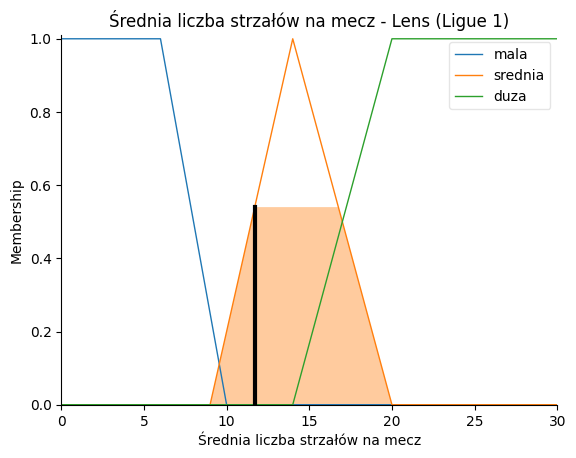

<Figure size 1000x600 with 0 Axes>

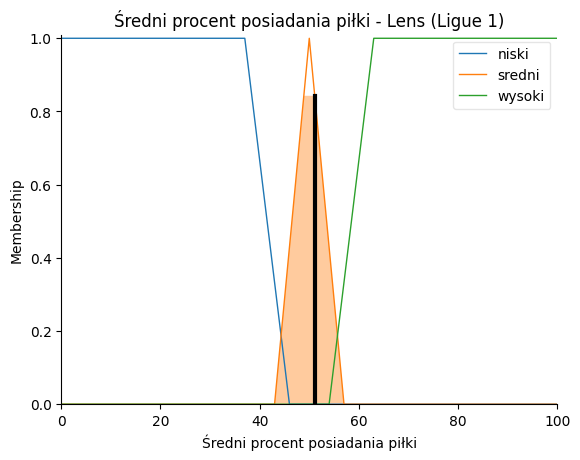

<Figure size 1000x600 with 0 Axes>

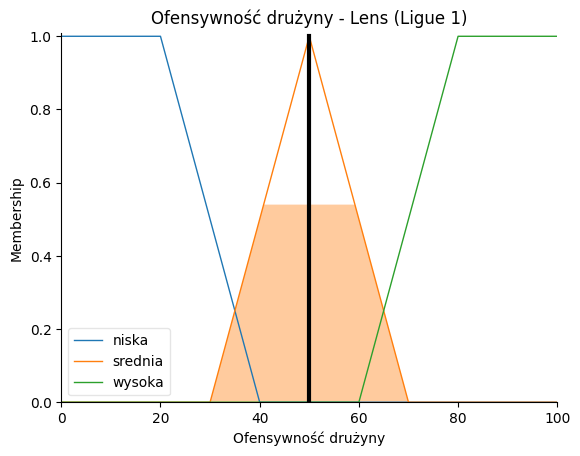

Wiersz 44: Brest (Ligue 1)
Ofensywność drużyny = 50.0 [%]
  Przynależność (Membership):
  Liczba bramek (50): mala=0.0, srednia=0.5, duza=0.0
  Średnia liczba strzałów na mecz (11.8): mala=0.0, srednia=0.5600000000000002, duza=0.0
  Średni procent posiadania piłki (49.4): niski=0.0, sredni=0.9142857142857141, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

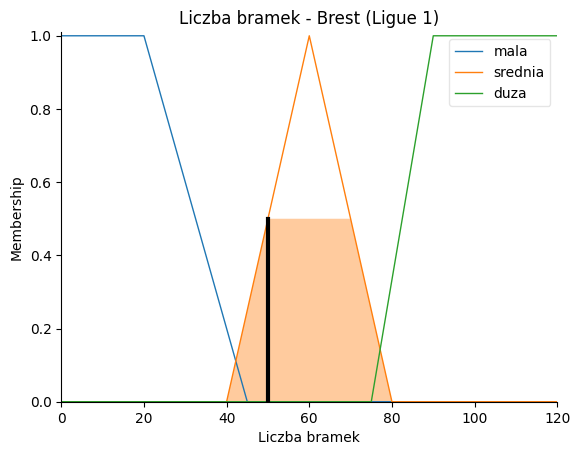

<Figure size 1000x600 with 0 Axes>

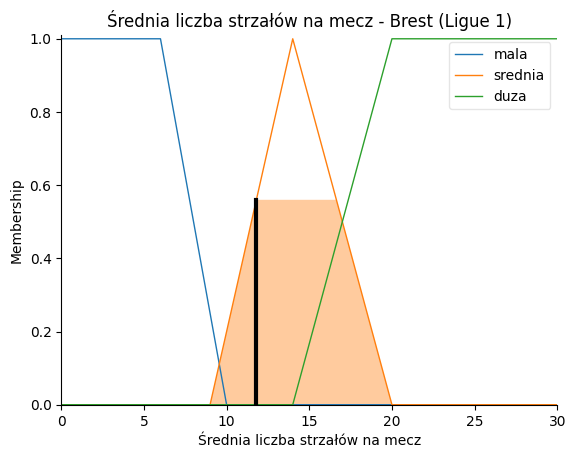

<Figure size 1000x600 with 0 Axes>

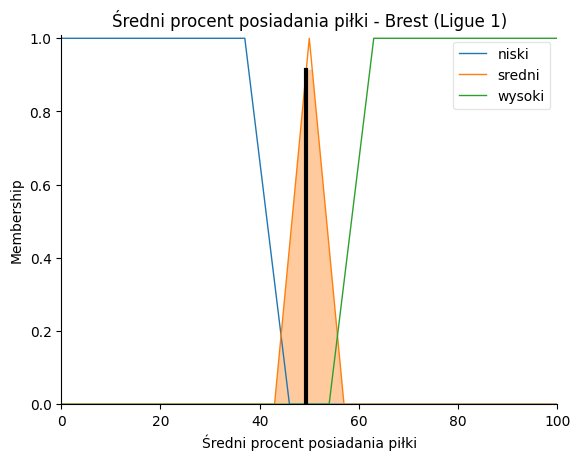

<Figure size 1000x600 with 0 Axes>

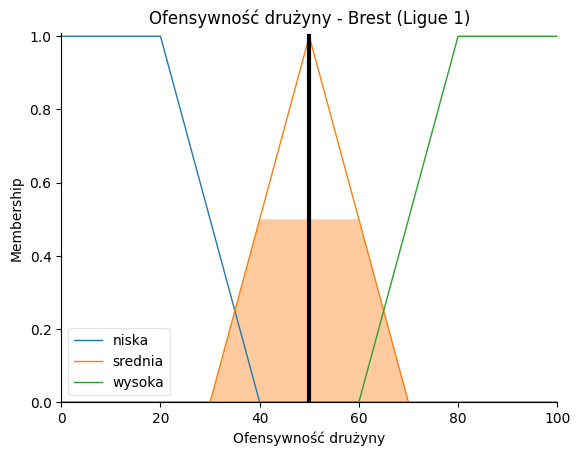

Wiersz 45: Fulham (Premier League)
Ofensywność drużyny = 50.000000000000014 [%]
  Przynależność (Membership):
  Liczba bramek (27): mala=0.72, srednia=0.0, duza=0.0
  Średnia liczba strzałów na mecz (11.6): mala=0.0, srednia=0.5199999999999999, duza=0.0
  Średni procent posiadania piłki (50.0): niski=0.0, sredni=1.0, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

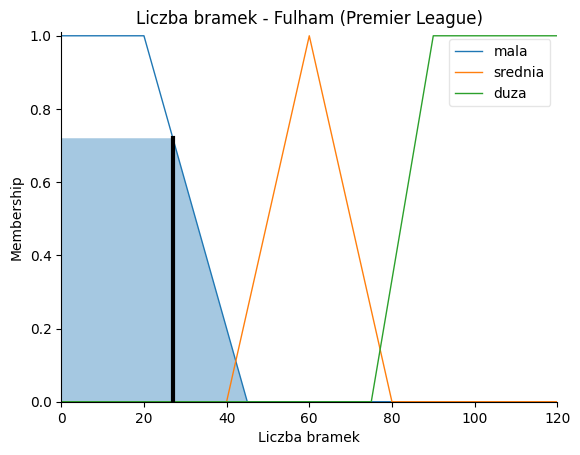

<Figure size 1000x600 with 0 Axes>

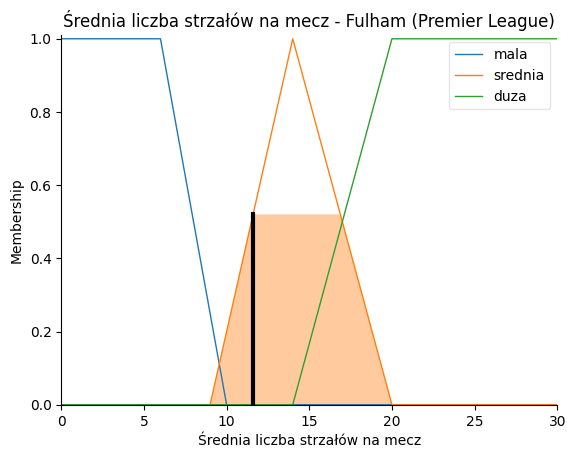

<Figure size 1000x600 with 0 Axes>

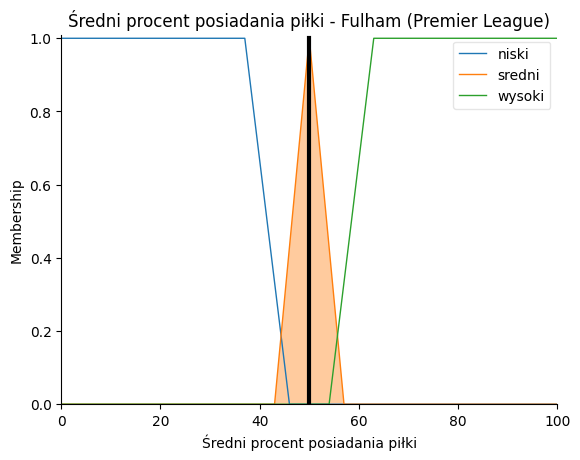

<Figure size 1000x600 with 0 Axes>

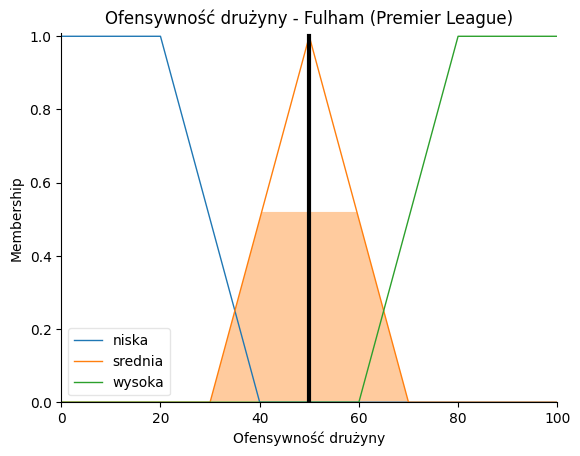

Wiersz 46: Marseille (Ligue 1)
Ofensywność drużyny = 49.99999999999997 [%]
  Przynależność (Membership):
  Liczba bramek (54): mala=0.0, srednia=0.7, duza=0.0
  Średnia liczba strzałów na mecz (10.0): mala=0.0, srednia=0.2, duza=0.0
  Średni procent posiadania piłki (52.4): niski=0.0, sredni=0.6571428571428574, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

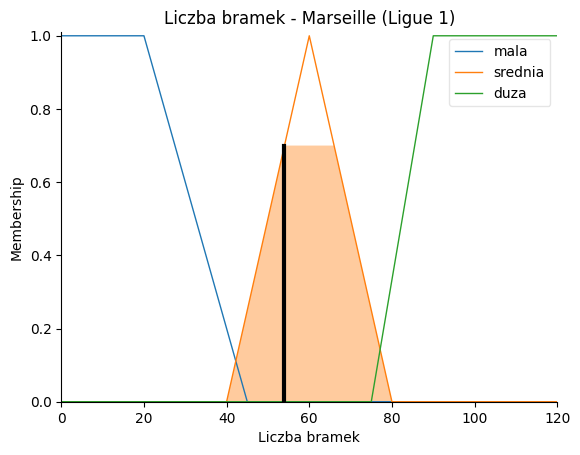

<Figure size 1000x600 with 0 Axes>

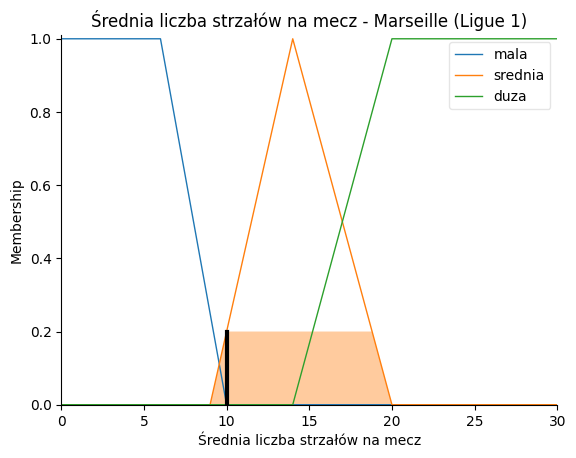

<Figure size 1000x600 with 0 Axes>

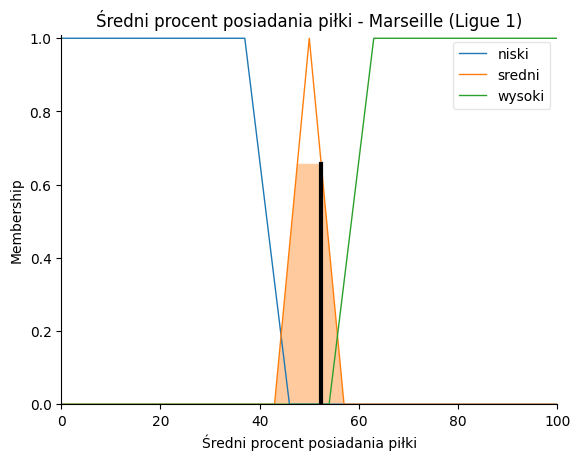

<Figure size 1000x600 with 0 Axes>

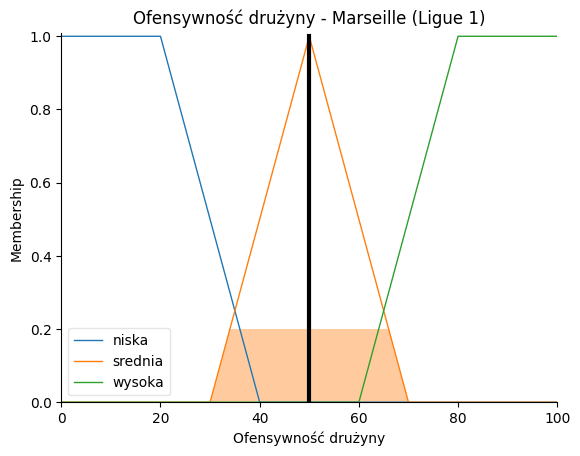

Wiersz 47: Sampdoria (Serie A)
Ofensywność drużyny = 50.0 [%]
  Przynależność (Membership):
  Liczba bramek (52): mala=0.0, srednia=0.6, duza=0.0
  Średnia liczba strzałów na mecz (11.3): mala=0.0, srednia=0.46000000000000013, duza=0.0
  Średni procent posiadania piłki (46.1): niski=0.0, sredni=0.44285714285714306, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

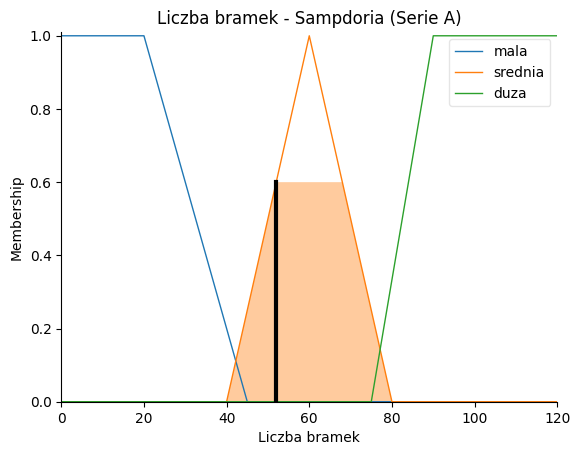

<Figure size 1000x600 with 0 Axes>

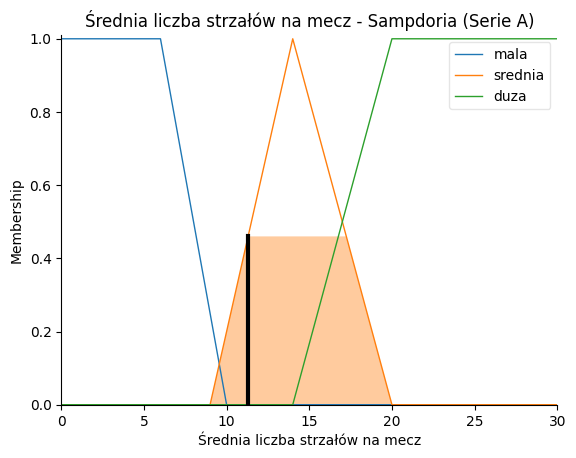

<Figure size 1000x600 with 0 Axes>

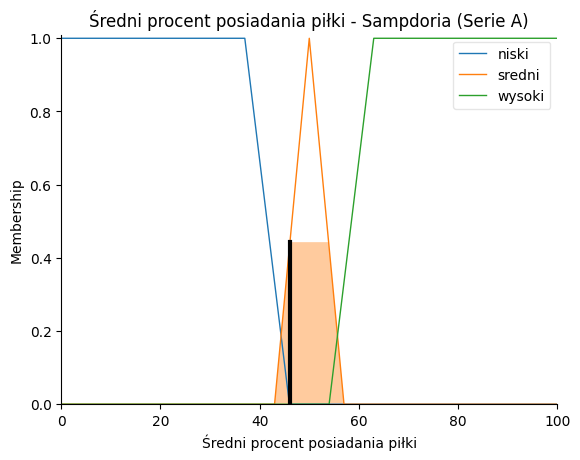

<Figure size 1000x600 with 0 Axes>

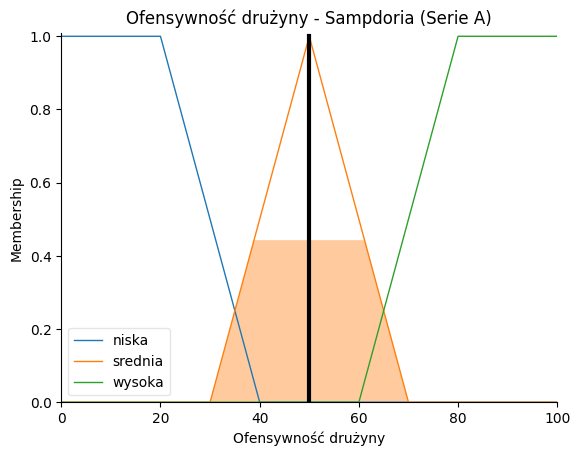

Wiersz 48: Montpellier (Ligue 1)
Ofensywność drużyny = 49.999999999999986 [%]
  Przynależność (Membership):
  Liczba bramek (60): mala=0.0, srednia=1.0, duza=0.0
  Średnia liczba strzałów na mecz (12.2): mala=0.0, srednia=0.6399999999999999, duza=0.0
  Średni procent posiadania piłki (46.4): niski=0.0, sredni=0.48571428571428554, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

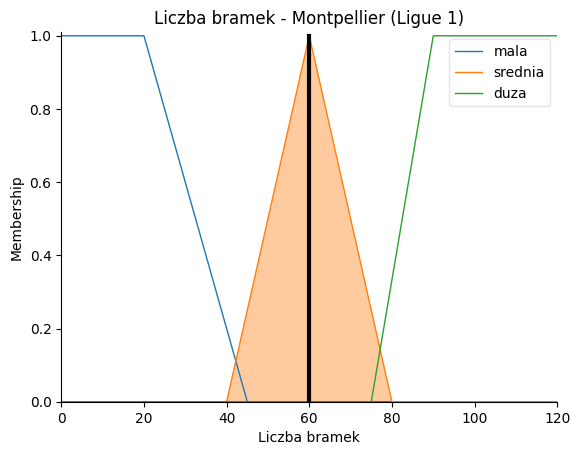

<Figure size 1000x600 with 0 Axes>

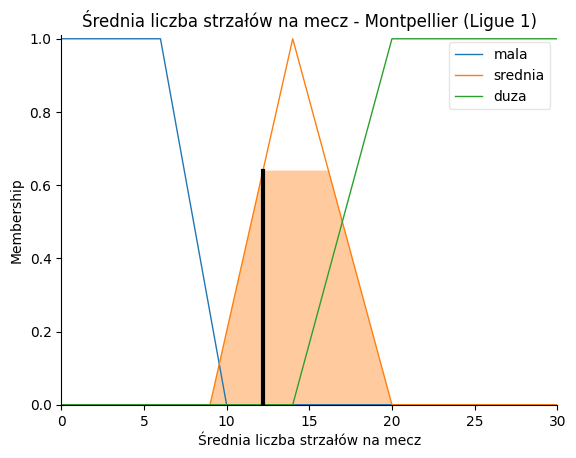

<Figure size 1000x600 with 0 Axes>

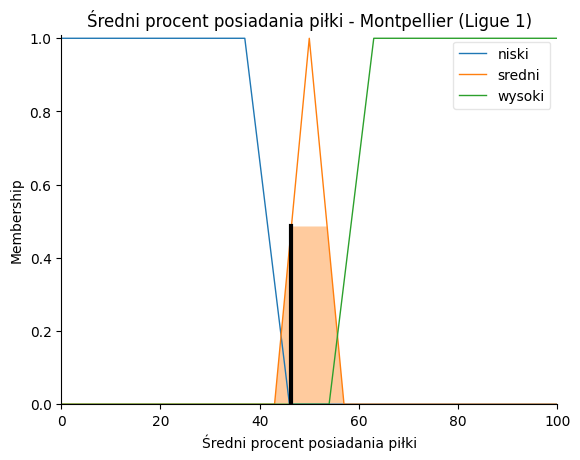

<Figure size 1000x600 with 0 Axes>

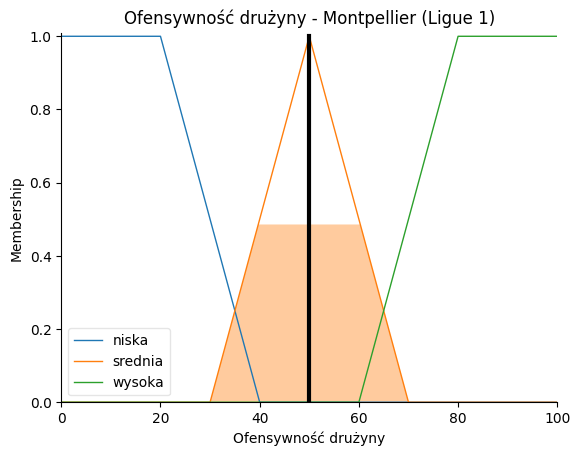

Wiersz 49: Nice (Ligue 1)
Ofensywność drużyny = 50.00000000000001 [%]
  Przynależność (Membership):
  Liczba bramek (50): mala=0.0, srednia=0.5, duza=0.0
  Średnia liczba strzałów na mecz (10.8): mala=0.0, srednia=0.36000000000000015, duza=0.0
  Średni procent posiadania piłki (53.4): niski=0.0, sredni=0.5142857142857145, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

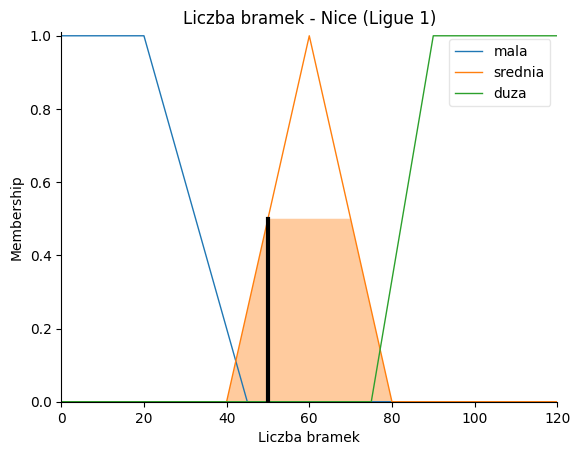

<Figure size 1000x600 with 0 Axes>

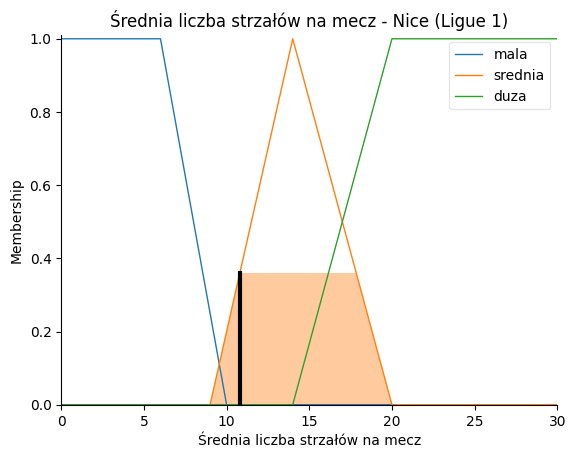

<Figure size 1000x600 with 0 Axes>

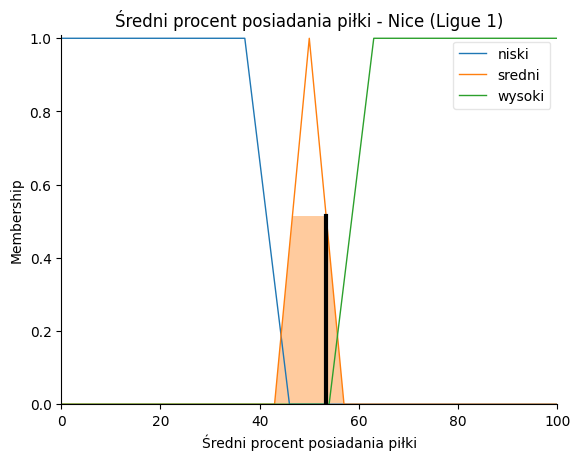

<Figure size 1000x600 with 0 Axes>

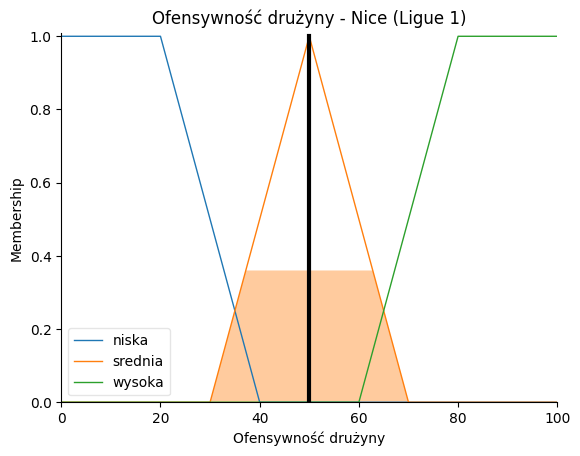

Wiersz 50: Hoffenheim (Bundesliga)
Ofensywność drużyny = 50.000000000000014 [%]
  Przynależność (Membership):
  Liczba bramek (52): mala=0.0, srednia=0.6, duza=0.0
  Średnia liczba strzałów na mecz (12.6): mala=0.0, srednia=0.72, duza=0.0
  Średni procent posiadania piłki (50.8): niski=0.0, sredni=0.8857142857142861, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

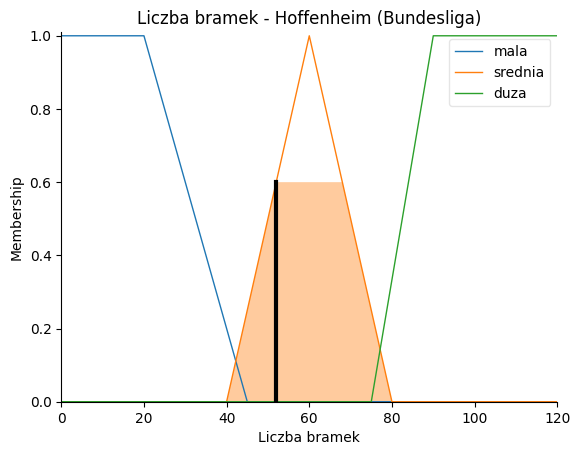

<Figure size 1000x600 with 0 Axes>

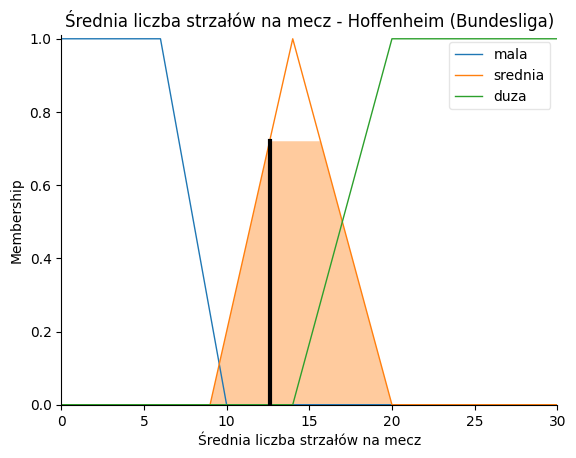

<Figure size 1000x600 with 0 Axes>

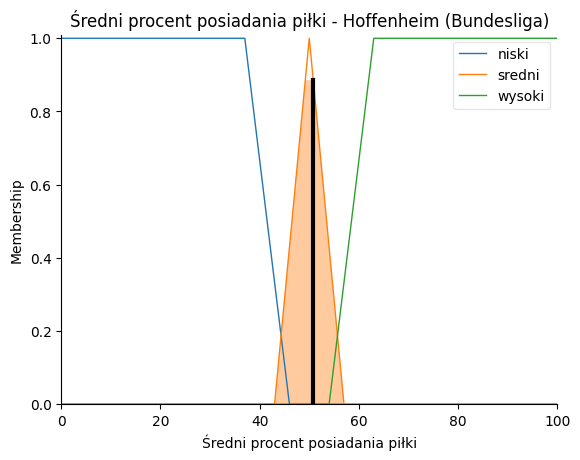

<Figure size 1000x600 with 0 Axes>

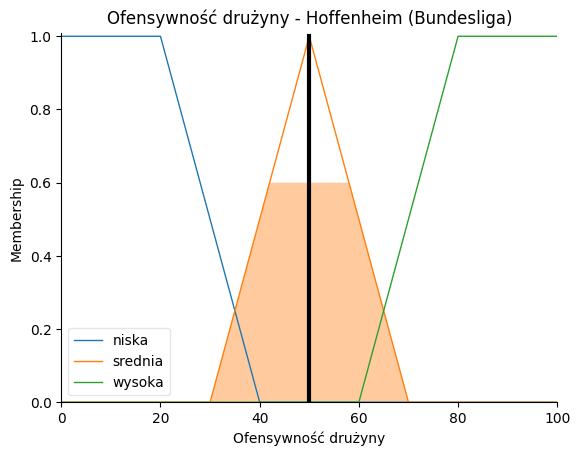

Wiersz 51: Southampton (Premier League)
Ofensywność drużyny = 50.00000000000003 [%]
  Przynależność (Membership):
  Liczba bramek (47): mala=0.0, srednia=0.35, duza=0.0
  Średnia liczba strzałów na mecz (11.2): mala=0.0, srednia=0.4399999999999999, duza=0.0
  Średni procent posiadania piłki (51.4): niski=0.0, sredni=0.8000000000000002, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

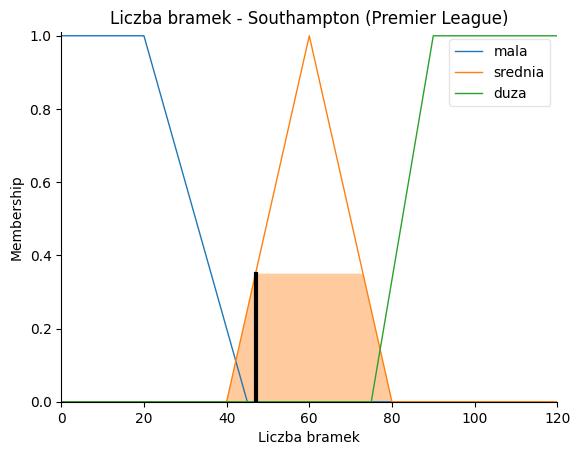

<Figure size 1000x600 with 0 Axes>

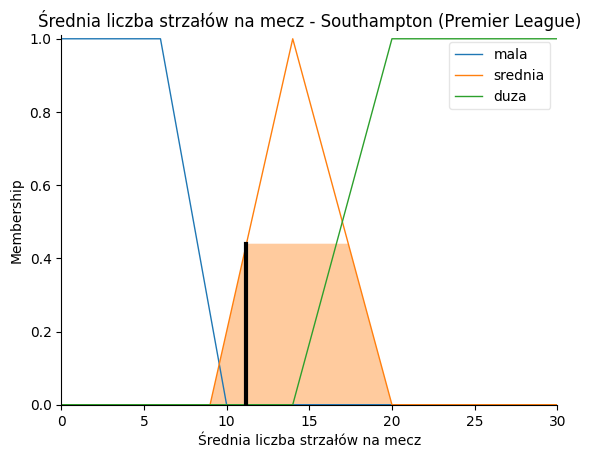

<Figure size 1000x600 with 0 Axes>

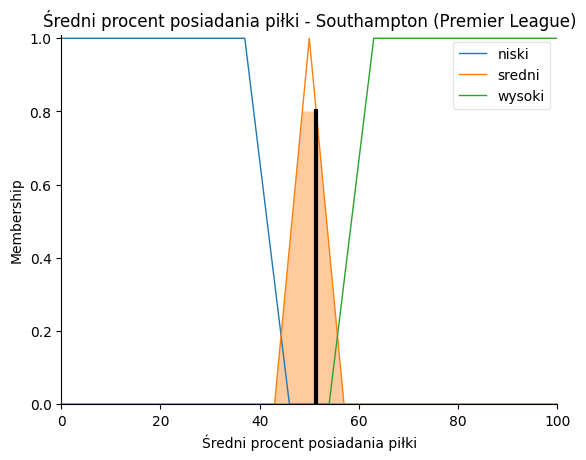

<Figure size 1000x600 with 0 Axes>

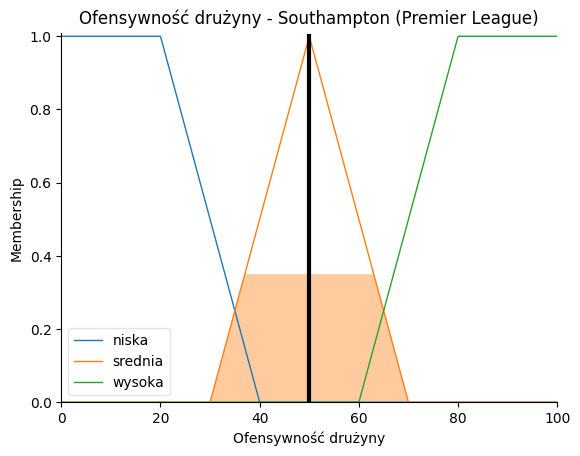

Wiersz 52: Newcastle United (Premier League)
Ofensywność drużyny = 50.0 [%]
  Przynależność (Membership):
  Liczba bramek (46): mala=0.0, srednia=0.3, duza=0.0
  Średnia liczba strzałów na mecz (10.4): mala=0.0, srednia=0.2800000000000001, duza=0.0
  Średni procent posiadania piłki (41.6): niski=0.4888888888888887, sredni=0.0, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

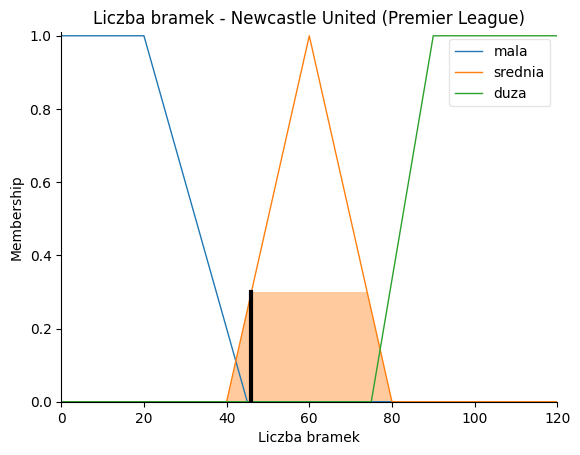

<Figure size 1000x600 with 0 Axes>

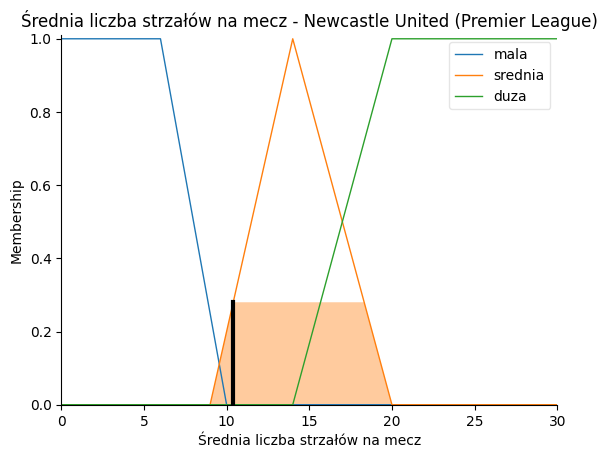

<Figure size 1000x600 with 0 Axes>

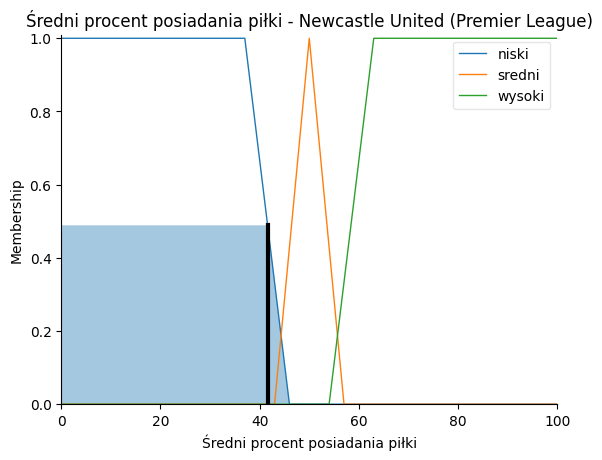

<Figure size 1000x600 with 0 Axes>

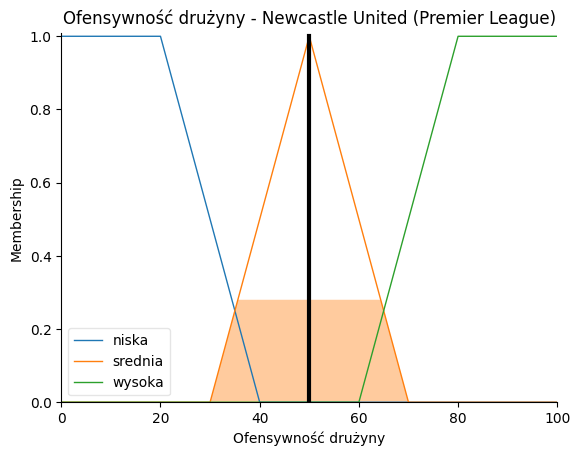

Wiersz 53: Lazio (Serie A)
Ofensywność drużyny = 50.00000000000001 [%]
  Przynależność (Membership):
  Liczba bramek (61): mala=0.0, srednia=0.95, duza=0.0
  Średnia liczba strzałów na mecz (13.8): mala=0.0, srednia=0.9600000000000002, duza=0.0
  Średni procent posiadania piłki (52.2): niski=0.0, sredni=0.6857142857142853, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

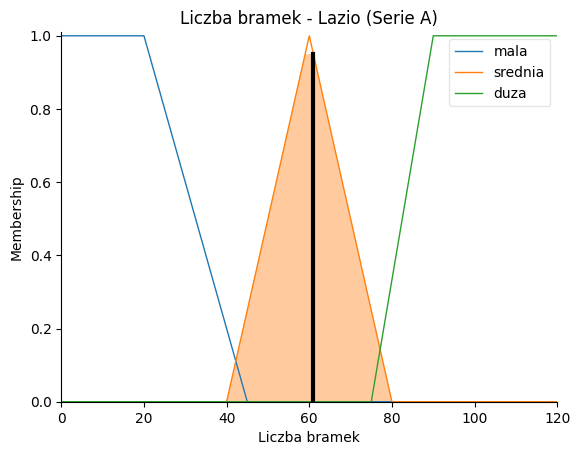

<Figure size 1000x600 with 0 Axes>

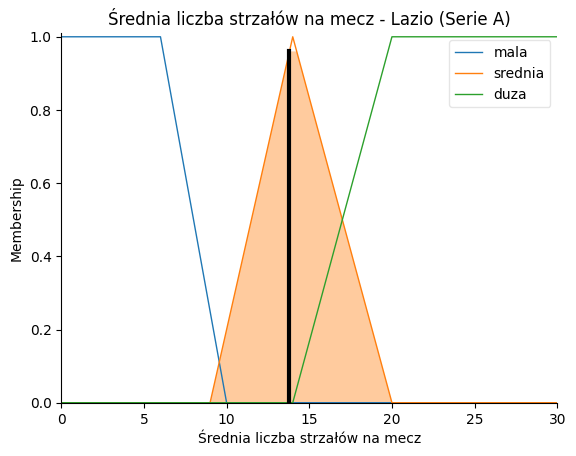

<Figure size 1000x600 with 0 Axes>

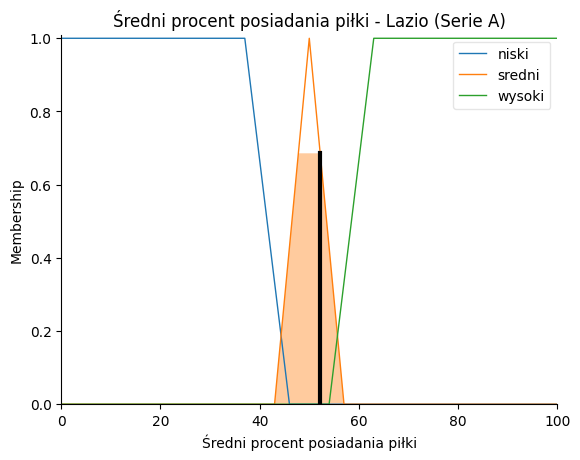

<Figure size 1000x600 with 0 Axes>

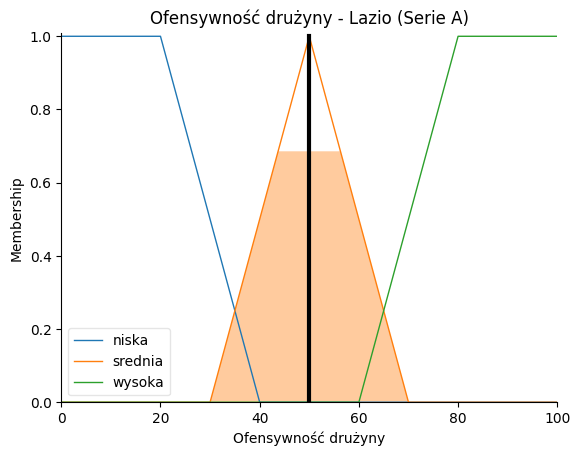

Wiersz 54: Nantes (Ligue 1)
Ofensywność drużyny = 49.99999999999998 [%]
  Przynależność (Membership):
  Liczba bramek (47): mala=0.0, srednia=0.35, duza=0.0
  Średnia liczba strzałów na mecz (10.8): mala=0.0, srednia=0.36000000000000015, duza=0.0
  Średni procent posiadania piłki (45.2): niski=0.08888888888888857, sredni=0.31428571428571467, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

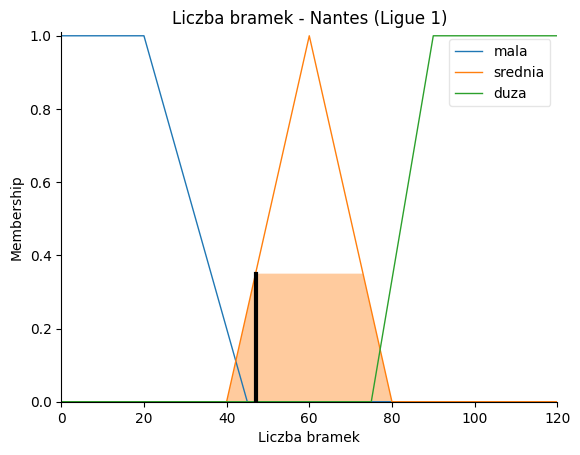

<Figure size 1000x600 with 0 Axes>

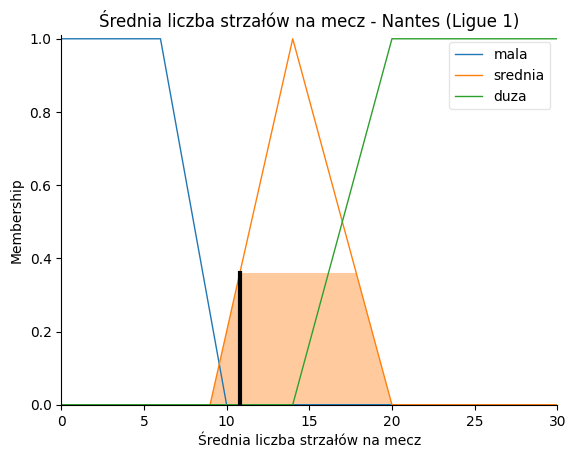

<Figure size 1000x600 with 0 Axes>

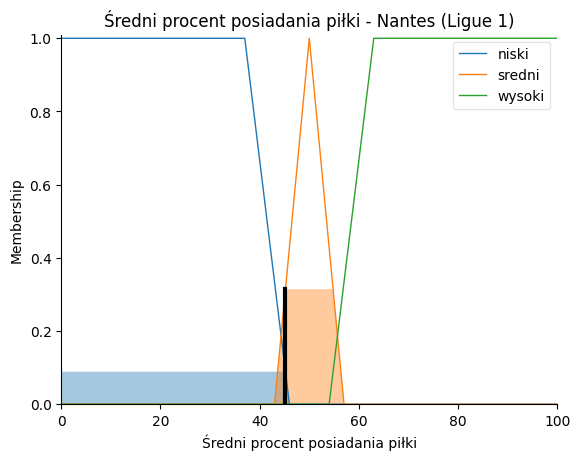

<Figure size 1000x600 with 0 Axes>

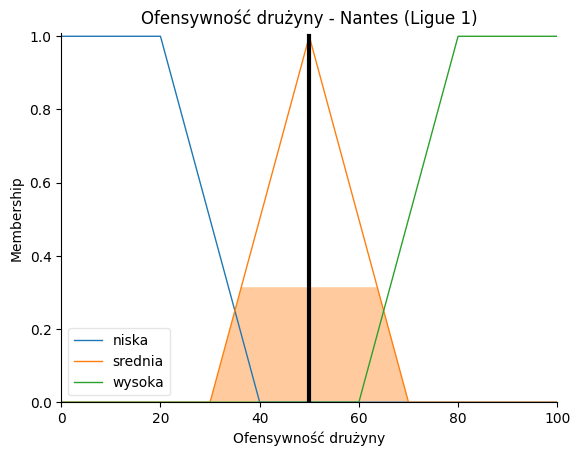

Wiersz 55: Union Berlin (Bundesliga)
Ofensywność drużyny = 50.0 [%]
  Przynależność (Membership):
  Liczba bramek (50): mala=0.0, srednia=0.5, duza=0.0
  Średnia liczba strzałów na mecz (11.7): mala=0.0, srednia=0.5399999999999999, duza=0.0
  Średni procent posiadania piłki (45.9): niski=0.01111111111111127, sredni=0.4142857142857141, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

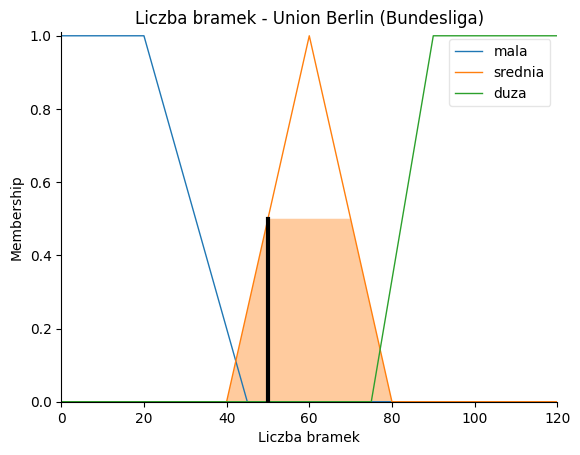

<Figure size 1000x600 with 0 Axes>

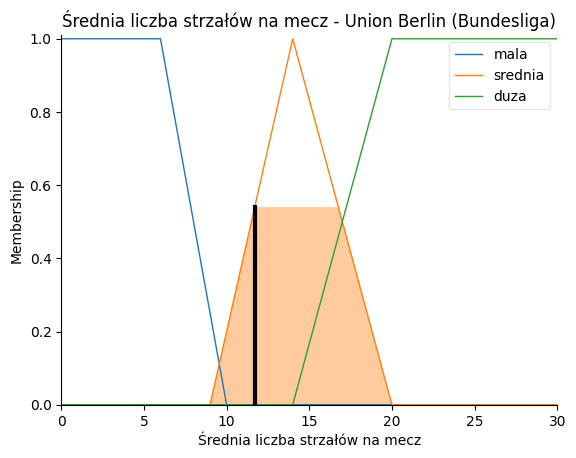

<Figure size 1000x600 with 0 Axes>

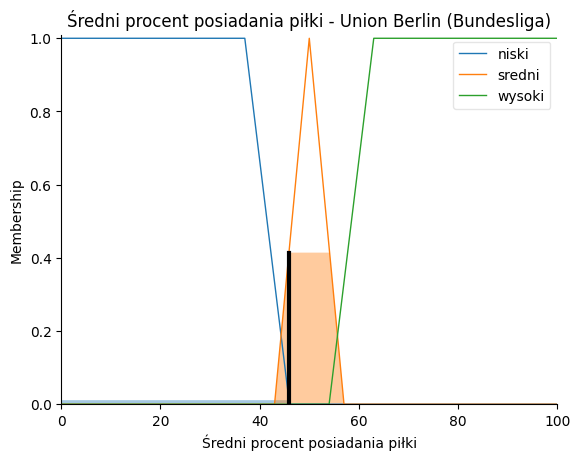

<Figure size 1000x600 with 0 Axes>

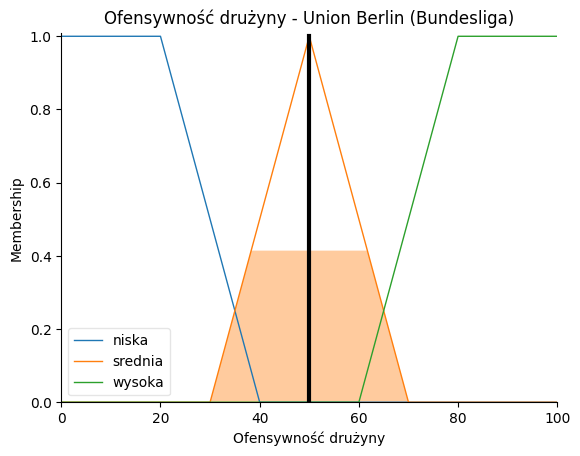

Wiersz 56: Strasbourg (Ligue 1)
Ofensywność drużyny = 50.0 [%]
  Przynależność (Membership):
  Liczba bramek (49): mala=0.0, srednia=0.45, duza=0.0
  Średnia liczba strzałów na mecz (11.3): mala=0.0, srednia=0.46000000000000013, duza=0.0
  Średni procent posiadania piłki (46.5): niski=0.0, sredni=0.5, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

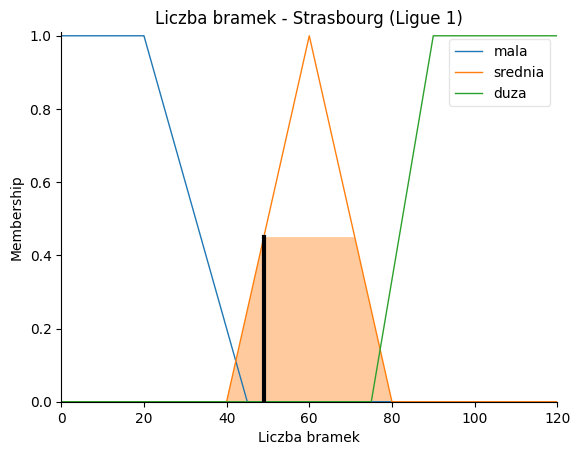

<Figure size 1000x600 with 0 Axes>

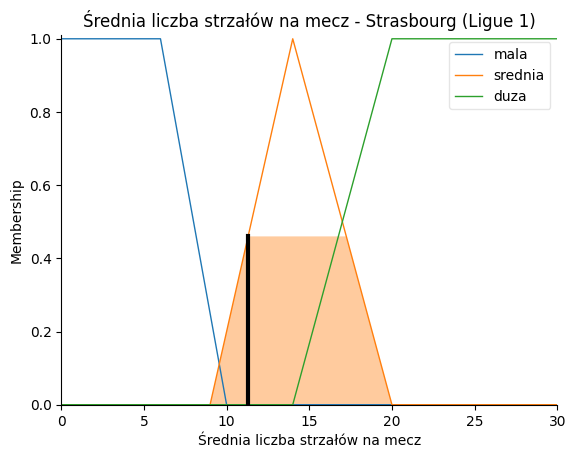

<Figure size 1000x600 with 0 Axes>

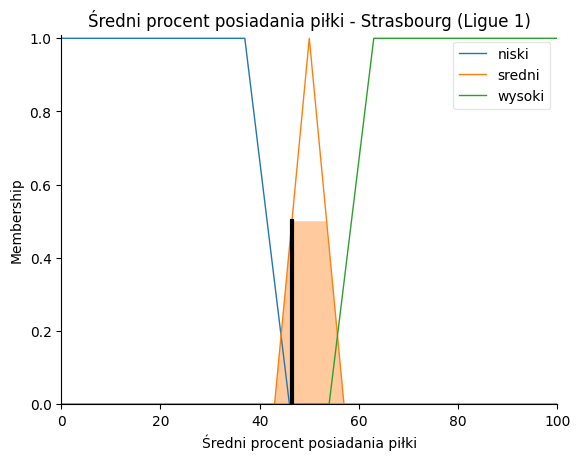

<Figure size 1000x600 with 0 Axes>

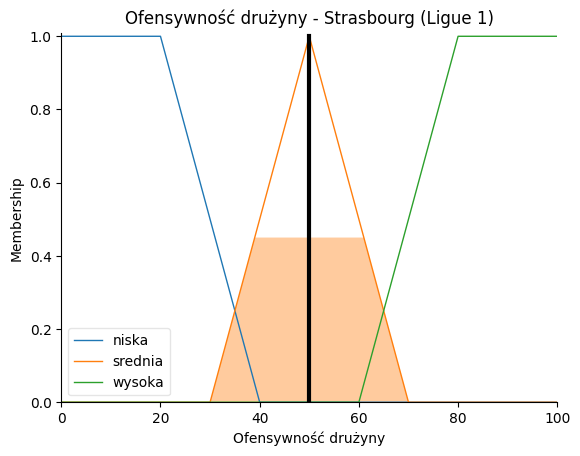

Wiersz 57: Crystal Palace (Premier League)
Ofensywność drużyny = 25.001451642170174 [%]
  Przynależność (Membership):
  Liczba bramek (41): mala=0.16, srednia=0.05, duza=0.0
  Średnia liczba strzałów na mecz (9.2): mala=0.20000000000000018, srednia=0.03999999999999986, duza=0.0
  Średni procent posiadania piłki (42.9): niski=0.3444444444444446, sredni=0.0, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

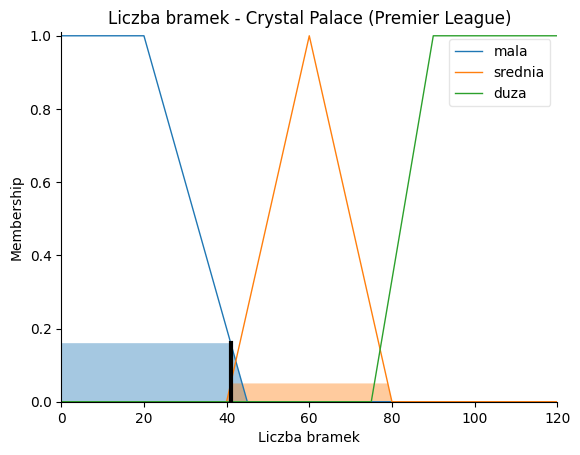

<Figure size 1000x600 with 0 Axes>

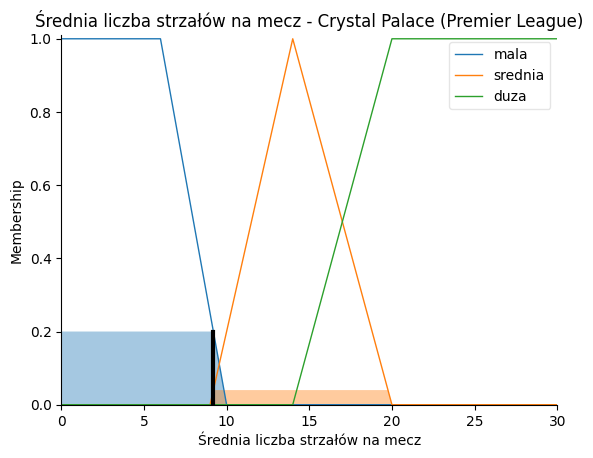

<Figure size 1000x600 with 0 Axes>

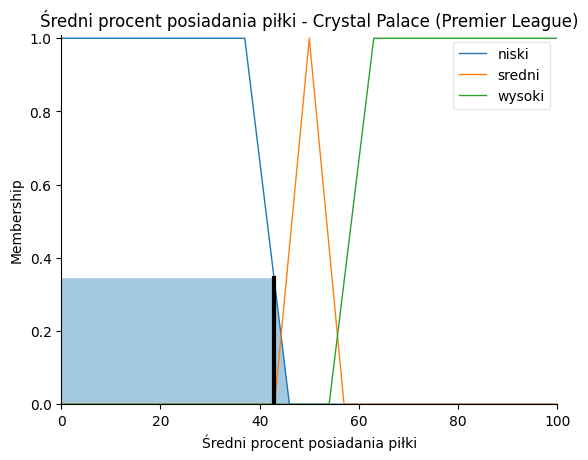

<Figure size 1000x600 with 0 Axes>

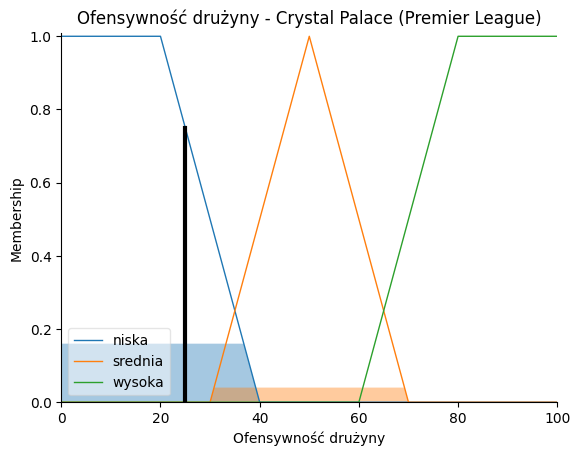

Wiersz 58: Freiburg (Bundesliga)
Ofensywność drużyny = 49.99999999999999 [%]
  Przynależność (Membership):
  Liczba bramek (52): mala=0.0, srednia=0.6, duza=0.0
  Średnia liczba strzałów na mecz (11.4): mala=0.0, srednia=0.4800000000000001, duza=0.0
  Średni procent posiadania piłki (47.5): niski=0.0, sredni=0.6428571428571429, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

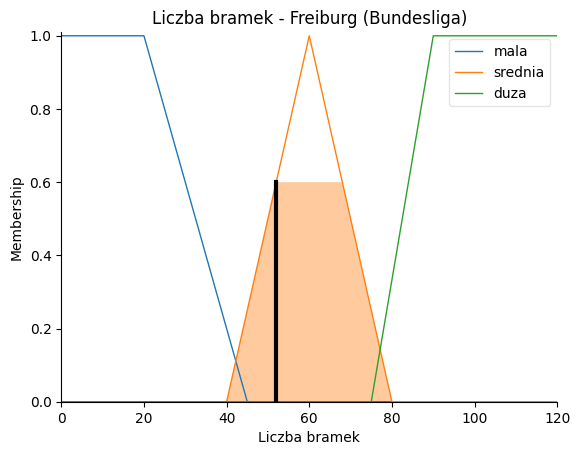

<Figure size 1000x600 with 0 Axes>

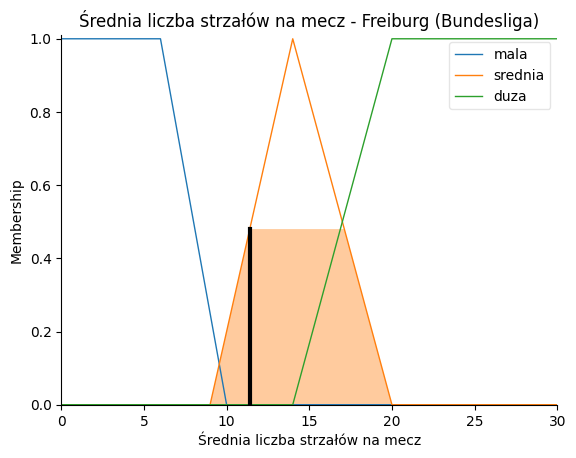

<Figure size 1000x600 with 0 Axes>

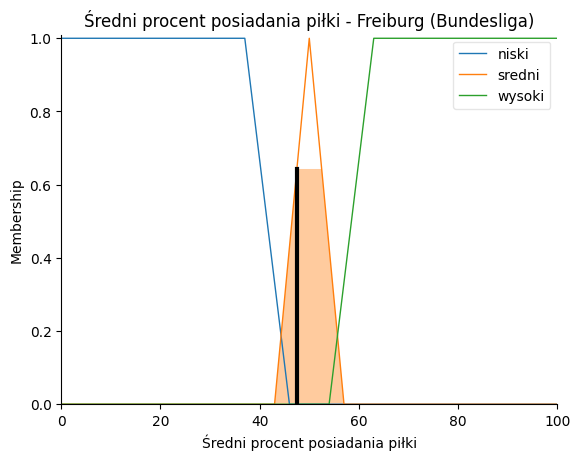

<Figure size 1000x600 with 0 Axes>

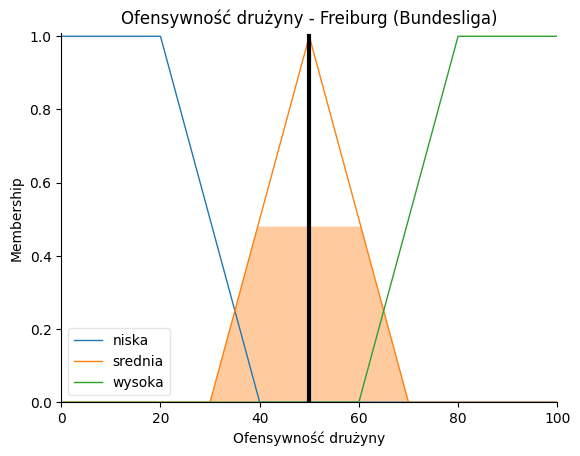

Wiersz 59: Valencia (LaLiga)
Ofensywność drużyny = 50.000000000000014 [%]
  Przynależność (Membership):
  Liczba bramek (50): mala=0.0, srednia=0.5, duza=0.0
  Średnia liczba strzałów na mecz (10.3): mala=0.0, srednia=0.2600000000000001, duza=0.0
  Średni procent posiadania piłki (47.9): niski=0.0, sredni=0.6999999999999998, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

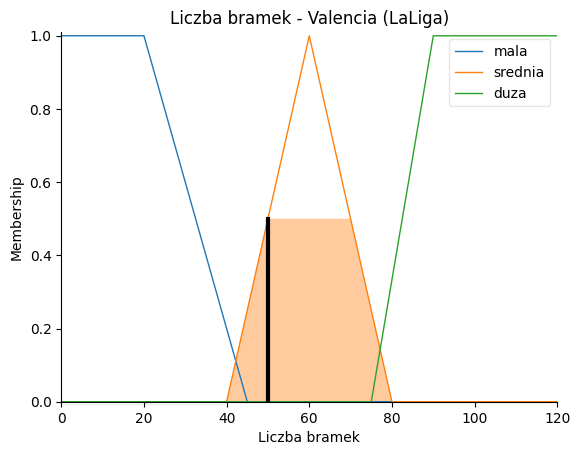

<Figure size 1000x600 with 0 Axes>

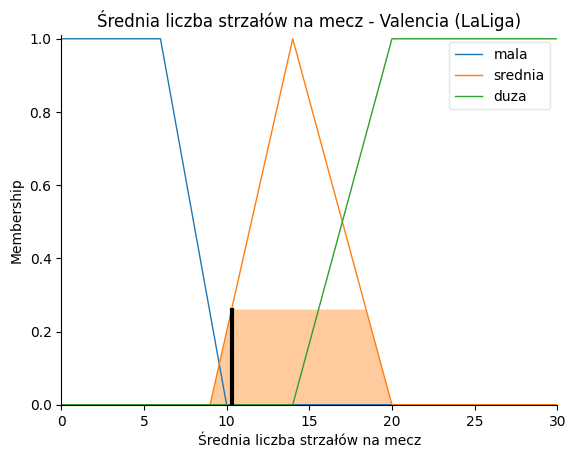

<Figure size 1000x600 with 0 Axes>

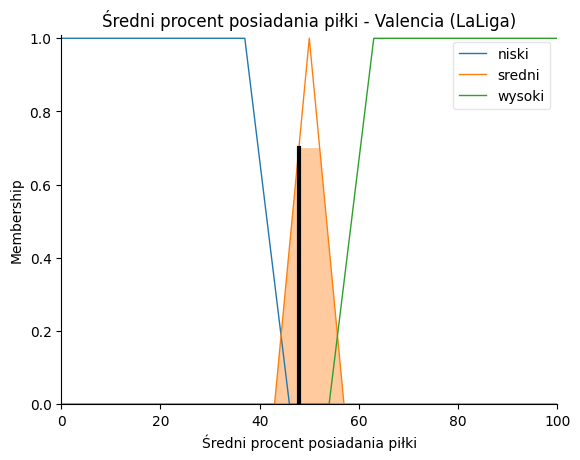

<Figure size 1000x600 with 0 Axes>

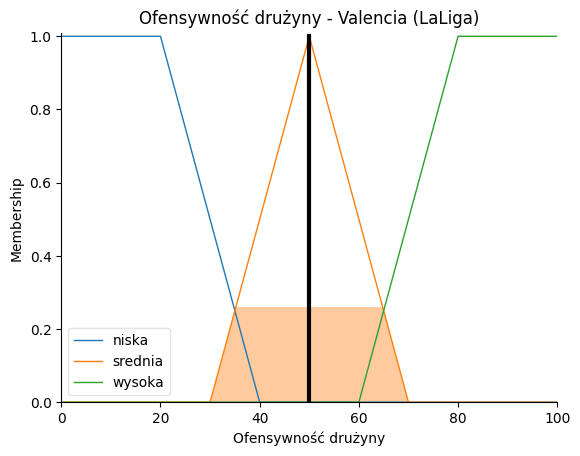

Wiersz 60: Celta Vigo (LaLiga)
Ofensywność drużyny = 49.99999999999996 [%]
  Przynależność (Membership):
  Liczba bramek (55): mala=0.0, srednia=0.75, duza=0.0
  Średnia liczba strzałów na mecz (9.4): mala=0.1499999999999999, srednia=0.08000000000000007, duza=0.0
  Średni procent posiadania piłki (52.0): niski=0.0, sredni=0.7142857142857143, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

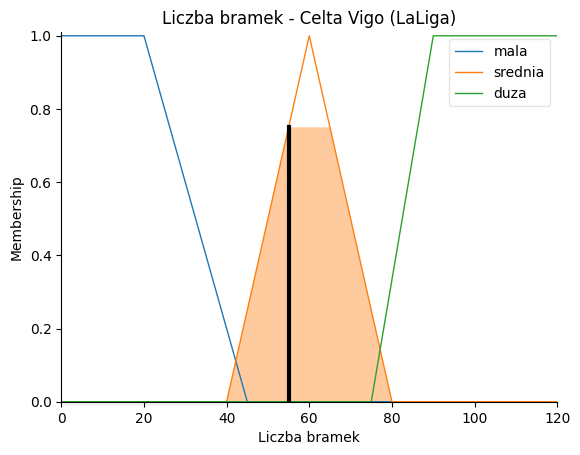

<Figure size 1000x600 with 0 Axes>

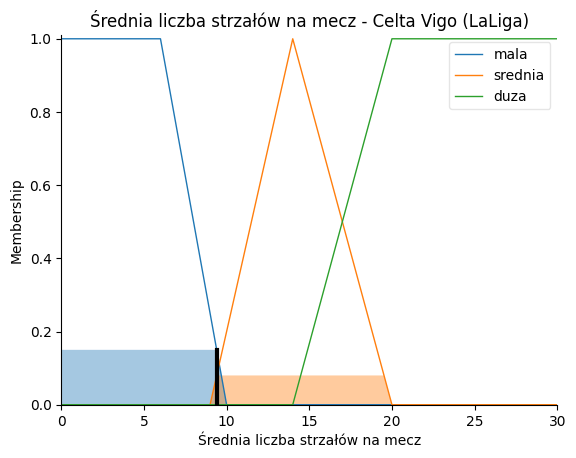

<Figure size 1000x600 with 0 Axes>

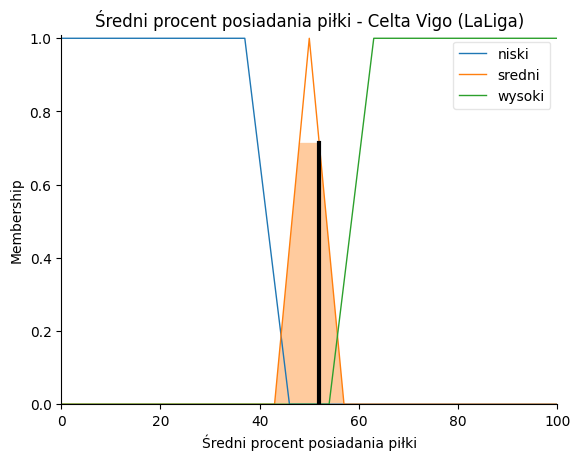

<Figure size 1000x600 with 0 Axes>

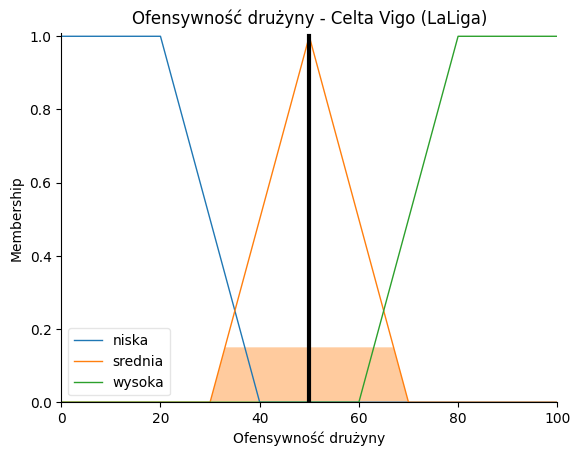

Wiersz 61: Reims (Ligue 1)
Ofensywność drużyny = 35.95200560518476 [%]
  Przynależność (Membership):
  Liczba bramek (42): mala=0.12, srednia=0.1, duza=0.0
  Średnia liczba strzałów na mecz (9.6): mala=0.10000000000000009, srednia=0.11999999999999994, duza=0.0
  Średni procent posiadania piłki (46.3): niski=0.0, sredni=0.47142857142857103, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

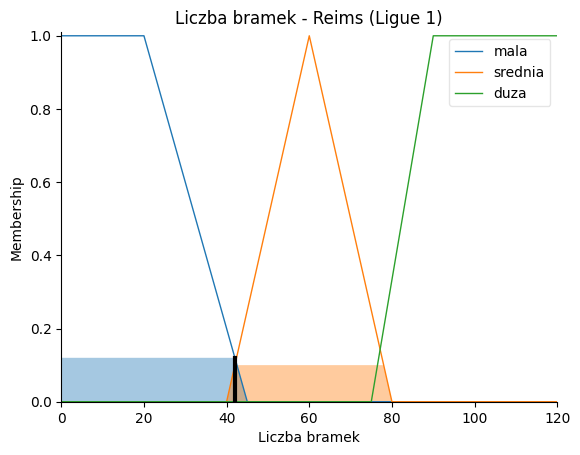

<Figure size 1000x600 with 0 Axes>

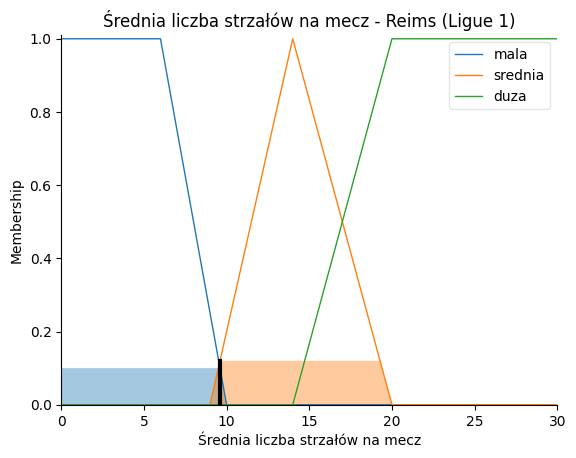

<Figure size 1000x600 with 0 Axes>

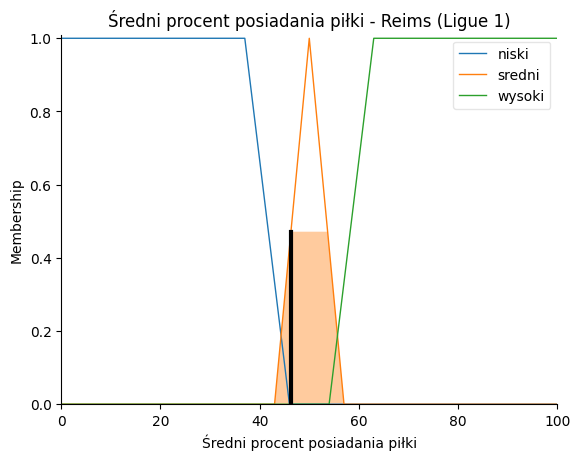

<Figure size 1000x600 with 0 Axes>

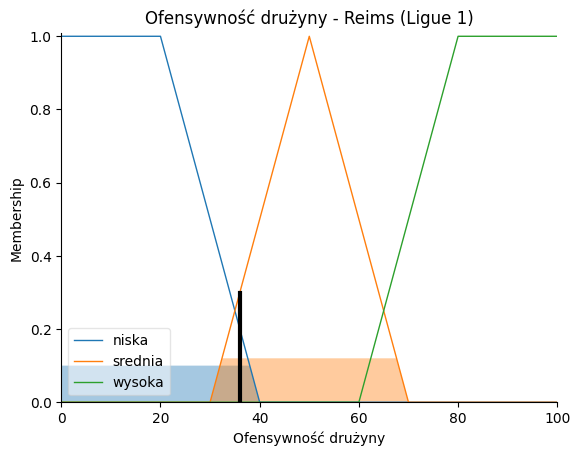

Wiersz 62: Torino (Serie A)
Ofensywność drużyny = 50.0 [%]
  Przynależność (Membership):
  Liczba bramek (50): mala=0.0, srednia=0.5, duza=0.0
  Średnia liczba strzałów na mecz (12.2): mala=0.0, srednia=0.6399999999999999, duza=0.0
  Średni procent posiadania piłki (48.0): niski=0.0, sredni=0.7142857142857143, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

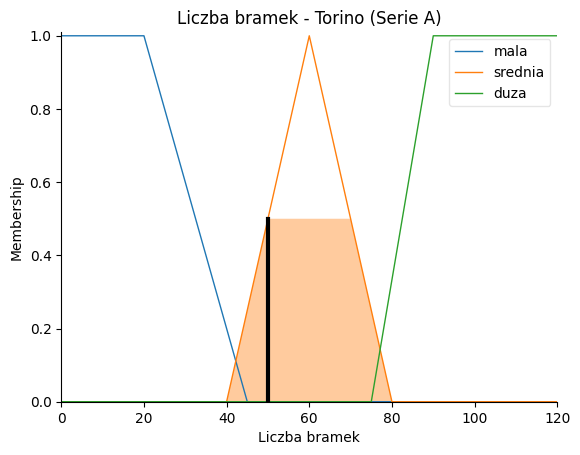

<Figure size 1000x600 with 0 Axes>

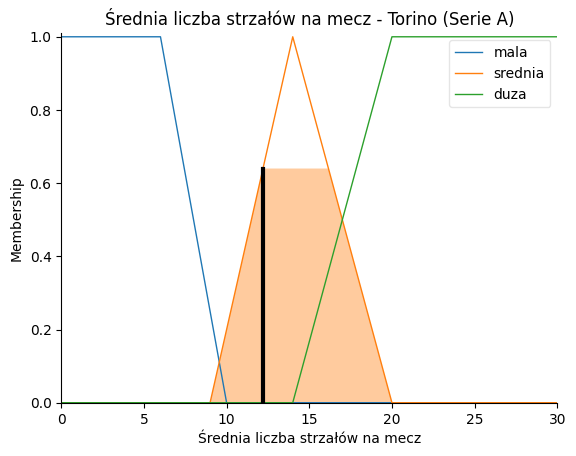

<Figure size 1000x600 with 0 Axes>

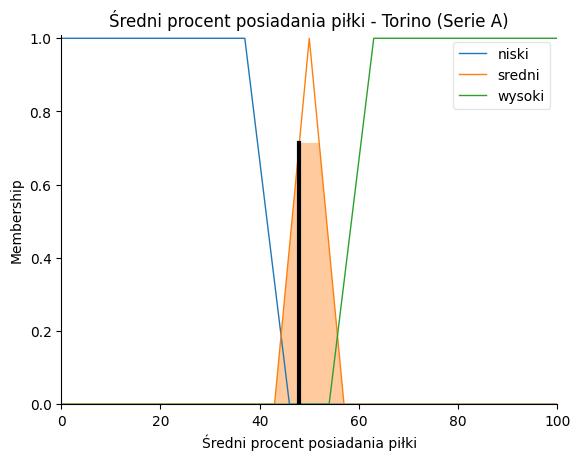

<Figure size 1000x600 with 0 Axes>

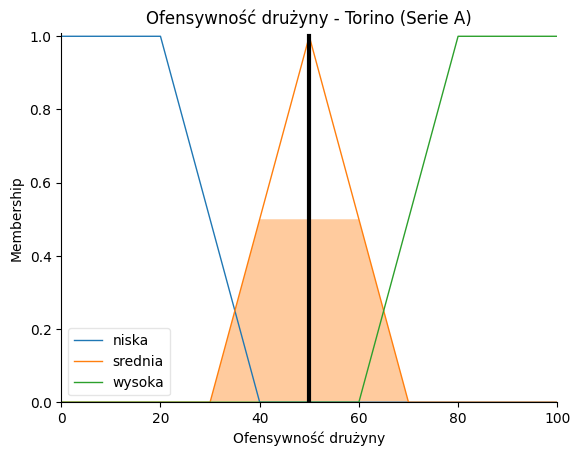

Wiersz 63: Verona (Serie A)
Ofensywność drużyny = 49.999999999999986 [%]
  Przynależność (Membership):
  Liczba bramek (43): mala=0.08, srednia=0.15, duza=0.0
  Średnia liczba strzałów na mecz (10.6): mala=0.0, srednia=0.31999999999999995, duza=0.0
  Średni procent posiadania piłki (49.6): niski=0.0, sredni=0.9428571428571431, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

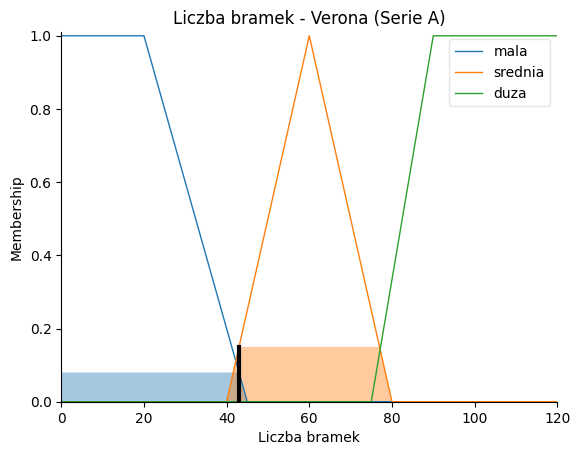

<Figure size 1000x600 with 0 Axes>

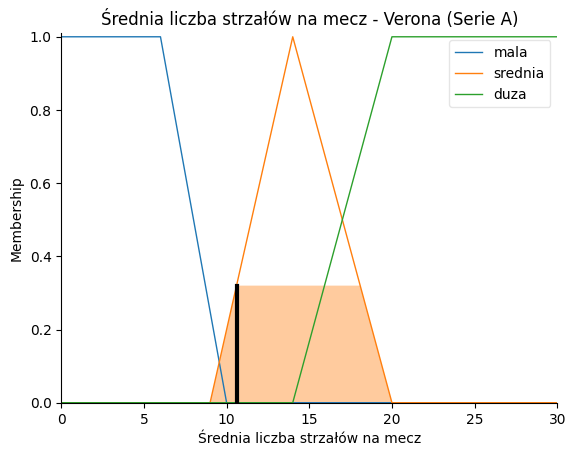

<Figure size 1000x600 with 0 Axes>

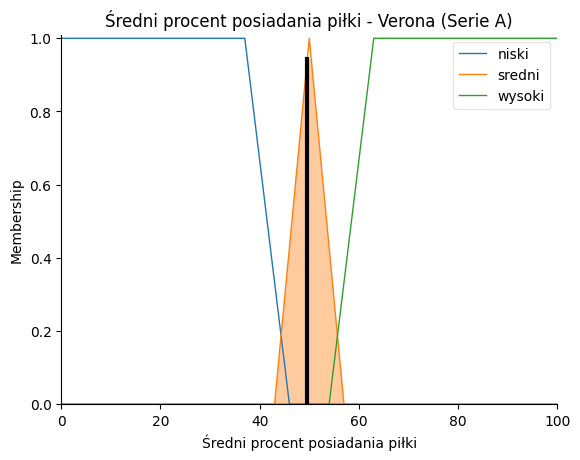

<Figure size 1000x600 with 0 Axes>

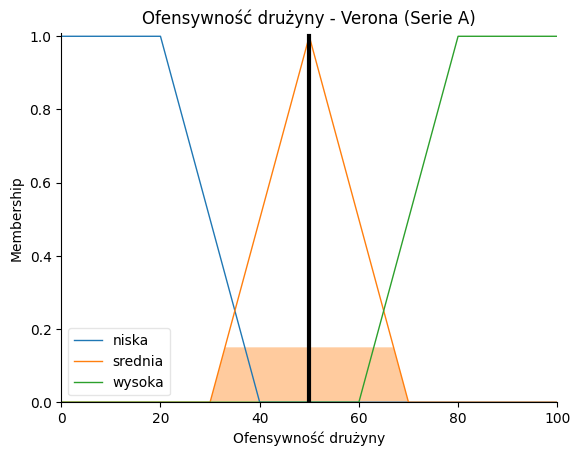

Wiersz 64: Saint-Etienne (Ligue 1)
Ofensywność drużyny = 49.99999999999996 [%]
  Przynależność (Membership):
  Liczba bramek (42): mala=0.12, srednia=0.1, duza=0.0
  Średnia liczba strzałów na mecz (11.6): mala=0.0, srednia=0.5199999999999999, duza=0.0
  Średni procent posiadania piłki (49.0): niski=0.0, sredni=0.8571428571428571, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

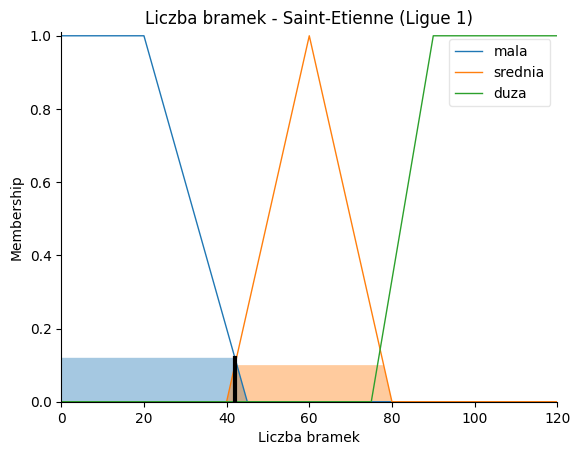

<Figure size 1000x600 with 0 Axes>

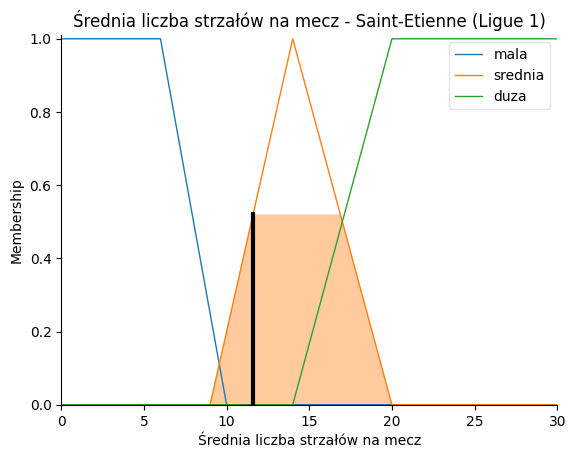

<Figure size 1000x600 with 0 Axes>

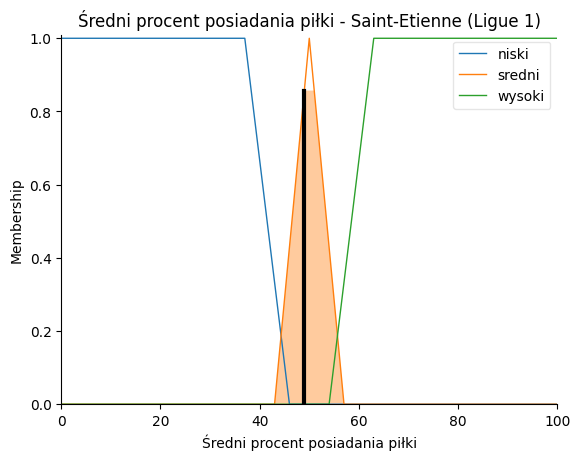

<Figure size 1000x600 with 0 Axes>

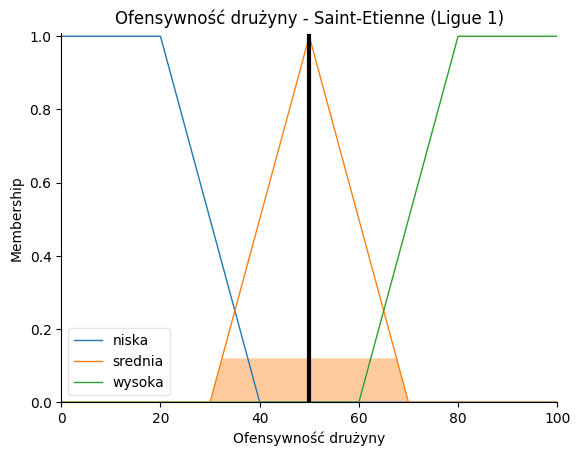

Wiersz 65: Bordeaux (Ligue 1)
Ofensywność drużyny = 49.99999999999996 [%]
  Przynależność (Membership):
  Liczba bramek (42): mala=0.12, srednia=0.1, duza=0.0
  Średnia liczba strzałów na mecz (11.1): mala=0.0, srednia=0.41999999999999993, duza=0.0
  Średni procent posiadania piłki (50.2): niski=0.0, sredni=0.971428571428571, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

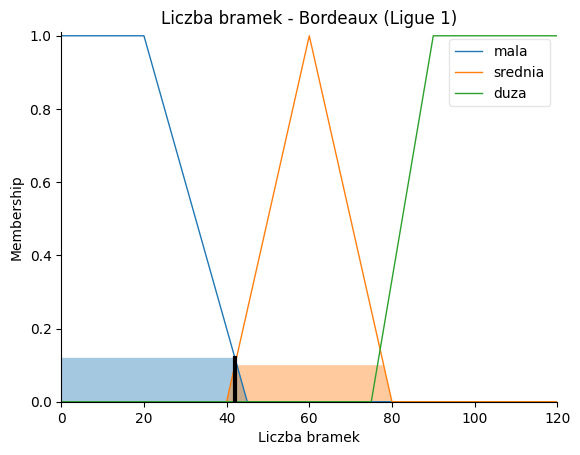

<Figure size 1000x600 with 0 Axes>

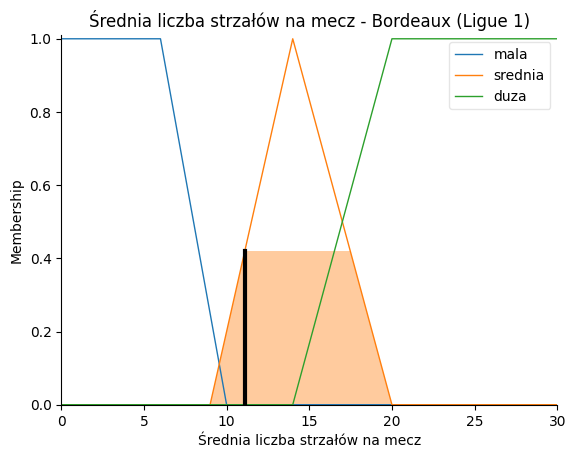

<Figure size 1000x600 with 0 Axes>

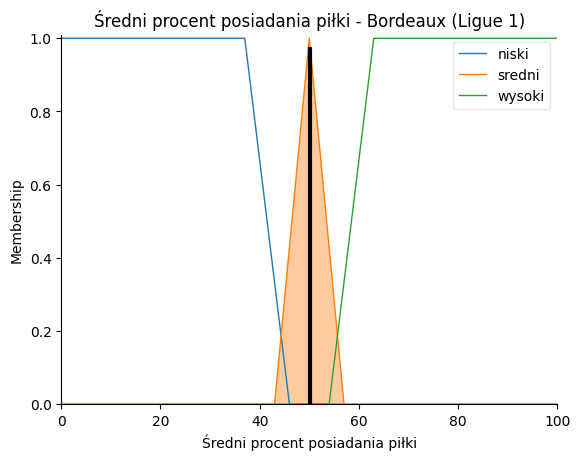

<Figure size 1000x600 with 0 Axes>

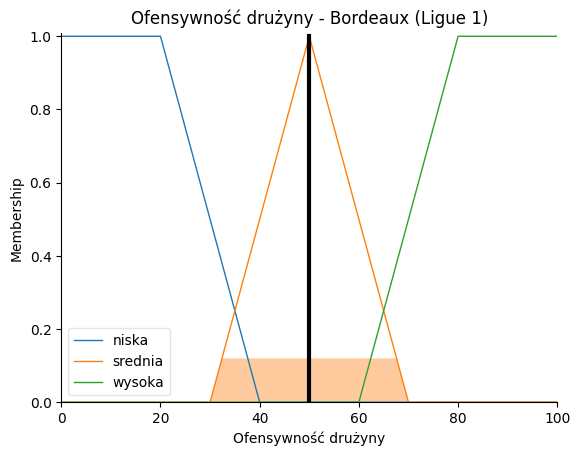

Wiersz 66: Hertha Berlin (Bundesliga)
Ofensywność drużyny = 49.999999999999986 [%]
  Przynależność (Membership):
  Liczba bramek (41): mala=0.16, srednia=0.05, duza=0.0
  Średnia liczba strzałów na mecz (11.3): mala=0.0, srednia=0.46000000000000013, duza=0.0
  Średni procent posiadania piłki (49.8): niski=0.0, sredni=0.9714285714285711, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

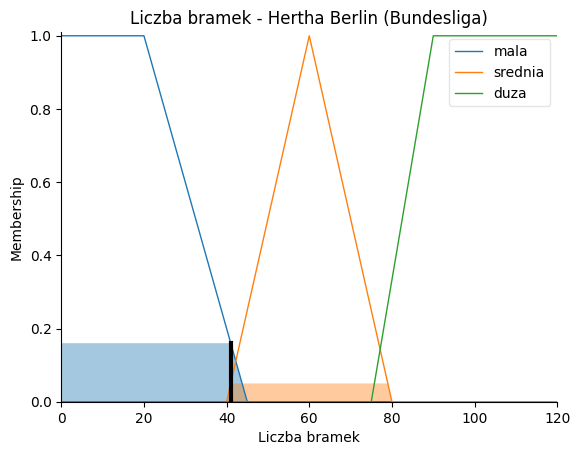

<Figure size 1000x600 with 0 Axes>

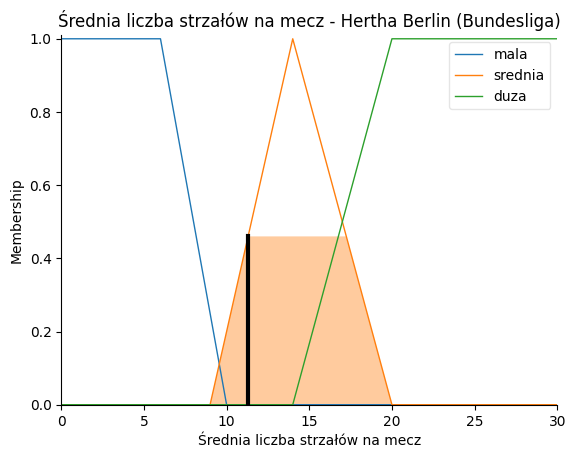

<Figure size 1000x600 with 0 Axes>

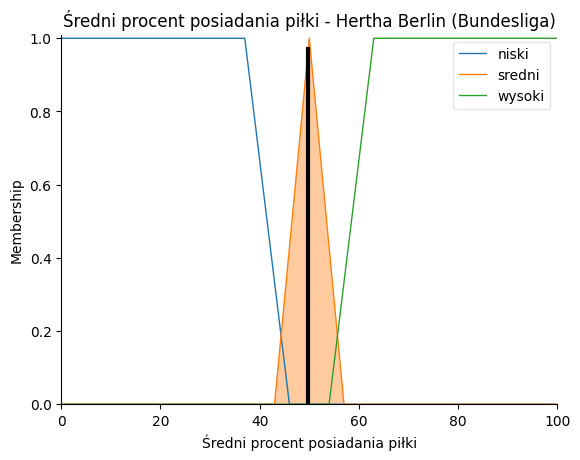

<Figure size 1000x600 with 0 Axes>

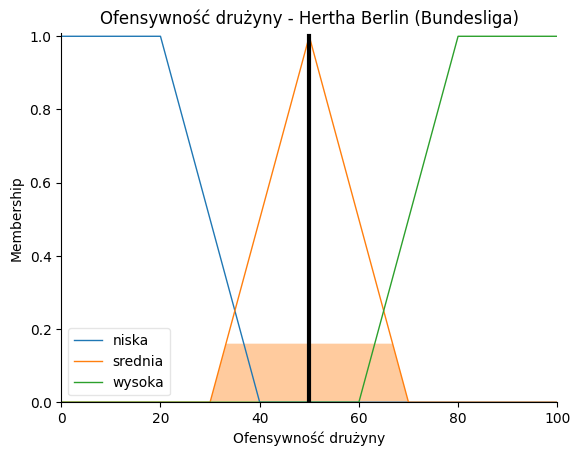

Wiersz 67: Cagliari (Serie A)
Ofensywność drużyny = 46.21825750817716 [%]
  Przynależność (Membership):
  Liczba bramek (43): mala=0.08, srednia=0.15, duza=0.0
  Średnia liczba strzałów na mecz (11.4): mala=0.0, srednia=0.4800000000000001, duza=0.0
  Średni procent posiadania piłki (45.8): niski=0.02222222222222254, sredni=0.39999999999999963, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

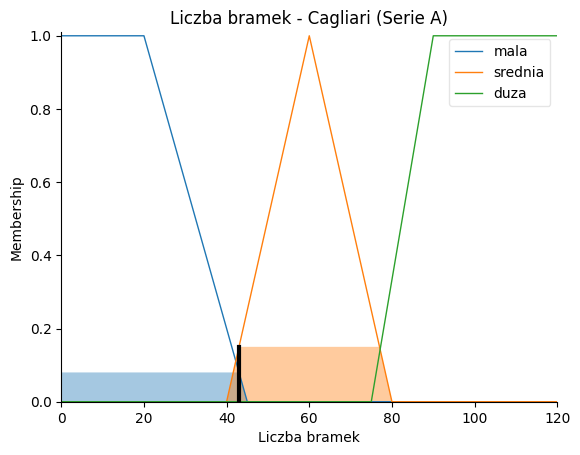

<Figure size 1000x600 with 0 Axes>

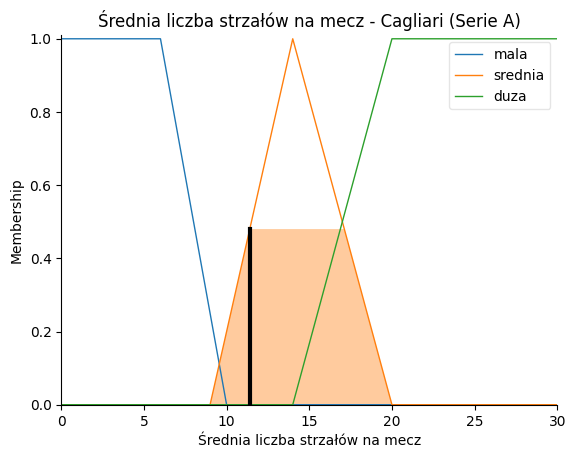

<Figure size 1000x600 with 0 Axes>

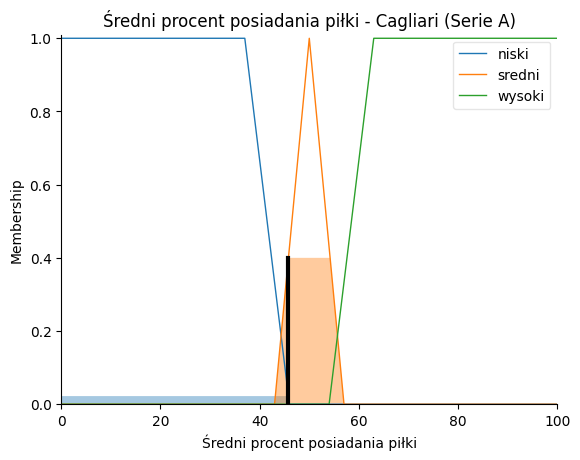

<Figure size 1000x600 with 0 Axes>

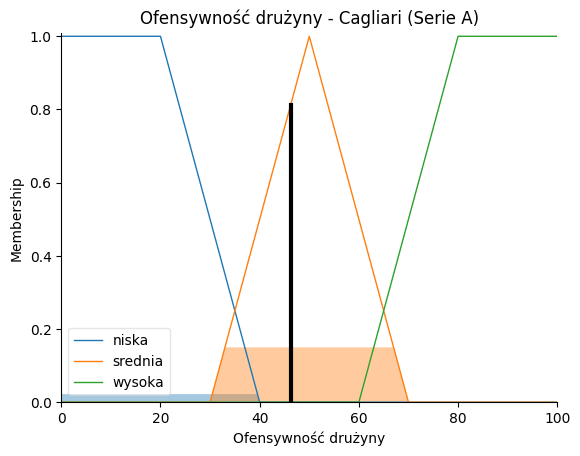

Wiersz 68: Mainz 05 (Bundesliga)
Ofensywność drużyny = 18.825531914893595 [%]
  Przynależność (Membership):
  Liczba bramek (39): mala=0.24, srednia=0.0, duza=0.0
  Średnia liczba strzałów na mecz (11.1): mala=0.0, srednia=0.41999999999999993, duza=0.0
  Średni procent posiadania piłki (42.7): niski=0.36666666666666636, sredni=0.0, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

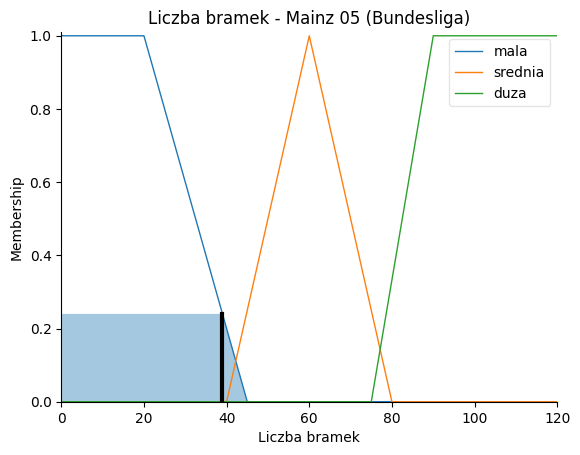

<Figure size 1000x600 with 0 Axes>

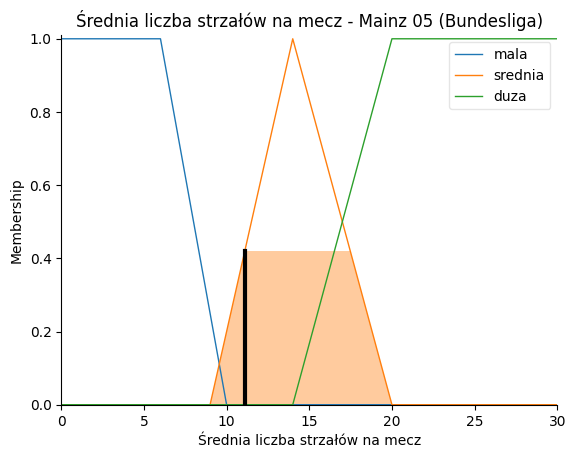

<Figure size 1000x600 with 0 Axes>

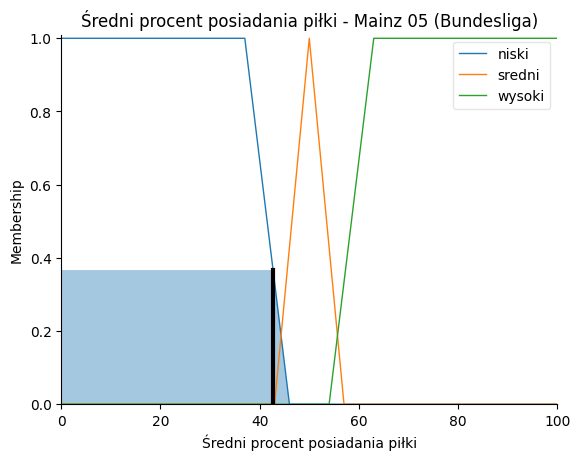

<Figure size 1000x600 with 0 Axes>

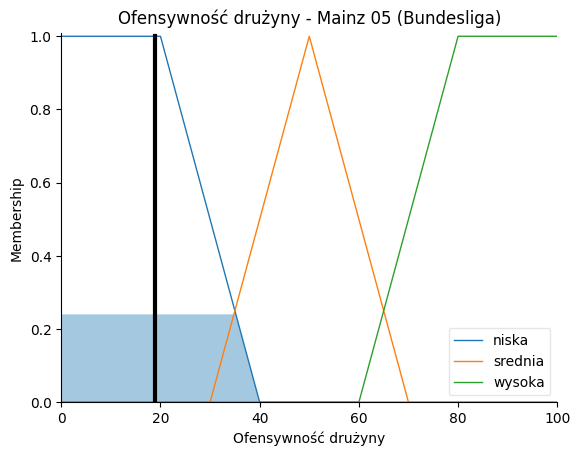

Wiersz 69: Bologna (Serie A)
Ofensywność drużyny = 49.999999999999986 [%]
  Przynależność (Membership):
  Liczba bramek (51): mala=0.0, srednia=0.55, duza=0.0
  Średnia liczba strzałów na mecz (13.1): mala=0.0, srednia=0.82, duza=0.0
  Średni procent posiadania piłki (50.7): niski=0.0, sredni=0.8999999999999996, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

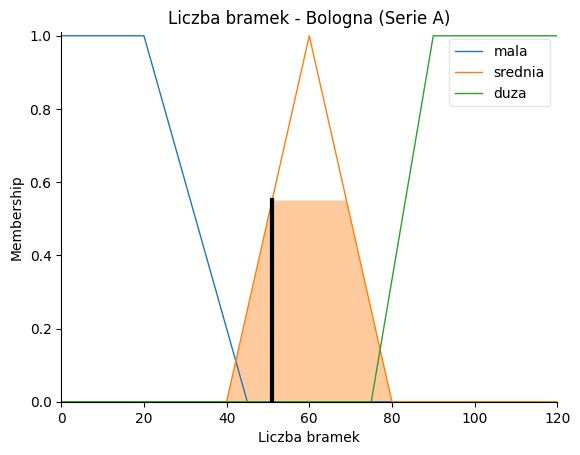

<Figure size 1000x600 with 0 Axes>

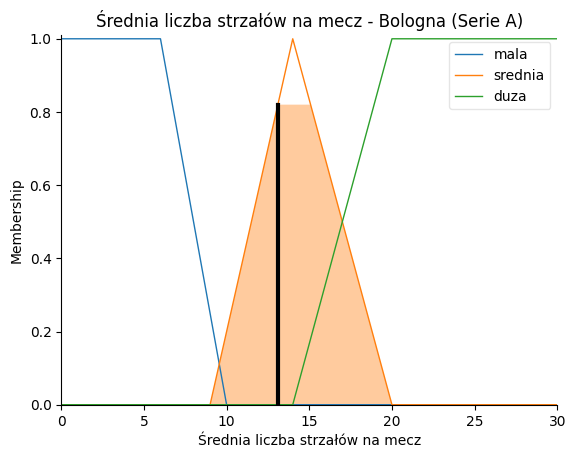

<Figure size 1000x600 with 0 Axes>

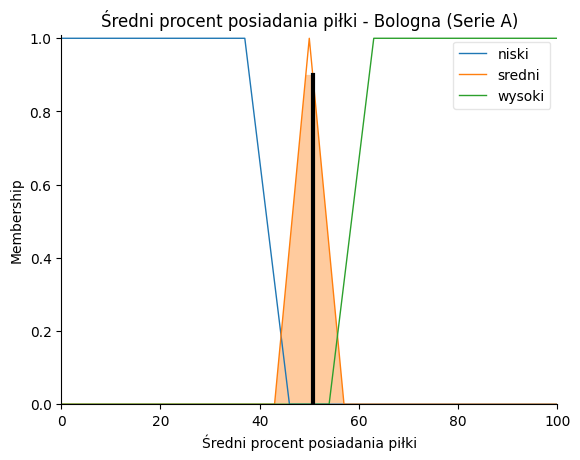

<Figure size 1000x600 with 0 Axes>

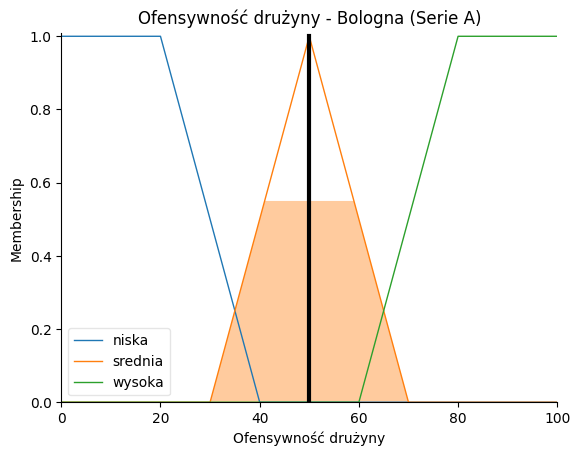

Wiersz 70: Augsburg (Bundesliga)
Ofensywność drużyny = 32.34593189012301 [%]
  Przynależność (Membership):
  Liczba bramek (36): mala=0.36, srednia=0.0, duza=0.0
  Średnia liczba strzałów na mecz (9.9): mala=0.02499999999999991, srednia=0.18000000000000008, duza=0.0
  Średni procent posiadania piłki (44.0): niski=0.2222222222222222, sredni=0.14285714285714285, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

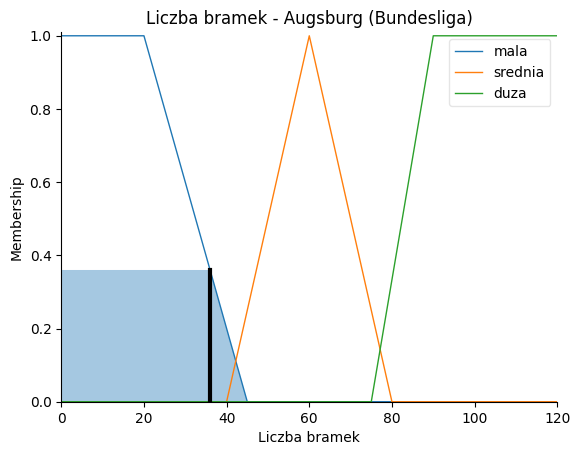

<Figure size 1000x600 with 0 Axes>

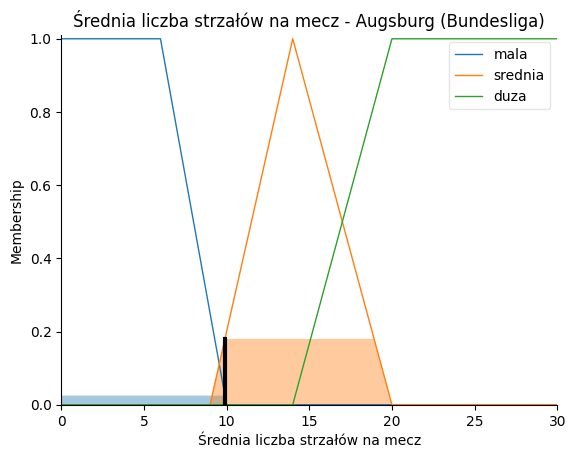

<Figure size 1000x600 with 0 Axes>

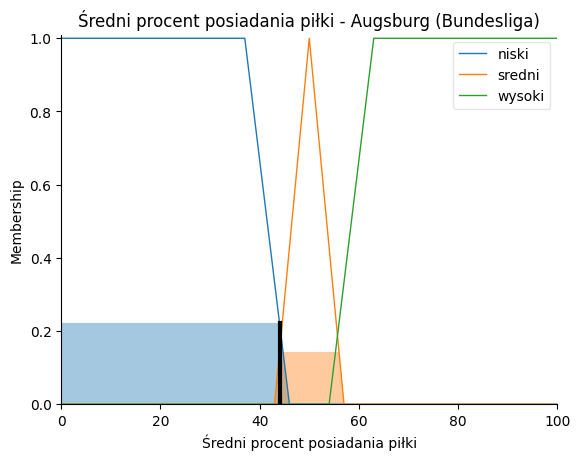

<Figure size 1000x600 with 0 Axes>

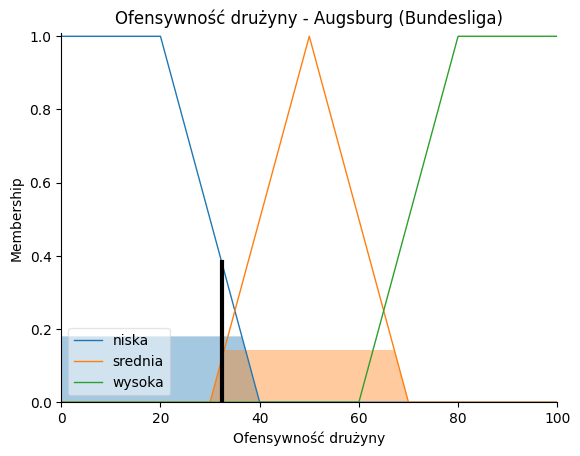

Wiersz 71: Udinese (Serie A)
Ofensywność drużyny = 49.99999999999996 [%]
  Przynależność (Membership):
  Liczba bramek (42): mala=0.12, srednia=0.1, duza=0.0
  Średnia liczba strzałów na mecz (10.9): mala=0.0, srednia=0.38000000000000006, duza=0.0
  Średni procent posiadania piłki (47.2): niski=0.0, sredni=0.6000000000000004, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

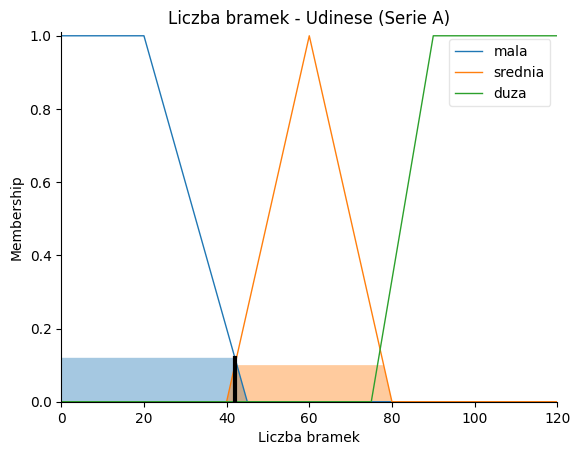

<Figure size 1000x600 with 0 Axes>

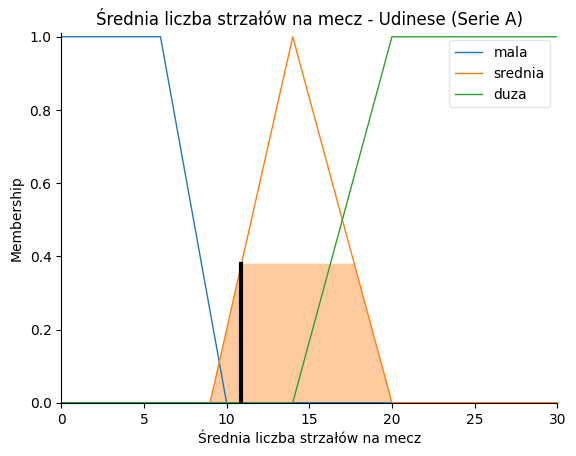

<Figure size 1000x600 with 0 Axes>

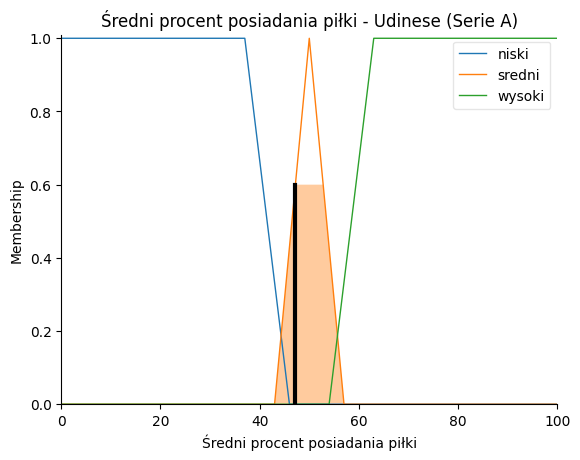

<Figure size 1000x600 with 0 Axes>

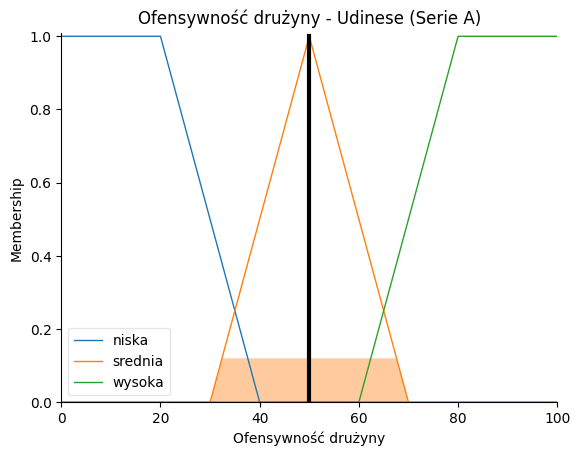

Wiersz 72: SD Huesca (LaLiga)
Ofensywność drużyny = 49.99999999999999 [%]
  Przynależność (Membership):
  Liczba bramek (34): mala=0.44, srednia=0.0, duza=0.0
  Średnia liczba strzałów na mecz (10.7): mala=0.0, srednia=0.33999999999999986, duza=0.0
  Średni procent posiadania piłki (48.7): niski=0.0, sredni=0.8142857142857147, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

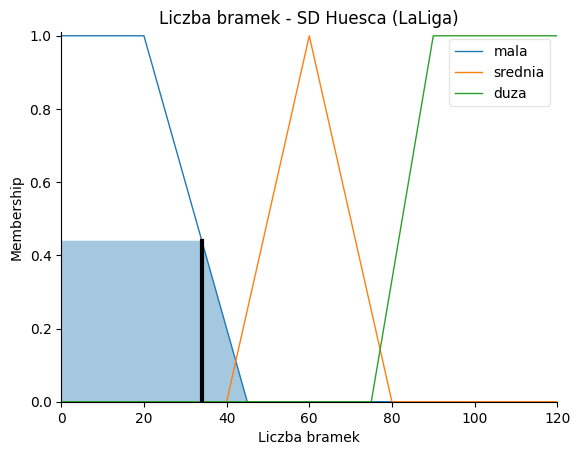

<Figure size 1000x600 with 0 Axes>

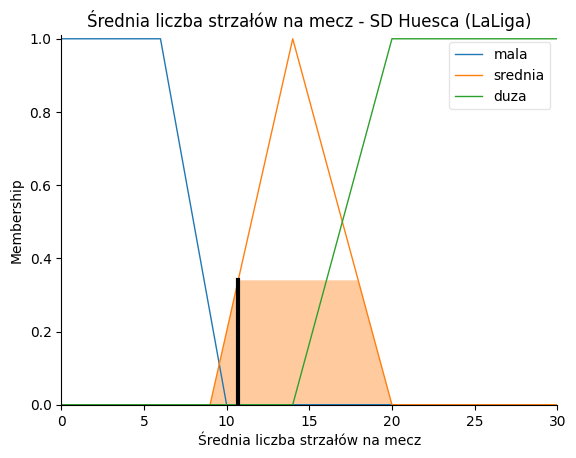

<Figure size 1000x600 with 0 Axes>

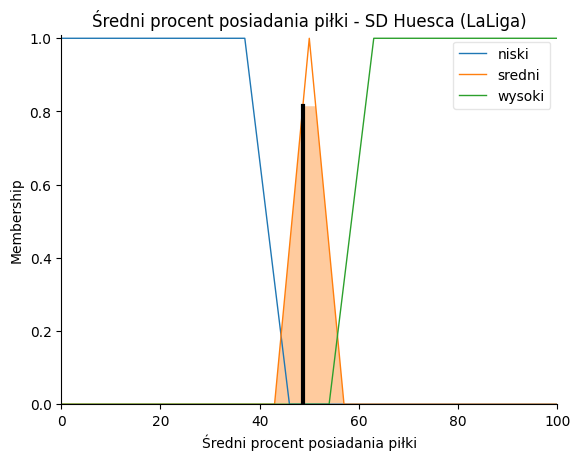

<Figure size 1000x600 with 0 Axes>

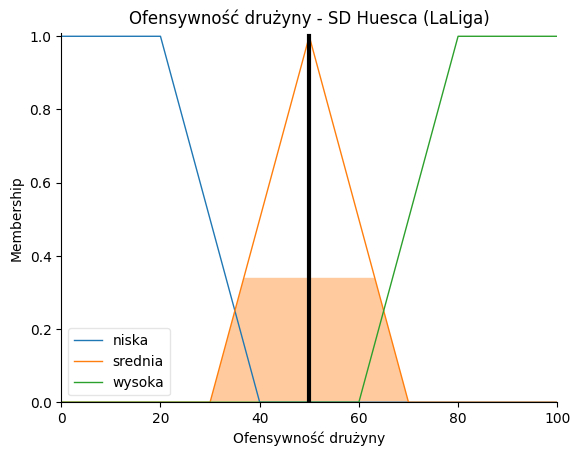

Wiersz 73: Athletic Bilbao (LaLiga)
Ofensywność drużyny = 49.99999999999999 [%]
  Przynależność (Membership):
  Liczba bramek (46): mala=0.0, srednia=0.3, duza=0.0
  Średnia liczba strzałów na mecz (10.6): mala=0.0, srednia=0.31999999999999995, duza=0.0
  Średni procent posiadania piłki (49.4): niski=0.0, sredni=0.9142857142857141, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

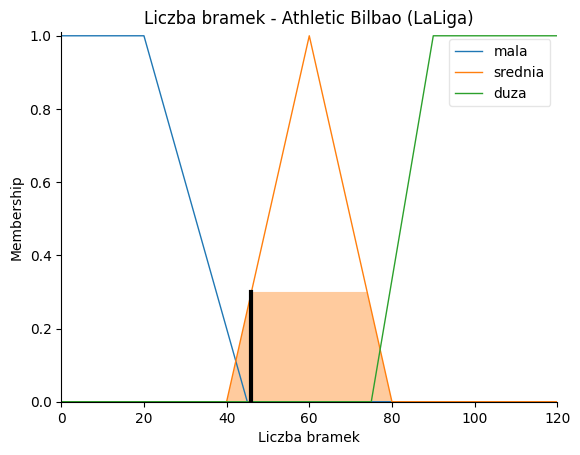

<Figure size 1000x600 with 0 Axes>

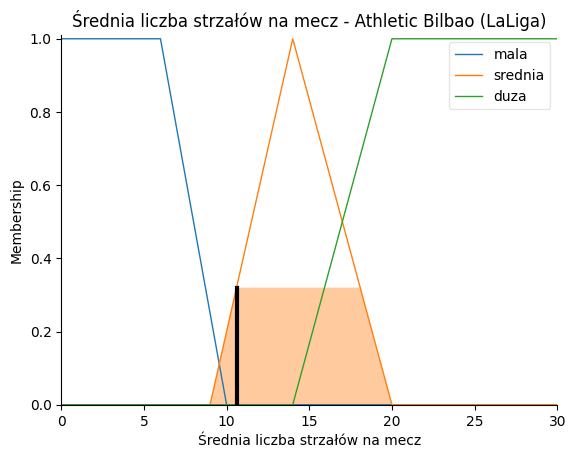

<Figure size 1000x600 with 0 Axes>

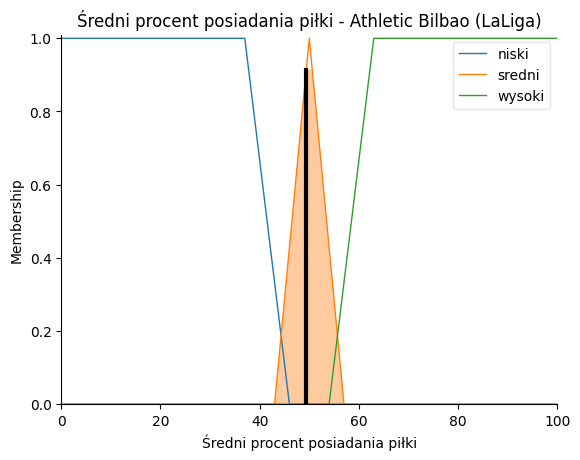

<Figure size 1000x600 with 0 Axes>

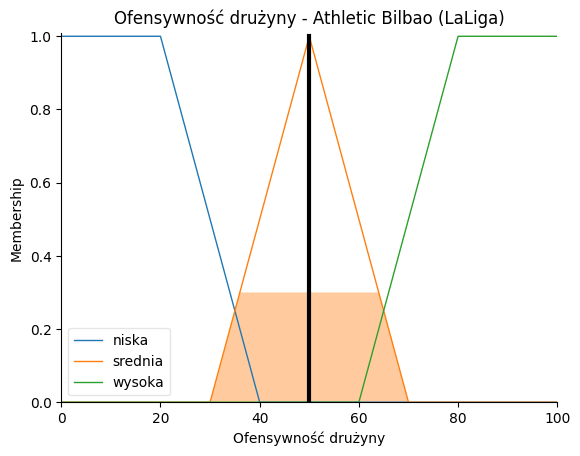

Wiersz 74: Osasuna (LaLiga)
Ofensywność drużyny = 34.446809094526564 [%]
  Przynależność (Membership):
  Liczba bramek (37): mala=0.32, srednia=0.0, duza=0.0
  Średnia liczba strzałów na mecz (9.8): mala=0.04999999999999982, srednia=0.16000000000000014, duza=0.0
  Średni procent posiadania piłki (44.6): niski=0.1555555555555554, sredni=0.2285714285714288, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

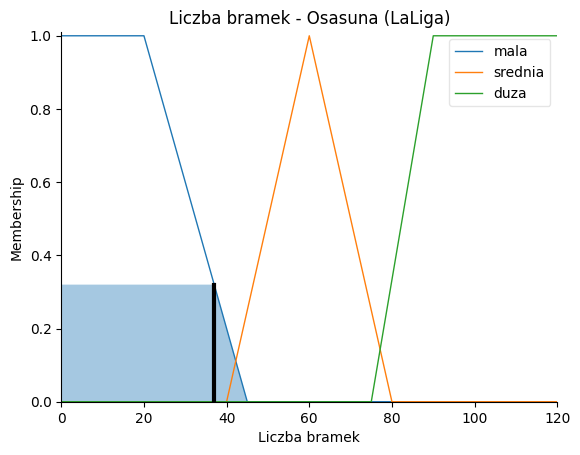

<Figure size 1000x600 with 0 Axes>

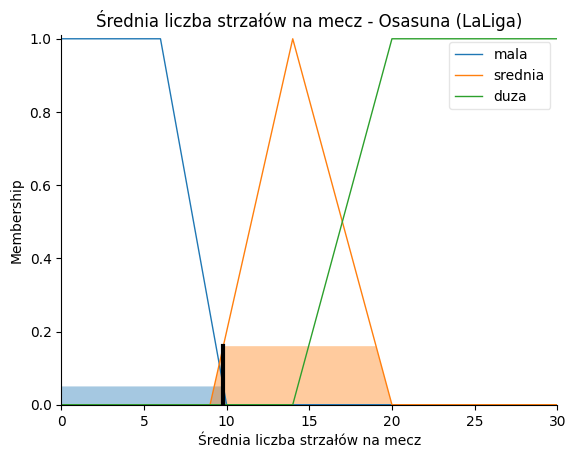

<Figure size 1000x600 with 0 Axes>

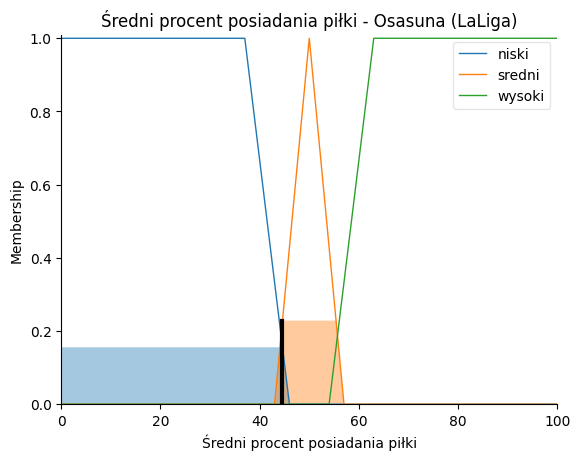

<Figure size 1000x600 with 0 Axes>

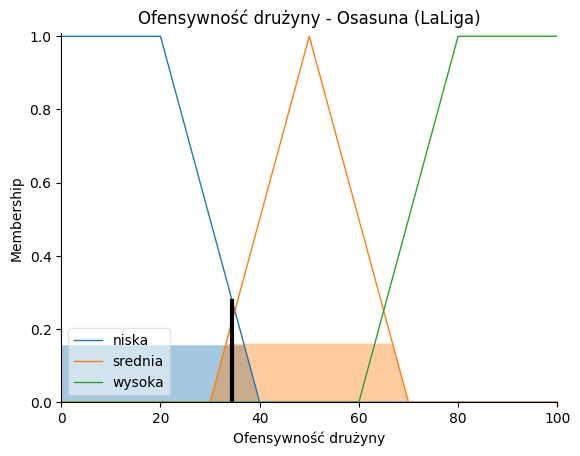

Wiersz 75: Lorient (Ligue 1)
Ofensywność drużyny = 50.0 [%]
  Przynależność (Membership):
  Liczba bramek (50): mala=0.0, srednia=0.5, duza=0.0
  Średnia liczba strzałów na mecz (11.2): mala=0.0, srednia=0.4399999999999999, duza=0.0
  Średni procent posiadania piłki (45.9): niski=0.01111111111111127, sredni=0.4142857142857141, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

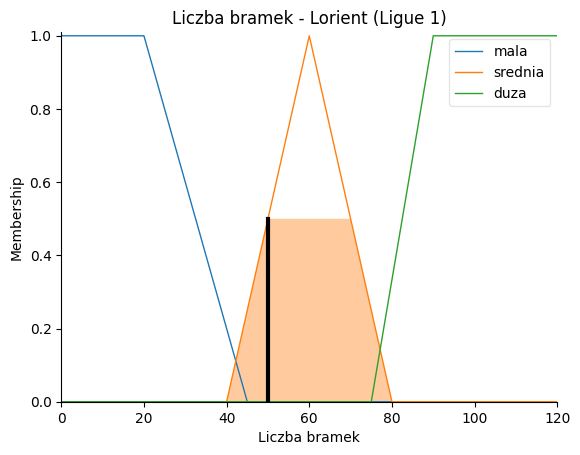

<Figure size 1000x600 with 0 Axes>

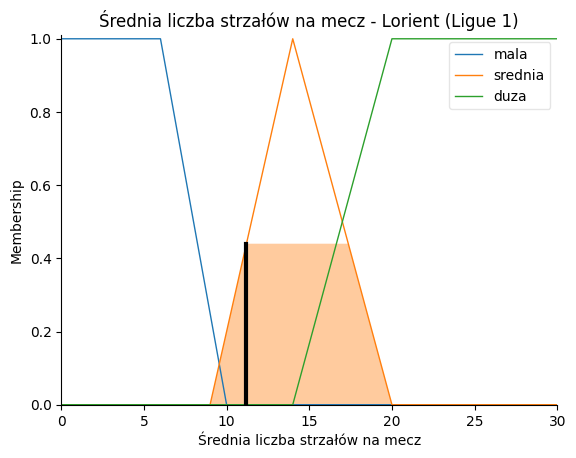

<Figure size 1000x600 with 0 Axes>

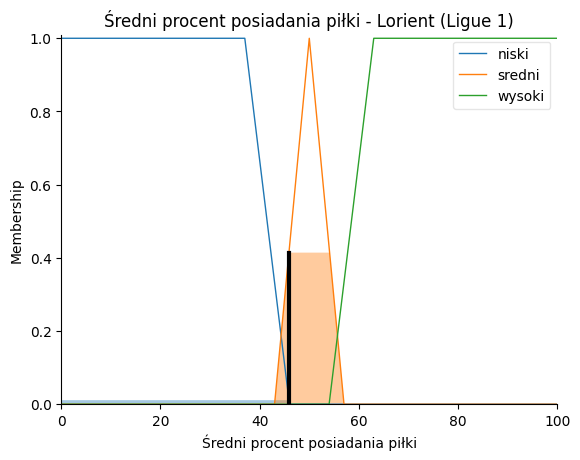

<Figure size 1000x600 with 0 Axes>

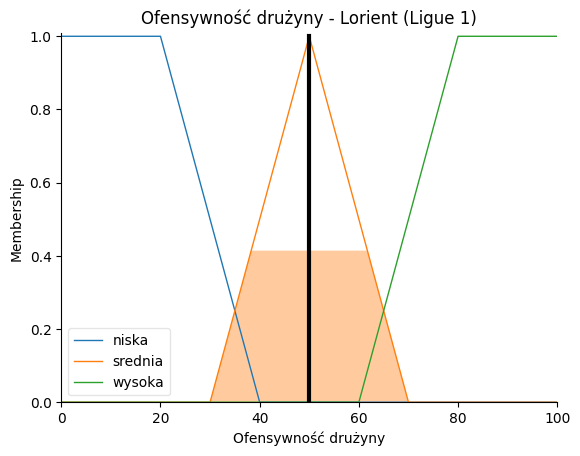

Wiersz 76: Genoa (Serie A)
Ofensywność drużyny = 50.0 [%]
  Przynależność (Membership):
  Liczba bramek (47): mala=0.0, srednia=0.35, duza=0.0
  Średnia liczba strzałów na mecz (9.0): mala=0.25, srednia=0.0, duza=0.0
  Średni procent posiadania piłki (46.1): niski=0.0, sredni=0.44285714285714306, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

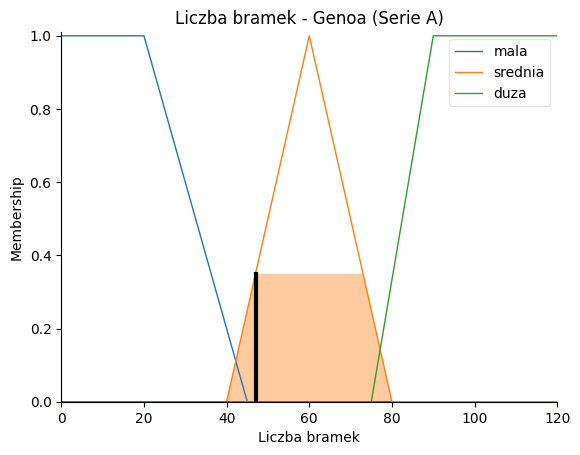

<Figure size 1000x600 with 0 Axes>

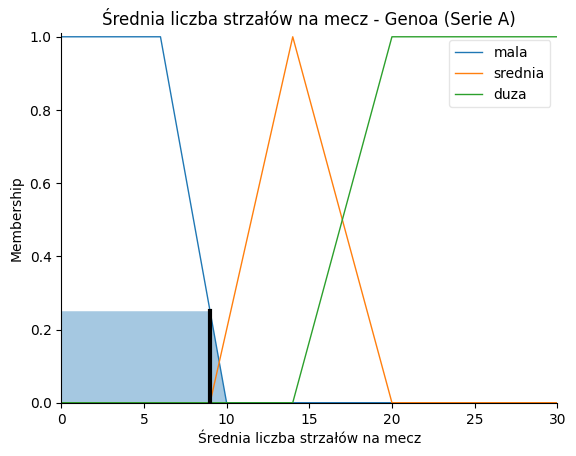

<Figure size 1000x600 with 0 Axes>

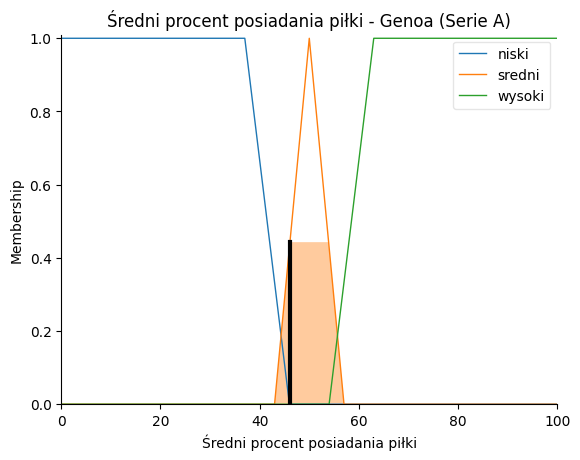

<Figure size 1000x600 with 0 Axes>

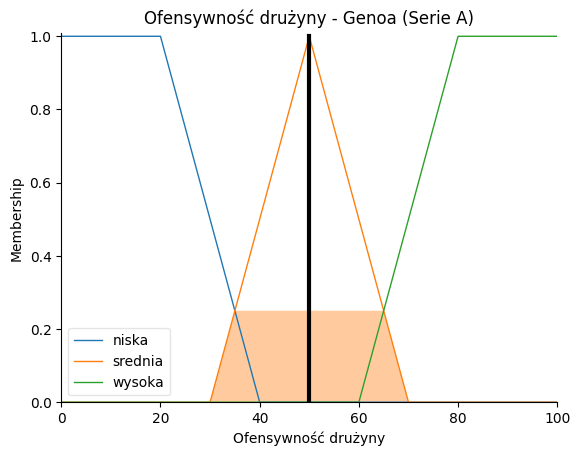

Wiersz 77: Arminia Bielefeld (Bundesliga)
Ofensywność drużyny = 34.06718174777103 [%]
  Przynależność (Membership):
  Liczba bramek (26): mala=0.76, srednia=0.0, duza=0.0
  Średnia liczba strzałów na mecz (9.8): mala=0.04999999999999982, srednia=0.16000000000000014, duza=0.0
  Średni procent posiadania piłki (44.1): niski=0.21111111111111094, sredni=0.15714285714285733, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

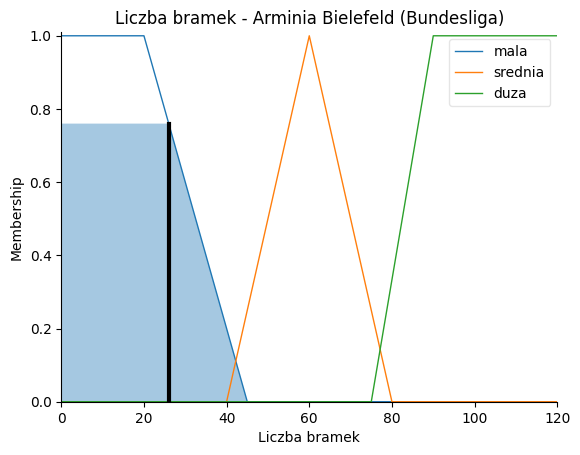

<Figure size 1000x600 with 0 Axes>

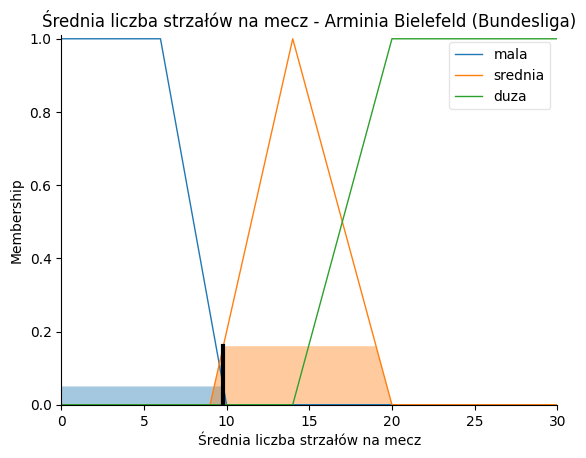

<Figure size 1000x600 with 0 Axes>

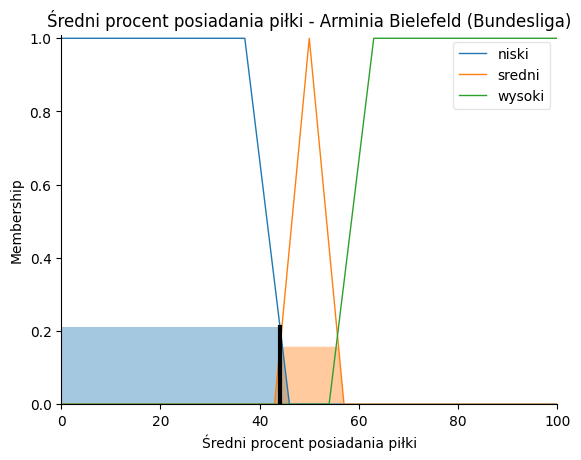

<Figure size 1000x600 with 0 Axes>

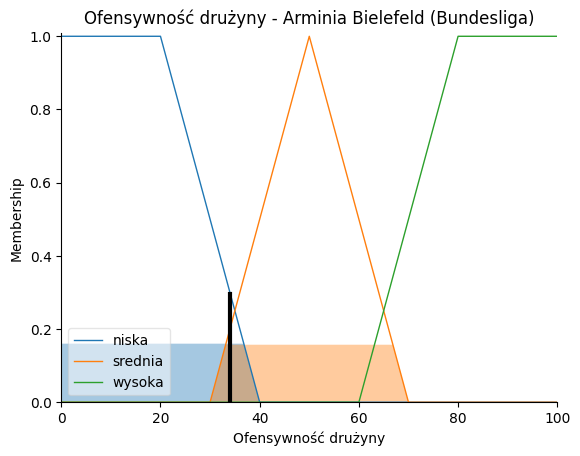

Wiersz 78: Angers (Ligue 1)
Ofensywność drużyny = 49.99999999999997 [%]
  Przynależność (Membership):
  Liczba bramek (40): mala=0.2, srednia=0.0, duza=0.0
  Średnia liczba strzałów na mecz (10.7): mala=0.0, srednia=0.33999999999999986, duza=0.0
  Średni procent posiadania piłki (47.1): niski=0.0, sredni=0.585714285714286, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

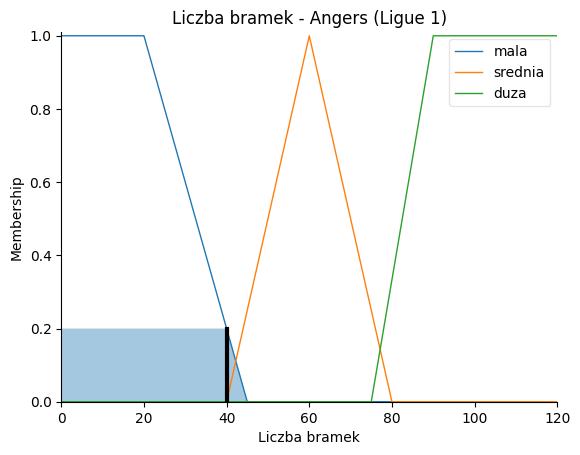

<Figure size 1000x600 with 0 Axes>

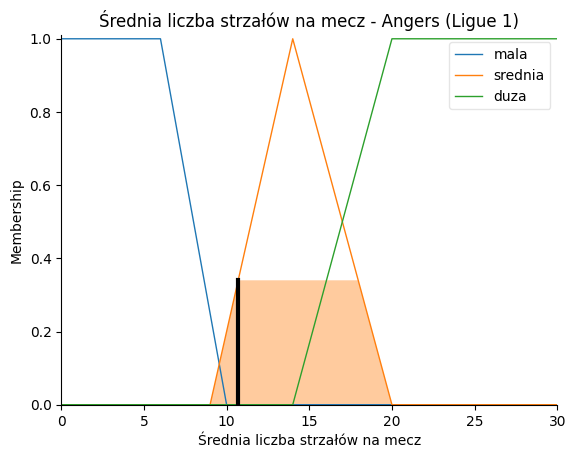

<Figure size 1000x600 with 0 Axes>

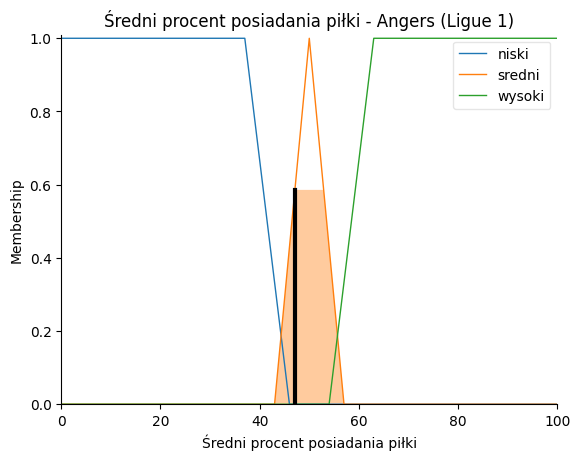

<Figure size 1000x600 with 0 Axes>

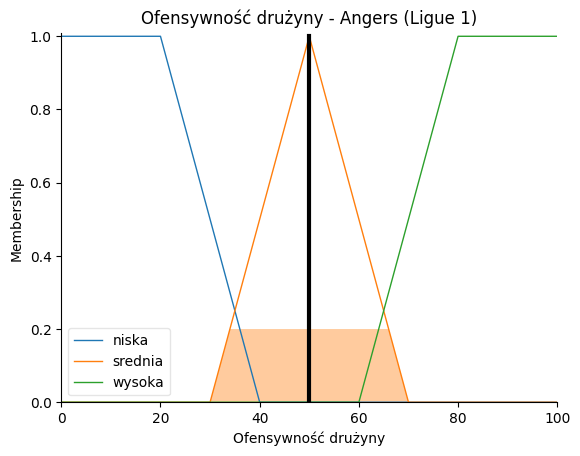

Wiersz 79: Eibar (LaLiga)
Ofensywność drużyny = 50.0 [%]
  Przynależność (Membership):
  Liczba bramek (29): mala=0.64, srednia=0.0, duza=0.0
  Średnia liczba strzałów na mecz (11.9): mala=0.0, srednia=0.5800000000000001, duza=0.0
  Średni procent posiadania piłki (49.2): niski=0.0, sredni=0.8857142857142861, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

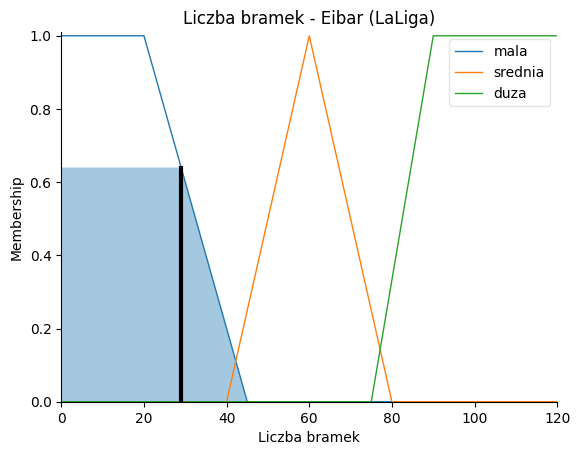

<Figure size 1000x600 with 0 Axes>

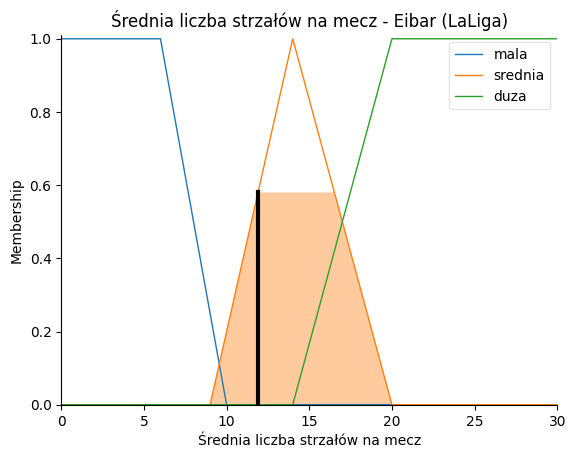

<Figure size 1000x600 with 0 Axes>

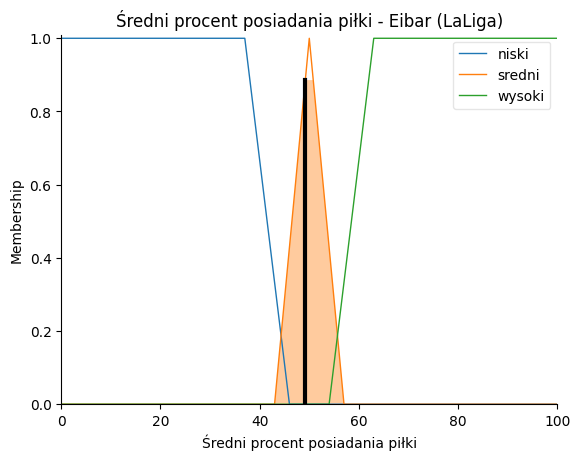

<Figure size 1000x600 with 0 Axes>

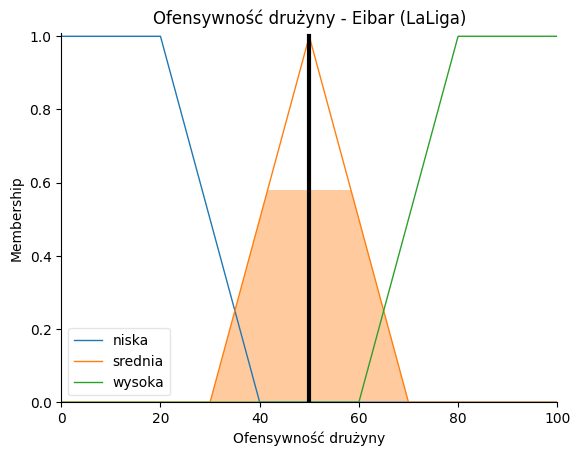

Wiersz 80: Werder Bremen (Bundesliga)
Ofensywność drużyny = 42.88574276547363 [%]
  Przynależność (Membership):
  Liczba bramek (36): mala=0.36, srednia=0.0, duza=0.0
  Średnia liczba strzałów na mecz (10.6): mala=0.0, srednia=0.31999999999999995, duza=0.0
  Średni procent posiadania piłki (45.2): niski=0.08888888888888857, sredni=0.31428571428571467, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

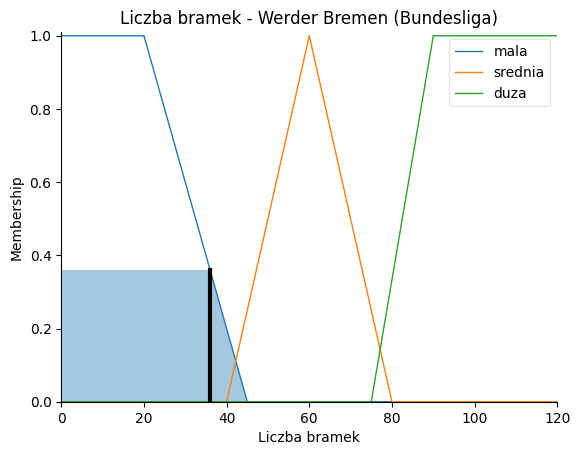

<Figure size 1000x600 with 0 Axes>

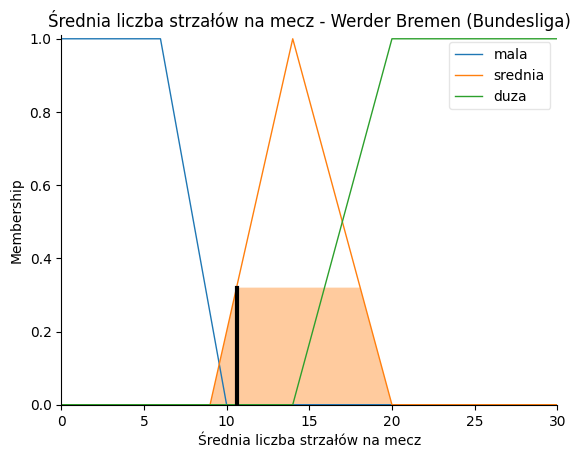

<Figure size 1000x600 with 0 Axes>

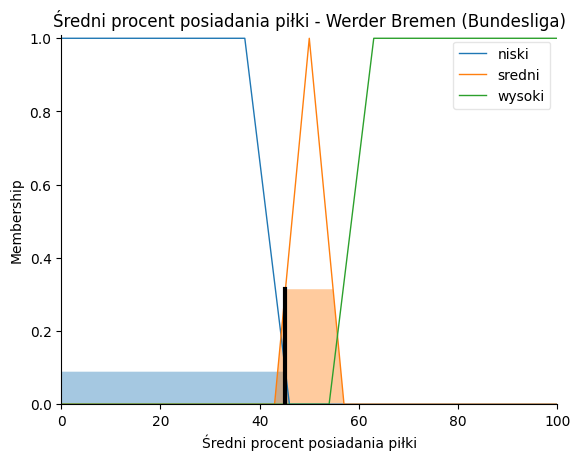

<Figure size 1000x600 with 0 Axes>

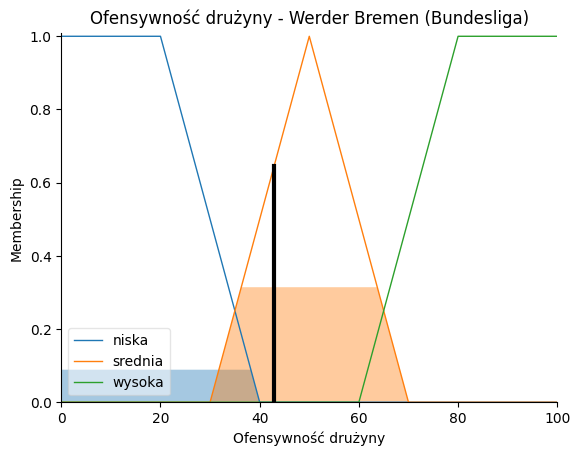

Wiersz 81: Fiorentina (Serie A)
Ofensywność drużyny = 49.999999999999986 [%]
  Przynależność (Membership):
  Liczba bramek (47): mala=0.0, srednia=0.35, duza=0.0
  Średnia liczba strzałów na mecz (9.8): mala=0.04999999999999982, srednia=0.16000000000000014, duza=0.0
  Średni procent posiadania piłki (46.8): niski=0.0, sredni=0.5428571428571425, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

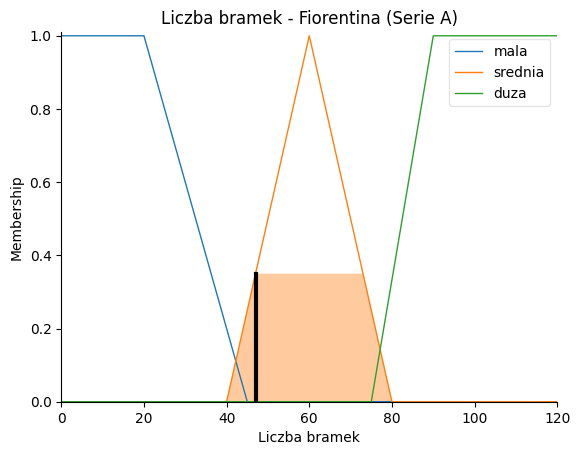

<Figure size 1000x600 with 0 Axes>

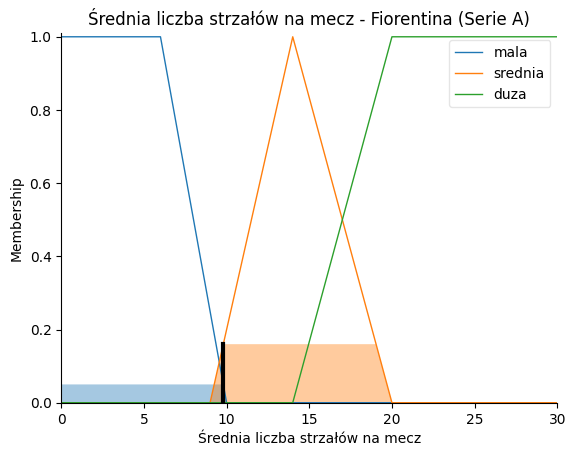

<Figure size 1000x600 with 0 Axes>

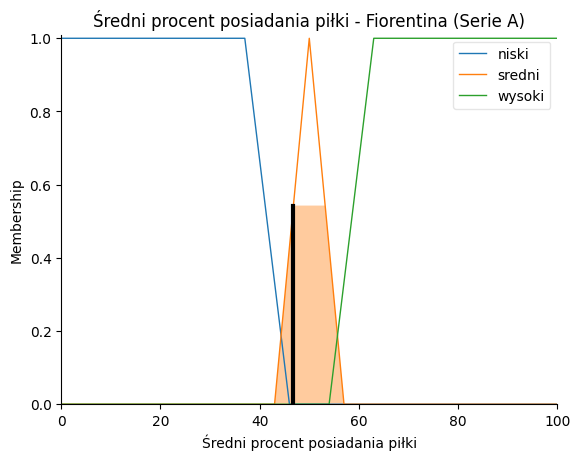

<Figure size 1000x600 with 0 Axes>

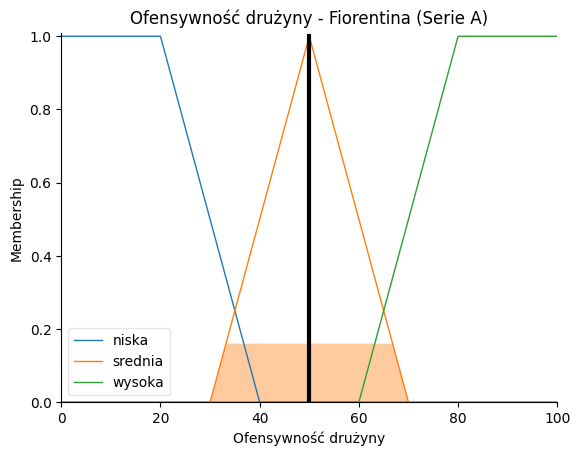

Wiersz 82: Nimes (Ligue 1)
Ofensywność drużyny = 47.01034320639391 [%]
  Przynależność (Membership):
  Liczba bramek (40): mala=0.2, srednia=0.0, duza=0.0
  Średnia liczba strzałów na mecz (10.3): mala=0.0, srednia=0.2600000000000001, duza=0.0
  Średni procent posiadania piłki (45.8): niski=0.02222222222222254, sredni=0.39999999999999963, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

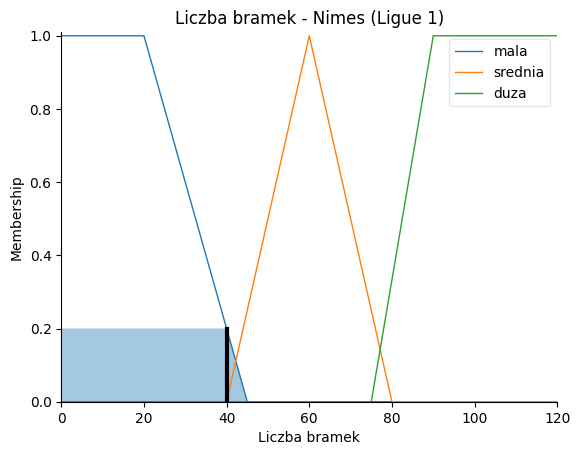

<Figure size 1000x600 with 0 Axes>

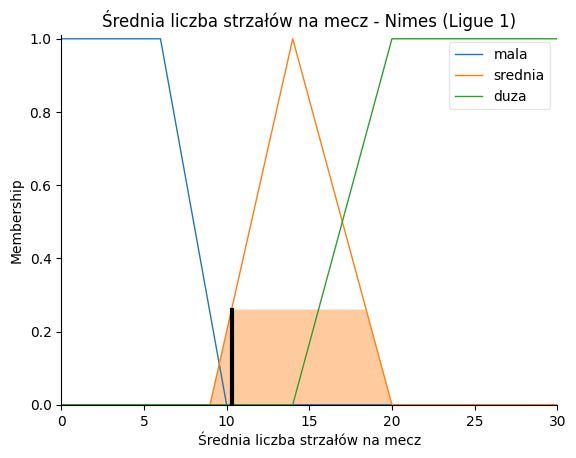

<Figure size 1000x600 with 0 Axes>

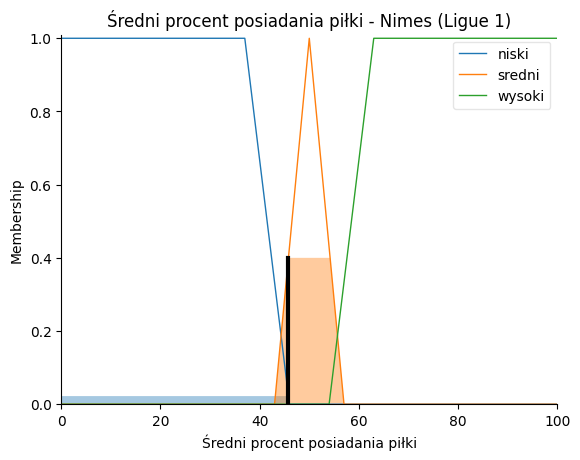

<Figure size 1000x600 with 0 Axes>

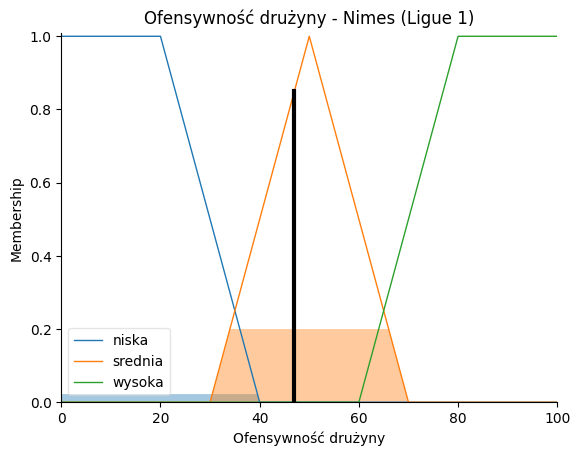

Wiersz 83: West Bromwich Albion (Premier League)
Ofensywność drużyny = 18.658836689038015 [%]
  Przynależność (Membership):
  Liczba bramek (35): mala=0.4, srednia=0.0, duza=0.0
  Średnia liczba strzałów na mecz (8.9): mala=0.2749999999999999, srednia=0.0, duza=0.0
  Średni procent posiadania piłki (41.0): niski=0.5555555555555556, sredni=0.0, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

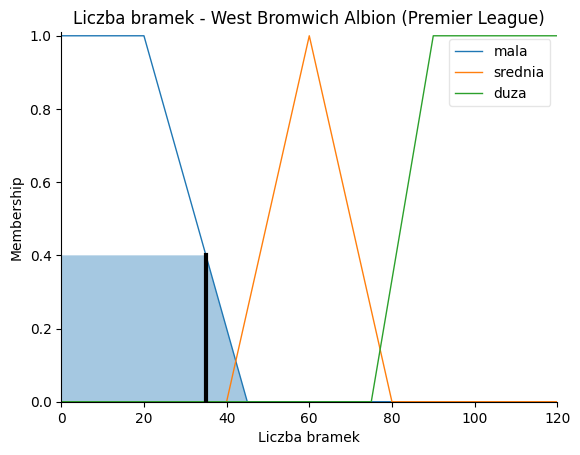

<Figure size 1000x600 with 0 Axes>

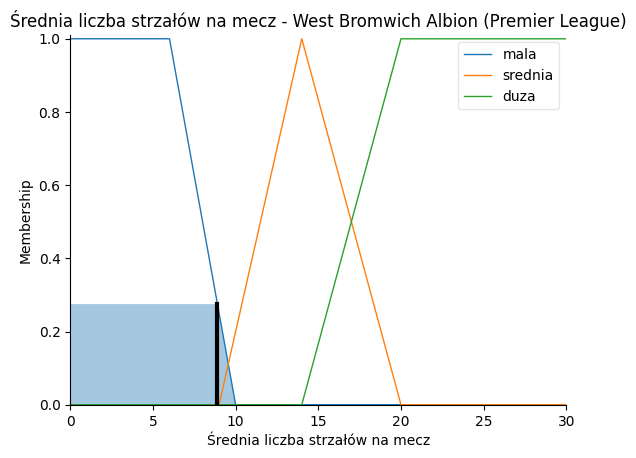

<Figure size 1000x600 with 0 Axes>

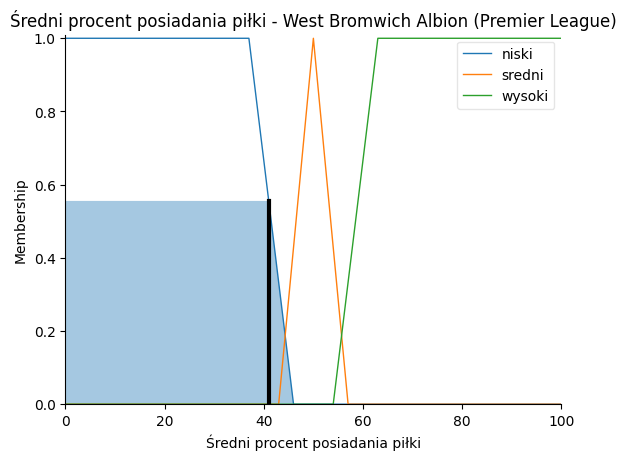

<Figure size 1000x600 with 0 Axes>

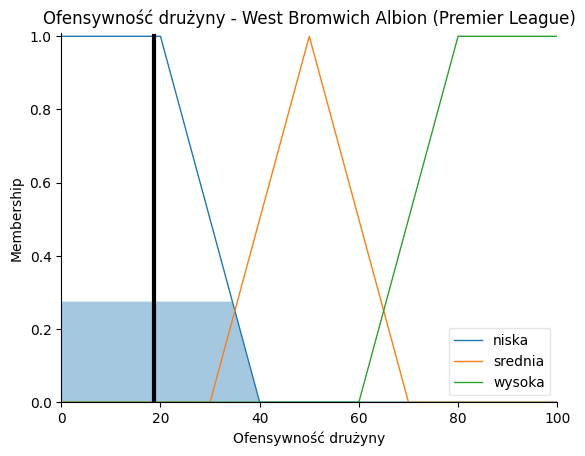

Wiersz 84: FC Koln (Bundesliga)
Ofensywność drużyny = 49.99999999999998 [%]
  Przynależność (Membership):
  Liczba bramek (34): mala=0.44, srednia=0.0, duza=0.0
  Średnia liczba strzałów na mecz (10.6): mala=0.0, srednia=0.31999999999999995, duza=0.0
  Średni procent posiadania piłki (47.1): niski=0.0, sredni=0.585714285714286, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

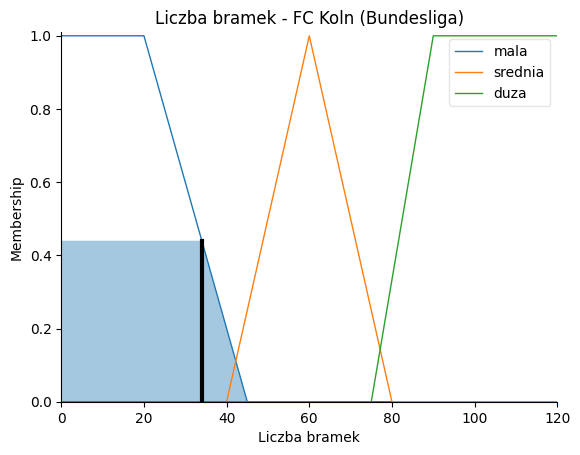

<Figure size 1000x600 with 0 Axes>

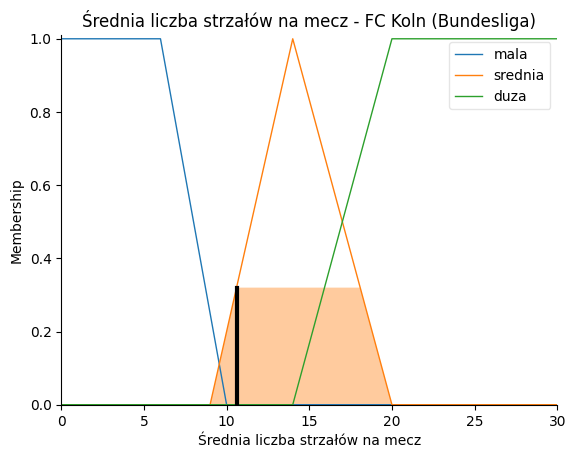

<Figure size 1000x600 with 0 Axes>

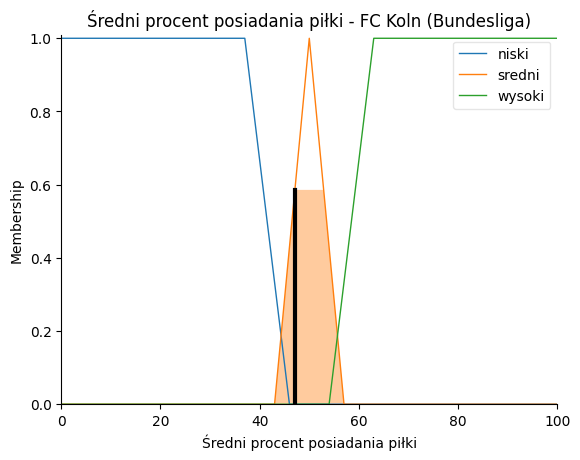

<Figure size 1000x600 with 0 Axes>

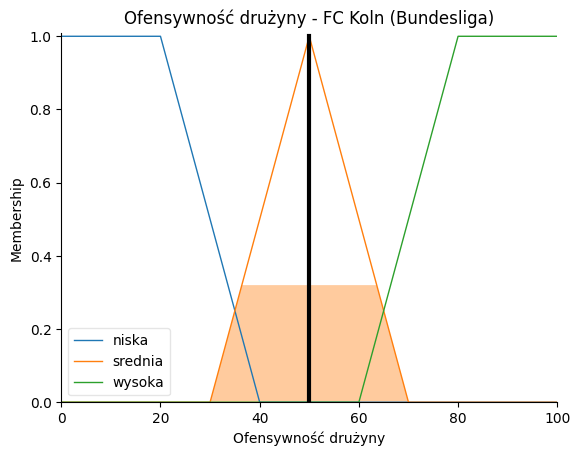

Wiersz 85: Deportivo Alaves (LaLiga)
Ofensywność drużyny = 21.27823017115857 [%]
  Przynależność (Membership):
  Liczba bramek (36): mala=0.36, srednia=0.0, duza=0.0
  Średnia liczba strzałów na mecz (9.1): mala=0.2250000000000001, srednia=0.019999999999999928, duza=0.0
  Średni procent posiadania piłki (44.6): niski=0.1555555555555554, sredni=0.2285714285714288, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

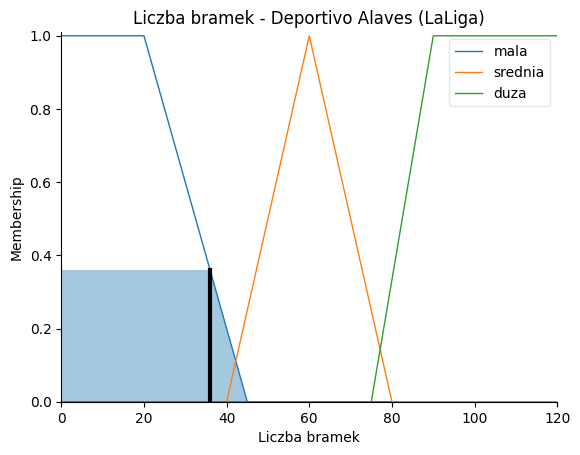

<Figure size 1000x600 with 0 Axes>

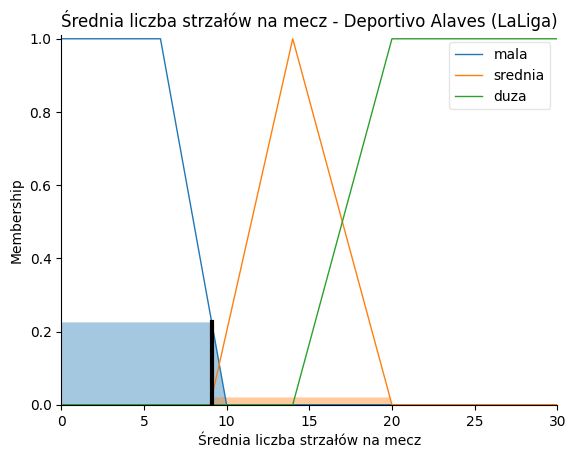

<Figure size 1000x600 with 0 Axes>

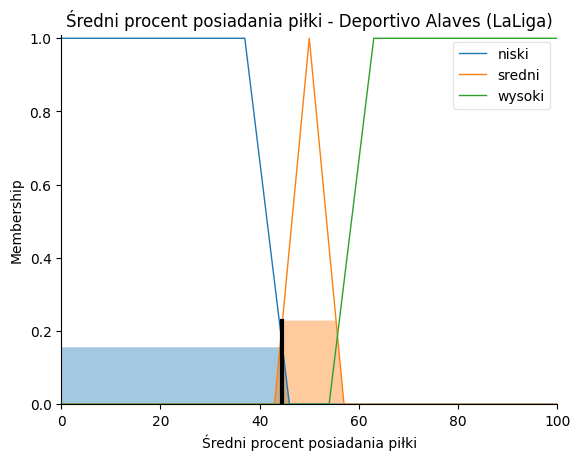

<Figure size 1000x600 with 0 Axes>

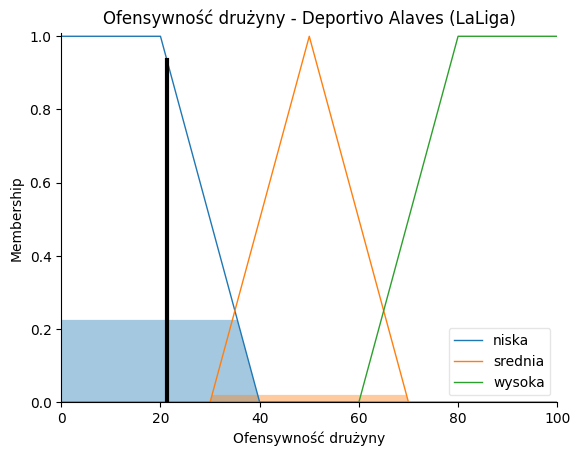

Wiersz 86: Levante (LaLiga)
Ofensywność drużyny = 50.000000000000014 [%]
  Przynależność (Membership):
  Liczba bramek (46): mala=0.0, srednia=0.3, duza=0.0
  Średnia liczba strzałów na mecz (10.1): mala=0.0, srednia=0.21999999999999992, duza=0.0
  Średni procent posiadania piłki (51.5): niski=0.0, sredni=0.7857142857142857, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

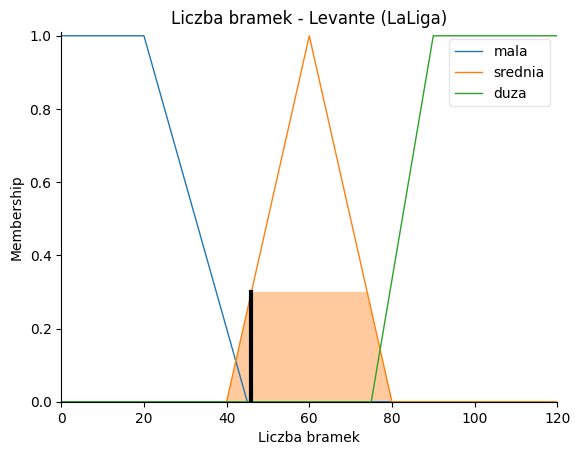

<Figure size 1000x600 with 0 Axes>

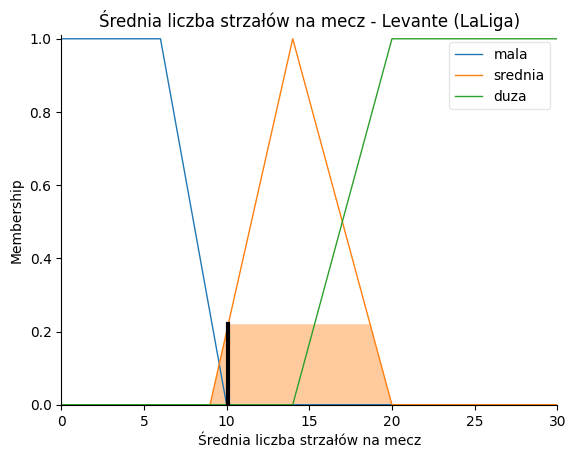

<Figure size 1000x600 with 0 Axes>

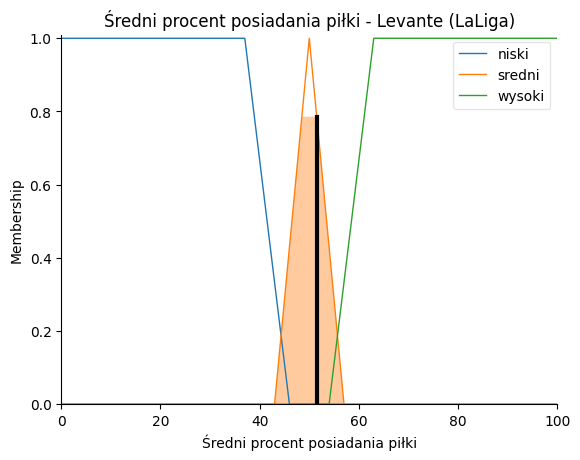

<Figure size 1000x600 with 0 Axes>

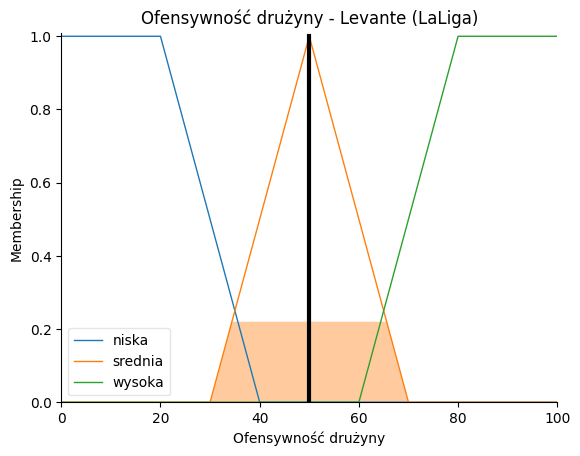

Wiersz 87: Spezia (Serie A)
Ofensywność drużyny = 49.99999999999997 [%]
  Przynależność (Membership):
  Liczba bramek (52): mala=0.0, srednia=0.6, duza=0.0
  Średnia liczba strzałów na mecz (10.2): mala=0.0, srednia=0.23999999999999985, duza=0.0
  Średni procent posiadania piłki (51.6): niski=0.0, sredni=0.7714285714285712, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

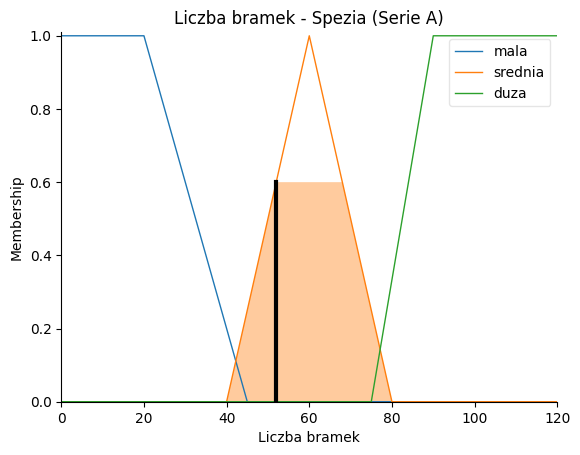

<Figure size 1000x600 with 0 Axes>

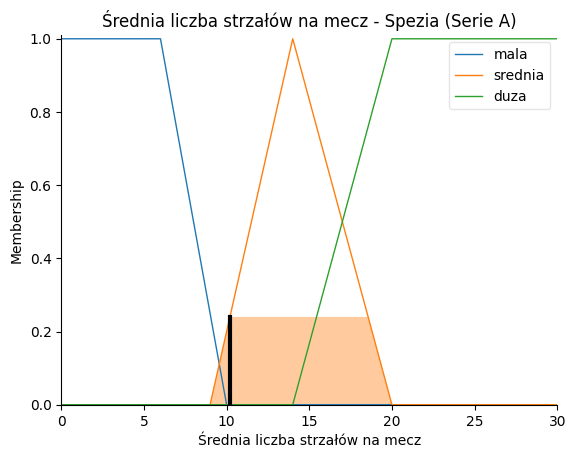

<Figure size 1000x600 with 0 Axes>

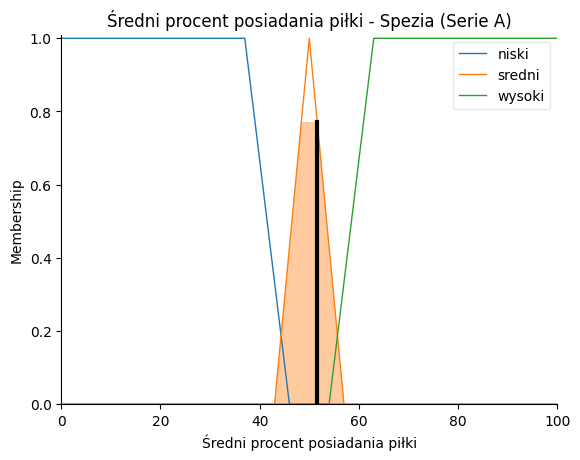

<Figure size 1000x600 with 0 Axes>

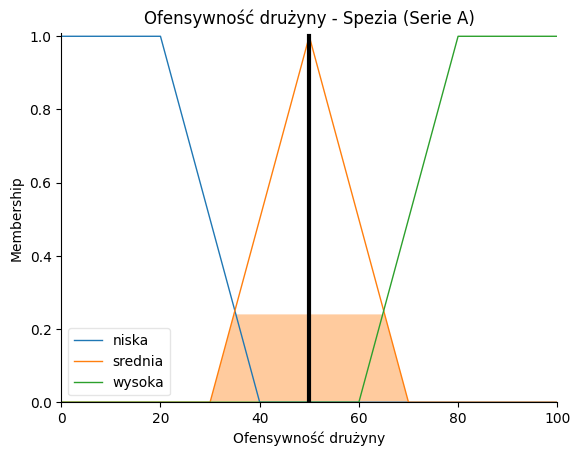

Wiersz 88: Getafe (LaLiga)
Ofensywność drużyny = 32.62217795484732 [%]
  Przynależność (Membership):
  Liczba bramek (28): mala=0.68, srednia=0.0, duza=0.0
  Średnia liczba strzałów na mecz (9.5): mala=0.125, srednia=0.1, duza=0.0
  Średni procent posiadania piłki (44.4): niski=0.17777777777777792, sredni=0.1999999999999998, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

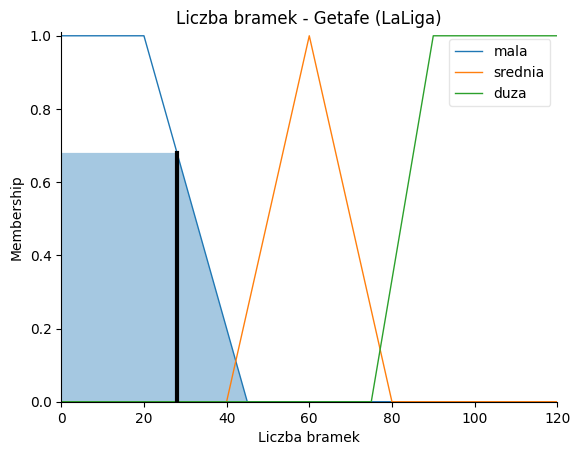

<Figure size 1000x600 with 0 Axes>

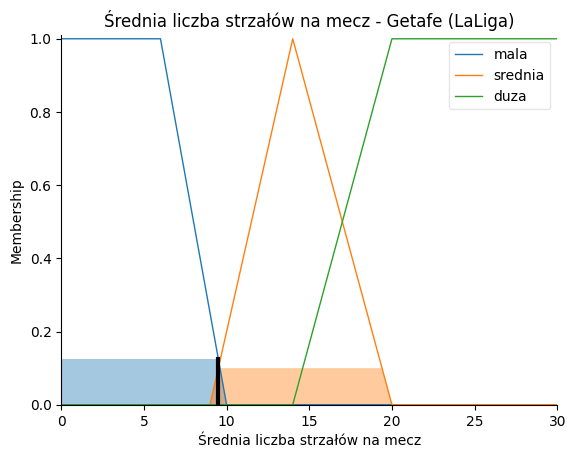

<Figure size 1000x600 with 0 Axes>

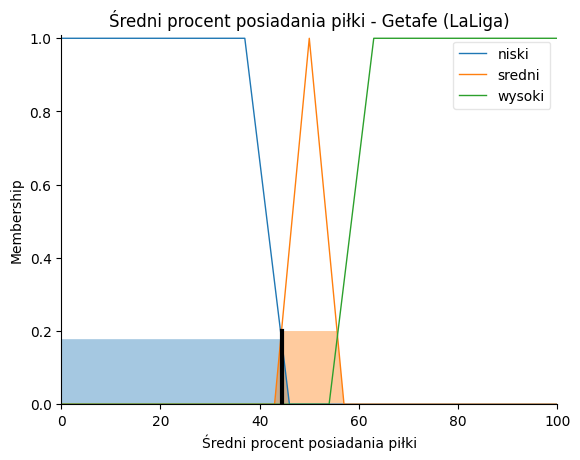

<Figure size 1000x600 with 0 Axes>

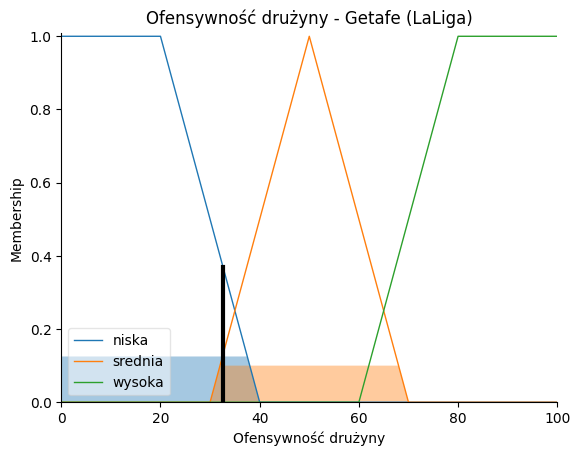

Wiersz 89: Parma Calcio 1913 (Serie A)
Ofensywność drużyny = 49.999999999999964 [%]
  Przynależność (Membership):
  Liczba bramek (39): mala=0.24, srednia=0.0, duza=0.0
  Średnia liczba strzałów na mecz (10.4): mala=0.0, srednia=0.2800000000000001, duza=0.0
  Średni procent posiadania piłki (48.4): niski=0.0, sredni=0.7714285714285712, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

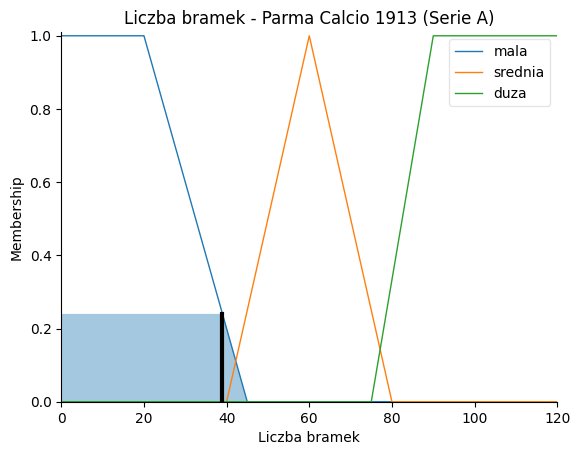

<Figure size 1000x600 with 0 Axes>

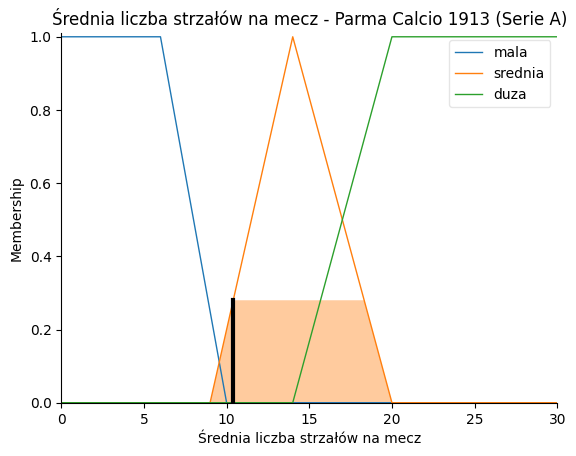

<Figure size 1000x600 with 0 Axes>

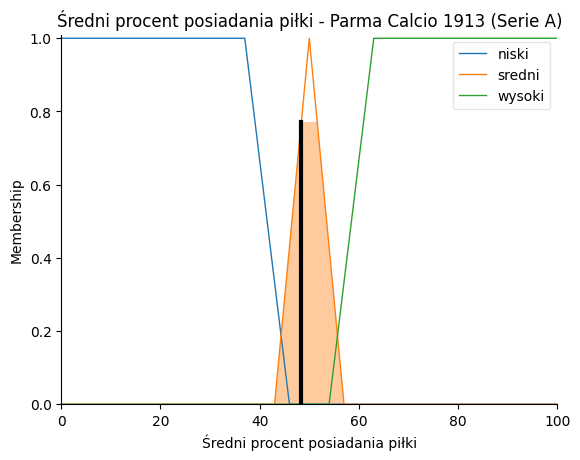

<Figure size 1000x600 with 0 Axes>

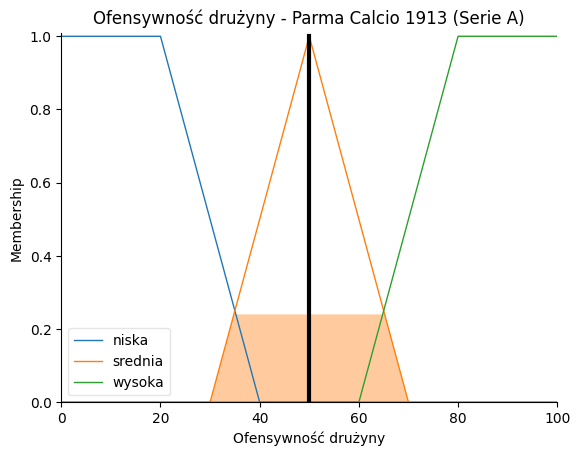

Wiersz 90: Elche (LaLiga)
Ofensywność drużyny = 17.890636704119853 [%]
  Przynależność (Membership):
  Liczba bramek (34): mala=0.44, srednia=0.0, duza=0.0
  Średnia liczba strzałów na mecz (7.1): mala=0.7250000000000001, srednia=0.0, duza=0.0
  Średni procent posiadania piłki (48.1): niski=0.0, sredni=0.7285714285714288, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

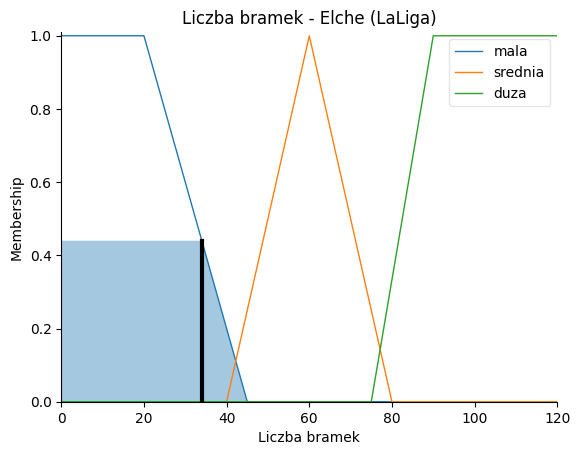

<Figure size 1000x600 with 0 Axes>

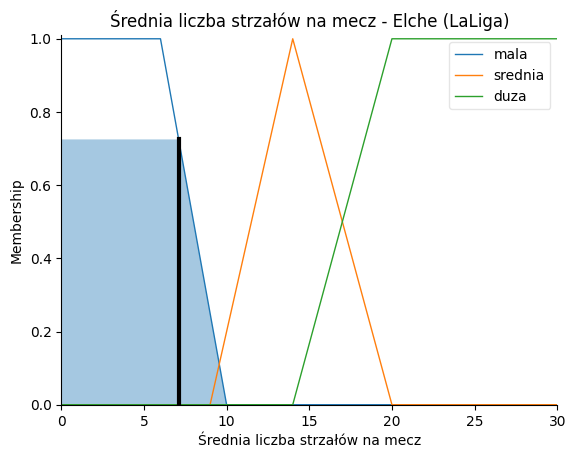

<Figure size 1000x600 with 0 Axes>

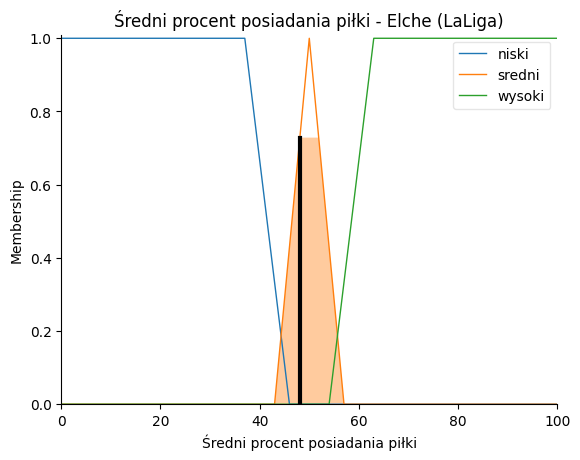

<Figure size 1000x600 with 0 Axes>

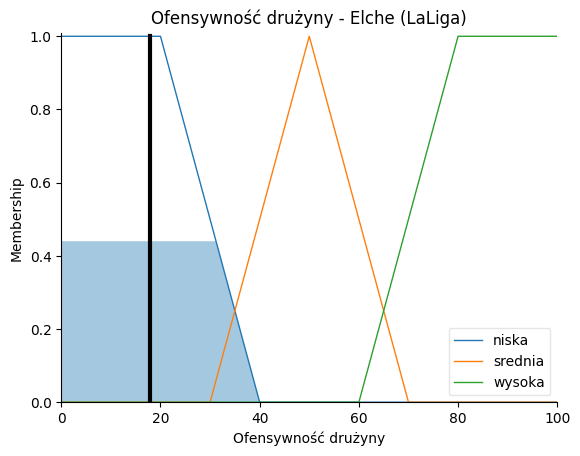

Wiersz 91: Granada (LaLiga)
Ofensywność drużyny = 29.523994621684395 [%]
  Przynależność (Membership):
  Liczba bramek (47): mala=0.0, srednia=0.35, duza=0.0
  Średnia liczba strzałów na mecz (9.4): mala=0.1499999999999999, srednia=0.08000000000000007, duza=0.0
  Średni procent posiadania piłki (43.4): niski=0.28888888888888903, sredni=0.05714285714285694, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

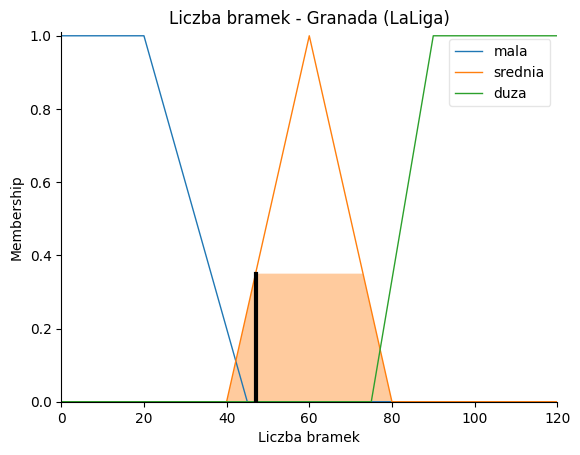

<Figure size 1000x600 with 0 Axes>

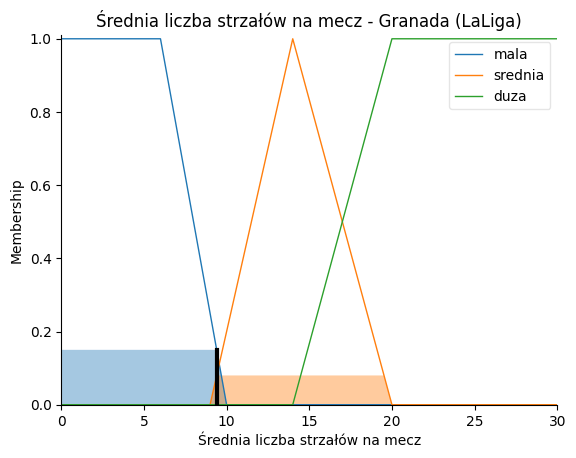

<Figure size 1000x600 with 0 Axes>

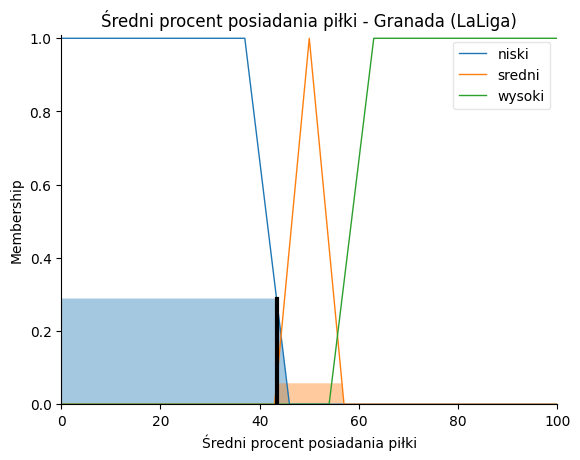

<Figure size 1000x600 with 0 Axes>

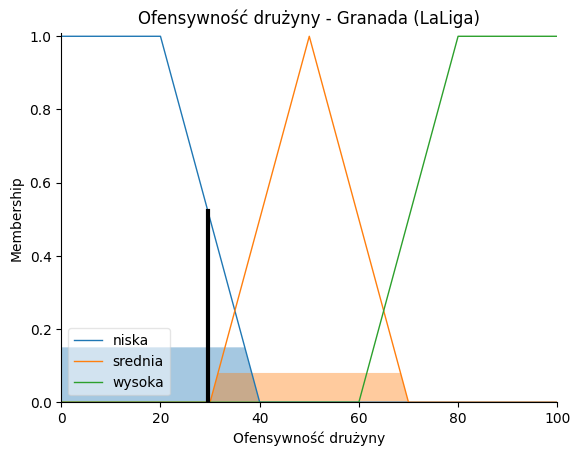

Wiersz 92: Cadiz (LaLiga)
Ofensywność drużyny = 18.25934065934066 [%]
  Przynależność (Membership):
  Liczba bramek (36): mala=0.36, srednia=0.0, duza=0.0
  Średnia liczba strzałów na mecz (8.0): mala=0.5, srednia=0.0, duza=0.0
  Średni procent posiadania piłki (38.5): niski=0.8333333333333334, sredni=0.0, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

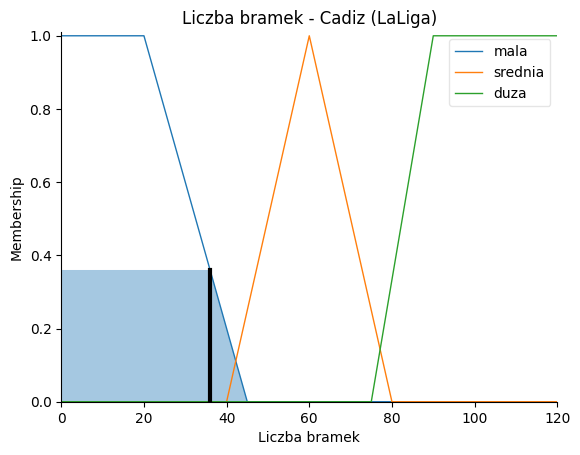

<Figure size 1000x600 with 0 Axes>

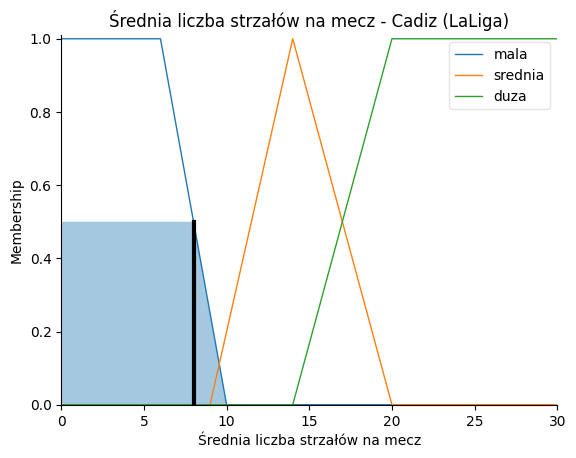

<Figure size 1000x600 with 0 Axes>

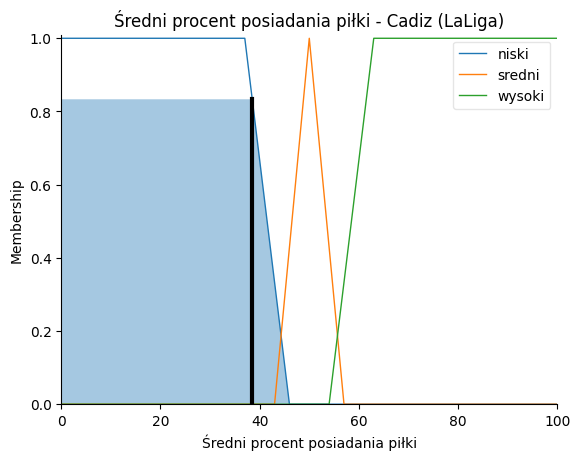

<Figure size 1000x600 with 0 Axes>

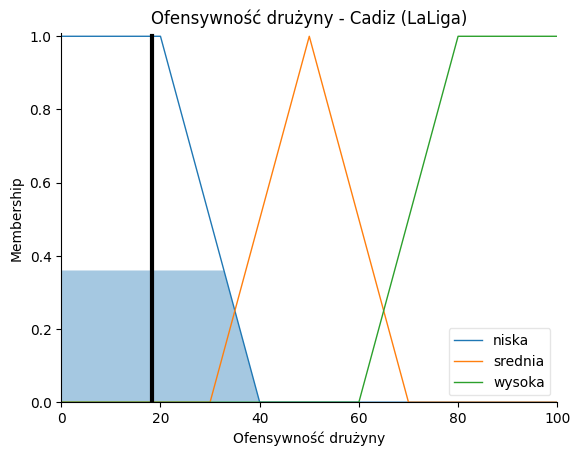

Wiersz 93: Real Valladolid (LaLiga)
Ofensywność drużyny = 39.36739578485473 [%]
  Przynależność (Membership):
  Liczba bramek (34): mala=0.44, srednia=0.0, duza=0.0
  Średnia liczba strzałów na mecz (9.7): mala=0.07500000000000018, srednia=0.13999999999999985, duza=0.0
  Średni procent posiadania piłki (46.2): niski=0.0, sredni=0.4571428571428576, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

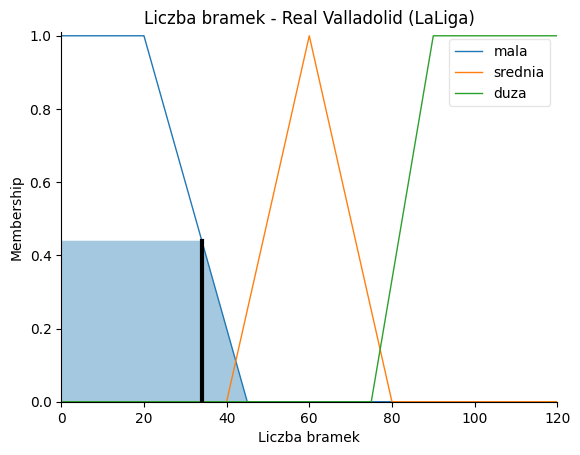

<Figure size 1000x600 with 0 Axes>

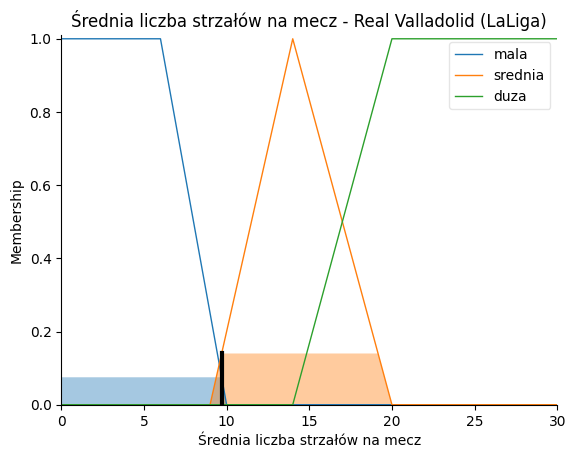

<Figure size 1000x600 with 0 Axes>

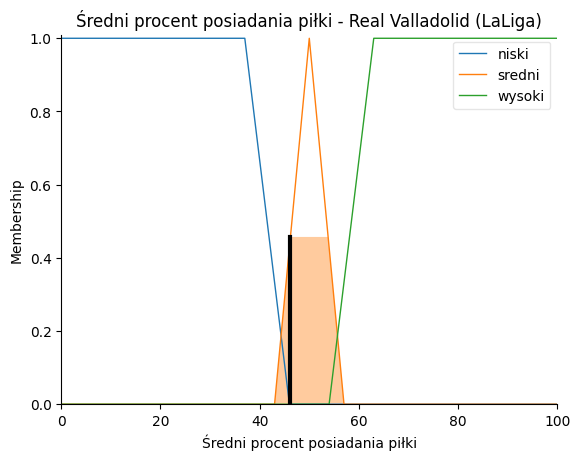

<Figure size 1000x600 with 0 Axes>

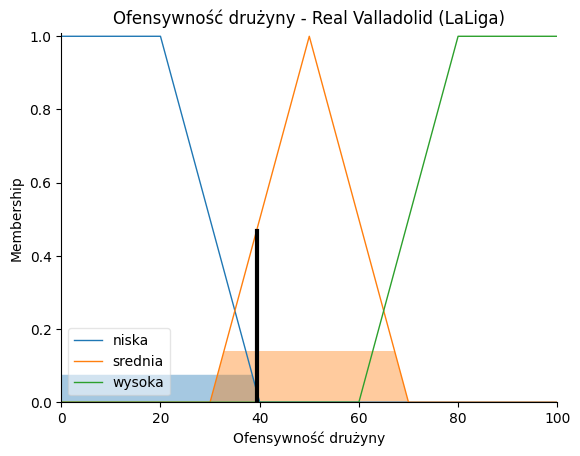

Wiersz 94: Sheffield United (Premier League)
Ofensywność drużyny = 18.383838383838377 [%]
  Przynależność (Membership):
  Liczba bramek (20): mala=1.0, srednia=0.0, duza=0.0
  Średnia liczba strzałów na mecz (8.5): mala=0.375, srednia=0.0, duza=0.0
  Średni procent posiadania piłki (43.0): niski=0.3333333333333333, sredni=0.0, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

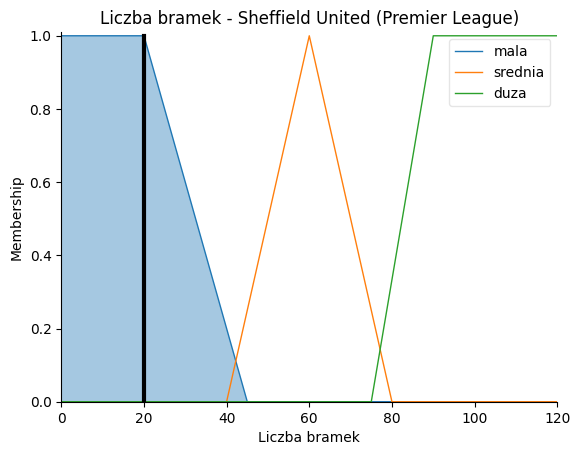

<Figure size 1000x600 with 0 Axes>

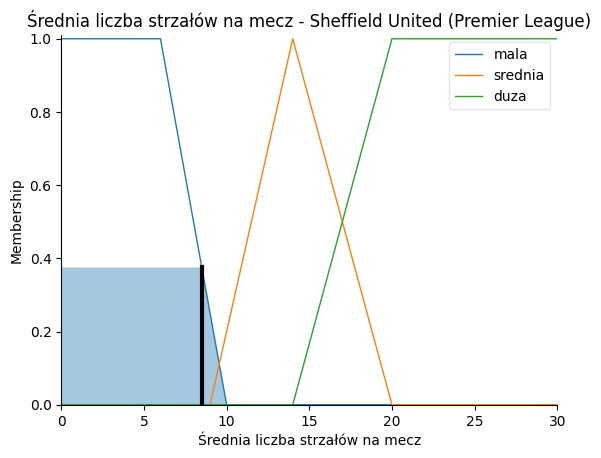

<Figure size 1000x600 with 0 Axes>

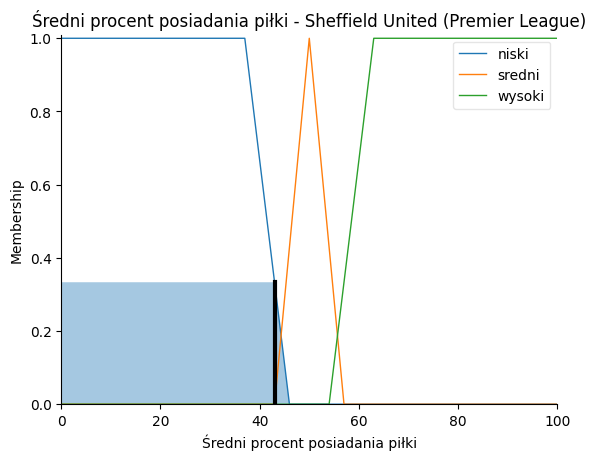

<Figure size 1000x600 with 0 Axes>

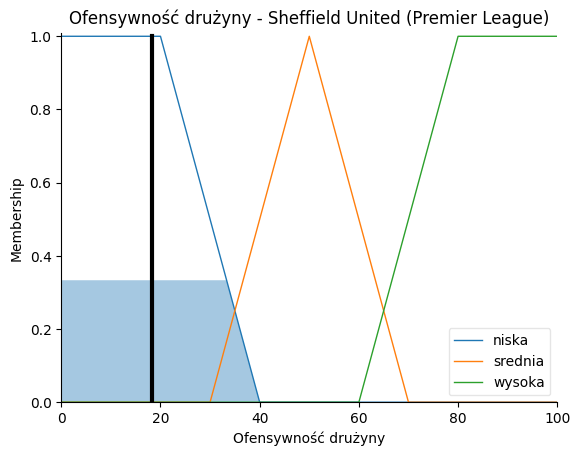

Wiersz 95: Crotone (Serie A)
Ofensywność drużyny = 49.99999999999999 [%]
  Przynależność (Membership):
  Liczba bramek (45): mala=0.0, srednia=0.25, duza=0.0
  Średnia liczba strzałów na mecz (9.5): mala=0.125, srednia=0.1, duza=0.0
  Średni procent posiadania piłki (47.2): niski=0.0, sredni=0.6000000000000004, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

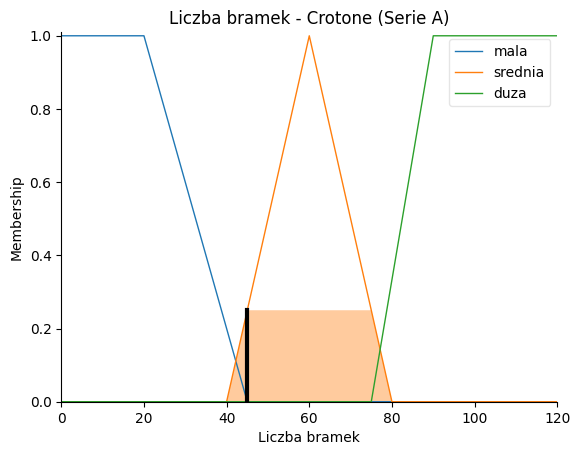

<Figure size 1000x600 with 0 Axes>

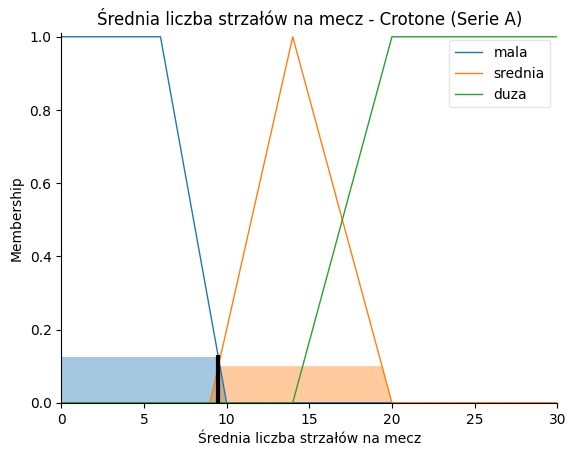

<Figure size 1000x600 with 0 Axes>

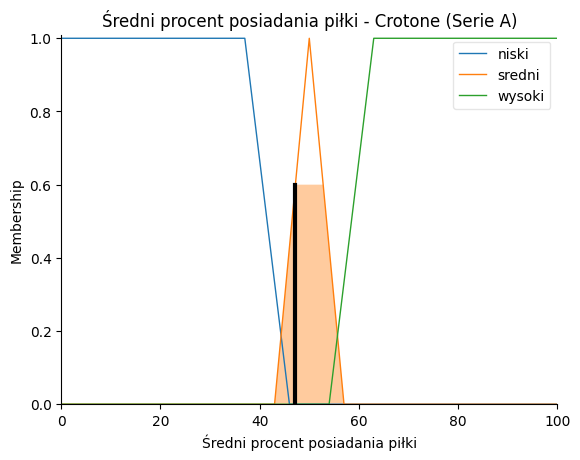

<Figure size 1000x600 with 0 Axes>

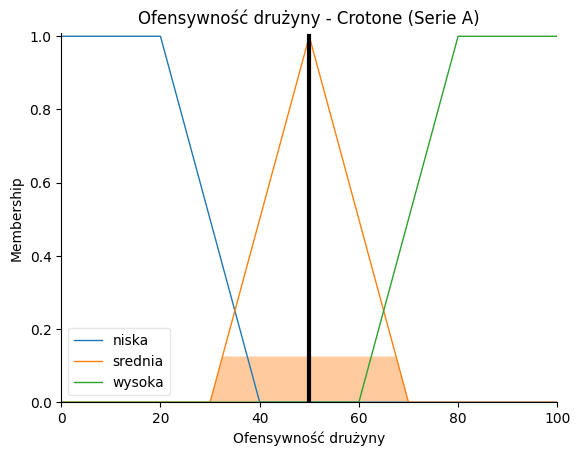

Wiersz 96: Benevento (Serie A)
Ofensywność drużyny = 32.84951252791816 [%]
  Przynależność (Membership):
  Liczba bramek (40): mala=0.2, srednia=0.0, duza=0.0
  Średnia liczba strzałów na mecz (11.0): mala=0.0, srednia=0.4, duza=0.0
  Średni procent posiadania piłki (44.2): niski=0.19999999999999968, sredni=0.17142857142857185, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

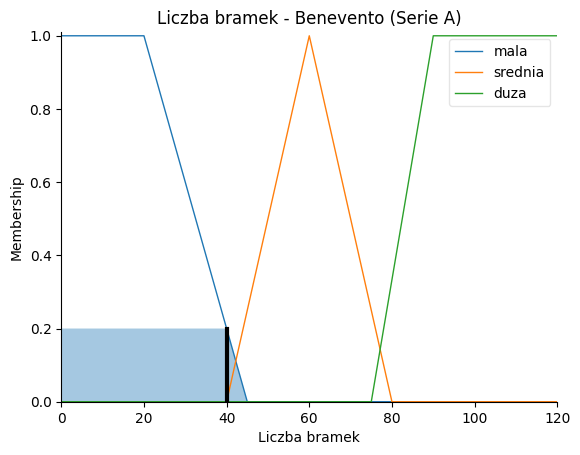

<Figure size 1000x600 with 0 Axes>

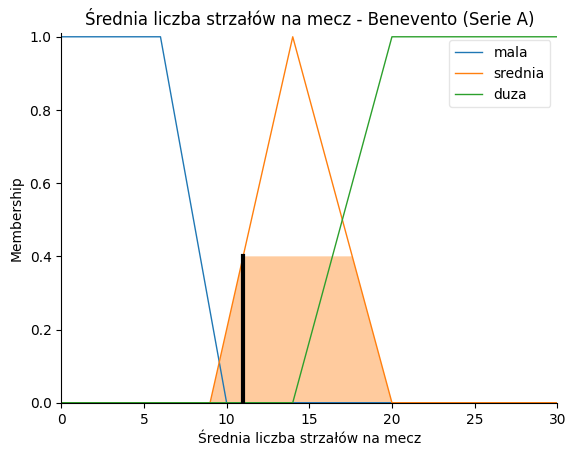

<Figure size 1000x600 with 0 Axes>

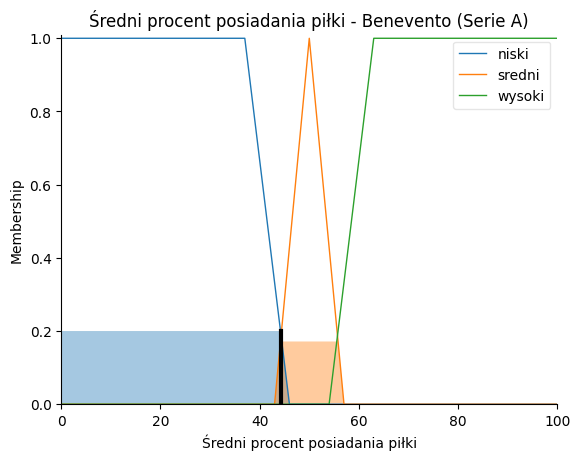

<Figure size 1000x600 with 0 Axes>

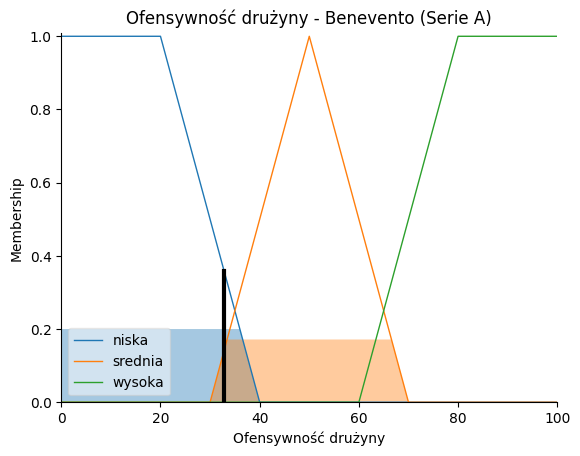

Wiersz 97: Dijon (Ligue 1)
Ofensywność drużyny = 23.87675299106468 [%]
  Przynależność (Membership):
  Liczba bramek (25): mala=0.8, srednia=0.0, duza=0.0
  Średnia liczba strzałów na mecz (9.2): mala=0.20000000000000018, srednia=0.03999999999999986, duza=0.0
  Średni procent posiadania piłki (46.9): niski=0.0, sredni=0.5571428571428569, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

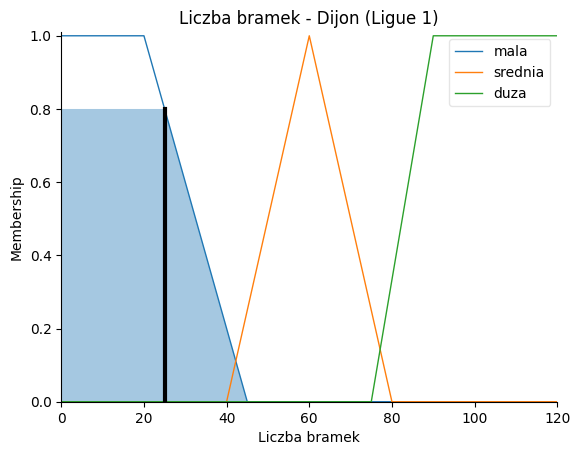

<Figure size 1000x600 with 0 Axes>

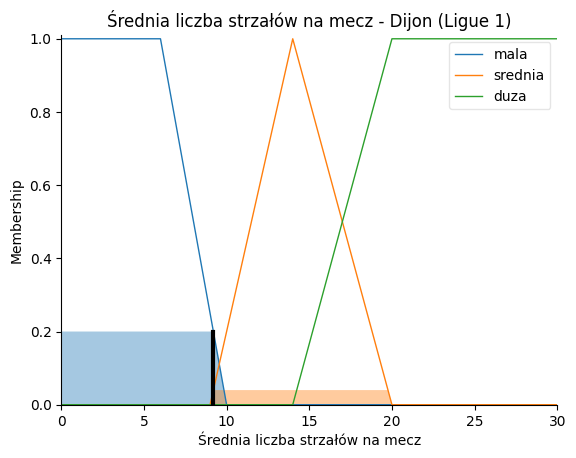

<Figure size 1000x600 with 0 Axes>

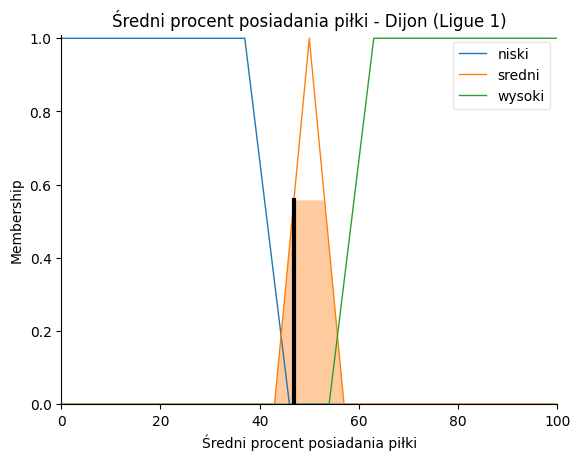

<Figure size 1000x600 with 0 Axes>

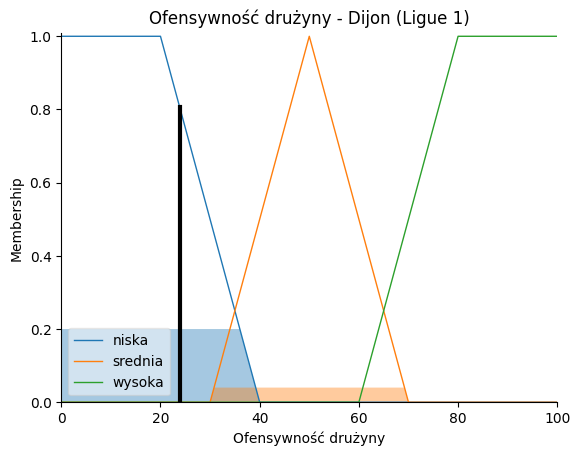

Wiersz 98: Schalke 04 (Bundesliga)
Ofensywność drużyny = 18.658836689038015 [%]
  Przynależność (Membership):
  Liczba bramek (25): mala=0.8, srednia=0.0, duza=0.0
  Średnia liczba strzałów na mecz (8.9): mala=0.2749999999999999, srednia=0.0, duza=0.0
  Średni procent posiadania piłki (46.2): niski=0.0, sredni=0.4571428571428576, wysoki=0.0



<Figure size 1000x600 with 0 Axes>

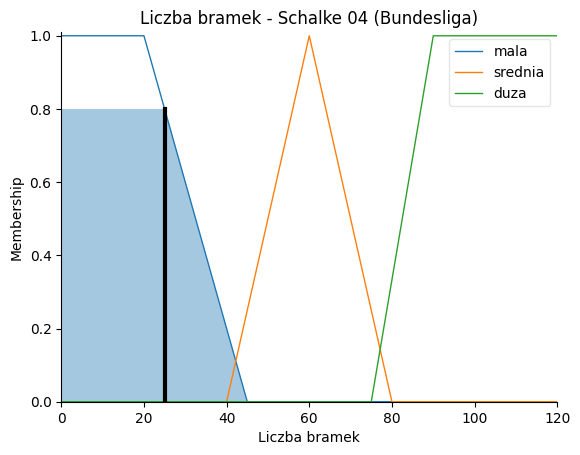

<Figure size 1000x600 with 0 Axes>

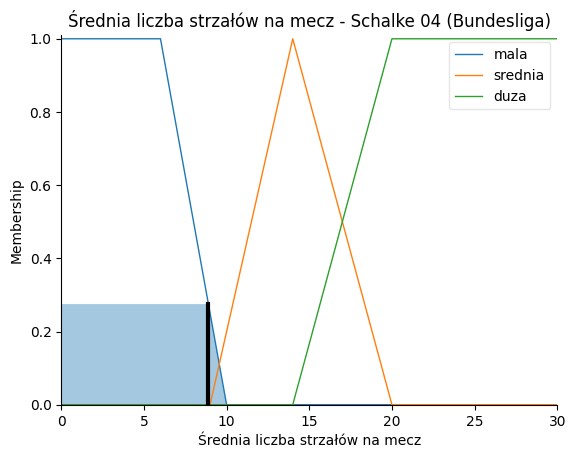

<Figure size 1000x600 with 0 Axes>

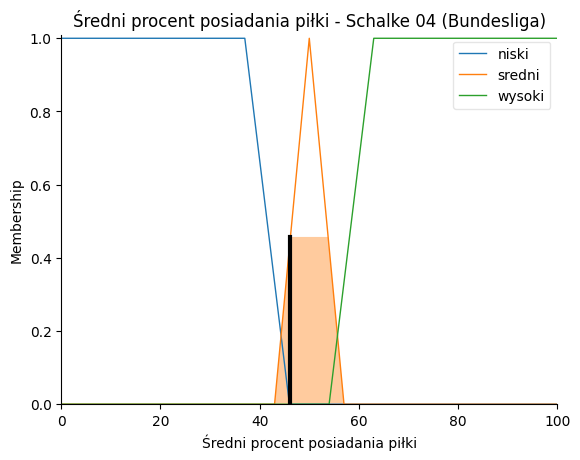

<Figure size 1000x600 with 0 Axes>

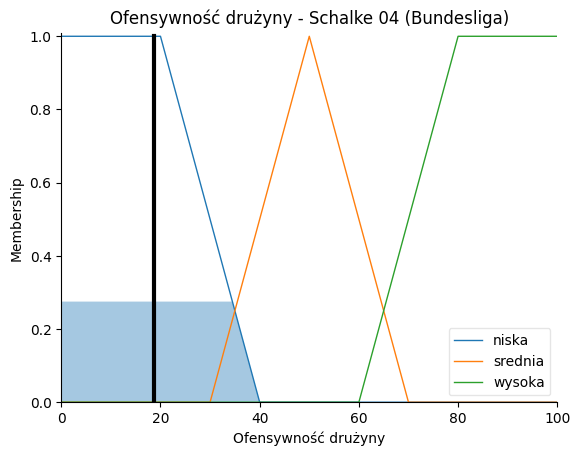

In [ ]:
for index, row in data.iterrows():
    # pobranie wartości z pliku
    value_team = row['team']
    value_tournament = row['tournament']
    # zmienne lingwistyczne wejścia
    input_value_goals = row['goals']
    input_value_shots_per_game = row['shots_per_game']
    input_value_possession = row['possession']

    # przypisanie wartości zmiennych lingwistycznych wejścia do symulacji
    offensiveness_ctrl_simulation.input['Liczba bramek'] = input_value_goals
    offensiveness_ctrl_simulation.input['Średnia liczba strzałów na mecz'] = input_value_shots_per_game
    offensiveness_ctrl_simulation.input['Średni procent posiadania piłki'] = input_value_possession

    # wywołanie sterowania
    offensiveness_ctrl_simulation.compute()

    # wyświetlenie wyników ofensywności drużyny
    print(f'Wiersz {index + 1}: {value_team} ({value_tournament})')
    offensive_score = offensiveness_ctrl_simulation.output['Ofensywność drużyny']
    print(f'Ofensywność drużyny = {offensive_score} [%]')

    # obliczenie wartości przynależności dla każdej zmiennej lingwistycznej
    goals_mala_value = fuzz.interp_membership(goals.universe, goals['mala'].mf, input_value_goals)
    goals_srednia_value = fuzz.interp_membership(goals.universe, goals['srednia'].mf, input_value_goals)
    goals_duza_value = fuzz.interp_membership(goals.universe, goals['duza'].mf, input_value_goals)

    shots_per_game_mala_value = fuzz.interp_membership(shots_per_game.universe, shots_per_game['mala'].mf, input_value_shots_per_game)
    shots_per_game_srednia_value = fuzz.interp_membership(shots_per_game.universe, shots_per_game['srednia'].mf, input_value_shots_per_game)
    shots_per_game_duza_value = fuzz.interp_membership(shots_per_game.universe, shots_per_game['duza'].mf, input_value_shots_per_game)

    possession_niski_value = fuzz.interp_membership(possession.universe, possession['niski'].mf, input_value_possession)
    possession_sredni_value = fuzz.interp_membership(possession.universe, possession['sredni'].mf, input_value_possession)
    possession_wysoki_value = fuzz.interp_membership(possession.universe, possession['wysoki'].mf, input_value_possession)

    # wyświetlenie wartości przynależności
    print(f'  Przynależność (Membership):')
    print(f'  Liczba bramek ({input_value_goals}): mala={goals_mala_value}, srednia={goals_srednia_value}, duza={goals_duza_value}')
    print(f'  Średnia liczba strzałów na mecz ({input_value_shots_per_game}): mala={shots_per_game_mala_value}, srednia={shots_per_game_srednia_value}, duza={shots_per_game_duza_value}')
    print(f'  Średni procent posiadania piłki ({input_value_possession}): niski={possession_niski_value}, sredni={possession_sredni_value}, wysoki={possession_wysoki_value}')
    print('')

    # wizualizacja aktywacji dla konkretnego wiersza
    plt.figure(figsize=(10, 6))
    goals.view(sim=offensiveness_ctrl_simulation)
    plt.title(f'Liczba bramek - {value_team} ({value_tournament})')
    plt.show()

    plt.figure(figsize=(10, 6))
    shots_per_game.view(sim=offensiveness_ctrl_simulation)
    plt.title(f'Średnia liczba strzałów na mecz - {value_team} ({value_tournament})')
    plt.show()

    plt.figure(figsize=(10, 6))
    possession.view(sim=offensiveness_ctrl_simulation)
    plt.title(f'Średni procent posiadania piłki - {value_team} ({value_tournament})')
    plt.show()

    plt.figure(figsize=(10, 6))
    offensiveness.view(sim=offensiveness_ctrl_simulation)
    plt.title(f'Ofensywność drużyny - {value_team} ({value_tournament})')
    plt.show()

<h3>Symulacja dla podanych wartości zmiennych lingwistycznych wejścia</h3>

Funkcja *analyze_team_offensiveness* oblicza ofensywność drużyny na podstawie danych wejściowych (liczba bramek, średnia liczba strzałów na mecz i średni procent posiadania piłki). Wyświetla wyniki przynależności do zmiennych lingwistycznych oraz wizualizuje wyniki w formie wykresu 3D. Wykres przedstawia, jak liczba bramek i strzały na mecz wpływają na wartość ofensywności, przy stałym poziomie średniego procentu posiadania piłki.

In [ ]:
def analyze_team_offensiveness(value_team, value_tournament, input_value_goals, input_value_shots_per_game, input_value_possession):
  # przypisanie wartości zmiennych lingwistycznych wejścia do symulacji
  offensiveness_ctrl_simulation.input['Liczba bramek'] = input_value_goals
  offensiveness_ctrl_simulation.input['Średnia liczba strzałów na mecz'] = input_value_shots_per_game
  offensiveness_ctrl_simulation.input['Średni procent posiadania piłki'] = input_value_possession

  # wywołanie sterowania
  offensiveness_ctrl_simulation.compute()

  # wyświetlenie wyników ofensywności drużyny
  print(f'Statystyki drużyny: {value_team} ({value_tournament})')
  offensive_score = offensiveness_ctrl_simulation.output['Ofensywność drużyny']
  print(f'Ofensywność drużyny = {offensive_score} [%]')

  # obliczenie wartości przynależności dla każdej zmiennej lingwistycznej
  goals_mala_value = fuzz.interp_membership(goals.universe, goals['mala'].mf, input_value_goals)
  goals_srednia_value = fuzz.interp_membership(goals.universe, goals['srednia'].mf, input_value_goals)
  goals_duza_value = fuzz.interp_membership(goals.universe, goals['duza'].mf, input_value_goals)

  shots_per_game_mala_value = fuzz.interp_membership(shots_per_game.universe, shots_per_game['mala'].mf, input_value_shots_per_game)
  shots_per_game_srednia_value = fuzz.interp_membership(shots_per_game.universe, shots_per_game['srednia'].mf, input_value_shots_per_game)
  shots_per_game_duza_value = fuzz.interp_membership(shots_per_game.universe, shots_per_game['duza'].mf, input_value_shots_per_game)

  possession_niski_value = fuzz.interp_membership(possession.universe, possession['niski'].mf, input_value_possession)
  possession_sredni_value = fuzz.interp_membership(possession.universe, possession['sredni'].mf, input_value_possession)
  possession_wysoki_value = fuzz.interp_membership(possession.universe, possession['wysoki'].mf, input_value_possession)

  # wyświetlenie wartości przynależności
  print(f'  Przynależność (Membership):')
  print(f'  Liczba bramek ({input_value_goals}): mala={goals_mala_value}, srednia={goals_srednia_value}, duza={goals_duza_value}')
  print(f'  Średnia liczba strzałów na mecz ({input_value_shots_per_game}): mala={shots_per_game_mala_value}, srednia={shots_per_game_srednia_value}, duza={shots_per_game_duza_value}')
  print(f'  Średni procent posiadania piłki ({input_value_possession}): niski={possession_niski_value}, sredni={possession_sredni_value}, wysoki={possession_wysoki_value}')

  # wizualizacja aktywacji
  plt.figure(figsize=(10, 6))
  goals.view(sim=offensiveness_ctrl_simulation)
  plt.title(f'Liczba bramek - {value_team} ({value_tournament})')
  plt.show()

  plt.figure(figsize=(10, 6))
  shots_per_game.view(sim=offensiveness_ctrl_simulation)
  plt.title(f'Średnia liczba strzałów na mecz - {value_team} ({value_tournament})')
  plt.show()

  plt.figure(figsize=(10, 6))
  possession.view(sim=offensiveness_ctrl_simulation)
  plt.title(f'Średni procent posiadania piłki - {value_team} ({value_tournament})')
  plt.show()

  plt.figure(figsize=(10, 6))
  offensiveness.view(sim=offensiveness_ctrl_simulation)
  plt.title(f'Ofensywność drużyny - {value_team} ({value_tournament})')
  plt.show()

  # Wizualizacja wykresu powierzchniowego
  # tworzenie siatki wartości wejściowych
  x = np.linspace(goals.universe.min(), goals.universe.max(), 100)
  y = np.linspace(shots_per_game.universe.min(), shots_per_game.universe.max(), 100)
  X, Y = np.meshgrid(x, y)
  Z = np.zeros_like(X)

  # iteracja po siatce, aby obliczyć wartość wyjściową ofensywności drużyny
  for i in range(X.shape[0]):
    for j in range(X.shape[1]):
        offensiveness_ctrl_simulation.input['Liczba bramek'] = X[i, j]
        offensiveness_ctrl_simulation.input['Średnia liczba strzałów na mecz'] = Y[i, j]
        offensiveness_ctrl_simulation.input['Średni procent posiadania piłki'] = input_value_possession  # stała wartość trzeciej zmiennej
        offensiveness_ctrl_simulation.compute()
        Z[i, j] = offensiveness_ctrl_simulation.output['Ofensywność drużyny']

  # tworzenie wykresu 3D
  fig = plt.figure(figsize=(10, 8))
  ax = fig.add_subplot(111, projection='3d')
  surf = ax.plot_surface(X, Y, Z, cmap='viridis', edgecolor='k')

  # ustawienia etykiet i tytułu
  ax.set_xlabel('Liczba bramek')
  ax.set_ylabel('Średnia liczba strzałów na mecz')
  ax.set_zlabel('Ofensywność drużyny')
  ax.set_title(f'Wykres powierzchniowy ofensywności drużyny: {value_team} ({value_tournament})')
  fig.colorbar(surf, ax=ax, shrink=0.5, aspect=5)

  # wyświetlenie wykresu
  plt.show()

Analiza ofensywności drużyny dla scenariusza 1:
- nazwa drużyny - **Manchester City**
- nazwa rozgrywek - **Premier League 23/24**
- liczba strzelonych bramek - **96**
- średnia liczba strzałów na mecz - **14.05**
- średni procent posiadania piłki - **66**

Statystyki drużyny: Manchester City (Premier League 23/24)
Ofensywność drużyny = 84.4135118497999 [%]
  Przynależność (Membership):
  Liczba bramek (96): mala=0.0, srednia=0.0, duza=1.0
  Średnia liczba strzałów na mecz (14.05): mala=0.0, srednia=0.9916666666666665, duza=0.008333333333333451
  Średni procent posiadania piłki (66): niski=0.0, sredni=0.0, wysoki=1.0


<Figure size 1000x600 with 0 Axes>

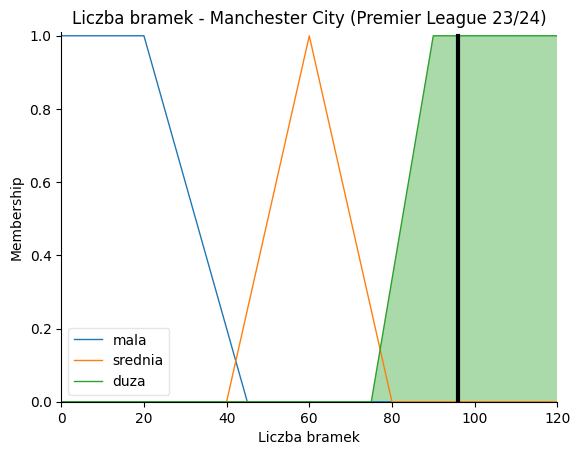

<Figure size 1000x600 with 0 Axes>

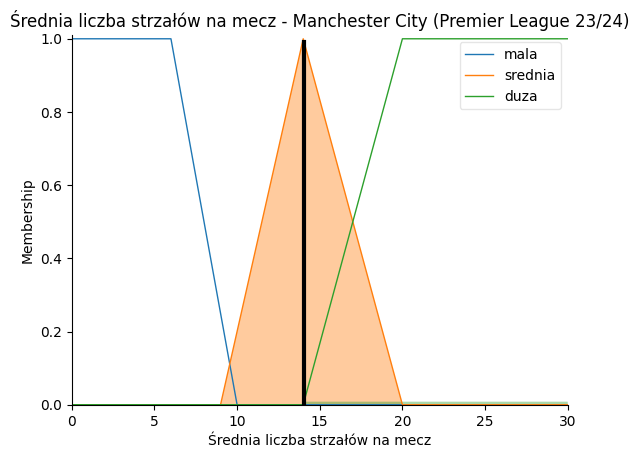

<Figure size 1000x600 with 0 Axes>

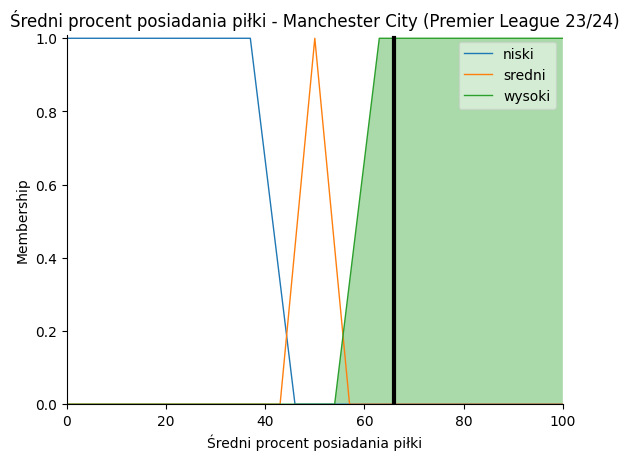

<Figure size 1000x600 with 0 Axes>

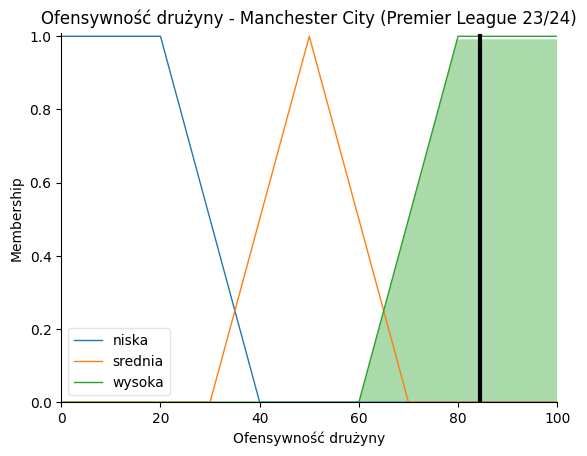

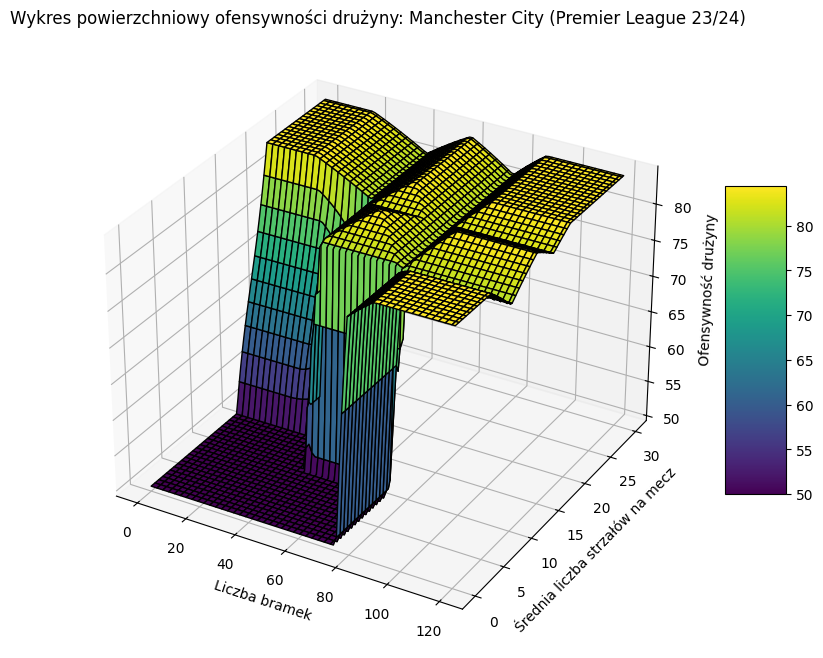

In [ ]:
analyze_team_offensiveness(
    value_team='Manchester City',
    value_tournament='Premier League 23/24',
    input_value_goals=96,
    input_value_shots_per_game=14.05,
    input_value_possession=66
)

Analiza ofensywności drużyny dla scenariusza 2:
- nazwa drużyny - **Fulham FC**
- nazwa rozgrywek - **Premier League 23/24**
- liczba strzelonych bramek - **55**
- średnia liczba strzałów na mecz - **10.89**
- średni procent posiadania piłki - **50**

Statystyki drużyny: Fulham FC (Premier League 23/24)
Ofensywność drużyny = 50.0 [%]
  Przynależność (Membership):
  Liczba bramek (55): mala=0.0, srednia=0.75, duza=0.0
  Średnia liczba strzałów na mecz (10.89): mala=0.0, srednia=0.3780000000000001, duza=0.0
  Średni procent posiadania piłki (50): niski=0.0, sredni=1.0, wysoki=0.0


<Figure size 1000x600 with 0 Axes>

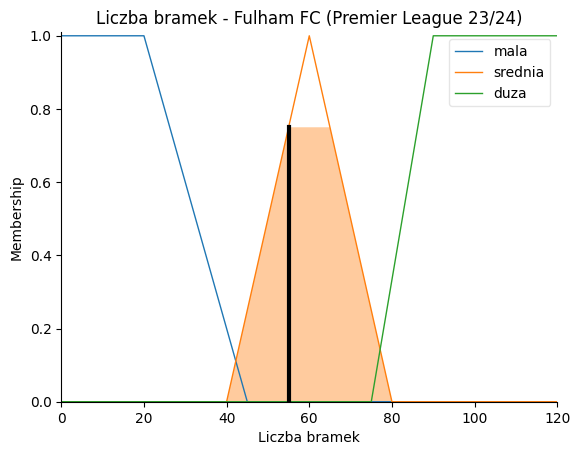

<Figure size 1000x600 with 0 Axes>

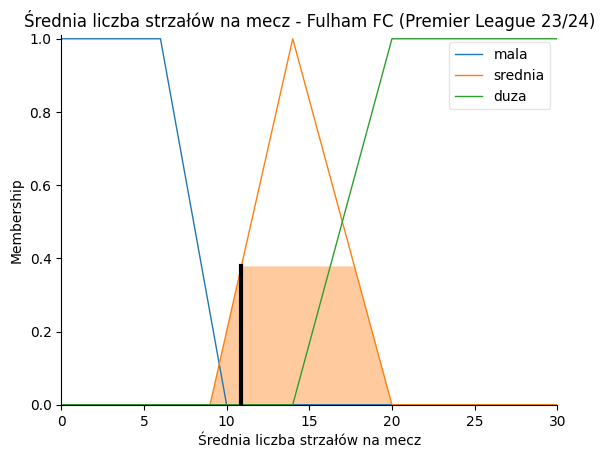

<Figure size 1000x600 with 0 Axes>

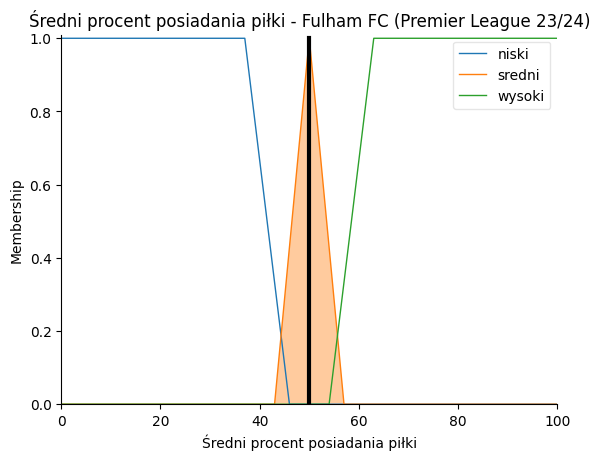

<Figure size 1000x600 with 0 Axes>

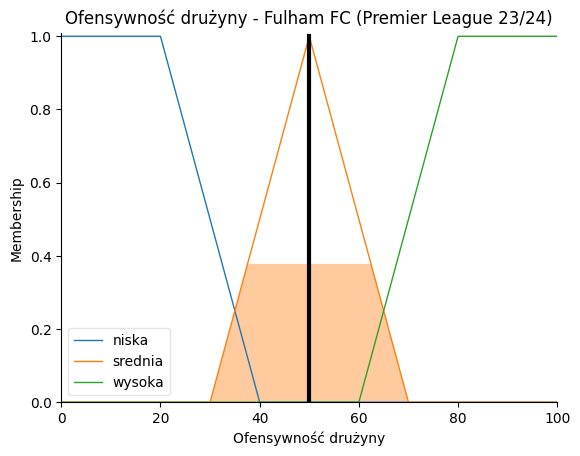

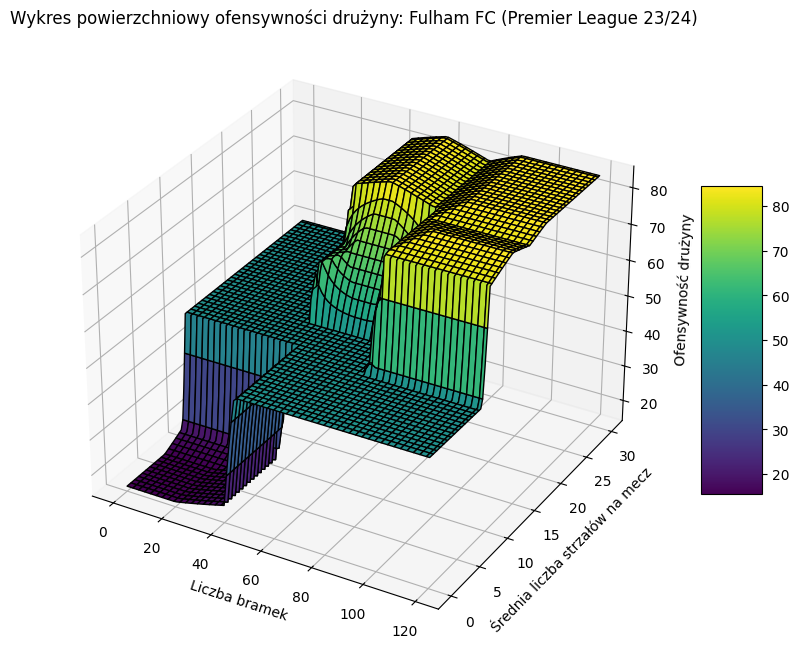

In [ ]:
analyze_team_offensiveness(
    value_team='Fulham FC',
    value_tournament='Premier League 23/24',
    input_value_goals=55,
    input_value_shots_per_game=10.89,
    input_value_possession=50
)

Analiza ofensywności drużyny dla scenariusza 3:
- nazwa drużyny - **Sheffield United FC**
- nazwa rozgrywek - **Premier League 23/24**
- liczba strzelonych bramek - **36**
- średnia liczba strzałów na mecz - **8.05**
- średni procent posiadania piłki - **35**

Statystyki drużyny: Sheffield United FC (Premier League 23/24)
Ofensywność drużyny = 18.25934065934066 [%]
  Przynależność (Membership):
  Liczba bramek (36): mala=0.36, srednia=0.0, duza=0.0
  Średnia liczba strzałów na mecz (8.05): mala=0.4874999999999998, srednia=0.0, duza=0.0
  Średni procent posiadania piłki (35): niski=1.0, sredni=0.0, wysoki=0.0


<Figure size 1000x600 with 0 Axes>

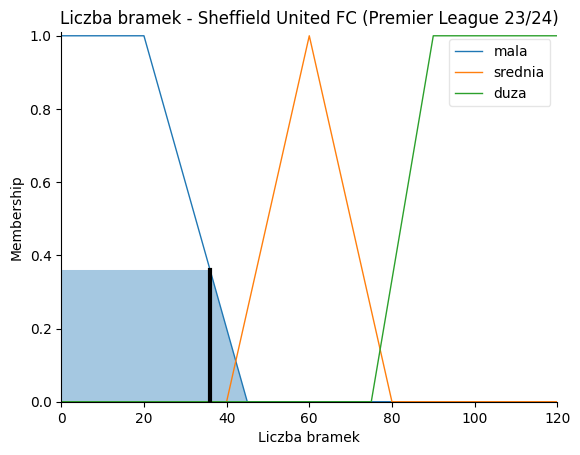

<Figure size 1000x600 with 0 Axes>

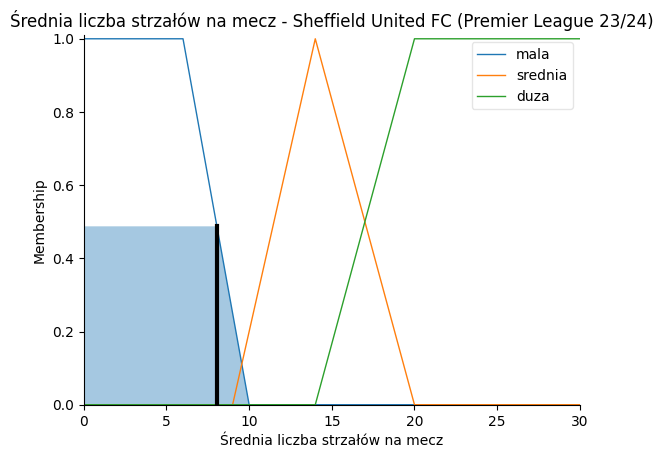

<Figure size 1000x600 with 0 Axes>

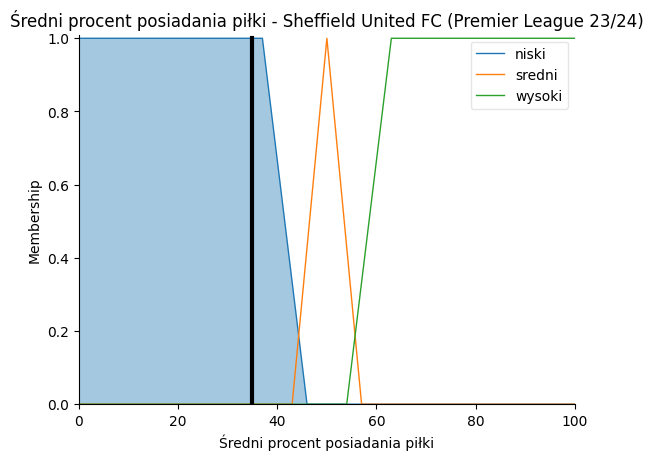

<Figure size 1000x600 with 0 Axes>

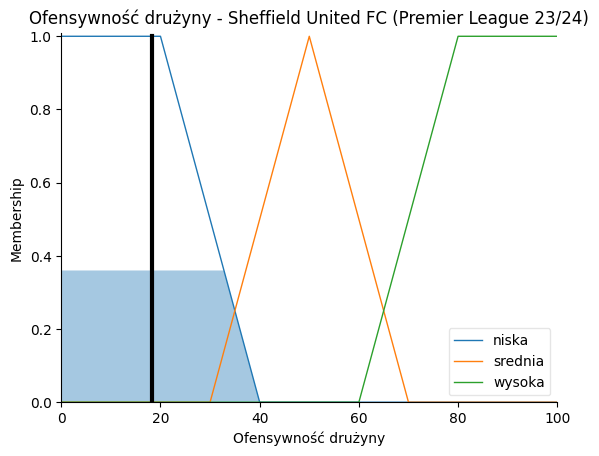

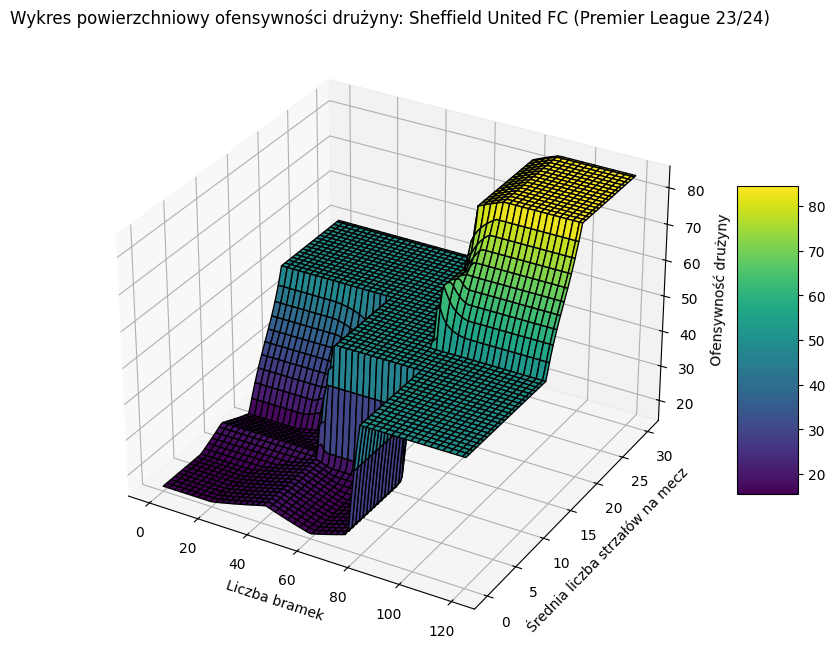

In [ ]:
analyze_team_offensiveness(
    value_team='Sheffield United FC',
    value_tournament='Premier League 23/24',
    input_value_goals=36,
    input_value_shots_per_game=8.05,
    input_value_possession=35
)